# Spatial variance

## Imports

In [8]:
%matplotlib inline
%load_ext autoreload
%autoreload 2

import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import norm, uniform
import seaborn as sn
import pandas as pd

from crowdgeoloc.one_d import FunctionNormalAnnotatorPopulation, SimpleNormalAnnotatorPopulation
from crowdgeoloc.experiment import ActiveAnnotationContest, mean_location_norm_error, mean_sigma_norm_error
from crowdgeoloc.fixed import OneShotDirect,OneShotBayesian, OneShotConservative, OneShotConservative2, OneShotIterative, \
                                OneShotMean, KShot
from crowdgeoloc.spatial import OneShotSpatialBayesian, KShotSpatial

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


## Parameters

In [3]:
n_points = 10000 #number of points
n_annotators = 10 #number of annotators
redundancy = 5 #redundancy value

point_distribution = uniform() #points distribution

## Visualization of variance profiles of the population

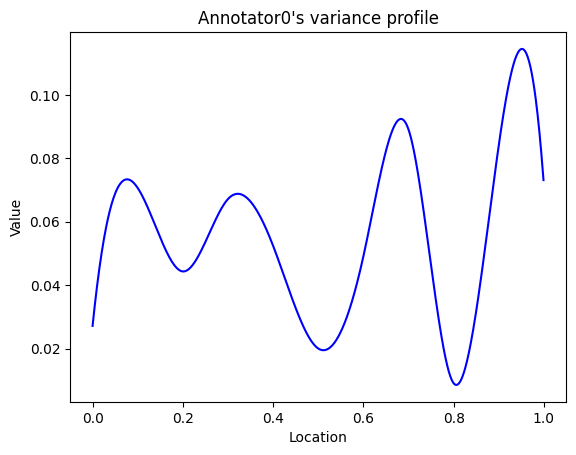

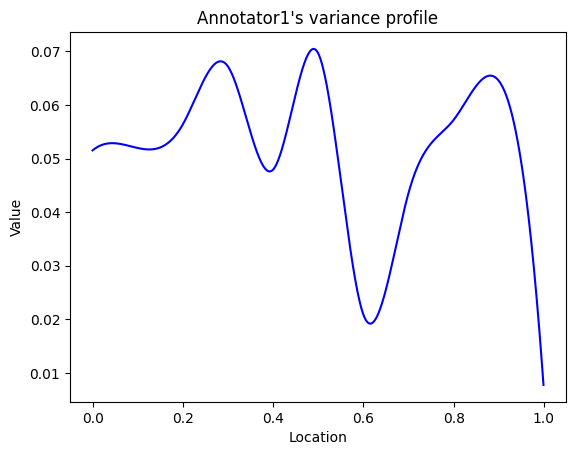

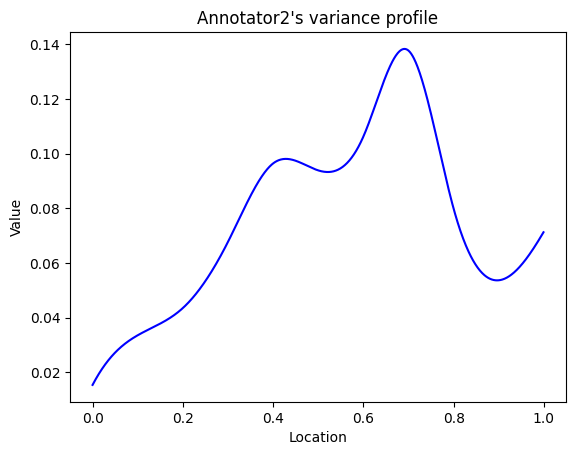

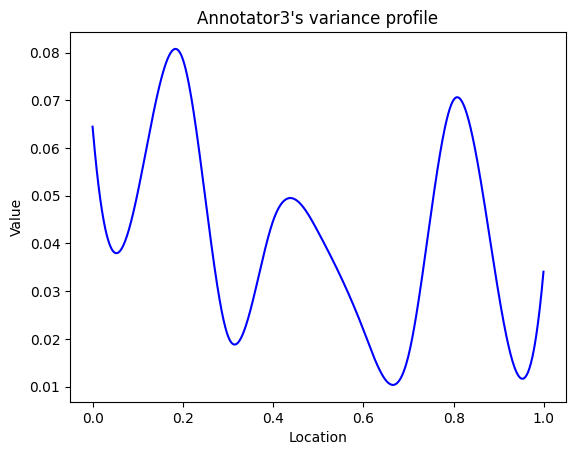

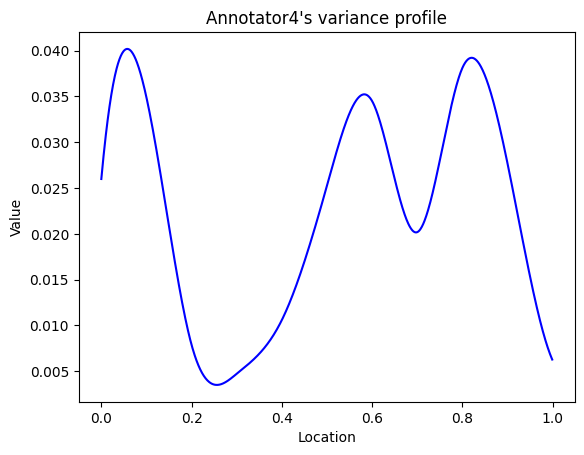

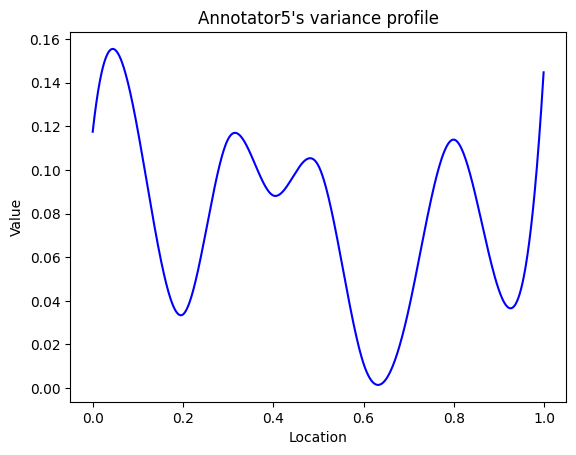

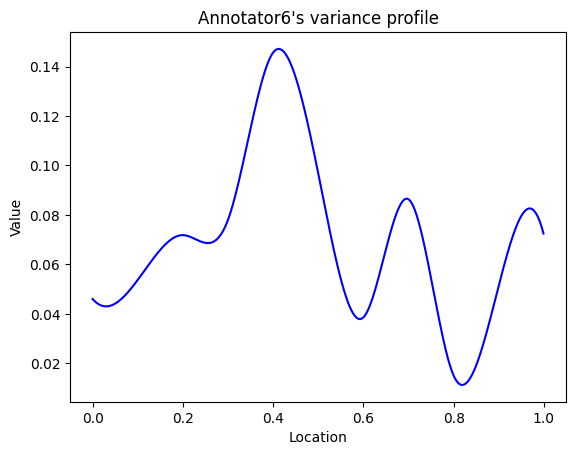

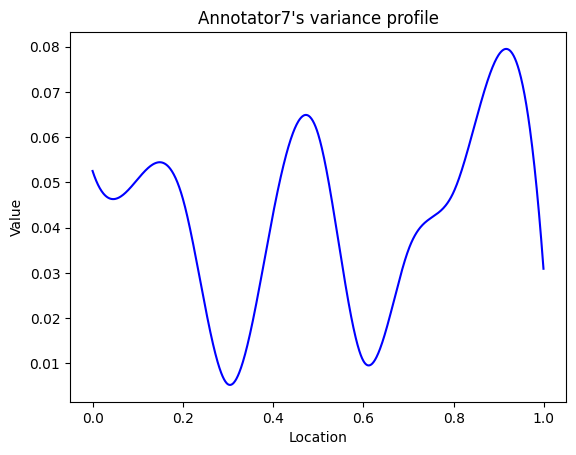

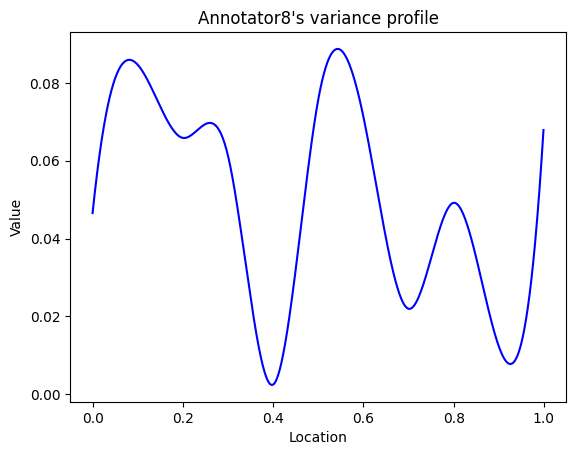

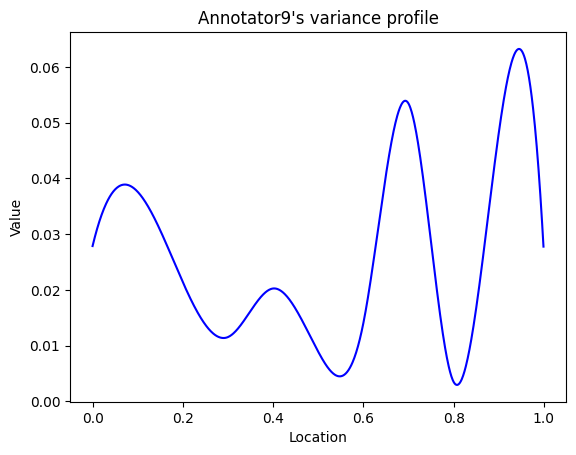

In [9]:
annotator_population = FunctionNormalAnnotatorPopulation()
points = point_distribution.rvs(n_points)
ann_set = annotator_population.sample(n_annotators)

allx = np.arange(1000) / 1000.
for i in range(n_annotators):
    plt.plot(allx, ann_set.annotators[i].sigma(allx), 'b')
    plt.title(f"Annotator{i}'s variance profile")
    plt.xlabel("Location")
    plt.ylabel("Value")
    plt.show()

## Mean error comparison: Performance of the different methods

In [37]:
models = {"mean": OneShotMean(),
          "direct":OneShotDirect(), 
          "iterative":OneShotIterative(), 
          "conservative":OneShotConservative(),
          "conservative2":OneShotConservative2(),
          #"FixedBayesian": OneShotBayesian(),
          "KShot_1.1":KShot(greediness=1.1),
          "KShot_2":KShot(greediness=2.),
          "SpatialOneShot": OneShotSpatialBayesian(),
          "SpatialKShot_1.1": KShotSpatial(greediness=1.1),
          "SpatialKShot_2": KShotSpatial(greediness=2.)
         }
metrics = {"mean_location_norm_error":mean_location_norm_error}

In [38]:
def compare(models, exp, metrics, repeats):
    results = []
    for model_name, m in models.items():
        print(model_name)
        result = {"model": model_name}
        for i in range(repeats):
            exp.reset()
            this_run = m.run(exp)
            result["iteration"] = i
            for metric_name, metric in metrics.items():
                result["metric"] = metric_name
                result["value"] = metric(exp, this_run)
                result["sigmas"] = this_run['sigmas']
                results.append(result.copy())
    return results

In [46]:
exp = ActiveAnnotationContest(points, ann_set, max_total_annotations=n_points*redundancy)
iterations = 50 #number of repetitions to ensure statistical significance 
results2 = compare(models, exp, metrics, iterations)
df2=pd.DataFrame(results2)

mean
direct
iterative
conservative
conservative2
KShot_1.1
KShot_2
SpatialOneShot


19:57:25 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 1000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/cgmp4jm0.json
Chain [1] init = /tmp/tmp044bz2cc/bqavk7c4.json
Chain [1] random
Chain [1] seed = 42354
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma8dcv3j4h/gp-learn-variances-ma-20230426195725.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 103903
Chain [1] It

19:57:28 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        122585   1.87588e-05    0.00840478      0.7056      0.7056       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


19:57:29 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 1000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/s2om712n.json
Chain [1] init = /tmp/tmp044bz2cc/pp_wg041.json
Chain [1] random
Chain [1] seed = 55320
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maioc1aule/gp-learn-variances-ma-20230426195729.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 104085
Chain [1] It

19:57:32 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        122770   3.25398e-05    0.00274855           1           1       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

19:57:33 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 1000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/26jh08iu.json
Chain [1] init = /tmp/tmp044bz2cc/hohoh974.json
Chain [1] random
Chain [1] seed = 6947
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma3u6mgtj0/gp-learn-variances-ma-20230426195733.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 103765
Chain [1] Ite

19:57:36 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        122496   5.75684e-05    0.00675738           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

19:57:37 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 1000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/xivme_qt.json
Chain [1] init = /tmp/tmp044bz2cc/_8pgrzm7.json
Chain [1] random
Chain [1] seed = 91812
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mazzqezwh9/gp-learn-variances-ma-20230426195737.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 104049
Chain [1] It

19:57:40 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        122475   4.71667e-05    0.00661986           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

19:57:40 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 1000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/ouj1wdze.json
Chain [1] init = /tmp/tmp044bz2cc/nlclukgc.json
Chain [1] random
Chain [1] seed = 69324
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maexo6ykup/gp-learn-variances-ma-20230426195740.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 104009
Chain [1] It

19:57:44 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        122396   3.69598e-05     0.0079333           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

19:57:44 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 1000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/e0355mn5.json
Chain [1] init = /tmp/tmp044bz2cc/n4bpddrt.json
Chain [1] random
Chain [1] seed = 9665
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mav4s3_ap4/gp-learn-variances-ma-20230426195744.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 103871
Chain [1] Ite

19:57:48 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        122326   2.14475e-05     0.0078652       0.901       0.901       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

19:57:49 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 1000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/9evuq_h9.json
Chain [1] init = /tmp/tmp044bz2cc/p3dg83s7.json
Chain [1] random
Chain [1] seed = 90774
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mak1m7in09/gp-learn-variances-ma-20230426195749.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 104001
Chain [1] It

19:57:51 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        122673   1.80063e-05    0.00792814       0.709       0.709       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

19:57:52 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 1000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/y51ur0ul.json
Chain [1] init = /tmp/tmp044bz2cc/b0ralwqr.json
Chain [1] random
Chain [1] seed = 40854
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mabh678wwt/gp-learn-variances-ma-20230426195752.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 103668
Chain [1] It

19:57:55 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        122321   7.14688e-05    0.00757722           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

19:57:56 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 1000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/4jszjr6r.json
Chain [1] init = /tmp/tmp044bz2cc/nyhoan_3.json
Chain [1] random
Chain [1] seed = 54870
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maovtzrhad/gp-learn-variances-ma-20230426195756.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 103805
Chain [1] It

19:57:59 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        122224   6.60619e-05    0.00897019           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


19:57:59 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 1000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/d5lmvklx.json
Chain [1] init = /tmp/tmp044bz2cc/a19yyf83.json
Chain [1] random
Chain [1] seed = 8179
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma4cnpnrys/gp-learn-variances-ma-20230426195759.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 103791
Chain [1] Ite

19:58:03 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        122378   2.68218e-05    0.00746684           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

19:58:03 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 1000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/gcn9ijxh.json
Chain [1] init = /tmp/tmp044bz2cc/0rgs3l35.json
Chain [1] random
Chain [1] seed = 44241
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mazixfgq84/gp-learn-variances-ma-20230426195803.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 103688
Chain [1] It

19:58:06 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        122286    2.5264e-05    0.00486675           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

19:58:07 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 1000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/34iwjk33.json
Chain [1] init = /tmp/tmp044bz2cc/l_avqeh8.json
Chain [1] random
Chain [1] seed = 92251
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mal1lpvo8i/gp-learn-variances-ma-20230426195807.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 103821
Chain [1] It

19:58:10 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        121983   3.00084e-05    0.00642436           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


19:58:11 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 1000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/y00if5lg.json
Chain [1] init = /tmp/tmp044bz2cc/wbu293i8.json
Chain [1] random
Chain [1] seed = 42187
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma2cykem3a/gp-learn-variances-ma-20230426195811.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 103953
Chain [1] It

19:58:14 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        122720   3.01938e-05    0.00738266           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

19:58:14 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 1000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/anqt4brk.json
Chain [1] init = /tmp/tmp044bz2cc/pmfda0y3.json
Chain [1] random
Chain [1] seed = 41439
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma6buvjm3v/gp-learn-variances-ma-20230426195814.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 104025
Chain [1] It

19:58:17 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        122893   2.05637e-05    0.00767158      0.7796      0.7796       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

19:58:18 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 1000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/1k4_apmr.json
Chain [1] init = /tmp/tmp044bz2cc/_ypj3yj9.json
Chain [1] random
Chain [1] seed = 61113
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maa5276qmf/gp-learn-variances-ma-20230426195818.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 104038
Chain [1] It

19:58:21 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        122769   7.80846e-05    0.00919543           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


19:58:22 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 1000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/sg_nr_yi.json
Chain [1] init = /tmp/tmp044bz2cc/rm001dse.json
Chain [1] random
Chain [1] seed = 10615
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma_a54zd4z/gp-learn-variances-ma-20230426195822.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 103633
Chain [1] It

19:58:25 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        122552   3.27106e-05    0.00669087           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


19:58:26 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 1000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/zrzxy4eb.json
Chain [1] init = /tmp/tmp044bz2cc/inebxplc.json
Chain [1] random
Chain [1] seed = 12480
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-majeinvo81/gp-learn-variances-ma-20230426195826.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 104089
Chain [1] It

19:58:29 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        122295   3.87346e-05     0.0139899           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


19:58:29 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 1000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/efqj5wni.json
Chain [1] init = /tmp/tmp044bz2cc/kmt1bgb_.json
Chain [1] random
Chain [1] seed = 81913
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-max639yg4k/gp-learn-variances-ma-20230426195829.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 103723
Chain [1] It

19:58:32 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        122516   5.27617e-05    0.00752069           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


19:58:33 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 1000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/nrl5n1ur.json
Chain [1] init = /tmp/tmp044bz2cc/lzi3xsyh.json
Chain [1] random
Chain [1] seed = 32527
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma__z7xxuq/gp-learn-variances-ma-20230426195833.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 103697
Chain [1] It

19:58:36 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 14        122141   8.55894e-05     0.0102482           1           1       16
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


19:58:36 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 1000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/v9bin6v7.json
Chain [1] init = /tmp/tmp044bz2cc/zg_y8l27.json
Chain [1] random
Chain [1] seed = 79267
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maww24o3d9/gp-learn-variances-ma-20230426195836.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 103748
Chain [1] It

19:58:39 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 14        122207   4.06124e-05    0.00954587           1           1       16
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


19:58:40 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 1000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/zn3oi4oa.json
Chain [1] init = /tmp/tmp044bz2cc/2qrt0a3r.json
Chain [1] random
Chain [1] seed = 40822
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mag6127dp1/gp-learn-variances-ma-20230426195840.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 103798
Chain [1] It

19:58:43 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        122213   2.42362e-05    0.00941095           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


19:58:43 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 1000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/_eins1eq.json
Chain [1] init = /tmp/tmp044bz2cc/c0yw132s.json
Chain [1] random
Chain [1] seed = 84269
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma9rabzv3b/gp-learn-variances-ma-20230426195843.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 103672
Chain [1] It

19:58:46 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        122192   4.32039e-05     0.0051312           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

19:58:47 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 1000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/me47pdck.json
Chain [1] init = /tmp/tmp044bz2cc/s43gk_s2.json
Chain [1] random
Chain [1] seed = 40699
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-math5rdzub/gp-learn-variances-ma-20230426195847.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 103789
Chain [1] It

19:58:50 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        122544   2.54249e-05    0.00606598           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

19:58:51 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 1000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/3c20r11d.json
Chain [1] init = /tmp/tmp044bz2cc/2a9vrz9u.json
Chain [1] random
Chain [1] seed = 11787
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mam20b4zb9/gp-learn-variances-ma-20230426195851.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 103732
Chain [1] It

19:58:53 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        122154   6.70789e-05     0.0123666           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


19:58:54 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 1000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/1tkz6ynw.json
Chain [1] init = /tmp/tmp044bz2cc/rmts5nkd.json
Chain [1] random
Chain [1] seed = 67363
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-magp85ni3w/gp-learn-variances-ma-20230426195854.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 103669
Chain [1] It

19:58:57 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        122436   1.62682e-05    0.00813261      0.6531      0.6531       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


19:58:58 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 1000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/8bqlq8gf.json
Chain [1] init = /tmp/tmp044bz2cc/8352s8dj.json
Chain [1] random
Chain [1] seed = 10407
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maygtqy4r5/gp-learn-variances-ma-20230426195858.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 103753
Chain [1] It

19:59:01 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        122426   5.48112e-05    0.00490624           1           1       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


19:59:01 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 1000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/ar_57zcm.json
Chain [1] init = /tmp/tmp044bz2cc/13cesdlu.json
Chain [1] random
Chain [1] seed = 9079
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maywm9vtxt/gp-learn-variances-ma-20230426195901.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 104002
Chain [1] Ite

19:59:04 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 14        122825   4.72659e-05     0.0101591           1           1       16
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


19:59:05 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 1000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/oa1u7pfl.json
Chain [1] init = /tmp/tmp044bz2cc/u18lc7db.json
Chain [1] random
Chain [1] seed = 54156
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mamjb94pkt/gp-learn-variances-ma-20230426195905.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 103910
Chain [1] It

19:59:08 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 14        122635   6.38679e-05     0.0123068           1           1       16
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

19:59:08 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 1000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/yorouxkj.json
Chain [1] init = /tmp/tmp044bz2cc/d6im4w3b.json
Chain [1] random
Chain [1] seed = 60048
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-majminuw7_/gp-learn-variances-ma-20230426195908.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 103854
Chain [1] It

19:59:11 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        122461   2.39681e-05    0.00869925           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

19:59:12 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 1000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/iyzuet_b.json
Chain [1] init = /tmp/tmp044bz2cc/if8188zf.json
Chain [1] random
Chain [1] seed = 2915
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-majawliex7/gp-learn-variances-ma-20230426195912.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 103914
Chain [1] Ite

19:59:15 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        122739   5.82275e-05     0.0141432           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


19:59:15 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 1000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/purzflw4.json
Chain [1] init = /tmp/tmp044bz2cc/kb84t3qd.json
Chain [1] random
Chain [1] seed = 5251
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-marileefqx/gp-learn-variances-ma-20230426195915.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 103883
Chain [1] Ite

19:59:18 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 14        122553   3.73374e-05    0.00977781      0.8734      0.8734       16
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


19:59:19 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 1000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/mdw7575l.json
Chain [1] init = /tmp/tmp044bz2cc/9j22lnq7.json
Chain [1] random
Chain [1] seed = 63619
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma6r17jt6o/gp-learn-variances-ma-20230426195919.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 103651
Chain [1] It

19:59:22 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        122481   3.58711e-05    0.00264187           1           1       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


19:59:23 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 1000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/s8trd25u.json
Chain [1] init = /tmp/tmp044bz2cc/gxik89lo.json
Chain [1] random
Chain [1] seed = 26965
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maomgj18ut/gp-learn-variances-ma-20230426195923.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 103794
Chain [1] It

19:59:25 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 14        122467   7.42451e-05     0.0111886           1           1       16
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


19:59:26 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 1000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/zgfusolr.json
Chain [1] init = /tmp/tmp044bz2cc/pcviy7uc.json
Chain [1] random
Chain [1] seed = 28965
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-map7cuoh_o/gp-learn-variances-ma-20230426195926.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 103797
Chain [1] It

19:59:29 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 14        122415   6.28125e-05    0.00929149           1           1       16
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

19:59:29 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 1000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/p_pckx4w.json
Chain [1] init = /tmp/tmp044bz2cc/rtfke_n9.json
Chain [1] random
Chain [1] seed = 67963
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mamv86pk0t/gp-learn-variances-ma-20230426195929.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 103881
Chain [1] It

19:59:32 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 14        122262    4.3046e-05     0.0105505           1           1       16
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

19:59:33 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 1000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/xwwai55j.json
Chain [1] init = /tmp/tmp044bz2cc/xrgznsjg.json
Chain [1] random
Chain [1] seed = 33181
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maehfatmi5/gp-learn-variances-ma-20230426195933.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 104149
Chain [1] It

19:59:36 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        122879   3.40093e-05      0.011735           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

19:59:36 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 1000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/4xmf8l66.json
Chain [1] init = /tmp/tmp044bz2cc/ao0qlp0k.json
Chain [1] random
Chain [1] seed = 17557
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-makkum1927/gp-learn-variances-ma-20230426195936.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 103807
Chain [1] It

19:59:39 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        122468   4.21939e-05    0.00934823           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


19:59:40 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 1000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/36rs20z3.json
Chain [1] init = /tmp/tmp044bz2cc/p46pfaa_.json
Chain [1] random
Chain [1] seed = 18745
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maw73afel_/gp-learn-variances-ma-20230426195940.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 104154
Chain [1] It

19:59:43 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        122904   2.90189e-05    0.00278641           1           1       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


19:59:43 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 1000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/jz9aju7q.json
Chain [1] init = /tmp/tmp044bz2cc/i980i9kd.json
Chain [1] random
Chain [1] seed = 3743
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mav4zk0txk/gp-learn-variances-ma-20230426195943.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 103881
Chain [1] Ite

19:59:46 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        122469   4.51882e-05    0.00366245           1           1       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

19:59:47 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 1000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/837m0w8f.json
Chain [1] init = /tmp/tmp044bz2cc/yko97t5b.json
Chain [1] random
Chain [1] seed = 50693
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mata_vm2ti/gp-learn-variances-ma-20230426195947.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 104086
Chain [1] It

19:59:50 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        122824   3.35737e-05    0.00592326           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

19:59:51 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 1000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/nj9_0it2.json
Chain [1] init = /tmp/tmp044bz2cc/n_0fybmr.json
Chain [1] random
Chain [1] seed = 47513
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-macd_55is4/gp-learn-variances-ma-20230426195951.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 103944
Chain [1] It

19:59:53 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 14        122421     3.184e-05     0.0141225      0.7338      0.7338       16
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


19:59:54 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 1000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/k8_ugjb4.json
Chain [1] init = /tmp/tmp044bz2cc/hi6tca4_.json
Chain [1] random
Chain [1] seed = 13750
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maetymae47/gp-learn-variances-ma-20230426195954.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 104103
Chain [1] It

19:59:57 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        122559   4.32392e-05    0.00541379           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


19:59:58 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 1000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/xxjkxe8g.json
Chain [1] init = /tmp/tmp044bz2cc/5s0lq9nv.json
Chain [1] random
Chain [1] seed = 83628
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mauz_fx2_3/gp-learn-variances-ma-20230426195958.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 103997
Chain [1] It

20:00:00 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 14        122301   5.86435e-05     0.0107529           1           1       16
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:00:01 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 1000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/f141f5cs.json
Chain [1] init = /tmp/tmp044bz2cc/_ybt2239.json
Chain [1] random
Chain [1] seed = 84626
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maeevxg3l7/gp-learn-variances-ma-20230426200001.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 103794
Chain [1] It

20:00:04 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 14        121966    7.5641e-05     0.0111271           1           1       16
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:00:05 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 1000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/k4vxsrxv.json
Chain [1] init = /tmp/tmp044bz2cc/fbc2nc57.json
Chain [1] random
Chain [1] seed = 90791
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maxtx7ep7i/gp-learn-variances-ma-20230426200005.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 103764
Chain [1] It

20:00:07 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 14        122280   4.89973e-05     0.0100949           1           1       16
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:00:08 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 1000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/o5tmqj05.json
Chain [1] init = /tmp/tmp044bz2cc/33yuho08.json
Chain [1] random
Chain [1] seed = 53100
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-madr56vtr8/gp-learn-variances-ma-20230426200008.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 103725
Chain [1] It

20:00:11 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 14        122269   5.24011e-05     0.0101059           1           1       16
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:00:11 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 1000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/txo8n_un.json
Chain [1] init = /tmp/tmp044bz2cc/d1u8yt96.json
Chain [1] random
Chain [1] seed = 44846
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma03_lq6cq/gp-learn-variances-ma-20230426200011.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 103944
Chain [1] It

20:00:14 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 14        122503   4.57976e-05    0.00948218           1           1       16
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:00:15 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 1000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/25bvzprr.json
Chain [1] init = /tmp/tmp044bz2cc/cwtzpcvr.json
Chain [1] random
Chain [1] seed = 52301
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mazosboyx2/gp-learn-variances-ma-20230426200015.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 103965
Chain [1] It

20:00:18 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        122403   5.42035e-05     0.0140161           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:00:18 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 1000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/aqwcmt5g.json
Chain [1] init = /tmp/tmp044bz2cc/kfuaisnb.json
Chain [1] random
Chain [1] seed = 39824
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maci2lwfe1/gp-learn-variances-ma-20230426200018.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 103839
Chain [1] It

20:00:21 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        122399   6.30078e-05    0.00603886           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:00:22 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 1000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/gye13gkf.json
Chain [1] init = /tmp/tmp044bz2cc/5vwjn5a2.json
Chain [1] random
Chain [1] seed = 65037
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma1rpwqrh6/gp-learn-variances-ma-20230426200022.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 103870
Chain [1] It

20:00:25 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        122423   4.52595e-05    0.00838093           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
SpatialKShot_1.1


20:00:25 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/h6ou1c02.json
Chain [1] init = /tmp/tmp044bz2cc/x8t8ka2x.json
Chain [1] random
Chain [1] seed = 59773
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma8pc3xyi1/gp-learn-variances-ma-20230426200025.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10440.9
Chain [1] 

20:00:26 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23         12482   4.22734e-05   0.000994384           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:00:31 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/7vjsjfo9.json
Chain [1] init = /tmp/tmp044bz2cc/yt6s24nn.json
Chain [1] random
Chain [1] seed = 53370
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma9d3_87l9/gp-learn-variances-ma-20230426200031.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46200.8
Chain [1] 

20:00:32 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 13         49187   7.56539e-05     0.0043229           1           1       15
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:00:38 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/hwskoszy.json
Chain [1] init = /tmp/tmp044bz2cc/gi4_i59d.json
Chain [1] random
Chain [1] seed = 49549
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mae_uaw5wr/gp-learn-variances-ma-20230426200038.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66320.4
Chain [1] 

20:00:40 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       76218.8   6.39464e-05    0.00651923           1           1       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:00:47 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/i6xifxmm.json
Chain [1] init = /tmp/tmp044bz2cc/_2nfyq3w.json
Chain [1] random
Chain [1] seed = 60487
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-makec7gssv/gp-learn-variances-ma-20230426200047.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85838.3
Chain [1] 

20:00:50 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        101472   1.29483e-05    0.00407019      0.4227           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:00:57 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/kiqxz1an.json
Chain [1] init = /tmp/tmp044bz2cc/9m1niz6z.json
Chain [1] random
Chain [1] seed = 21651
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maa58qq1ib/gp-learn-variances-ma-20230426200057.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105186
Chain [1] I

20:01:00 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126452    1.5747e-05    0.00629159      0.4525           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:01:03 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/nxt3mcdk.json
Chain [1] init = /tmp/tmp044bz2cc/vgc9qwzw.json
Chain [1] random
Chain [1] seed = 8617
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maltnk_a8x/gp-learn-variances-ma-20230426200103.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10353.4
Chain [1] I

20:01:04 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       12362.2   3.41051e-05   0.000682173           1           1       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:01:09 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/an7l341b.json
Chain [1] init = /tmp/tmp044bz2cc/psozhfh6.json
Chain [1] random
Chain [1] seed = 40879
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-majrun_61u/gp-learn-variances-ma-20230426200109.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46262
Chain [1] It

20:01:10 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 14       49435.5   2.93457e-05    0.00270784           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:01:16 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/2hdx3fzk.json
Chain [1] init = /tmp/tmp044bz2cc/kmye201a.json
Chain [1] random
Chain [1] seed = 44208
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma5ptaiwi8/gp-learn-variances-ma-20230426200116.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66291.1
Chain [1] 

20:01:18 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16       76256.1   2.87315e-05     0.0110642      0.9201      0.9201       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:01:25 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/mhn9wxmy.json
Chain [1] init = /tmp/tmp044bz2cc/r99ont0j.json
Chain [1] random
Chain [1] seed = 56349
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-makhqthraw/gp-learn-variances-ma-20230426200125.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85865
Chain [1] It

20:01:28 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        101674   1.47912e-05    0.00541777      0.7268      0.7268       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:01:35 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/_e91ybyr.json
Chain [1] init = /tmp/tmp044bz2cc/ly315z8j.json
Chain [1] random
Chain [1] seed = 18297
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maagsmd0n7/gp-learn-variances-ma-20230426200135.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105154
Chain [1] I

20:01:38 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126111   3.83243e-05    0.00895859      0.7063      0.7063       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:01:41 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/83kghicl.json
Chain [1] init = /tmp/tmp044bz2cc/z6qi57r5.json
Chain [1] random
Chain [1] seed = 59777
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maahxa9eo3/gp-learn-variances-ma-20230426200141.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10393.3
Chain [1] 

20:01:41 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21       12244.2   2.72965e-05   0.000627977           1           1       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:01:47 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/z7jt8jsd.json
Chain [1] init = /tmp/tmp044bz2cc/jur9c1yg.json
Chain [1] random
Chain [1] seed = 74953
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mafpzx4wmu/gp-learn-variances-ma-20230426200147.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46365.5
Chain [1] 

20:01:48 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 14       49597.7    3.3817e-05    0.00350245           1           1       16
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:01:54 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/cygfznny.json
Chain [1] init = /tmp/tmp044bz2cc/vna7ylyx.json
Chain [1] random
Chain [1] seed = 19561
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-madjcg5cfz/gp-learn-variances-ma-20230426200154.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66355.9
Chain [1] 

20:01:56 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       76231.7   4.20138e-05    0.00779275      0.8363      0.8363       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:02:03 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/mth2hy5g.json
Chain [1] init = /tmp/tmp044bz2cc/fkce31sz.json
Chain [1] random
Chain [1] seed = 85088
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mauhs_xjxa/gp-learn-variances-ma-20230426200203.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85820.7
Chain [1] 

20:02:05 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        101781    3.6191e-05    0.00849159      0.8566      0.8566       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:02:13 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/i3zg9gdy.json
Chain [1] init = /tmp/tmp044bz2cc/4hemzimt.json
Chain [1] random
Chain [1] seed = 98845
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-macvc8rm7f/gp-learn-variances-ma-20230426200213.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105111
Chain [1] I

20:02:16 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 17        126489   2.47711e-05    0.00382373           1           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:02:19 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/ad9lmwx1.json
Chain [1] init = /tmp/tmp044bz2cc/8zo5an76.json
Chain [1] random
Chain [1] seed = 75062
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma25iap_yk/gp-learn-variances-ma-20230426200219.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10344.7
Chain [1] 

20:02:19 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       12219.7   4.80857e-05    0.00144692           1           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:02:25 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/x8mlkokh.json
Chain [1] init = /tmp/tmp044bz2cc/vi534vvy.json
Chain [1] random
Chain [1] seed = 55839
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mayzlqsacm/gp-learn-variances-ma-20230426200225.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46044.3
Chain [1] 

20:02:26 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 13       48980.5   4.02035e-05    0.00325616           1           1       15
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:02:32 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/t6xi7qwe.json
Chain [1] init = /tmp/tmp044bz2cc/umss3mlk.json
Chain [1] random
Chain [1] seed = 76513
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mavc8b29z0/gp-learn-variances-ma-20230426200232.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66177.6
Chain [1] 

20:02:34 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16       76010.6   1.76706e-05    0.00261371      0.3578      0.9804       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:02:41 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/kimehfk6.json
Chain [1] init = /tmp/tmp044bz2cc/ku37aotb.json
Chain [1] random
Chain [1] seed = 83517
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maam6meu54/gp-learn-variances-ma-20230426200241.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85661.8
Chain [1] 

20:02:44 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        101475   1.65291e-05    0.00393581       0.845       0.845       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:02:52 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/eryegkdz.json
Chain [1] init = /tmp/tmp044bz2cc/huzcjfxs.json
Chain [1] random
Chain [1] seed = 18797
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma8nx0yofe/gp-learn-variances-ma-20230426200252.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 104926
Chain [1] I

20:02:56 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126099   2.89182e-05    0.00715297      0.4368      0.8805       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:02:59 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/t76xckoe.json
Chain [1] init = /tmp/tmp044bz2cc/apcwo0rg.json
Chain [1] random
Chain [1] seed = 31140
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maxglv46vs/gp-learn-variances-ma-20230426200259.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10365
Chain [1] It

20:02:59 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       12293.5   2.29135e-05   0.000679003           1           1       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:03:05 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/7524w1qi.json
Chain [1] init = /tmp/tmp044bz2cc/p1jnofax.json
Chain [1] random
Chain [1] seed = 7236
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-makl2gkndk/gp-learn-variances-ma-20230426200305.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46105.9
Chain [1] I

20:03:06 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 13       49081.6   6.16886e-05    0.00371409           1           1       15
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:03:13 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/i_wjczj8.json
Chain [1] init = /tmp/tmp044bz2cc/bphyk_d5.json
Chain [1] random
Chain [1] seed = 35070
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma7lb1g43d/gp-learn-variances-ma-20230426200313.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66186.4
Chain [1] 

20:03:16 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       76261.4   2.73933e-05    0.00748636      0.3853           1       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:03:22 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/8tveoy6w.json
Chain [1] init = /tmp/tmp044bz2cc/p6nurh1_.json
Chain [1] random
Chain [1] seed = 68630
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mauzdcv4bu/gp-learn-variances-ma-20230426200322.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85660
Chain [1] It

20:03:25 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        101619   6.90648e-05     0.0319634      0.8885      0.8885       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:03:32 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/z6vhcg33.json
Chain [1] init = /tmp/tmp044bz2cc/ivgkj7h3.json
Chain [1] random
Chain [1] seed = 27907
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maorjr30x4/gp-learn-variances-ma-20230426200332.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105030
Chain [1] I

20:03:36 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126617   3.67778e-05    0.00891081      0.3499       0.956       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:03:38 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/cahhdqgn.json
Chain [1] init = /tmp/tmp044bz2cc/kan3ey5b.json
Chain [1] random
Chain [1] seed = 10590
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-madr57kx0d/gp-learn-variances-ma-20230426200338.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10399.2
Chain [1] 

20:03:39 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30       12396.3   1.28834e-05    0.00222712      0.2536      0.2536       35
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:03:44 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/dsk4c3ar.json
Chain [1] init = /tmp/tmp044bz2cc/gnexx5gh.json
Chain [1] random
Chain [1] seed = 44776
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mayk9roi88/gp-learn-variances-ma-20230426200344.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46349.5
Chain [1] 

20:03:45 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 13       49406.9   5.58405e-05    0.00203055           1           1       15
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:03:52 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/ii7sqy7o.json
Chain [1] init = /tmp/tmp044bz2cc/fwpg0005.json
Chain [1] random
Chain [1] seed = 12210
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mavbxc_fzi/gp-learn-variances-ma-20230426200352.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66313.9
Chain [1] 

20:03:54 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       76462.1   7.69021e-05    0.00505869           1           1       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:04:01 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/jadbe9ka.json
Chain [1] init = /tmp/tmp044bz2cc/_rzeg2ny.json
Chain [1] random
Chain [1] seed = 24099
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maz9rjgb1u/gp-learn-variances-ma-20230426200401.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85838.5
Chain [1] 

20:04:03 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        101793   6.27243e-05    0.00959677      0.9812      0.9812       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:04:11 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/sv04hyfr.json
Chain [1] init = /tmp/tmp044bz2cc/8300wqxa.json
Chain [1] random
Chain [1] seed = 98263
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mazzx1olj4/gp-learn-variances-ma-20230426200411.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105210
Chain [1] I

20:04:14 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126641   2.38611e-05    0.00838225      0.8485      0.8485       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:04:17 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/d36ntf9f.json
Chain [1] init = /tmp/tmp044bz2cc/xm6v1gnj.json
Chain [1] random
Chain [1] seed = 14231
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mapl51g9qe/gp-learn-variances-ma-20230426200417.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10415.7
Chain [1] 

20:04:17 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       12567.8   7.92584e-05    0.00285492           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:04:23 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/o75t2r7g.json
Chain [1] init = /tmp/tmp044bz2cc/wyqgwbvo.json
Chain [1] random
Chain [1] seed = 33703
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma7_r91wgq/gp-learn-variances-ma-20230426200423.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46240.2
Chain [1] 

20:04:24 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 13       49336.5   3.97243e-05    0.00227744           1           1       15
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:04:30 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/h30_6z70.json
Chain [1] init = /tmp/tmp044bz2cc/voeab7gw.json
Chain [1] random
Chain [1] seed = 73791
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-map2l_2bny/gp-learn-variances-ma-20230426200430.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66253.1
Chain [1] 

20:04:32 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       76230.9   3.47816e-05     0.0055923      0.7406      0.7406       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:04:39 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/v2c5h9gm.json
Chain [1] init = /tmp/tmp044bz2cc/veppbojj.json
Chain [1] random
Chain [1] seed = 19044
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma9p8i6q1b/gp-learn-variances-ma-20230426200439.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85619.8
Chain [1] 

20:04:42 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        101311   1.93887e-05    0.00554232      0.3099           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:04:49 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/b7ejr2ih.json
Chain [1] init = /tmp/tmp044bz2cc/9pm1v95h.json
Chain [1] random
Chain [1] seed = 47873
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-magu8t0630/gp-learn-variances-ma-20230426200449.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105016
Chain [1] I

20:04:52 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126181   2.12148e-05    0.00683425      0.3568           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:04:55 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/kmco1jki.json
Chain [1] init = /tmp/tmp044bz2cc/vwm7_j9d.json
Chain [1] random
Chain [1] seed = 19471
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma73ly84yb/gp-learn-variances-ma-20230426200455.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10379.5
Chain [1] 

20:04:55 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 19       12352.5   1.43394e-05    0.00113716        0.74        0.74       22
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:05:01 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/ema3uhd4.json
Chain [1] init = /tmp/tmp044bz2cc/i41mpxm5.json
Chain [1] random
Chain [1] seed = 38480
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-marl29cob9/gp-learn-variances-ma-20230426200501.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46140.5
Chain [1] 

20:05:02 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 13       49105.3   3.41605e-05    0.00165379           1           1       15
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:05:08 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/dupsl2wv.json
Chain [1] init = /tmp/tmp044bz2cc/8n541wxr.json
Chain [1] random
Chain [1] seed = 47368
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma9hjctdj7/gp-learn-variances-ma-20230426200508.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66253.2
Chain [1] 

20:05:10 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       76119.8   3.54414e-05    0.00722821      0.4163      0.9855       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:05:17 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/gmxtz8qv.json
Chain [1] init = /tmp/tmp044bz2cc/ny8_vcdq.json
Chain [1] random
Chain [1] seed = 96443
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-majjdhlw09/gp-learn-variances-ma-20230426200517.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85689
Chain [1] It

20:05:20 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        101596   1.42966e-05    0.00284585      0.3706       0.938       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:05:27 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/s2_qfbzc.json
Chain [1] init = /tmp/tmp044bz2cc/7lifgst7.json
Chain [1] random
Chain [1] seed = 48470
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma3kes199l/gp-learn-variances-ma-20230426200527.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 104946
Chain [1] I

20:05:30 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126461   2.57038e-05    0.00707158      0.3169      0.9801       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:05:33 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/ll1tfy6q.json
Chain [1] init = /tmp/tmp044bz2cc/28athxi2.json
Chain [1] random
Chain [1] seed = 81618
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma3hj5smdr/gp-learn-variances-ma-20230426200533.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10387.7
Chain [1] 

20:05:33 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       12357.8   3.35312e-05   0.000933022           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:05:39 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/sxuf8vw4.json
Chain [1] init = /tmp/tmp044bz2cc/va26os4n.json
Chain [1] random
Chain [1] seed = 84412
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mafcjmg5eu/gp-learn-variances-ma-20230426200539.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46587
Chain [1] It

20:05:40 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 14       49836.2   1.94301e-05    0.00362922           1           1       16
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:05:46 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/392n4al5.json
Chain [1] init = /tmp/tmp044bz2cc/4v5odzge.json
Chain [1] random
Chain [1] seed = 76434
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mage0f77ho/gp-learn-variances-ma-20230426200546.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66416
Chain [1] It

20:05:48 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       76782.2   8.17107e-05     0.0234659           1           1       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:05:55 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/upl4_q7m.json
Chain [1] init = /tmp/tmp044bz2cc/oi33jh3i.json
Chain [1] random
Chain [1] seed = 91623
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-majx6x4dhr/gp-learn-variances-ma-20230426200555.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85908.1
Chain [1] 

20:05:58 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        101992   1.77895e-05    0.00360982      0.9142      0.9142       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:06:05 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/5uo5_otv.json
Chain [1] init = /tmp/tmp044bz2cc/gxgk19pw.json
Chain [1] random
Chain [1] seed = 30036
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mam0zhr494/gp-learn-variances-ma-20230426200605.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105029
Chain [1] I

20:06:08 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126456   1.81094e-05    0.00466917      0.3419      0.9894       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:06:11 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/dk36vsll.json
Chain [1] init = /tmp/tmp044bz2cc/gdo513fp.json
Chain [1] random
Chain [1] seed = 98169
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mar2yveuu0/gp-learn-variances-ma-20230426200611.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10393.3
Chain [1] 

20:06:11 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       12367.7   1.42825e-05    0.00116404      0.6642      0.6642       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:06:16 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/kqodn8_j.json
Chain [1] init = /tmp/tmp044bz2cc/q6k8p_gl.json
Chain [1] random
Chain [1] seed = 9241
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-manww2ed9_/gp-learn-variances-ma-20230426200616.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46215.7
Chain [1] I

20:06:18 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 13       49265.5   4.06461e-05    0.00145932           1           1       16
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:06:24 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/is86sp34.json
Chain [1] init = /tmp/tmp044bz2cc/vo95bg4b.json
Chain [1] random
Chain [1] seed = 91098
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-max0ly_hom/gp-learn-variances-ma-20230426200624.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66259.9
Chain [1] 

20:06:26 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       76324.6   3.13934e-05    0.00498446      0.4811      0.9447       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:06:33 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/h6tls0p5.json
Chain [1] init = /tmp/tmp044bz2cc/9zpo1z2x.json
Chain [1] random
Chain [1] seed = 29649
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma8pk0hv6u/gp-learn-variances-ma-20230426200633.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85760.1
Chain [1] 

20:06:36 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        101851   2.43353e-05      0.005573      0.4615       0.961       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:06:43 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/cwphercd.json
Chain [1] init = /tmp/tmp044bz2cc/ugs4hupj.json
Chain [1] random
Chain [1] seed = 91915
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-madpbdfsvd/gp-learn-variances-ma-20230426200643.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105039
Chain [1] I

20:06:46 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126423   2.64157e-05     0.0078384      0.3401      0.9925       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:06:49 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/bzeet2od.json
Chain [1] init = /tmp/tmp044bz2cc/8bq3wk26.json
Chain [1] random
Chain [1] seed = 77977
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma3rzb8fba/gp-learn-variances-ma-20230426200649.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10344.7
Chain [1] 

20:06:49 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       12403.3   2.30838e-05     0.0010384      0.2752           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:06:55 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/qe_73azr.json
Chain [1] init = /tmp/tmp044bz2cc/zwyq4dn8.json
Chain [1] random
Chain [1] seed = 34867
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma351qzfl4/gp-learn-variances-ma-20230426200655.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46275.7
Chain [1] 

20:06:56 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 14       49352.2   3.93518e-05    0.00265748           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:07:02 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/2z4xhxvm.json
Chain [1] init = /tmp/tmp044bz2cc/4_c0b64n.json
Chain [1] random
Chain [1] seed = 44289
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma65uop88d/gp-learn-variances-ma-20230426200702.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66202.8
Chain [1] 

20:07:04 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16       76210.8   2.72923e-05    0.00647531      0.3594           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:07:11 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/tvfib_jy.json
Chain [1] init = /tmp/tmp044bz2cc/xsmap3r1.json
Chain [1] random
Chain [1] seed = 1612
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mag9lt1rgq/gp-learn-variances-ma-20230426200711.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85627.6
Chain [1] I

20:07:14 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        101414   2.36066e-05    0.00620842       0.728       0.728       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:07:21 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/stb7a5ks.json
Chain [1] init = /tmp/tmp044bz2cc/kqsadohx.json
Chain [1] random
Chain [1] seed = 72368
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma_z0p2ltw/gp-learn-variances-ma-20230426200721.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 104901
Chain [1] I

20:07:24 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126334   1.58474e-05    0.00544418      0.3618           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:07:27 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/q5c3p7aa.json
Chain [1] init = /tmp/tmp044bz2cc/9ij3lo37.json
Chain [1] random
Chain [1] seed = 57065
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-markd517el/gp-learn-variances-ma-20230426200727.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10453.9
Chain [1] 

20:07:28 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       12485.6   6.33401e-05    0.00103576           1           1       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:07:33 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/rd_tp9gp.json
Chain [1] init = /tmp/tmp044bz2cc/qf2dmj6z.json
Chain [1] random
Chain [1] seed = 65279
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma2g9i0i7l/gp-learn-variances-ma-20230426200733.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46391.1
Chain [1] 

20:07:34 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       49578.8   3.94014e-05    0.00239526           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:07:41 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/bysm41e1.json
Chain [1] init = /tmp/tmp044bz2cc/bwonli1k.json
Chain [1] random
Chain [1] seed = 23301
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maqgvyxzry/gp-learn-variances-ma-20230426200741.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66296
Chain [1] It

20:07:42 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       76396.8   2.52767e-05    0.00308336      0.8197      0.8197       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:07:50 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/hla62r7r.json
Chain [1] init = /tmp/tmp044bz2cc/s31kl99h.json
Chain [1] random
Chain [1] seed = 33541
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma_482vfjd/gp-learn-variances-ma-20230426200750.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85729.1
Chain [1] 

20:07:52 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        101584   3.21701e-05    0.00809411      0.7836      0.7836       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:08:00 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/86c13hsw.json
Chain [1] init = /tmp/tmp044bz2cc/b82g2tye.json
Chain [1] random
Chain [1] seed = 6316
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mah2pjvybf/gp-learn-variances-ma-20230426200800.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105030
Chain [1] It

20:08:03 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126438   1.57083e-05    0.00386047      0.3557      0.9878       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:08:06 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/iu_0z0gd.json
Chain [1] init = /tmp/tmp044bz2cc/x1psgbbz.json
Chain [1] random
Chain [1] seed = 87981
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma_indfnwo/gp-learn-variances-ma-20230426200806.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10457.7
Chain [1] 

20:08:06 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29       12559.4   3.53751e-05    0.00101734           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:08:11 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/wpv43fn2.json
Chain [1] init = /tmp/tmp044bz2cc/fjz5khwu.json
Chain [1] random
Chain [1] seed = 40652
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mah25ejl89/gp-learn-variances-ma-20230426200811.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46570.5
Chain [1] 

20:08:12 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 13       49816.1   6.59662e-05    0.00393242           1           1       15
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:08:19 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/lukysw3f.json
Chain [1] init = /tmp/tmp044bz2cc/dxr7bz4w.json
Chain [1] random
Chain [1] seed = 58270
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma66kvm_c3/gp-learn-variances-ma-20230426200819.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66581.5
Chain [1] 

20:08:21 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       76763.3   3.98487e-05    0.00555778      0.8301      0.8301       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:08:28 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/0vwesu2_.json
Chain [1] init = /tmp/tmp044bz2cc/ggeg3a10.json
Chain [1] random
Chain [1] seed = 56113
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maca8rjccr/gp-learn-variances-ma-20230426200828.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 86026.4
Chain [1] 

20:08:30 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        101923   3.24251e-05     0.0056752           1           1       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:08:38 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/wdvk7uv_.json
Chain [1] init = /tmp/tmp044bz2cc/bd8_w9w8.json
Chain [1] random
Chain [1] seed = 39700
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maj8gxc90g/gp-learn-variances-ma-20230426200838.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105317
Chain [1] I

20:08:41 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126758   3.15862e-05     0.0124018      0.3794           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:08:44 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/fwnvqmp5.json
Chain [1] init = /tmp/tmp044bz2cc/0yoeo_8y.json
Chain [1] random
Chain [1] seed = 5512
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma8fl8fvdu/gp-learn-variances-ma-20230426200844.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10323.3
Chain [1] I

20:08:44 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       12287.4   9.83294e-05   0.000719644           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:08:49 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/uxujukev.json
Chain [1] init = /tmp/tmp044bz2cc/1dl5nwyt.json
Chain [1] random
Chain [1] seed = 8364
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mazjxx1dzq/gp-learn-variances-ma-20230426200849.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46105.8
Chain [1] I

20:08:50 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 13       49000.3    3.4544e-05    0.00118597           1           1       16
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:08:57 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/ju45wj7e.json
Chain [1] init = /tmp/tmp044bz2cc/6mkqbl9e.json
Chain [1] random
Chain [1] seed = 54847
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma2lha977m/gp-learn-variances-ma-20230426200857.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66023.2
Chain [1] 

20:08:59 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16       76103.8   1.44473e-05    0.00224062      0.4301       0.938       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:09:06 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/npfbojb4.json
Chain [1] init = /tmp/tmp044bz2cc/lvbm8j1z.json
Chain [1] random
Chain [1] seed = 40619
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma_2kovj_l/gp-learn-variances-ma-20230426200906.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85592.5
Chain [1] 

20:09:08 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        101612   3.99107e-05     0.0112715      0.8187      0.8187       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:09:16 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/elhd80tb.json
Chain [1] init = /tmp/tmp044bz2cc/eley7kod.json
Chain [1] random
Chain [1] seed = 23612
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma1_73seby/gp-learn-variances-ma-20230426200916.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 104958
Chain [1] I

20:09:19 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126725   1.99166e-05    0.00554087      0.3452      0.9677       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:09:22 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/ws_fagha.json
Chain [1] init = /tmp/tmp044bz2cc/kz4k86nm.json
Chain [1] random
Chain [1] seed = 70204
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mareccybi1/gp-learn-variances-ma-20230426200922.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10318.2
Chain [1] 

20:09:22 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       12353.1   6.32274e-05     0.0014379           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:09:27 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/s92zlnep.json
Chain [1] init = /tmp/tmp044bz2cc/oxwfeieu.json
Chain [1] random
Chain [1] seed = 20613
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mamdujotrl/gp-learn-variances-ma-20230426200927.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46294
Chain [1] It

20:09:29 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       49517.9   4.56068e-05    0.00229134           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:09:35 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/310d56re.json
Chain [1] init = /tmp/tmp044bz2cc/pfm4m25w.json
Chain [1] random
Chain [1] seed = 9965
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma068nfqpy/gp-learn-variances-ma-20230426200935.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66385
Chain [1] Ite

20:09:37 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16       76302.4   3.20096e-05    0.00617308           1           1       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:09:44 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/mshbtsy7.json
Chain [1] init = /tmp/tmp044bz2cc/z2qm2iar.json
Chain [1] random
Chain [1] seed = 93823
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-makrg4ikom/gp-learn-variances-ma-20230426200944.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85870.6
Chain [1] 

20:09:46 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        101999   2.33585e-05    0.00529601      0.4037      0.9864       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:09:54 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/gjsc20ly.json
Chain [1] init = /tmp/tmp044bz2cc/v02hwgy8.json
Chain [1] random
Chain [1] seed = 90488
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-masfypv_1u/gp-learn-variances-ma-20230426200954.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105129
Chain [1] I

20:09:57 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126715   1.76557e-05    0.00439269       0.447      0.9967       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:10:00 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/o18wh9c3.json
Chain [1] init = /tmp/tmp044bz2cc/adpgux16.json
Chain [1] random
Chain [1] seed = 88752
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma23yrg4k2/gp-learn-variances-ma-20230426201000.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10342.3
Chain [1] 

20:10:00 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22         12408   2.36262e-05   0.000696322           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:10:05 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/le93g7lz.json
Chain [1] init = /tmp/tmp044bz2cc/v3ap_6bc.json
Chain [1] random
Chain [1] seed = 9310
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma4gw81ay8/gp-learn-variances-ma-20230426201005.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46216.1
Chain [1] I

20:10:06 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 12       49304.3   3.23259e-05    0.00415857        0.98        0.98       14
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:10:13 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/fzw2sgff.json
Chain [1] init = /tmp/tmp044bz2cc/4vnn994s.json
Chain [1] random
Chain [1] seed = 92268
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mak7t0g61g/gp-learn-variances-ma-20230426201013.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66331.9
Chain [1] 

20:10:15 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 17       76538.7   1.37119e-05    0.00630691      0.6432      0.6432       21
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:10:22 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/upasjoeu.json
Chain [1] init = /tmp/tmp044bz2cc/tosbj2c0.json
Chain [1] random
Chain [1] seed = 63240
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-majd0i6dtr/gp-learn-variances-ma-20230426201022.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85758.2
Chain [1] 

20:10:24 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        101657   3.85081e-05    0.00799042      0.3886      0.9324       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:10:32 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/dhq9afi5.json
Chain [1] init = /tmp/tmp044bz2cc/zq7qyaam.json
Chain [1] random
Chain [1] seed = 70442
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-madny20u2h/gp-learn-variances-ma-20230426201032.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105007
Chain [1] I

20:10:35 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126602   1.94097e-05    0.00666842      0.3833      0.9899       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:10:38 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/lk1dbcg_.json
Chain [1] init = /tmp/tmp044bz2cc/glhbmc6l.json
Chain [1] random
Chain [1] seed = 36040
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mazazwss71/gp-learn-variances-ma-20230426201038.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10419.5
Chain [1] 

20:10:38 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       12382.3   2.90542e-05   0.000944364      0.8738      0.8738       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:10:43 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/7xx_5b30.json
Chain [1] init = /tmp/tmp044bz2cc/rqociq3n.json
Chain [1] random
Chain [1] seed = 22903
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma1kjaq9ak/gp-learn-variances-ma-20230426201043.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46551.3
Chain [1] 

20:10:44 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 13       49795.3   8.24224e-05    0.00352148           1           1       15
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:10:51 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/qeh58yyq.json
Chain [1] init = /tmp/tmp044bz2cc/tz_zdzvw.json
Chain [1] random
Chain [1] seed = 99312
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mab7jzly9v/gp-learn-variances-ma-20230426201051.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66373.7
Chain [1] 

20:10:53 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16       76555.1   1.40729e-05    0.00202801      0.4029      0.9693       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:11:00 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/ec4arr09.json
Chain [1] init = /tmp/tmp044bz2cc/f5ixnlmk.json
Chain [1] random
Chain [1] seed = 99129
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma4ox331a2/gp-learn-variances-ma-20230426201100.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85894.8
Chain [1] 

20:11:03 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 17        102149   2.06259e-05    0.00262706           1           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:11:11 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/he1p52lm.json
Chain [1] init = /tmp/tmp044bz2cc/0mlin75s.json
Chain [1] random
Chain [1] seed = 72862
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mavymqzat9/gp-learn-variances-ma-20230426201111.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105131
Chain [1] I

20:11:14 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126777   2.73739e-05    0.00897304      0.4522           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:11:16 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/lv9cim2v.json
Chain [1] init = /tmp/tmp044bz2cc/qjia0sdt.json
Chain [1] random
Chain [1] seed = 89541
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma39e7c0o7/gp-learn-variances-ma-20230426201116.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10391.9
Chain [1] 

20:11:17 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22         12350   8.86035e-05    0.00486355           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:11:22 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/09g6dahj.json
Chain [1] init = /tmp/tmp044bz2cc/50e7v25r.json
Chain [1] random
Chain [1] seed = 51922
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mapgjgcu6g/gp-learn-variances-ma-20230426201122.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46175.7
Chain [1] 

20:11:23 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 13       49068.8   5.21357e-05     0.0026441           1           1       16
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:11:30 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/4m881mwi.json
Chain [1] init = /tmp/tmp044bz2cc/awhrqv5w.json
Chain [1] random
Chain [1] seed = 1352
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mab74jsbr7/gp-learn-variances-ma-20230426201130.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66195.8
Chain [1] I

20:11:31 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 17       76012.4   3.14157e-05     0.0024691           1           1       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:11:38 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/i62awlyv.json
Chain [1] init = /tmp/tmp044bz2cc/3y48q743.json
Chain [1] random
Chain [1] seed = 2500
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-malb7x9ty3/gp-learn-variances-ma-20230426201138.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85678.6
Chain [1] I

20:11:41 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        101466   2.27644e-05    0.00465632      0.7998      0.7998       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:11:49 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/_hnjba4d.json
Chain [1] init = /tmp/tmp044bz2cc/dbielw5k.json
Chain [1] random
Chain [1] seed = 92159
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma1q7td445/gp-learn-variances-ma-20230426201149.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 104879
Chain [1] I

20:11:52 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        126186   3.21509e-05     0.0113861      0.4948           1       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:11:54 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/15mkdavp.json
Chain [1] init = /tmp/tmp044bz2cc/j7zplh8b.json
Chain [1] random
Chain [1] seed = 12091
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-manjw0q582/gp-learn-variances-ma-20230426201154.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10403.2
Chain [1] 

20:11:55 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       12405.9   1.48466e-05   0.000836361      0.4987           1       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:12:00 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/wtv10zhl.json
Chain [1] init = /tmp/tmp044bz2cc/f_uamz9n.json
Chain [1] random
Chain [1] seed = 33450
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma_xudml8p/gp-learn-variances-ma-20230426201200.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46388
Chain [1] It

20:12:01 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 13       49539.7   3.86966e-05    0.00310222           1           1       15
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:12:07 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/wm0i9pem.json
Chain [1] init = /tmp/tmp044bz2cc/a_umqeoo.json
Chain [1] random
Chain [1] seed = 41841
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma2oxth15g/gp-learn-variances-ma-20230426201207.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66300.8
Chain [1] 

20:12:09 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16       76370.6   1.81138e-05    0.00467349      0.3246           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:12:16 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/sdtagrsd.json
Chain [1] init = /tmp/tmp044bz2cc/9zmy06_f.json
Chain [1] random
Chain [1] seed = 53779
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma7ir853zc/gp-learn-variances-ma-20230426201216.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85838.5
Chain [1] 

20:12:19 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        102050   1.25987e-05    0.00309723      0.4002           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:12:27 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/0oa4y0zl.json
Chain [1] init = /tmp/tmp044bz2cc/r7q8lpfs.json
Chain [1] random
Chain [1] seed = 31971
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-magsf2zsrz/gp-learn-variances-ma-20230426201227.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105158
Chain [1] I

20:12:30 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126631   3.51264e-05    0.00620378      0.7457      0.7457       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:12:32 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/6iysgzmr.json
Chain [1] init = /tmp/tmp044bz2cc/o9lpkqxv.json
Chain [1] random
Chain [1] seed = 50442
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-macf3lk30_/gp-learn-variances-ma-20230426201232.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10373
Chain [1] It

20:12:33 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30       12525.7   2.53194e-05   0.000504204           1           1       34
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:12:38 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/_r0f1gaf.json
Chain [1] init = /tmp/tmp044bz2cc/_x1hkhro.json
Chain [1] random
Chain [1] seed = 68048
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mahfu3alqz/gp-learn-variances-ma-20230426201238.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46246.4
Chain [1] 

20:12:39 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 13       49334.1   7.72278e-05     0.0035622           1           1       15
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:12:45 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/_qolc47h.json
Chain [1] init = /tmp/tmp044bz2cc/r8xkna_n.json
Chain [1] random
Chain [1] seed = 89180
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maiu24s6wz/gp-learn-variances-ma-20230426201245.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66327.8
Chain [1] 

20:12:47 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16       76433.4    3.6146e-05    0.00392981      0.7467      0.7467       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:12:54 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/sakulm_8.json
Chain [1] init = /tmp/tmp044bz2cc/429p7o7u.json
Chain [1] random
Chain [1] seed = 76438
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-makox3zx6l/gp-learn-variances-ma-20230426201254.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85846.1
Chain [1] 

20:12:57 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        102006   1.77682e-05    0.00631674      0.3946           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:13:05 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/xl4neovb.json
Chain [1] init = /tmp/tmp044bz2cc/kvxxqhc2.json
Chain [1] random
Chain [1] seed = 76476
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mafxgcytuc/gp-learn-variances-ma-20230426201305.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105065
Chain [1] I

20:13:08 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126584   5.60085e-05     0.0145577      0.8132      0.8132       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:13:10 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/08h6s6_p.json
Chain [1] init = /tmp/tmp044bz2cc/97fg74aa.json
Chain [1] random
Chain [1] seed = 18638
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mard9z1yqx/gp-learn-variances-ma-20230426201310.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10397.6
Chain [1] 

20:13:11 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       12347.1   1.39073e-05   0.000503999      0.4089           1       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:13:16 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/0znd0th5.json
Chain [1] init = /tmp/tmp044bz2cc/4g3spwz0.json
Chain [1] random
Chain [1] seed = 28802
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mawvoh2jj_/gp-learn-variances-ma-20230426201316.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46126.1
Chain [1] 

20:13:17 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 13       49091.5   5.89965e-05    0.00287127           1           1       15
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:13:23 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/e3g49i8h.json
Chain [1] init = /tmp/tmp044bz2cc/_3rwqywu.json
Chain [1] random
Chain [1] seed = 33531
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mayg5r7frb/gp-learn-variances-ma-20230426201323.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66092.6
Chain [1] 

20:13:25 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       75948.8   9.33655e-05    0.00595895           1           1       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:13:32 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/e5acaf4l.json
Chain [1] init = /tmp/tmp044bz2cc/2h23m0u6.json
Chain [1] random
Chain [1] seed = 70744
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maitjow5v8/gp-learn-variances-ma-20230426201332.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85647.1
Chain [1] 

20:13:35 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        101192   1.63763e-05    0.00563786      0.3363           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:13:42 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/w6kb0_79.json
Chain [1] init = /tmp/tmp044bz2cc/vev615zv.json
Chain [1] random
Chain [1] seed = 44251
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mawbjf77w_/gp-learn-variances-ma-20230426201342.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 104850
Chain [1] I

20:13:45 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        125787   4.22226e-05     0.0158645        0.88        0.88       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:13:48 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/swq_6qf7.json
Chain [1] init = /tmp/tmp044bz2cc/b8ahoaee.json
Chain [1] random
Chain [1] seed = 73988
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mag9cv6dmj/gp-learn-variances-ma-20230426201348.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10373.8
Chain [1] 

20:13:48 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       12410.6   7.73681e-05    0.00280309           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:13:54 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/exs62gff.json
Chain [1] init = /tmp/tmp044bz2cc/gnmrimak.json
Chain [1] random
Chain [1] seed = 7490
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma_syditu1/gp-learn-variances-ma-20230426201354.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46171.9
Chain [1] I

20:13:55 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 14       49223.6   2.65834e-05    0.00393088           1           1       16
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:14:01 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/axn0qsp4.json
Chain [1] init = /tmp/tmp044bz2cc/d9px7rpa.json
Chain [1] random
Chain [1] seed = 40071
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maty70pen8/gp-learn-variances-ma-20230426201401.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66058.3
Chain [1] 

20:14:03 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16       76239.2   1.60734e-05    0.00271849      0.3482      0.9708       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:14:10 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/7vaf41tg.json
Chain [1] init = /tmp/tmp044bz2cc/n8dswms3.json
Chain [1] random
Chain [1] seed = 15685
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mazsi9v09p/gp-learn-variances-ma-20230426201410.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85575.5
Chain [1] 

20:14:13 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        101377   1.45336e-05    0.00469196      0.3222           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:14:20 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/jgstkmp9.json
Chain [1] init = /tmp/tmp044bz2cc/8kxlonn8.json
Chain [1] random
Chain [1] seed = 70452
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-madsu0e36r/gp-learn-variances-ma-20230426201420.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 104934
Chain [1] I

20:14:23 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126251   1.82416e-05    0.00859038      0.3678           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:14:26 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/x74eiesw.json
Chain [1] init = /tmp/tmp044bz2cc/hfqd158w.json
Chain [1] random
Chain [1] seed = 14071
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma01sj7f5v/gp-learn-variances-ma-20230426201426.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10307.6
Chain [1] 

20:14:27 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28         12318     1.725e-05   0.000917221      0.4066           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:14:32 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/s_9qo1if.json
Chain [1] init = /tmp/tmp044bz2cc/nboiqppu.json
Chain [1] random
Chain [1] seed = 66206
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma1vf5k198/gp-learn-variances-ma-20230426201432.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46219.2
Chain [1] 

20:14:33 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       49275.9   3.40969e-05    0.00100051           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:14:39 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/vtymvjok.json
Chain [1] init = /tmp/tmp044bz2cc/0bvick53.json
Chain [1] random
Chain [1] seed = 24268
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma19thqotn/gp-learn-variances-ma-20230426201439.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66342.1
Chain [1] 

20:14:41 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16       76386.8   1.15085e-05    0.00511882      0.6597      0.6597       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:14:48 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/jttda5kf.json
Chain [1] init = /tmp/tmp044bz2cc/swge5fjw.json
Chain [1] random
Chain [1] seed = 70530
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma5hegr__k/gp-learn-variances-ma-20230426201448.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85946.3
Chain [1] 

20:14:50 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        102097   5.03564e-05     0.0235675       0.862       0.862       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:14:58 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/a9wpqai9.json
Chain [1] init = /tmp/tmp044bz2cc/_womm5oa.json
Chain [1] random
Chain [1] seed = 14135
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mazbta0_6_/gp-learn-variances-ma-20230426201458.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105241
Chain [1] I

20:15:01 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126873   1.82795e-05    0.00632876      0.4454           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:15:04 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/f6ktomt0.json
Chain [1] init = /tmp/tmp044bz2cc/7wv5tmi5.json
Chain [1] random
Chain [1] seed = 46208
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maaywossfd/gp-learn-variances-ma-20230426201504.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10371.4
Chain [1] 

20:15:04 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       12416.5   3.84186e-05   0.000925523           1           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:15:09 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/w43fir2t.json
Chain [1] init = /tmp/tmp044bz2cc/oauzz80a.json
Chain [1] random
Chain [1] seed = 17387
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma7g8t_q9j/gp-learn-variances-ma-20230426201509.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46435.2
Chain [1] 

20:15:10 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 13       49719.5   3.01641e-05    0.00245672           1           1       15
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:15:17 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/6rjim3xf.json
Chain [1] init = /tmp/tmp044bz2cc/uk3sfqg1.json
Chain [1] random
Chain [1] seed = 28673
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mamr6pevyp/gp-learn-variances-ma-20230426201517.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66340.7
Chain [1] 

20:15:19 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       76607.2   2.04451e-05    0.00346342      0.4053      0.9927       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:15:26 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/00m5lg88.json
Chain [1] init = /tmp/tmp044bz2cc/pav93hb7.json
Chain [1] random
Chain [1] seed = 44753
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mage6w4h78/gp-learn-variances-ma-20230426201526.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85826
Chain [1] It

20:15:28 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        102097   1.23469e-05    0.00315033      0.4009           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:15:36 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/bmw5k8v9.json
Chain [1] init = /tmp/tmp044bz2cc/gt87v62h.json
Chain [1] random
Chain [1] seed = 47099
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maag584bhy/gp-learn-variances-ma-20230426201536.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105063
Chain [1] I

20:15:39 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126845   3.48373e-05    0.00635627       0.758       0.758       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:15:42 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/f39kkhq2.json
Chain [1] init = /tmp/tmp044bz2cc/x16n3vae.json
Chain [1] random
Chain [1] seed = 29581
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maj285kmpq/gp-learn-variances-ma-20230426201542.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10379.4
Chain [1] 

20:15:42 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21       12381.6   4.56849e-05   0.000462232           1           1       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:15:47 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/4cvu_shr.json
Chain [1] init = /tmp/tmp044bz2cc/mqwaztd9.json
Chain [1] random
Chain [1] seed = 81723
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma_2mdjys_/gp-learn-variances-ma-20230426201547.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46476.9
Chain [1] 

20:15:48 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15         49844   3.87757e-05     0.0012983           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:15:55 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/5lzcm5si.json
Chain [1] init = /tmp/tmp044bz2cc/0jzg532r.json
Chain [1] random
Chain [1] seed = 83227
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma4idvxphs/gp-learn-variances-ma-20230426201555.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66327.2
Chain [1] 

20:15:57 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       76487.6      3.64e-05    0.00811902      0.4682           1       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:16:04 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/o4r346jg.json
Chain [1] init = /tmp/tmp044bz2cc/i2wwaeuq.json
Chain [1] random
Chain [1] seed = 74677
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mad51v395b/gp-learn-variances-ma-20230426201604.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85863.9
Chain [1] 

20:16:06 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        101879   1.34571e-05    0.00300266      0.4824           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:16:14 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/50z02lw9.json
Chain [1] init = /tmp/tmp044bz2cc/rd1raxl8.json
Chain [1] random
Chain [1] seed = 52415
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma4o0hvuo9/gp-learn-variances-ma-20230426201614.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105113
Chain [1] I

20:16:17 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126460   1.30044e-05     0.0048101      0.4055           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:16:20 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/q9e6j0c9.json
Chain [1] init = /tmp/tmp044bz2cc/n49ova2c.json
Chain [1] random
Chain [1] seed = 17879
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma0ti4my31/gp-learn-variances-ma-20230426201620.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10394.8
Chain [1] 

20:16:20 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       12425.4   5.77106e-05   0.000911093           1           1       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:16:25 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/hl68609x.json
Chain [1] init = /tmp/tmp044bz2cc/cvo5iplz.json
Chain [1] random
Chain [1] seed = 66033
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma8881tbv9/gp-learn-variances-ma-20230426201625.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46172
Chain [1] It

20:16:26 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 13       49206.5   5.86183e-05    0.00267294           1           1       16
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:16:33 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/tgdy8sxy.json
Chain [1] init = /tmp/tmp044bz2cc/_02d6r7q.json
Chain [1] random
Chain [1] seed = 63254
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma6umsg7pi/gp-learn-variances-ma-20230426201633.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66253.3
Chain [1] 

20:16:34 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16       76454.9   1.88399e-05    0.00331427      0.3454      0.9538       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:16:41 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/0z3r68_u.json
Chain [1] init = /tmp/tmp044bz2cc/1wynqk6r.json
Chain [1] random
Chain [1] seed = 25807
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mailq9ozjh/gp-learn-variances-ma-20230426201641.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85654.2
Chain [1] 

20:16:44 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        101693   1.98731e-05    0.00444982      0.3114       0.997       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:16:52 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/g3cois7g.json
Chain [1] init = /tmp/tmp044bz2cc/lshka5of.json
Chain [1] random
Chain [1] seed = 99178
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maxsypwysy/gp-learn-variances-ma-20230426201652.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 104925
Chain [1] I

20:16:55 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126380   2.18557e-05    0.00923545      0.6868      0.6868       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:16:57 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/6oncwhil.json
Chain [1] init = /tmp/tmp044bz2cc/8rhauec2.json
Chain [1] random
Chain [1] seed = 4170
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maxu3w9ebf/gp-learn-variances-ma-20230426201657.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10412.7
Chain [1] I

20:16:58 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       12414.6   5.09103e-05    0.00180522      0.9426      0.9426       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:17:03 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/nsskbr4c.json
Chain [1] init = /tmp/tmp044bz2cc/w9ivi5o6.json
Chain [1] random
Chain [1] seed = 42411
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma7rule169/gp-learn-variances-ma-20230426201703.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46208.9
Chain [1] 

20:17:04 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 13       49202.2   9.18132e-05    0.00283648           1           1       16
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:17:10 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/7aicjuzn.json
Chain [1] init = /tmp/tmp044bz2cc/nmkv4pza.json
Chain [1] random
Chain [1] seed = 47630
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-majtc0iqpb/gp-learn-variances-ma-20230426201710.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66185.4
Chain [1] 

20:17:12 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       76017.6   4.87496e-05    0.00490357           1           1       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:17:19 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/4xnr77fj.json
Chain [1] init = /tmp/tmp044bz2cc/b4qbzm5g.json
Chain [1] random
Chain [1] seed = 58766
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma3ef6dtcw/gp-learn-variances-ma-20230426201719.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85605.9
Chain [1] 

20:17:21 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        101362   3.42812e-05    0.00664056           1           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:17:29 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/wfedpcqr.json
Chain [1] init = /tmp/tmp044bz2cc/g4yyuds6.json
Chain [1] random
Chain [1] seed = 12044
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mabfcrpj3e/gp-learn-variances-ma-20230426201729.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 104967
Chain [1] I

20:17:32 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 17        126492   1.71236e-05     0.0133821      0.5603      0.5603       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:17:35 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/2q2y7dj5.json
Chain [1] init = /tmp/tmp044bz2cc/axx85kw5.json
Chain [1] random
Chain [1] seed = 99651
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma1mi1frv1/gp-learn-variances-ma-20230426201735.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10391.6
Chain [1] 

20:17:36 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       12351.5   2.37681e-05   0.000929155           1           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:17:41 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/xq7fmlmo.json
Chain [1] init = /tmp/tmp044bz2cc/yav1163y.json
Chain [1] random
Chain [1] seed = 21665
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mahmnr26hd/gp-learn-variances-ma-20230426201741.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46428.6
Chain [1] 

20:17:42 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 13       49572.5   6.08738e-05    0.00306862           1           1       15
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:17:48 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/eynckwnb.json
Chain [1] init = /tmp/tmp044bz2cc/gvu1159i.json
Chain [1] random
Chain [1] seed = 91807
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mat465_g4_/gp-learn-variances-ma-20230426201748.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66441.2
Chain [1] 

20:17:50 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       76533.1    5.1968e-05     0.0148895           1           1       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:17:57 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/i_2nd30c.json
Chain [1] init = /tmp/tmp044bz2cc/2af9t6jt.json
Chain [1] random
Chain [1] seed = 30967
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-map5g15y6f/gp-learn-variances-ma-20230426201757.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85874.8
Chain [1] 

20:18:00 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        102068   0.000173614    0.00790148           1           1       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:18:07 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/m2u4r_l1.json
Chain [1] init = /tmp/tmp044bz2cc/kqq8z3k1.json
Chain [1] random
Chain [1] seed = 34766
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maqvtkv0l0/gp-learn-variances-ma-20230426201807.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105191
Chain [1] I

20:18:10 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126999   1.50498e-05    0.00479109      0.4034           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:18:13 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/tytg02f5.json
Chain [1] init = /tmp/tmp044bz2cc/cu17kubh.json
Chain [1] random
Chain [1] seed = 98834
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma886txg5i/gp-learn-variances-ma-20230426201813.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10393.9
Chain [1] 

20:18:13 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       12308.4   6.02478e-05   0.000805538           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:18:19 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/nt3od514.json
Chain [1] init = /tmp/tmp044bz2cc/q_r3iar9.json
Chain [1] random
Chain [1] seed = 14765
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma4ug5q7g6/gp-learn-variances-ma-20230426201819.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46269
Chain [1] It

20:18:20 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       49390.7   4.01382e-05    0.00224899           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:18:26 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/fwe2nx_n.json
Chain [1] init = /tmp/tmp044bz2cc/d38_g13j.json
Chain [1] random
Chain [1] seed = 50063
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma9i2qn9x_/gp-learn-variances-ma-20230426201826.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66296.9
Chain [1] 

20:18:28 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       76394.7   2.80528e-05    0.00793353      0.6908      0.6908       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:18:35 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/emkzbncw.json
Chain [1] init = /tmp/tmp044bz2cc/d6dxeael.json
Chain [1] random
Chain [1] seed = 66869
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-manj40yefu/gp-learn-variances-ma-20230426201835.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85712.1
Chain [1] 

20:18:38 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        101801   1.70141e-05      0.005765      0.4727           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:18:45 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/iak7v5ot.json
Chain [1] init = /tmp/tmp044bz2cc/q0231js8.json
Chain [1] random
Chain [1] seed = 11198
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mag0_awg4d/gp-learn-variances-ma-20230426201845.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 104973
Chain [1] I

20:18:48 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126367   2.36836e-05     0.0090068      0.3277           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:18:51 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/iz8wx5jm.json
Chain [1] init = /tmp/tmp044bz2cc/vaf8jta_.json
Chain [1] random
Chain [1] seed = 94264
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-macfjesuwy/gp-learn-variances-ma-20230426201851.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10353.4
Chain [1] 

20:18:52 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21       12266.4   1.85752e-05   0.000807734      0.6977      0.6977       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:18:57 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/241wfvme.json
Chain [1] init = /tmp/tmp044bz2cc/0bxbzqdt.json
Chain [1] random
Chain [1] seed = 20502
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mad43j61vo/gp-learn-variances-ma-20230426201857.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46254.1
Chain [1] 

20:18:58 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 13       49331.4   7.19823e-05    0.00434777           1           1       15
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:19:04 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/7og5g625.json
Chain [1] init = /tmp/tmp044bz2cc/wsxpso2m.json
Chain [1] random
Chain [1] seed = 19397
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maj_r_z238/gp-learn-variances-ma-20230426201904.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66348
Chain [1] It

20:19:06 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       76211.8   1.91753e-05    0.00285641      0.4526      0.9362       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:19:13 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/_h780ie9.json
Chain [1] init = /tmp/tmp044bz2cc/ku2wzhv0.json
Chain [1] random
Chain [1] seed = 82757
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-max7ltmda5/gp-learn-variances-ma-20230426201913.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85969.9
Chain [1] 

20:19:15 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        101735   3.73962e-05    0.00577819           1           1       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:19:23 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/pebi5zc5.json
Chain [1] init = /tmp/tmp044bz2cc/3mn9hkik.json
Chain [1] random
Chain [1] seed = 68608
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma2s5umfv1/gp-learn-variances-ma-20230426201923.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105190
Chain [1] I

20:19:26 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126501   1.57757e-05     0.0056509      0.3644           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:19:29 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/yi536kbd.json
Chain [1] init = /tmp/tmp044bz2cc/fgz9iwon.json
Chain [1] random
Chain [1] seed = 58663
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma3q549x8l/gp-learn-variances-ma-20230426201929.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10430.9
Chain [1] 

20:19:29 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21         12479   2.26707e-05    0.00101847      0.9154      0.9154       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:19:34 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/gx02_gul.json
Chain [1] init = /tmp/tmp044bz2cc/jdyl76ev.json
Chain [1] random
Chain [1] seed = 75146
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma8c7huf4a/gp-learn-variances-ma-20230426201934.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46127.2
Chain [1] 

20:19:36 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       49113.8   3.47654e-05   0.000425647           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:19:42 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/f7mhmi25.json
Chain [1] init = /tmp/tmp044bz2cc/hb909swj.json
Chain [1] random
Chain [1] seed = 69772
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mab664xad2/gp-learn-variances-ma-20230426201942.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66182.8
Chain [1] 

20:19:44 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       75993.3   2.57539e-05    0.00368883      0.4632      0.9616       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:19:51 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/majieilo.json
Chain [1] init = /tmp/tmp044bz2cc/s4cbbzcu.json
Chain [1] random
Chain [1] seed = 70346
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-matt0xnkw0/gp-learn-variances-ma-20230426201951.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85761
Chain [1] It

20:19:53 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        101782     2.275e-05    0.00954064      0.7304      0.7304       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:20:01 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/fu1hrozu.json
Chain [1] init = /tmp/tmp044bz2cc/0yf6ibqy.json
Chain [1] random
Chain [1] seed = 91914
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-max8f6zafy/gp-learn-variances-ma-20230426202001.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105137
Chain [1] I

20:20:04 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126684   2.41444e-05     0.0108297      0.7189      0.7189       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:20:07 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/lntwdgbm.json
Chain [1] init = /tmp/tmp044bz2cc/33qs7fwj.json
Chain [1] random
Chain [1] seed = 59379
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mayuzi7zwx/gp-learn-variances-ma-20230426202007.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10403.2
Chain [1] 

20:20:07 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       12387.3   2.64099e-05    0.00105558      0.5002           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:20:13 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/ikzp042x.json
Chain [1] init = /tmp/tmp044bz2cc/cplmfmiv.json
Chain [1] random
Chain [1] seed = 12631
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mabgzc3fcn/gp-learn-variances-ma-20230426202013.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46104.3
Chain [1] 

20:20:14 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 13       49091.8   1.87977e-05    0.00110974           1           1       15
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:20:20 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/v2tfgnm1.json
Chain [1] init = /tmp/tmp044bz2cc/5_q878nj.json
Chain [1] random
Chain [1] seed = 73797
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maw5uqyy7y/gp-learn-variances-ma-20230426202020.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66141
Chain [1] It

20:20:22 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       76135.3   2.26565e-05    0.00310675      0.4214      0.9657       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:20:29 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/4v420qqi.json
Chain [1] init = /tmp/tmp044bz2cc/g8zv_5mk.json
Chain [1] random
Chain [1] seed = 82977
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma_b1_bj2n/gp-learn-variances-ma-20230426202029.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85668.6
Chain [1] 

20:20:31 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        101644   1.33884e-05    0.00350992      0.3293      0.9976       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:20:39 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/johzoibz.json
Chain [1] init = /tmp/tmp044bz2cc/iukd_qrz.json
Chain [1] random
Chain [1] seed = 23038
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mazl35xmxt/gp-learn-variances-ma-20230426202039.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 104934
Chain [1] I

20:20:42 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126206   2.30261e-05    0.00595414      0.3799      0.9321       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:20:45 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/whih3_p_.json
Chain [1] init = /tmp/tmp044bz2cc/bh_9z0bu.json
Chain [1] random
Chain [1] seed = 66310
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma5czea86d/gp-learn-variances-ma-20230426202045.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10342.4
Chain [1] 

20:20:45 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       12387.3   3.23453e-05    0.00107596           1           1       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:20:50 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/kbzc9cli.json
Chain [1] init = /tmp/tmp044bz2cc/7uor5np9.json
Chain [1] random
Chain [1] seed = 48740
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mao8o9h071/gp-learn-variances-ma-20230426202050.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46363.4
Chain [1] 

20:20:51 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 13       49440.3   8.20902e-05    0.00443298           1           1       15
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:20:58 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/e7st_wtr.json
Chain [1] init = /tmp/tmp044bz2cc/fon5jb0z.json
Chain [1] random
Chain [1] seed = 16237
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-magpjziigs/gp-learn-variances-ma-20230426202058.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66292
Chain [1] It

20:21:00 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16       76305.7   2.77671e-05    0.00501666      0.8642      0.8642       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:21:07 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/doco05s4.json
Chain [1] init = /tmp/tmp044bz2cc/8k7pp3tq.json
Chain [1] random
Chain [1] seed = 41541
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maqsvx1bwa/gp-learn-variances-ma-20230426202107.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85816.9
Chain [1] 

20:21:09 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 17        102167   2.25663e-05    0.00740515           1           1       21
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:21:17 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/hc7gr3pi.json
Chain [1] init = /tmp/tmp044bz2cc/fwr7lbr6.json
Chain [1] random
Chain [1] seed = 40381
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mapjse67l_/gp-learn-variances-ma-20230426202117.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105096
Chain [1] I

20:21:20 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        127002   2.91516e-05     0.0101493      0.3009           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:21:23 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/64lv5gml.json
Chain [1] init = /tmp/tmp044bz2cc/4c9egyfh.json
Chain [1] random
Chain [1] seed = 10376
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-manoei2rhq/gp-learn-variances-ma-20230426202123.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10412.5
Chain [1] 

20:21:23 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30       12433.3   3.41915e-05     0.0017234           1           1       35
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:21:29 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/sjo4a19o.json
Chain [1] init = /tmp/tmp044bz2cc/_c87y4_m.json
Chain [1] random
Chain [1] seed = 188
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mas9l8cgqp/gp-learn-variances-ma-20230426202129.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46313.6
Chain [1] It

20:21:30 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 13       49283.9   4.77638e-05    0.00472004      0.4204           1       15
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:21:36 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/clg1ktno.json
Chain [1] init = /tmp/tmp044bz2cc/7sk623x8.json
Chain [1] random
Chain [1] seed = 68240
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mai96cs6p1/gp-learn-variances-ma-20230426202136.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66308.6
Chain [1] 

20:21:38 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       76169.2   5.00353e-05      0.010677           1           1       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:21:45 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/u_vnua9d.json
Chain [1] init = /tmp/tmp044bz2cc/c131zm__.json
Chain [1] random
Chain [1] seed = 57584
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mal_xh7gqc/gp-learn-variances-ma-20230426202145.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85777.1
Chain [1] 

20:21:47 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        101531    1.7544e-05    0.00621886      0.4132           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:21:55 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/w8wtzi9g.json
Chain [1] init = /tmp/tmp044bz2cc/w85dodr4.json
Chain [1] random
Chain [1] seed = 97770
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maic9t6rq4/gp-learn-variances-ma-20230426202155.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105126
Chain [1] I

20:21:58 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126533   1.48911e-05     0.0058215      0.4619           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:22:01 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/btq36ulb.json
Chain [1] init = /tmp/tmp044bz2cc/ddzrh1uu.json
Chain [1] random
Chain [1] seed = 7924
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mafgaoud5h/gp-learn-variances-ma-20230426202201.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10428.3
Chain [1] I

20:22:01 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       12490.2   5.23652e-05    0.00127985           1           1       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:22:06 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/qqt8zkxw.json
Chain [1] init = /tmp/tmp044bz2cc/9m278r8t.json
Chain [1] random
Chain [1] seed = 67957
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maphw9zebr/gp-learn-variances-ma-20230426202206.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46103.5
Chain [1] 

20:22:07 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 13       48958.1   0.000118097    0.00428527           1           1       15
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:22:14 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/m2lt54yo.json
Chain [1] init = /tmp/tmp044bz2cc/dhth76bs.json
Chain [1] random
Chain [1] seed = 23811
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-macnmwcm8o/gp-learn-variances-ma-20230426202214.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66217.4
Chain [1] 

20:22:15 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       76166.7   8.38756e-05     0.0285262      0.9079      0.9079       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:22:23 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/_iaq93eq.json
Chain [1] init = /tmp/tmp044bz2cc/u5dlg4qj.json
Chain [1] random
Chain [1] seed = 86824
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma1int04pt/gp-learn-variances-ma-20230426202223.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85716.3
Chain [1] 

20:22:25 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        101587   3.31197e-05     0.0113576      0.3352           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:22:33 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/naa_xliv.json
Chain [1] init = /tmp/tmp044bz2cc/7h2f8lwm.json
Chain [1] random
Chain [1] seed = 50628
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma_g3o9mbp/gp-learn-variances-ma-20230426202233.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105106
Chain [1] I

20:22:36 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126438   1.86468e-05    0.00678412      0.3752           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:22:39 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/_fx4znuj.json
Chain [1] init = /tmp/tmp044bz2cc/58z6uku8.json
Chain [1] random
Chain [1] seed = 23770
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma7_ubfuzj/gp-learn-variances-ma-20230426202239.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10424.2
Chain [1] 

20:22:39 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       12477.8   3.10276e-05   0.000707761           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:22:44 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/dcwdt2mk.json
Chain [1] init = /tmp/tmp044bz2cc/zc8h3mko.json
Chain [1] random
Chain [1] seed = 53988
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mahwpkbkyd/gp-learn-variances-ma-20230426202244.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46295.5
Chain [1] 

20:22:45 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 13       49396.5   3.75656e-05    0.00331721           1           1       15
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:22:52 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/kyy3ocs9.json
Chain [1] init = /tmp/tmp044bz2cc/ap00rwaw.json
Chain [1] random
Chain [1] seed = 2524
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma0wooaxif/gp-learn-variances-ma-20230426202252.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66316.9
Chain [1] I

20:22:54 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16         76424   1.10628e-05    0.00139473      0.4697      0.9164       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:23:01 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/ona9rkvr.json
Chain [1] init = /tmp/tmp044bz2cc/hjunblds.json
Chain [1] random
Chain [1] seed = 13237
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mam2nnvnqf/gp-learn-variances-ma-20230426202301.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85716.3
Chain [1] 

20:23:03 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        101518   1.14468e-05    0.00332696      0.3748           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:23:11 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/fe4vfinr.json
Chain [1] init = /tmp/tmp044bz2cc/9287od7j.json
Chain [1] random
Chain [1] seed = 25187
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-matmmoz966/gp-learn-variances-ma-20230426202311.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105025
Chain [1] I

20:23:14 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126387   1.80334e-05    0.00602994       0.336      0.9965       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:23:17 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/2subpk1i.json
Chain [1] init = /tmp/tmp044bz2cc/ko0jfkzb.json
Chain [1] random
Chain [1] seed = 97150
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-max9ybuimn/gp-learn-variances-ma-20230426202317.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10377.1
Chain [1] 

20:23:17 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       12458.5   2.11488e-05   0.000580385      0.8254      0.8254       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:23:22 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/t093cdvt.json
Chain [1] init = /tmp/tmp044bz2cc/pgvnuoqu.json
Chain [1] random
Chain [1] seed = 19987
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maww39q7f3/gp-learn-variances-ma-20230426202322.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46347.3
Chain [1] 

20:23:23 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 13       49499.1   5.45636e-05    0.00256049           1           1       15
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:23:30 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/az2j_oxp.json
Chain [1] init = /tmp/tmp044bz2cc/1ynu6263.json
Chain [1] random
Chain [1] seed = 22797
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mahxe0372r/gp-learn-variances-ma-20230426202330.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66421.5
Chain [1] 

20:23:32 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       76431.4   3.27239e-05    0.00812642           1           1       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:23:39 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/i_wjzmko.json
Chain [1] init = /tmp/tmp044bz2cc/awwyt1d9.json
Chain [1] random
Chain [1] seed = 48884
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mal94vcxjf/gp-learn-variances-ma-20230426202339.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85770.5
Chain [1] 

20:23:41 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        101591   1.30435e-05    0.00269305      0.3628      0.9851       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:23:49 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/qopi9kqm.json
Chain [1] init = /tmp/tmp044bz2cc/o12bvwde.json
Chain [1] random
Chain [1] seed = 93279
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma_3maj4oj/gp-learn-variances-ma-20230426202349.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 104982
Chain [1] I

20:23:52 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126463   1.83106e-05    0.00662796      0.3956           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:23:55 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/t1u4ylif.json
Chain [1] init = /tmp/tmp044bz2cc/vyoqhe5q.json
Chain [1] random
Chain [1] seed = 37192
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma1u8bv9w2/gp-learn-variances-ma-20230426202355.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10424.7
Chain [1] 

20:23:55 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 19       12424.6   2.34431e-05   0.000890111       0.355           1       23
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:24:00 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/edew8tbx.json
Chain [1] init = /tmp/tmp044bz2cc/cxw17lfw.json
Chain [1] random
Chain [1] seed = 24094
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mad7aw6_i5/gp-learn-variances-ma-20230426202400.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46263.6
Chain [1] 

20:24:01 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 13       49275.3   3.28845e-05    0.00338615      0.8455      0.8455       15
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:24:08 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/dp25_n59.json
Chain [1] init = /tmp/tmp044bz2cc/omssm0nr.json
Chain [1] random
Chain [1] seed = 60076
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma1kd98lrr/gp-learn-variances-ma-20230426202408.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66180.5
Chain [1] 

20:24:10 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       76219.9   0.000105395     0.0047883           1           1       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:24:17 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/emkgp8yp.json
Chain [1] init = /tmp/tmp044bz2cc/k1aoj8gx.json
Chain [1] random
Chain [1] seed = 20547
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma52bfi5md/gp-learn-variances-ma-20230426202417.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85678.4
Chain [1] 

20:24:19 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        101533   2.38081e-05     0.0041805      0.3992      0.9243       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:24:27 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/jwreqbvl.json
Chain [1] init = /tmp/tmp044bz2cc/049_zz2_.json
Chain [1] random
Chain [1] seed = 69477
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma_0j4jvzk/gp-learn-variances-ma-20230426202427.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105028
Chain [1] I

20:24:30 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126449   1.30546e-05    0.00324842      0.4094      0.9924       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:24:33 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/i6uealf4.json
Chain [1] init = /tmp/tmp044bz2cc/nxfutk7k.json
Chain [1] random
Chain [1] seed = 33755
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma63mv8af2/gp-learn-variances-ma-20230426202433.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10384.3
Chain [1] 

20:24:33 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       12522.8   4.23963e-05    0.00176127           1           1       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:24:38 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/8izg7rx6.json
Chain [1] init = /tmp/tmp044bz2cc/wnazaeaq.json
Chain [1] random
Chain [1] seed = 88964
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-may_d0ri_x/gp-learn-variances-ma-20230426202438.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46175.8
Chain [1] 

20:24:40 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 13         49170   3.18539e-05    0.00359725      0.9188      0.9188       15
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:24:46 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/80jma0ka.json
Chain [1] init = /tmp/tmp044bz2cc/102wwtko.json
Chain [1] random
Chain [1] seed = 87874
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma2kvw5xl6/gp-learn-variances-ma-20230426202446.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66240.2
Chain [1] 

20:24:48 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16       76230.4   2.91557e-05    0.00415476           1           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:24:55 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/duvxtgf8.json
Chain [1] init = /tmp/tmp044bz2cc/0_nqhxuy.json
Chain [1] random
Chain [1] seed = 52335
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma07651ww7/gp-learn-variances-ma-20230426202455.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85760.8
Chain [1] 

20:24:57 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        101899   1.60637e-05    0.00438618      0.3148       0.995       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:25:05 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/e762ro08.json
Chain [1] init = /tmp/tmp044bz2cc/u8uyvnur.json
Chain [1] random
Chain [1] seed = 85240
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maa1lj3keo/gp-learn-variances-ma-20230426202505.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105031
Chain [1] I

20:25:08 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        126887   4.24576e-05     0.0119214      0.7804      0.7804       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:25:11 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/4urh_u6w.json
Chain [1] init = /tmp/tmp044bz2cc/lcoyv28w.json
Chain [1] random
Chain [1] seed = 13748
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-man5tdu106/gp-learn-variances-ma-20230426202511.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10363.5
Chain [1] 

20:25:11 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       12404.2   4.48296e-05    0.00202284      0.4407      0.9313       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:25:16 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/s4imx85p.json
Chain [1] init = /tmp/tmp044bz2cc/jt4gajnl.json
Chain [1] random
Chain [1] seed = 4547
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mapxqu8457/gp-learn-variances-ma-20230426202516.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46433.5
Chain [1] I

20:25:17 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 13       49611.7   0.000107962    0.00354169           1           1       16
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:25:23 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/_z9luv1x.json
Chain [1] init = /tmp/tmp044bz2cc/h2qf2ymd.json
Chain [1] random
Chain [1] seed = 74879
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma01wjg466/gp-learn-variances-ma-20230426202523.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66358.4
Chain [1] 

20:25:25 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16       76410.9   1.01779e-05    0.00175539      0.3898      0.9718       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:25:32 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/s90lmc2b.json
Chain [1] init = /tmp/tmp044bz2cc/o6vhwx5a.json
Chain [1] random
Chain [1] seed = 84534
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma8c0iv46k/gp-learn-variances-ma-20230426202532.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85849.1
Chain [1] 

20:25:35 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        101816   2.69573e-05     0.0107783      0.7036      0.7036       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:25:42 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/8ut3b8f_.json
Chain [1] init = /tmp/tmp044bz2cc/9bzmoze8.json
Chain [1] random
Chain [1] seed = 31162
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma4bjuze5t/gp-learn-variances-ma-20230426202542.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105083
Chain [1] I

20:25:45 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126343   2.13823e-05    0.00492448           1           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:25:48 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/oiawgoov.json
Chain [1] init = /tmp/tmp044bz2cc/66atncj6.json
Chain [1] random
Chain [1] seed = 48262
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-matnyl1nsz/gp-learn-variances-ma-20230426202548.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10347.1
Chain [1] 

20:25:49 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20       12293.5   2.35893e-05    0.00128893      0.2548           1       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:25:54 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/rfhmnwlu.json
Chain [1] init = /tmp/tmp044bz2cc/6o7cxad7.json
Chain [1] random
Chain [1] seed = 251
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mac5evz7sk/gp-learn-variances-ma-20230426202554.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46098.8
Chain [1] It

20:25:55 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 13       49200.1   7.53341e-05    0.00481589           1           1       15
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:26:02 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/izx_eeqm.json
Chain [1] init = /tmp/tmp044bz2cc/0ytzmudg.json
Chain [1] random
Chain [1] seed = 98050
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-manxbc5uu7/gp-learn-variances-ma-20230426202602.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66037.5
Chain [1] 

20:26:03 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       75999.3   3.14054e-05    0.00519106      0.8859      0.8859       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:26:10 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/ymsz5zcf.json
Chain [1] init = /tmp/tmp044bz2cc/2joldwzg.json
Chain [1] random
Chain [1] seed = 63281
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mazzume8n6/gp-learn-variances-ma-20230426202610.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85506.8
Chain [1] 

20:26:13 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        101526   7.09519e-05    0.00956303      0.9811      0.9811       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:26:20 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/23jo07m3.json
Chain [1] init = /tmp/tmp044bz2cc/4jn1ey7e.json
Chain [1] random
Chain [1] seed = 13779
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma88u6jdk9/gp-learn-variances-ma-20230426202620.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 104768
Chain [1] I

20:26:23 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126162   1.90946e-05    0.00574279      0.3182           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:26:26 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/kyjmirsh.json
Chain [1] init = /tmp/tmp044bz2cc/ut9v0k0c.json
Chain [1] random
Chain [1] seed = 79827
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mahcq4vang/gp-learn-variances-ma-20230426202626.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10427.3
Chain [1] 

20:26:27 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       12479.5   3.41344e-05    0.00099947           1           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:26:32 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/eun_tjw2.json
Chain [1] init = /tmp/tmp044bz2cc/f_u821o5.json
Chain [1] random
Chain [1] seed = 92714
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maxh3jegqo/gp-learn-variances-ma-20230426202632.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46320.2
Chain [1] 

20:26:33 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 14       49409.4   1.77493e-05    0.00390452           1           1       16
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:26:39 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/di4mdm3q.json
Chain [1] init = /tmp/tmp044bz2cc/u7u8sm8i.json
Chain [1] random
Chain [1] seed = 41938
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maznnduc00/gp-learn-variances-ma-20230426202639.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66311.7
Chain [1] 

20:26:41 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       76286.2   2.72442e-05    0.00383294      0.8459      0.8459       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:26:48 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/ofp35jrm.json
Chain [1] init = /tmp/tmp044bz2cc/3k9p7t1_.json
Chain [1] random
Chain [1] seed = 64530
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma7v9l4xaf/gp-learn-variances-ma-20230426202648.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85733.8
Chain [1] 

20:26:50 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        101460   1.85947e-05    0.00566284      0.3364           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:26:58 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/ren_spbw.json
Chain [1] init = /tmp/tmp044bz2cc/hk9gvwlt.json
Chain [1] random
Chain [1] seed = 71750
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mahx7n2e0g/gp-learn-variances-ma-20230426202658.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105005
Chain [1] I

20:27:01 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 17        126294   3.15818e-05    0.00280917           1           1       21
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:27:04 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/ol_a0i9q.json
Chain [1] init = /tmp/tmp044bz2cc/61qmz3be.json
Chain [1] random
Chain [1] seed = 31666
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mab32gnyqj/gp-learn-variances-ma-20230426202704.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10433.3
Chain [1] 

20:27:04 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       12319.9   1.63456e-05   0.000728118      0.3936      0.9309       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:27:10 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/0_q_iks3.json
Chain [1] init = /tmp/tmp044bz2cc/rxinkmlq.json
Chain [1] random
Chain [1] seed = 16805
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-massn9x0kl/gp-learn-variances-ma-20230426202710.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46183.2
Chain [1] 

20:27:11 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 13       49240.5   2.14116e-05    0.00190243           1           1       15
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:27:17 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/guhu21le.json
Chain [1] init = /tmp/tmp044bz2cc/tk7o0xe8.json
Chain [1] random
Chain [1] seed = 40435
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maxdsgtck1/gp-learn-variances-ma-20230426202717.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66226.9
Chain [1] 

20:27:19 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       76344.1   8.15715e-05    0.00487605           1           1       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:27:26 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/pipt6kz8.json
Chain [1] init = /tmp/tmp044bz2cc/1ryi_8sg.json
Chain [1] random
Chain [1] seed = 68644
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma7uctvz5a/gp-learn-variances-ma-20230426202726.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85696.9
Chain [1] 

20:27:28 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        101524   1.55222e-05    0.00346249      0.3879      0.9938       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:27:36 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/1t68q9el.json
Chain [1] init = /tmp/tmp044bz2cc/zselrj13.json
Chain [1] random
Chain [1] seed = 606
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma8rac9gw2/gp-learn-variances-ma-20230426202736.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105089
Chain [1] Ite

20:27:39 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126382   1.78825e-05    0.00467377      0.4677      0.9649       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:27:42 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/a7ilu8cl.json
Chain [1] init = /tmp/tmp044bz2cc/at15jdb5.json
Chain [1] random
Chain [1] seed = 86754
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma31ln6i2r/gp-learn-variances-ma-20230426202742.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10399.8
Chain [1] 

20:27:43 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       12296.5   3.49776e-05   0.000951564           1           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:27:48 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/3skel0fd.json
Chain [1] init = /tmp/tmp044bz2cc/onto3v4i.json
Chain [1] random
Chain [1] seed = 85172
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mahm5bg1ct/gp-learn-variances-ma-20230426202748.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46215
Chain [1] It

20:27:49 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 13       49134.6   0.000121064    0.00510442           1           1       15
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:27:55 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/suifl35s.json
Chain [1] init = /tmp/tmp044bz2cc/x28y0iw8.json
Chain [1] random
Chain [1] seed = 18193
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mapj5wtv_6/gp-learn-variances-ma-20230426202755.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66208.3
Chain [1] 

20:27:57 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       76328.6   4.46885e-05    0.00947382           1           1       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:28:04 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/fefkdwdh.json
Chain [1] init = /tmp/tmp044bz2cc/nikjayql.json
Chain [1] random
Chain [1] seed = 12371
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maubn4q94d/gp-learn-variances-ma-20230426202804.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85673.1
Chain [1] 

20:28:06 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        101766   1.52901e-05    0.00363903      0.3195           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:28:14 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/8l_znyzj.json
Chain [1] init = /tmp/tmp044bz2cc/eo10lgyo.json
Chain [1] random
Chain [1] seed = 6241
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-madl_0kar3/gp-learn-variances-ma-20230426202814.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105023
Chain [1] It

20:28:17 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126705   2.80567e-05    0.00968832      0.3521      0.9999       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:28:20 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/e5q26ae1.json
Chain [1] init = /tmp/tmp044bz2cc/9yp28f_2.json
Chain [1] random
Chain [1] seed = 60898
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma7k25drgs/gp-learn-variances-ma-20230426202820.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10393.7
Chain [1] 

20:28:20 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29         12484   3.52965e-05    0.00078585           1           1       34
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:28:26 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/p20aw1nt.json
Chain [1] init = /tmp/tmp044bz2cc/tozrvdcu.json
Chain [1] random
Chain [1] seed = 38857
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mant3zzqft/gp-learn-variances-ma-20230426202826.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46179.4
Chain [1] 

20:28:27 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 13       49118.3   6.56223e-05    0.00259237           1           1       15
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:28:33 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/4nbl_wee.json
Chain [1] init = /tmp/tmp044bz2cc/a1i_3d68.json
Chain [1] random
Chain [1] seed = 4780
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma8if17b93/gp-learn-variances-ma-20230426202833.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66206.3
Chain [1] I

20:28:35 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       76211.1   2.48326e-05    0.00419994      0.4933      0.9571       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:28:42 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/pqpwwijl.json
Chain [1] init = /tmp/tmp044bz2cc/9_xpllgm.json
Chain [1] random
Chain [1] seed = 81915
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mal2bwtopu/gp-learn-variances-ma-20230426202842.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85766.3
Chain [1] 

20:28:44 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        101595   1.68803e-05    0.00514986      0.4576           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:28:52 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/91a77cbh.json
Chain [1] init = /tmp/tmp044bz2cc/y7zdmcyw.json
Chain [1] random
Chain [1] seed = 62508
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maz65spvbm/gp-learn-variances-ma-20230426202852.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105048
Chain [1] I

20:28:55 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126410   1.80553e-05    0.00648375      0.3983           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:28:58 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/id1b5jb4.json
Chain [1] init = /tmp/tmp044bz2cc/o2omnd3m.json
Chain [1] random
Chain [1] seed = 25409
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma1oivsbpc/gp-learn-variances-ma-20230426202858.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10353.4
Chain [1] 

20:28:58 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       12446.4   9.18671e-06    0.00189909      0.2695      0.2695       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:29:03 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/39sxhddr.json
Chain [1] init = /tmp/tmp044bz2cc/iypnzc3b.json
Chain [1] random
Chain [1] seed = 18129
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-magt_w3hri/gp-learn-variances-ma-20230426202903.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46314.9
Chain [1] 

20:29:05 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 14       49501.6   3.28931e-05    0.00206448           1           1       16
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:29:11 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/9w8z9ck2.json
Chain [1] init = /tmp/tmp044bz2cc/msuk2eci.json
Chain [1] random
Chain [1] seed = 75785
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maz9i3pq64/gp-learn-variances-ma-20230426202911.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66262
Chain [1] It

20:29:13 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16       76139.5   4.28157e-05     0.0152243      0.9195      0.9195       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:29:20 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/utb4v35h.json
Chain [1] init = /tmp/tmp044bz2cc/5dc4aj3f.json
Chain [1] random
Chain [1] seed = 43268
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mamsn5mwhz/gp-learn-variances-ma-20230426202920.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85779
Chain [1] It

20:29:23 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        101810   3.22507e-05     0.0128936      0.4029           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:29:30 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/ia2qqppn.json
Chain [1] init = /tmp/tmp044bz2cc/0l9ypw7h.json
Chain [1] random
Chain [1] seed = 74442
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma51j7x0p2/gp-learn-variances-ma-20230426202930.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105059
Chain [1] I

20:29:33 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126628   3.95407e-05    0.00988891      0.8074      0.8074       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:29:36 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/bp5v0pjl.json
Chain [1] init = /tmp/tmp044bz2cc/1gwt4isb.json
Chain [1] random
Chain [1] seed = 53401
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mahsmeqvko/gp-learn-variances-ma-20230426202936.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10422.9
Chain [1] 

20:29:36 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22         12470   8.60578e-05    0.00107266           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:29:42 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/zh5yc9wr.json
Chain [1] init = /tmp/tmp044bz2cc/msacuo7y.json
Chain [1] random
Chain [1] seed = 38464
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maxy09uj39/gp-learn-variances-ma-20230426202942.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46334.9
Chain [1] 

20:29:43 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 13       49314.8   0.000105026    0.00553512           1           1       15
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:29:49 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/5v1iqah8.json
Chain [1] init = /tmp/tmp044bz2cc/vu1jzc3v.json
Chain [1] random
Chain [1] seed = 6047
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma7y3jtcyp/gp-learn-variances-ma-20230426202949.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66400.5
Chain [1] I

20:29:51 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       76328.6    5.9875e-05    0.00491219           1           1       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:29:58 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/43z4e1zr.json
Chain [1] init = /tmp/tmp044bz2cc/7ezcj_jy.json
Chain [1] random
Chain [1] seed = 36671
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma9eokc3c7/gp-learn-variances-ma-20230426202958.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85835.4
Chain [1] 

20:30:00 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        101576   2.98657e-05     0.0104128      0.3509           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:30:08 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/dw9pia0g.json
Chain [1] init = /tmp/tmp044bz2cc/xl80pvhg.json
Chain [1] random
Chain [1] seed = 27724
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-majq39co_u/gp-learn-variances-ma-20230426203008.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105075
Chain [1] I

20:30:11 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126214   3.98633e-05    0.00795864      0.4672      0.9379       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:30:14 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/hb6hu35s.json
Chain [1] init = /tmp/tmp044bz2cc/uide57un.json
Chain [1] random
Chain [1] seed = 95217
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mavupkpe3v/gp-learn-variances-ma-20230426203014.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10476.3
Chain [1] 

20:30:14 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       12499.7   2.47119e-05    0.00106587           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:30:20 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/gwakrbj0.json
Chain [1] init = /tmp/tmp044bz2cc/6ayjwtf8.json
Chain [1] random
Chain [1] seed = 68182
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maqcgwxvz6/gp-learn-variances-ma-20230426203020.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46245.4
Chain [1] 

20:30:21 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 14       49186.5   4.94501e-05    0.00276085           1           1       16
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:30:27 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/8wyrah_f.json
Chain [1] init = /tmp/tmp044bz2cc/_kx9zw8k.json
Chain [1] random
Chain [1] seed = 39561
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma_kf4kvf8/gp-learn-variances-ma-20230426203027.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66259.5
Chain [1] 

20:30:29 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       76214.7   5.15142e-05     0.0144036           1           1       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:30:36 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/5n4p25wa.json
Chain [1] init = /tmp/tmp044bz2cc/8gcrzwf6.json
Chain [1] random
Chain [1] seed = 81986
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mad09okq30/gp-learn-variances-ma-20230426203036.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85646.5
Chain [1] 

20:30:39 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        101609   1.98433e-05     0.0073198      0.4275           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:30:46 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/qb_jiyha.json
Chain [1] init = /tmp/tmp044bz2cc/grbz31sl.json
Chain [1] random
Chain [1] seed = 30674
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma59nzvqjn/gp-learn-variances-ma-20230426203046.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 104957
Chain [1] I

20:30:49 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126425   2.53775e-05    0.00573652           1           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:30:52 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/ix73e07q.json
Chain [1] init = /tmp/tmp044bz2cc/9261yhqo.json
Chain [1] random
Chain [1] seed = 73062
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maopnf2tdm/gp-learn-variances-ma-20230426203052.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10342
Chain [1] It

20:30:52 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       12325.7   5.91129e-05    0.00122792           1           1       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:30:58 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/yst_t9ug.json
Chain [1] init = /tmp/tmp044bz2cc/6y1ar1wt.json
Chain [1] random
Chain [1] seed = 62104
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma2_8xhisj/gp-learn-variances-ma-20230426203058.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46269.8
Chain [1] 

20:30:59 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 14       49246.8   8.85599e-05    0.00351589           1           1       16
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:31:05 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/81fb6iqa.json
Chain [1] init = /tmp/tmp044bz2cc/tb29db3u.json
Chain [1] random
Chain [1] seed = 62618
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-macfqq2uj5/gp-learn-variances-ma-20230426203105.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66283.6
Chain [1] 

20:31:07 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       76183.5   5.49512e-05     0.0142298           1           1       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:31:14 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/saw7lk33.json
Chain [1] init = /tmp/tmp044bz2cc/lvfrcjcv.json
Chain [1] random
Chain [1] seed = 39610
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mad52263x3/gp-learn-variances-ma-20230426203114.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85795.1
Chain [1] 

20:31:16 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        101635   0.000186774    0.00744338           1           1       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:31:24 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/t4m543vw.json
Chain [1] init = /tmp/tmp044bz2cc/43qc4rc2.json
Chain [1] random
Chain [1] seed = 94563
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-matm6q3his/gp-learn-variances-ma-20230426203124.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105025
Chain [1] I

20:31:27 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126392   1.40439e-05    0.00450435      0.4391           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:31:29 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/cipe3vni.json
Chain [1] init = /tmp/tmp044bz2cc/rzc5zedo.json
Chain [1] random
Chain [1] seed = 94681
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mao2007_10/gp-learn-variances-ma-20230426203129.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10370.9
Chain [1] 

20:31:30 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       12511.1   2.23314e-05   0.000853438       0.421      0.9621       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:31:35 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/x2ell9vq.json
Chain [1] init = /tmp/tmp044bz2cc/8dsgjf1c.json
Chain [1] random
Chain [1] seed = 72286
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mamewm5adg/gp-learn-variances-ma-20230426203135.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46382.4
Chain [1] 

20:31:36 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 13       49588.1   0.000107158    0.00489863           1           1       15
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:31:42 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/i7xbnwyx.json
Chain [1] init = /tmp/tmp044bz2cc/z_7_203o.json
Chain [1] random
Chain [1] seed = 44339
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma9pp324ot/gp-learn-variances-ma-20230426203142.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66445.3
Chain [1] 

20:31:44 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16       76774.9   1.30213e-05    0.00292591      0.4105           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:31:51 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/d148zmhb.json
Chain [1] init = /tmp/tmp044bz2cc/rxdbtg3q.json
Chain [1] random
Chain [1] seed = 30753
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mamp88zg93/gp-learn-variances-ma-20230426203151.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85897.2
Chain [1] 

20:31:54 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        102007   2.20331e-05    0.00509652      0.3441           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:32:01 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/6eaje6vv.json
Chain [1] init = /tmp/tmp044bz2cc/bia7tjpp.json
Chain [1] random
Chain [1] seed = 26184
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maowxjh1po/gp-learn-variances-ma-20230426203201.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105167
Chain [1] I

20:32:04 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126593   4.33182e-05     0.0133879      0.8087      0.8087       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
SpatialKShot_2


20:32:07 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/tyqi38i_.json
Chain [1] init = /tmp/tmp044bz2cc/v7zeayaf.json
Chain [1] random
Chain [1] seed = 95969
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mao4zj0auo/gp-learn-variances-ma-20230426203207.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10455.4
Chain [1] 

20:32:08 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22         12461   2.96429e-05     0.0013453           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:32:13 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/aukjgo0z.json
Chain [1] init = /tmp/tmp044bz2cc/r70i6stx.json
Chain [1] random
Chain [1] seed = 42628
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maihrg93n9/gp-learn-variances-ma-20230426203213.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49089.2
Chain [1] 

20:32:15 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       56869.7   3.40989e-05    0.00453901           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:32:21 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/qexzuvs8.json
Chain [1] init = /tmp/tmp044bz2cc/9qaunlpr.json
Chain [1] random
Chain [1] seed = 36044
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maas3viwut/gp-learn-variances-ma-20230426203221.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69409.6
Chain [1] 

20:32:24 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       87208.8   4.07824e-05     0.0158811           1           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:32:31 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/wr8kqz7j.json
Chain [1] init = /tmp/tmp044bz2cc/vgrlnji0.json
Chain [1] random
Chain [1] seed = 38710
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma1p0upp7o/gp-learn-variances-ma-20230426203231.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89253
Chain [1] It

20:32:35 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28        114539   3.49801e-05    0.00948027           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:32:42 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/fvhvk2ng.json
Chain [1] init = /tmp/tmp044bz2cc/iv9kpqwa.json
Chain [1] random
Chain [1] seed = 72668
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma4p_iztt4/gp-learn-variances-ma-20230426203242.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108868
Chain [1] I

20:32:47 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28        139969   7.99433e-06     0.0176747      0.3125      0.3125       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:32:50 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/27_kf9w5.json
Chain [1] init = /tmp/tmp044bz2cc/d3yj_tzo.json
Chain [1] random
Chain [1] seed = 71275
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma6cfou5wz/gp-learn-variances-ma-20230426203250.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10448.1
Chain [1] 

20:32:50 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       12440.7   5.74172e-05    0.00225257           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:32:56 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/qycwvzyq.json
Chain [1] init = /tmp/tmp044bz2cc/qupg0jqe.json
Chain [1] random
Chain [1] seed = 76477
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-matcgjoax5/gp-learn-variances-ma-20230426203256.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49229.9
Chain [1] 

20:32:58 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       57267.4   3.51683e-05    0.00753474      0.9989      0.9989       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:33:04 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/5f_n2tig.json
Chain [1] init = /tmp/tmp044bz2cc/xwzp9ewl.json
Chain [1] random
Chain [1] seed = 54119
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mabu9esbhc/gp-learn-variances-ma-20230426203304.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69490
Chain [1] It

20:33:07 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29       87274.4   9.15363e-06     0.0145895      0.4409      0.4409       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:33:14 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/8qij5nlm.json
Chain [1] init = /tmp/tmp044bz2cc/3dcn3hy3.json
Chain [1] random
Chain [1] seed = 72402
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maeqgx4gc7/gp-learn-variances-ma-20230426203314.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89363.1
Chain [1] 

20:33:19 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 33        114806    1.4722e-05     0.0097479      0.7958      0.7958       37
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:33:26 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/n6fdena8.json
Chain [1] init = /tmp/tmp044bz2cc/3k0zmiug.json
Chain [1] random
Chain [1] seed = 60848
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maxz_71jwg/gp-learn-variances-ma-20230426203326.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108914
Chain [1] I

20:33:31 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29        140292   6.57359e-05     0.0139474      0.9201      0.9201       34
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:33:34 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/sg7dnoaj.json
Chain [1] init = /tmp/tmp044bz2cc/lp_tvs17.json
Chain [1] random
Chain [1] seed = 30288
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mamyqam17d/gp-learn-variances-ma-20230426203334.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10417.8
Chain [1] 

20:33:35 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       12448.1   4.80078e-05    0.00134265           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:33:40 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/0g98_fb9.json
Chain [1] init = /tmp/tmp044bz2cc/inulv0if.json
Chain [1] random
Chain [1] seed = 52127
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mad1nr2h8n/gp-learn-variances-ma-20230426203340.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49267
Chain [1] It

20:33:42 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29       57640.2   4.99064e-05    0.00906081           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:33:48 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/ha0rifwh.json
Chain [1] init = /tmp/tmp044bz2cc/vphzgm1v.json
Chain [1] random
Chain [1] seed = 17995
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma7ijtni4_/gp-learn-variances-ma-20230426203348.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69434.7
Chain [1] 

20:33:51 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 31       87629.5   5.45959e-05    0.00798036           1           1       35
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:33:58 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/6lkt9oli.json
Chain [1] init = /tmp/tmp044bz2cc/jw10ho9t.json
Chain [1] random
Chain [1] seed = 1115
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mab99pk1fu/gp-learn-variances-ma-20230426203358.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89258.8
Chain [1] I

20:34:03 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 31        114762   2.75765e-05     0.0080133      0.3997      0.9206       36
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:34:10 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/sds3l992.json
Chain [1] init = /tmp/tmp044bz2cc/5k_dyt0a.json
Chain [1] random
Chain [1] seed = 30892
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma6kewlhvq/gp-learn-variances-ma-20230426203410.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108914
Chain [1] I

20:34:15 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29        140256   0.000102609     0.0495732           1           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:34:18 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/5ywarwcr.json
Chain [1] init = /tmp/tmp044bz2cc/5ys5a5h3.json
Chain [1] random
Chain [1] seed = 8584
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mac6nz_k4r/gp-learn-variances-ma-20230426203418.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10343.1
Chain [1] I

20:34:18 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       12374.2   6.28212e-05    0.00105943           1           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:34:24 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/wb0vpt9r.json
Chain [1] init = /tmp/tmp044bz2cc/c7qpobdn.json
Chain [1] random
Chain [1] seed = 42155
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maeqx_1fhk/gp-learn-variances-ma-20230426203424.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49033.6
Chain [1] 

20:34:26 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29       56960.9   4.93941e-05    0.00580536           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:34:32 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/s57qlbgc.json
Chain [1] init = /tmp/tmp044bz2cc/1u7uilrz.json
Chain [1] random
Chain [1] seed = 18709
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maqv8xnuqx/gp-learn-variances-ma-20230426203432.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69318.9
Chain [1] 

20:34:35 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       87289.2   4.69083e-05    0.00734679           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:34:42 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/5503xsd3.json
Chain [1] init = /tmp/tmp044bz2cc/towdajmp.json
Chain [1] random
Chain [1] seed = 51823
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maq7n6us_d/gp-learn-variances-ma-20230426203442.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89224.9
Chain [1] 

20:34:47 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30        114803   4.52765e-05    0.00912908           1           1       35
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:34:54 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/5cnck0f2.json
Chain [1] init = /tmp/tmp044bz2cc/l1iyvwms.json
Chain [1] random
Chain [1] seed = 69902
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-makkspzbb8/gp-learn-variances-ma-20230426203454.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108805
Chain [1] I

20:34:58 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26        140340   5.08235e-05     0.0159117           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:35:01 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/f3no9z79.json
Chain [1] init = /tmp/tmp044bz2cc/5hhj5gy_.json
Chain [1] random
Chain [1] seed = 56347
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma4xgb7cr_/gp-learn-variances-ma-20230426203501.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10391.7
Chain [1] 

20:35:02 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       12368.4   3.60877e-05    0.00091981           1           1       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:35:07 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/3qspon91.json
Chain [1] init = /tmp/tmp044bz2cc/_9x02wh6.json
Chain [1] random
Chain [1] seed = 18142
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma7adptbmp/gp-learn-variances-ma-20230426203507.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49137
Chain [1] It

20:35:09 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29       57038.9   3.10428e-05    0.00454473           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:35:16 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/q1b_eqq4.json
Chain [1] init = /tmp/tmp044bz2cc/oy3opb4f.json
Chain [1] random
Chain [1] seed = 43315
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mayy28mafg/gp-learn-variances-ma-20230426203516.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69368.6
Chain [1] 

20:35:19 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       87086.7   2.85646e-05     0.0109215      0.4144           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:35:26 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/s201628w.json
Chain [1] init = /tmp/tmp044bz2cc/9fs42dy9.json
Chain [1] random
Chain [1] seed = 64084
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma0iitri95/gp-learn-variances-ma-20230426203526.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89171.8
Chain [1] 

20:35:30 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29        114268   3.40814e-05     0.0167174        0.84        0.84       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:35:37 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/067db2la.json
Chain [1] init = /tmp/tmp044bz2cc/5ssajyr1.json
Chain [1] random
Chain [1] seed = 37613
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-magkto9dzy/gp-learn-variances-ma-20230426203537.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108746
Chain [1] I

20:35:42 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29        140063   2.83753e-05     0.0129327      0.8333      0.8333       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:35:45 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/paxbac4t.json
Chain [1] init = /tmp/tmp044bz2cc/mx_bvt8h.json
Chain [1] random
Chain [1] seed = 23720
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mawgn9lbsc/gp-learn-variances-ma-20230426203545.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10338.8
Chain [1] 

20:35:46 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       12392.9   4.98179e-05    0.00232289           1           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:35:51 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/a93i67cw.json
Chain [1] init = /tmp/tmp044bz2cc/_8hdj47p.json
Chain [1] random
Chain [1] seed = 68080
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mai68u8ozj/gp-learn-variances-ma-20230426203551.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49088.4
Chain [1] 

20:35:53 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       57129.4   8.97939e-05    0.00493918           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:35:59 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/jv1i3qqc.json
Chain [1] init = /tmp/tmp044bz2cc/barnx4k2.json
Chain [1] random
Chain [1] seed = 31841
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maqy836_zn/gp-learn-variances-ma-20230426203559.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69333.7
Chain [1] 

20:36:02 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       87460.4   3.00033e-05    0.00867667      0.8893      0.8893       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:36:09 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/qggl_e_m.json
Chain [1] init = /tmp/tmp044bz2cc/v1bb1ikb.json
Chain [1] random
Chain [1] seed = 83311
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mawsud2wf0/gp-learn-variances-ma-20230426203609.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89159.6
Chain [1] 

20:36:13 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29        114611   4.35961e-05     0.0143277           1           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:36:21 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/bcmk9byv.json
Chain [1] init = /tmp/tmp044bz2cc/m7g9jzc8.json
Chain [1] random
Chain [1] seed = 40497
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma40sf2fhp/gp-learn-variances-ma-20230426203621.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108746
Chain [1] I

20:36:26 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30        140169   9.34132e-06     0.0212321      0.3478      0.3478       35
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:36:29 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/__u3v3ta.json
Chain [1] init = /tmp/tmp044bz2cc/h5jrol13.json
Chain [1] random
Chain [1] seed = 94908
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mau54rom_u/gp-learn-variances-ma-20230426203629.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10425.8
Chain [1] 

20:36:30 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       12456.4   3.39037e-05    0.00175057      0.8491      0.8491       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:36:35 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/4k8t81w4.json
Chain [1] init = /tmp/tmp044bz2cc/14yqu9i5.json
Chain [1] random
Chain [1] seed = 55025
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma2cbafvwy/gp-learn-variances-ma-20230426203635.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49204.8
Chain [1] 

20:36:37 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26         57015   3.96073e-05    0.00393078           1           1       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:36:43 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/o0r5u8l8.json
Chain [1] init = /tmp/tmp044bz2cc/bqpgwmmi.json
Chain [1] random
Chain [1] seed = 6640
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maumj5njt5/gp-learn-variances-ma-20230426203643.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69482.7
Chain [1] I

20:36:46 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29       87314.2   5.09683e-05     0.0172236           1           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:36:53 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/7vwdnvdu.json
Chain [1] init = /tmp/tmp044bz2cc/9l__diow.json
Chain [1] random
Chain [1] seed = 32511
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-madk6mzgj3/gp-learn-variances-ma-20230426203653.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89358.2
Chain [1] 

20:36:58 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 31        114909   1.84768e-05    0.00682129      0.3376      0.9747       36
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:37:05 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/q40c53qx.json
Chain [1] init = /tmp/tmp044bz2cc/280rq3o9.json
Chain [1] random
Chain [1] seed = 28981
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-malq7jt516/gp-learn-variances-ma-20230426203705.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108916
Chain [1] I

20:37:10 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29        140158   2.37906e-05    0.00835237           1           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:37:13 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/37r6q0xz.json
Chain [1] init = /tmp/tmp044bz2cc/mpwaw2tp.json
Chain [1] random
Chain [1] seed = 5333
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma6ncepk2f/gp-learn-variances-ma-20230426203713.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10370.7
Chain [1] I

20:37:13 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       12421.8   2.92788e-05   0.000742984           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:37:19 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/yqj3kn8h.json
Chain [1] init = /tmp/tmp044bz2cc/uv331fir.json
Chain [1] random
Chain [1] seed = 88311
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mati2xrd9p/gp-learn-variances-ma-20230426203719.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48932.3
Chain [1] 

20:37:21 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       56567.3   2.66457e-05    0.00508016           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:37:27 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/p7my8zzm.json
Chain [1] init = /tmp/tmp044bz2cc/elbldhr0.json
Chain [1] random
Chain [1] seed = 15076
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma9m9nggip/gp-learn-variances-ma-20230426203727.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69210.7
Chain [1] 

20:37:30 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29       86697.9   2.95086e-05    0.00791104           1           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:37:37 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/q4y5hyw4.json
Chain [1] init = /tmp/tmp044bz2cc/m60ygqis.json
Chain [1] random
Chain [1] seed = 48588
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma1wrhiruz/gp-learn-variances-ma-20230426203737.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89045.6
Chain [1] 

20:37:41 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29        114152   4.11914e-05     0.0169374           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:37:49 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/zgcjcry4.json
Chain [1] init = /tmp/tmp044bz2cc/1xsp4cks.json
Chain [1] random
Chain [1] seed = 38683
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-majtyiohxv/gp-learn-variances-ma-20230426203749.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108605
Chain [1] I

20:37:54 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28        139555   5.61197e-05     0.0119769           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:37:56 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/owh_9hlq.json
Chain [1] init = /tmp/tmp044bz2cc/zxla8x1b.json
Chain [1] random
Chain [1] seed = 51663
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma3293dddt/gp-learn-variances-ma-20230426203756.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10303.8
Chain [1] 

20:37:57 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       12379.7   2.09905e-05   0.000871785           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:38:02 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/nocdd376.json
Chain [1] init = /tmp/tmp044bz2cc/z8164zr2.json
Chain [1] random
Chain [1] seed = 21961
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mako_fq3nb/gp-learn-variances-ma-20230426203802.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49037.3
Chain [1] 

20:38:04 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27         57238   3.65006e-05    0.00525105           1           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:38:11 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/fqjbecrw.json
Chain [1] init = /tmp/tmp044bz2cc/3ftuiheu.json
Chain [1] random
Chain [1] seed = 71109
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maaz2hqnko/gp-learn-variances-ma-20230426203811.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69275.7
Chain [1] 

20:38:14 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29       86925.2   6.24223e-05     0.0061048           1           1       34
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:38:21 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/ecohr_vf.json
Chain [1] init = /tmp/tmp044bz2cc/opf_dwoe.json
Chain [1] random
Chain [1] seed = 94699
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mahvjifxvh/gp-learn-variances-ma-20230426203821.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89178.2
Chain [1] 

20:38:25 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30        114354   5.77498e-05     0.0268271           1           1       34
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:38:33 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/ahhzsxzl.json
Chain [1] init = /tmp/tmp044bz2cc/97itsequ.json
Chain [1] random
Chain [1] seed = 5675
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maoe3ghyew/gp-learn-variances-ma-20230426203833.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108696
Chain [1] It

20:38:37 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29        139703   4.04139e-05     0.0156581      0.8547      0.8547       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:38:40 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/1gdt50lr.json
Chain [1] init = /tmp/tmp044bz2cc/n1jfk4go.json
Chain [1] random
Chain [1] seed = 32883
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma75iis40o/gp-learn-variances-ma-20230426203840.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10370
Chain [1] It

20:38:41 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       12396.5   6.47903e-06    0.00226648      0.3495      0.3495       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:38:46 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/gg0h9p_s.json
Chain [1] init = /tmp/tmp044bz2cc/aehylsb1.json
Chain [1] random
Chain [1] seed = 94069
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma6bg03xpr/gp-learn-variances-ma-20230426203846.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49279.3
Chain [1] 

20:38:48 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29         57629   4.20724e-05    0.00519554           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:38:55 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/386pf9wo.json
Chain [1] init = /tmp/tmp044bz2cc/d9usdacq.json
Chain [1] random
Chain [1] seed = 84231
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mayrnh7iw0/gp-learn-variances-ma-20230426203855.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69516.9
Chain [1] 

20:38:58 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30       87438.9   2.60039e-05    0.00498645           1           1       34
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:39:05 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/g5sz3zau.json
Chain [1] init = /tmp/tmp044bz2cc/cxyqf9ji.json
Chain [1] random
Chain [1] seed = 33749
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maksl332zl/gp-learn-variances-ma-20230426203905.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89334.2
Chain [1] 

20:39:09 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 31        114944   1.63626e-05    0.00752491      0.3897           1       36
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:39:17 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/d5if5xl1.json
Chain [1] init = /tmp/tmp044bz2cc/1rewxkur.json
Chain [1] random
Chain [1] seed = 68459
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mat4bevg82/gp-learn-variances-ma-20230426203917.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108910
Chain [1] I

20:39:21 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28        140194   0.000104383     0.0423613           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:39:24 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/j7teac6b.json
Chain [1] init = /tmp/tmp044bz2cc/f4mpf7jb.json
Chain [1] random
Chain [1] seed = 1501
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mahwm3gup9/gp-learn-variances-ma-20230426203924.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10349.1
Chain [1] I

20:39:25 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       12292.6   1.65412e-05   0.000556013      0.5232           1       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:39:30 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/2wmj7syt.json
Chain [1] init = /tmp/tmp044bz2cc/ucr9u4ly.json
Chain [1] random
Chain [1] seed = 3804
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-madolyhvce/gp-learn-variances-ma-20230426203930.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49066.4
Chain [1] I

20:39:32 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28         56911   2.89106e-05    0.00391745           1           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:39:39 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/nw1lyg_8.json
Chain [1] init = /tmp/tmp044bz2cc/wszu7vij.json
Chain [1] random
Chain [1] seed = 98145
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maua23y_kv/gp-learn-variances-ma-20230426203939.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69250.2
Chain [1] 

20:39:42 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28         86853   5.77617e-05    0.00564451           1           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:39:49 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/9633jbh9.json
Chain [1] init = /tmp/tmp044bz2cc/k82armsy.json
Chain [1] random
Chain [1] seed = 77100
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma2028ylaa/gp-learn-variances-ma-20230426203949.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89092.6
Chain [1] 

20:39:53 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30        114401   0.000103236     0.0397989      0.9347      0.9347       35
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:40:00 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/ivdzj380.json
Chain [1] init = /tmp/tmp044bz2cc/shi0sg2q.json
Chain [1] random
Chain [1] seed = 99306
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma7pk1gcrt/gp-learn-variances-ma-20230426204000.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108644
Chain [1] I

20:40:05 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29        139662   3.80953e-05    0.00987001           1           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:40:08 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/5tgdg587.json
Chain [1] init = /tmp/tmp044bz2cc/t_xpp8gg.json
Chain [1] random
Chain [1] seed = 6249
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maa0z5ibz3/gp-learn-variances-ma-20230426204008.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10388.5
Chain [1] I

20:40:08 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       12457.3   3.11744e-05    0.00131612      0.6914      0.6914       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:40:14 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/kzy5u4t6.json
Chain [1] init = /tmp/tmp044bz2cc/1vjn55da.json
Chain [1] random
Chain [1] seed = 58008
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma2k53b1qj/gp-learn-variances-ma-20230426204014.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49168.7
Chain [1] 

20:40:16 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       57091.1   2.81536e-05    0.00496831           1           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:40:22 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/r8p7j8ke.json
Chain [1] init = /tmp/tmp044bz2cc/ag5dtabk.json
Chain [1] random
Chain [1] seed = 57786
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma1999ndr7/gp-learn-variances-ma-20230426204022.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69407.4
Chain [1] 

20:40:25 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       87134.8    2.6447e-05    0.00972906           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:40:32 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/7x6ximbz.json
Chain [1] init = /tmp/tmp044bz2cc/2b5t6q9w.json
Chain [1] random
Chain [1] seed = 97884
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maauese1_v/gp-learn-variances-ma-20230426204032.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89260.1
Chain [1] 

20:40:36 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30        114627   2.28625e-05    0.00954952           1           1       34
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:40:44 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/ubtihh5a.json
Chain [1] init = /tmp/tmp044bz2cc/55ebejeb.json
Chain [1] random
Chain [1] seed = 63413
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maytw5u98l/gp-learn-variances-ma-20230426204044.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108740
Chain [1] I

20:40:49 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30        139749   3.84753e-05     0.0129202      0.9294      0.9294       34
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:40:52 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/lufmfwlr.json
Chain [1] init = /tmp/tmp044bz2cc/clulctzi.json
Chain [1] random
Chain [1] seed = 99543
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mafq6uhqjh/gp-learn-variances-ma-20230426204052.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10278.8
Chain [1] 

20:40:52 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       12335.9   3.03848e-05    0.00100376           1           1       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:40:57 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/_d9s99c7.json
Chain [1] init = /tmp/tmp044bz2cc/gd7bax1j.json
Chain [1] random
Chain [1] seed = 56102
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mae4t3ip97/gp-learn-variances-ma-20230426204057.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49111.8
Chain [1] 

20:40:59 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28         57199   3.00895e-05    0.00398675           1           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:41:06 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/9b9vnuyw.json
Chain [1] init = /tmp/tmp044bz2cc/cxfhc1zx.json
Chain [1] random
Chain [1] seed = 2566
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-malhvuhcth/gp-learn-variances-ma-20230426204106.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69316.4
Chain [1] I

20:41:09 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30       87193.8   4.56943e-05      0.012885           1           1       34
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:41:16 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/aesulwbo.json
Chain [1] init = /tmp/tmp044bz2cc/yqct5_xf.json
Chain [1] random
Chain [1] seed = 10594
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maw39krvtj/gp-learn-variances-ma-20230426204116.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89132
Chain [1] It

20:41:20 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29        114553   4.12365e-05     0.0132925           1           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:41:28 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/_d6uc278.json
Chain [1] init = /tmp/tmp044bz2cc/0muzwj2d.json
Chain [1] random
Chain [1] seed = 29493
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-macvj7w47w/gp-learn-variances-ma-20230426204128.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108722
Chain [1] I

20:41:32 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27        140169   1.02117e-05     0.0275594      0.4084      0.4084       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:41:35 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/ioplg06j.json
Chain [1] init = /tmp/tmp044bz2cc/x6orekcd.json
Chain [1] random
Chain [1] seed = 12402
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maaxad5agd/gp-learn-variances-ma-20230426204135.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10464.4
Chain [1] 

20:41:36 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       12514.4   2.67421e-05   0.000537931           1           1       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:41:41 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/1mpnmso6.json
Chain [1] init = /tmp/tmp044bz2cc/mzmvkazi.json
Chain [1] random
Chain [1] seed = 80137
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mackof6ppv/gp-learn-variances-ma-20230426204141.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49315.4
Chain [1] 

20:41:43 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       57490.4   2.12983e-05    0.00549109      0.8626      0.8626       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:41:49 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/sl7kgads.json
Chain [1] init = /tmp/tmp044bz2cc/2lj6c8vh.json
Chain [1] random
Chain [1] seed = 94343
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mamgc0swx2/gp-learn-variances-ma-20230426204149.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69491
Chain [1] It

20:41:52 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29       87334.8   5.86357e-05    0.00938593           1           1       34
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:41:59 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/q6ugngav.json
Chain [1] init = /tmp/tmp044bz2cc/5t6ka4zm.json
Chain [1] random
Chain [1] seed = 22751
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mamg6i1_t4/gp-learn-variances-ma-20230426204159.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89322
Chain [1] It

20:42:03 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 31        114623   2.59739e-05     0.0151821      0.2639           1       36
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:42:11 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/98o2cbhm.json
Chain [1] init = /tmp/tmp044bz2cc/4r_049s1.json
Chain [1] random
Chain [1] seed = 13064
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mag6ooubms/gp-learn-variances-ma-20230426204211.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108936
Chain [1] I

20:42:16 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 31        140246   3.45093e-05     0.0120352           1           1       35
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:42:19 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/yc7qtsvk.json
Chain [1] init = /tmp/tmp044bz2cc/3bkr5qpb.json
Chain [1] random
Chain [1] seed = 83693
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma9mf7j0c1/gp-learn-variances-ma-20230426204219.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10355.8
Chain [1] 

20:42:19 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       12409.2   2.20712e-05   0.000567882      0.4208      0.8925       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:42:24 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/rlgs3aum.json
Chain [1] init = /tmp/tmp044bz2cc/mjp4zk60.json
Chain [1] random
Chain [1] seed = 46028
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma_4btofke/gp-learn-variances-ma-20230426204224.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49181.4
Chain [1] 

20:42:26 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       57200.6    9.0883e-06     0.0118352      0.3746      0.3746       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:42:33 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/jak289dp.json
Chain [1] init = /tmp/tmp044bz2cc/hzjcjnfo.json
Chain [1] random
Chain [1] seed = 63969
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma8sawer8r/gp-learn-variances-ma-20230426204233.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69450.7
Chain [1] 

20:42:36 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30       87490.1   3.81822e-05    0.00610792           1           1       34
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:42:43 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/g7b7ie23.json
Chain [1] init = /tmp/tmp044bz2cc/zl16tvi7.json
Chain [1] random
Chain [1] seed = 46008
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maelpyl9tv/gp-learn-variances-ma-20230426204243.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89350.6
Chain [1] 

20:42:47 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 33        115002   2.20411e-05    0.00985823      0.5097           1       39
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:42:55 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/nlt7hx67.json
Chain [1] init = /tmp/tmp044bz2cc/39lilt41.json
Chain [1] random
Chain [1] seed = 39908
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma09b4i76n/gp-learn-variances-ma-20230426204255.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108887
Chain [1] I

20:43:00 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 31        140430   1.90086e-05     0.0124382      0.7119      0.7119       34
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:43:03 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/dx1qohm3.json
Chain [1] init = /tmp/tmp044bz2cc/zw_q4zhb.json
Chain [1] random
Chain [1] seed = 11006
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mazghwlz4d/gp-learn-variances-ma-20230426204303.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10444.8
Chain [1] 

20:43:03 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       12513.1   3.00753e-05    0.00134922      0.5164           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:43:08 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/u0w2hji1.json
Chain [1] init = /tmp/tmp044bz2cc/enj8kf6d.json
Chain [1] random
Chain [1] seed = 82412
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-macs6q7bo3/gp-learn-variances-ma-20230426204308.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49221.8
Chain [1] 

20:43:10 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29       57253.1   3.22586e-05    0.00449005      0.9315      0.9315       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:43:17 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/wnshyoe3.json
Chain [1] init = /tmp/tmp044bz2cc/lgeaexz1.json
Chain [1] random
Chain [1] seed = 77587
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-madiu53ram/gp-learn-variances-ma-20230426204317.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69532.2
Chain [1] 

20:43:20 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30       87127.2   2.17683e-05    0.00737753      0.8101      0.8101       34
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:43:27 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/6zk6jvyw.json
Chain [1] init = /tmp/tmp044bz2cc/vzirumjr.json
Chain [1] random
Chain [1] seed = 29960
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mah0a_czyb/gp-learn-variances-ma-20230426204327.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89382.1
Chain [1] 

20:43:31 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 31        114721   3.63236e-05    0.00962214           1           1       35
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:43:39 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/hwij4avf.json
Chain [1] init = /tmp/tmp044bz2cc/jhanzi32.json
Chain [1] random
Chain [1] seed = 13260
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-manl7q6e3k/gp-learn-variances-ma-20230426204339.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108972
Chain [1] I

20:43:44 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29        140264   5.30818e-05     0.0146195           1           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:43:46 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/7wbcm499.json
Chain [1] init = /tmp/tmp044bz2cc/5n1bznwz.json
Chain [1] random
Chain [1] seed = 92850
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-makl307y8j/gp-learn-variances-ma-20230426204346.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10375.8
Chain [1] 

20:43:47 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       12401.9   3.85135e-05     0.0018148           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:43:52 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/j48zytuk.json
Chain [1] init = /tmp/tmp044bz2cc/gshenrdo.json
Chain [1] random
Chain [1] seed = 51840
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma4ee47wif/gp-learn-variances-ma-20230426204352.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49128
Chain [1] It

20:43:54 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29       56985.5   2.85746e-05    0.00451748           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:44:01 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/2vcxhy_x.json
Chain [1] init = /tmp/tmp044bz2cc/jtf_2i66.json
Chain [1] random
Chain [1] seed = 72148
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mah444e7n7/gp-learn-variances-ma-20230426204401.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69345.1
Chain [1] 

20:44:04 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30       87138.8   6.89714e-05     0.0193157           1           1       34
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:44:11 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/_4d8kqo4.json
Chain [1] init = /tmp/tmp044bz2cc/j1cu1e6c.json
Chain [1] random
Chain [1] seed = 20200
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-masuu5izja/gp-learn-variances-ma-20230426204411.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89199.8
Chain [1] 

20:44:15 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 31        114227   2.53799e-05     0.0069499           1           1       36
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:44:23 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/oeyh0fmm.json
Chain [1] init = /tmp/tmp044bz2cc/twzdcw46.json
Chain [1] random
Chain [1] seed = 26797
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma9wh7gsf8/gp-learn-variances-ma-20230426204423.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108759
Chain [1] I

20:44:28 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29        139600    3.0629e-05     0.0137709           1           1       34
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:44:31 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/mexhrevt.json
Chain [1] init = /tmp/tmp044bz2cc/lhgo50js.json
Chain [1] random
Chain [1] seed = 86698
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mandosnrn0/gp-learn-variances-ma-20230426204431.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10387
Chain [1] It

20:44:32 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20       12368.9   2.65776e-05   0.000729845           1           1       23
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:44:37 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/rofu249q.json
Chain [1] init = /tmp/tmp044bz2cc/_v8rl17x.json
Chain [1] random
Chain [1] seed = 21245
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mayijb_0ma/gp-learn-variances-ma-20230426204437.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49213.2
Chain [1] 

20:44:39 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       57255.1    1.9115e-05     0.0100142      0.3988      0.3988       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:44:45 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/sxdywx0b.json
Chain [1] init = /tmp/tmp044bz2cc/gadiawvp.json
Chain [1] random
Chain [1] seed = 13148
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-malq7c_qgm/gp-learn-variances-ma-20230426204445.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69444.1
Chain [1] 

20:44:48 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       87388.3   4.31359e-05     0.0089651           1           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:44:55 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/ygu2yzy1.json
Chain [1] init = /tmp/tmp044bz2cc/d58ie80r.json
Chain [1] random
Chain [1] seed = 39746
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mab0qr5da7/gp-learn-variances-ma-20230426204455.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89293.5
Chain [1] 

20:44:59 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30        114594   2.04973e-05    0.00555611           1           1       34
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:45:07 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/tvhpbixw.json
Chain [1] init = /tmp/tmp044bz2cc/t10mbq3a.json
Chain [1] random
Chain [1] seed = 80758
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-macj9wazjo/gp-learn-variances-ma-20230426204507.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108887
Chain [1] I

20:45:12 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28        140050    1.2438e-05      0.024076      0.3153      0.3153       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:45:15 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/yk8xv9ru.json
Chain [1] init = /tmp/tmp044bz2cc/xjlm9gjb.json
Chain [1] random
Chain [1] seed = 31193
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-magj_x0epr/gp-learn-variances-ma-20230426204515.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10396.5
Chain [1] 

20:45:15 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 32       12404.6   9.64449e-05   0.000942593           1           1       37
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:45:20 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/fcv_wta7.json
Chain [1] init = /tmp/tmp044bz2cc/smwcro8o.json
Chain [1] random
Chain [1] seed = 48216
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mabd6rmqw6/gp-learn-variances-ma-20230426204520.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49022.4
Chain [1] 

20:45:22 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       56643.7   1.29165e-05     0.0110198       0.425       0.425       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:45:29 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/3s22sfub.json
Chain [1] init = /tmp/tmp044bz2cc/pfqtqhz_.json
Chain [1] random
Chain [1] seed = 83371
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-majv3yhosg/gp-learn-variances-ma-20230426204529.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69287.2
Chain [1] 

20:45:32 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       87099.8   2.96403e-05    0.00706804           1           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:45:39 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/a73yhc2k.json
Chain [1] init = /tmp/tmp044bz2cc/2agl28dm.json
Chain [1] random
Chain [1] seed = 42789
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maur7h7axq/gp-learn-variances-ma-20230426204539.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89106.2
Chain [1] 

20:45:43 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29        114574   5.10712e-05    0.00741608           1           1       34
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:45:51 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/1uxzmozo.json
Chain [1] init = /tmp/tmp044bz2cc/1b80zrtv.json
Chain [1] random
Chain [1] seed = 69272
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma_l_xsfld/gp-learn-variances-ma-20230426204551.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108687
Chain [1] I

20:45:55 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28        140158   4.78871e-05     0.0163179      0.7998      0.7998       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:45:58 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/sp0xoqnw.json
Chain [1] init = /tmp/tmp044bz2cc/rbcfupoz.json
Chain [1] random
Chain [1] seed = 95555
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mauqmonytv/gp-learn-variances-ma-20230426204558.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10435.6
Chain [1] 

20:45:59 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29       12507.4   6.52072e-05   0.000946603           1           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:46:04 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/ai45m9ha.json
Chain [1] init = /tmp/tmp044bz2cc/92g769tg.json
Chain [1] random
Chain [1] seed = 32250
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mamu3lrjmi/gp-learn-variances-ma-20230426204604.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49213.3
Chain [1] 

20:46:06 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       57018.3   4.05777e-05    0.00764694       0.436      0.9399       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:46:12 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/mdxqyyd_.json
Chain [1] init = /tmp/tmp044bz2cc/3m02gziz.json
Chain [1] random
Chain [1] seed = 87531
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma5zdbfzpf/gp-learn-variances-ma-20230426204612.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69501.4
Chain [1] 

20:46:15 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30         87480   3.55103e-05    0.00878716      0.7792      0.7792       34
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:46:22 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/8iy4j6b4.json
Chain [1] init = /tmp/tmp044bz2cc/dip88k5n.json
Chain [1] random
Chain [1] seed = 83082
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-madnahjzvq/gp-learn-variances-ma-20230426204622.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89341.1
Chain [1] 

20:46:27 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 31        115014   3.32471e-05    0.00815323           1           1       35
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:46:34 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/382dcq58.json
Chain [1] init = /tmp/tmp044bz2cc/ul6he5ot.json
Chain [1] random
Chain [1] seed = 25824
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maw8um9r77/gp-learn-variances-ma-20230426204634.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108893
Chain [1] I

20:46:39 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29        140430   4.48544e-05     0.0208353           1           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:46:42 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/r__9axiq.json
Chain [1] init = /tmp/tmp044bz2cc/dw7hau3c.json
Chain [1] random
Chain [1] seed = 45402
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mafbv5a63j/gp-learn-variances-ma-20230426204642.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10353.5
Chain [1] 

20:46:42 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       12369.5    3.6261e-05    0.00153353           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:46:48 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/ewp0elcm.json
Chain [1] init = /tmp/tmp044bz2cc/q8wxi98l.json
Chain [1] random
Chain [1] seed = 7048
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maei23umof/gp-learn-variances-ma-20230426204648.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48965.3
Chain [1] I

20:46:50 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       56621.5   2.80886e-05    0.00449077           1           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:46:56 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/qv80gn13.json
Chain [1] init = /tmp/tmp044bz2cc/a2fqatom.json
Chain [1] random
Chain [1] seed = 33639
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-may_kxwkro/gp-learn-variances-ma-20230426204656.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69287.4
Chain [1] 

20:46:59 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29       86726.3   6.63055e-05     0.0216002           1           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:47:06 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/i4lmotr0.json
Chain [1] init = /tmp/tmp044bz2cc/4bf2e8ko.json
Chain [1] random
Chain [1] seed = 33310
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mab2s1j3rj/gp-learn-variances-ma-20230426204706.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89137.2
Chain [1] 

20:47:11 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 31        114436   3.11903e-05     0.0177185       0.255           1       35
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:47:18 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/dai5ztvq.json
Chain [1] init = /tmp/tmp044bz2cc/a8vkoxot.json
Chain [1] random
Chain [1] seed = 96079
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maml17m_ii/gp-learn-variances-ma-20230426204718.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108732
Chain [1] I

20:47:23 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 31        139902   2.93608e-05     0.0163426           1           1       36
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:47:26 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/7xikmwz_.json
Chain [1] init = /tmp/tmp044bz2cc/5x7jh458.json
Chain [1] random
Chain [1] seed = 25330
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-madvhzg9_q/gp-learn-variances-ma-20230426204726.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10397
Chain [1] It

20:47:31 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 368       12402.2      0.126295    0.00734763           1           1      425
Chain [1] Optimization terminated normally:
Chain [1]   Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:47:37 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/wxhhudk_.json
Chain [1] init = /tmp/tmp044bz2cc/beewpv12.json
Chain [1] random
Chain [1] seed = 22651
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mapfk06ign/gp-learn-variances-ma-20230426204737.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49105.4
Chain [1] 

20:47:39 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29       56815.4    2.6695e-05    0.00429739           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:47:45 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/s8sqogle.json
Chain [1] init = /tmp/tmp044bz2cc/lluei5_p.json
Chain [1] random
Chain [1] seed = 88843
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-max4htnpkf/gp-learn-variances-ma-20230426204745.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69338.3
Chain [1] 

20:47:49 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29         86946    1.7134e-05    0.00635618      0.4645           1       35
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:47:56 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/x_105moj.json
Chain [1] init = /tmp/tmp044bz2cc/d6bptaif.json
Chain [1] random
Chain [1] seed = 15366
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mat0ybfiej/gp-learn-variances-ma-20230426204756.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89163.4
Chain [1] 

20:48:00 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29        114440   2.13238e-05     0.0117019      0.9209      0.9209       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:48:07 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/92e3ffeq.json
Chain [1] init = /tmp/tmp044bz2cc/hvup7j8t.json
Chain [1] random
Chain [1] seed = 47431
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma3jrr_wg9/gp-learn-variances-ma-20230426204807.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108750
Chain [1] I

20:48:12 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30        139736   7.57443e-05       0.03018           1           1       34
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:48:15 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/c7zt5hig.json
Chain [1] init = /tmp/tmp044bz2cc/_d0yisiq.json
Chain [1] random
Chain [1] seed = 30867
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mauvz8bztc/gp-learn-variances-ma-20230426204815.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10361.3
Chain [1] 

20:48:15 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       12329.7   4.09017e-05    0.00128322      0.4594      0.9579       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:48:21 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/2qr9wnj0.json
Chain [1] init = /tmp/tmp044bz2cc/wi6se5v2.json
Chain [1] random
Chain [1] seed = 32857
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mayveyj55k/gp-learn-variances-ma-20230426204821.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49187.3
Chain [1] 

20:48:23 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29       57346.2   3.49189e-05    0.00445261           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:48:29 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/gojwn7fk.json
Chain [1] init = /tmp/tmp044bz2cc/0cke4gaz.json
Chain [1] random
Chain [1] seed = 79696
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mafq8g49bp/gp-learn-variances-ma-20230426204829.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69398.8
Chain [1] 

20:48:33 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 33         87094   2.00046e-05    0.00525043      0.8615      0.8615       38
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:48:40 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/00jzhyst.json
Chain [1] init = /tmp/tmp044bz2cc/7mlpl6w7.json
Chain [1] random
Chain [1] seed = 35657
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-matsxd05gq/gp-learn-variances-ma-20230426204840.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89239.4
Chain [1] 

20:48:44 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 35        114494   5.43388e-05     0.0176013      0.9268      0.9268       39
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:48:52 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/u2s1uqus.json
Chain [1] init = /tmp/tmp044bz2cc/efunsw4v.json
Chain [1] random
Chain [1] seed = 29360
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma618smboj/gp-learn-variances-ma-20230426204852.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108764
Chain [1] I

20:48:56 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30        139740   3.25145e-05     0.0155186      0.3234           1       34
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:48:59 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/h84j9f_i.json
Chain [1] init = /tmp/tmp044bz2cc/47iizggx.json
Chain [1] random
Chain [1] seed = 32572
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maz0fbk4o6/gp-learn-variances-ma-20230426204859.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10352.3
Chain [1] 

20:49:00 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       12405.6   6.58463e-05    0.00155159           1           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:49:05 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/izsvcmon.json
Chain [1] init = /tmp/tmp044bz2cc/uhcp2ku0.json
Chain [1] random
Chain [1] seed = 75440
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maalvq83sf/gp-learn-variances-ma-20230426204905.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49011.8
Chain [1] 

20:49:07 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       56842.3   1.66734e-05     0.0080249      0.5627      0.5627       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:49:13 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/q1h7ykiy.json
Chain [1] init = /tmp/tmp044bz2cc/g4jl6o9h.json
Chain [1] random
Chain [1] seed = 6016
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma6r_480fo/gp-learn-variances-ma-20230426204913.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69260.5
Chain [1] I

20:49:16 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29       87076.5    1.4282e-05     0.0117569      0.5222      0.5222       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:49:23 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/xxe6e9cn.json
Chain [1] init = /tmp/tmp044bz2cc/wrmhyjxk.json
Chain [1] random
Chain [1] seed = 70436
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma5oma677v/gp-learn-variances-ma-20230426204923.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89132.6
Chain [1] 

20:49:28 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 31        114247   3.68647e-05    0.00856735      0.5063      0.9742       37
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:49:35 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/he6vth6u.json
Chain [1] init = /tmp/tmp044bz2cc/hm_uiapv.json
Chain [1] random
Chain [1] seed = 53654
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mayroc9t1n/gp-learn-variances-ma-20230426204935.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108730
Chain [1] I

20:49:40 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 32        139817   1.03446e-05     0.0219717       0.256       0.256       37
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:49:43 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/0nourkra.json
Chain [1] init = /tmp/tmp044bz2cc/qryvfdlv.json
Chain [1] random
Chain [1] seed = 15429
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mac8dbc92m/gp-learn-variances-ma-20230426204943.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10469.2
Chain [1] 

20:49:44 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       12524.7   2.59871e-05   0.000688216           1           1       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:49:49 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/x7e4diws.json
Chain [1] init = /tmp/tmp044bz2cc/2guwervi.json
Chain [1] random
Chain [1] seed = 30485
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maswgy19jt/gp-learn-variances-ma-20230426204949.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49345
Chain [1] It

20:49:51 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       57567.6    4.6606e-05     0.0112269           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:49:57 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/cdo87np6.json
Chain [1] init = /tmp/tmp044bz2cc/gq5ijtl4.json
Chain [1] random
Chain [1] seed = 43233
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-majyekz7_s/gp-learn-variances-ma-20230426204957.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69611
Chain [1] It

20:50:00 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 32       87903.8   2.84887e-05    0.00833235      0.8985      0.8985       37
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:50:07 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/udk4cdn2.json
Chain [1] init = /tmp/tmp044bz2cc/skxq6c0q.json
Chain [1] random
Chain [1] seed = 91307
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maeyf5tx4g/gp-learn-variances-ma-20230426205007.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89410.6
Chain [1] 

20:50:11 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 31        115113    2.2524e-05     0.0104716      0.7022      0.7022       35
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:50:19 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/m__ne3h3.json
Chain [1] init = /tmp/tmp044bz2cc/hawk1p48.json
Chain [1] random
Chain [1] seed = 49058
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mat1gjawsr/gp-learn-variances-ma-20230426205019.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108903
Chain [1] I

20:50:24 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 31        140275   2.39309e-05     0.0130208      0.7381      0.7381       35
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:50:27 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/lpe3gchf.json
Chain [1] init = /tmp/tmp044bz2cc/d1yslrx4.json
Chain [1] random
Chain [1] seed = 26189
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maq_wu7bhj/gp-learn-variances-ma-20230426205027.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10375
Chain [1] It

20:50:27 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       12393.9   7.35612e-05    0.00133885           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:50:32 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/6t109zwe.json
Chain [1] init = /tmp/tmp044bz2cc/zmrncjqr.json
Chain [1] random
Chain [1] seed = 32105
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma8_gyo8i_/gp-learn-variances-ma-20230426205032.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49274.7
Chain [1] 

20:50:34 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       57690.1    2.7077e-05    0.00352979           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:50:41 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/oa1iyy5k.json
Chain [1] init = /tmp/tmp044bz2cc/gs1p7c3p.json
Chain [1] random
Chain [1] seed = 64740
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mad9cuny39/gp-learn-variances-ma-20230426205041.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69485.1
Chain [1] 

20:50:44 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30       87738.5   3.63238e-05     0.0129323      0.9037      0.9037       34
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:50:51 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/x5q2gp1e.json
Chain [1] init = /tmp/tmp044bz2cc/u4orao0b.json
Chain [1] random
Chain [1] seed = 61677
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maw53anl6y/gp-learn-variances-ma-20230426205051.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89248.5
Chain [1] 

20:50:55 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 32        114738   3.04535e-05    0.00892864           1           1       37
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:51:03 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/epfqzvld.json
Chain [1] init = /tmp/tmp044bz2cc/wz7zzdtg.json
Chain [1] random
Chain [1] seed = 29636
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mavbssujs1/gp-learn-variances-ma-20230426205103.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108754
Chain [1] I

20:51:07 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30        140057     1.488e-05    0.00742159      0.7608      0.7608       34
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:51:10 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/0snjrnlt.json
Chain [1] init = /tmp/tmp044bz2cc/so5lxozo.json
Chain [1] random
Chain [1] seed = 30974
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma9eou1i3z/gp-learn-variances-ma-20230426205110.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10370.3
Chain [1] 

20:51:10 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       12371.3   4.00425e-05    0.00124708      0.8601      0.8601       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:51:16 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/a08s5v62.json
Chain [1] init = /tmp/tmp044bz2cc/dtoy5q8a.json
Chain [1] random
Chain [1] seed = 77708
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mazbkw15tu/gp-learn-variances-ma-20230426205116.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49304.2
Chain [1] 

20:51:18 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 32       57671.3   3.08977e-05    0.00484321           1           1       35
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:51:24 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/9jw1ii6g.json
Chain [1] init = /tmp/tmp044bz2cc/nk0_we8t.json
Chain [1] random
Chain [1] seed = 54907
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-manumx6nt0/gp-learn-variances-ma-20230426205124.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69530.4
Chain [1] 

20:51:27 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30       87744.5   7.97551e-05     0.0083123           1           1       34
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:51:34 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/7w3kwzgv.json
Chain [1] init = /tmp/tmp044bz2cc/akq6yu44.json
Chain [1] random
Chain [1] seed = 19833
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maxjd93cn0/gp-learn-variances-ma-20230426205134.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89324.7
Chain [1] 

20:51:39 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 32        115027   1.16988e-05     0.0150443      0.4946      0.4946       38
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:51:46 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/mg4r5378.json
Chain [1] init = /tmp/tmp044bz2cc/nqqu4thb.json
Chain [1] random
Chain [1] seed = 74043
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma9gglroed/gp-learn-variances-ma-20230426205146.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108818
Chain [1] I

20:51:51 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 31        140213    1.5888e-05    0.00835147      0.2896           1       35
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:51:54 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/8xhj3nhd.json
Chain [1] init = /tmp/tmp044bz2cc/_ccxxk5v.json
Chain [1] random
Chain [1] seed = 21069
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mapd9vgy1y/gp-learn-variances-ma-20230426205154.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10427.4
Chain [1] 

20:51:55 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       12450.9   2.82961e-05    0.00167745      0.3709           1       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:52:00 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/0y85289g.json
Chain [1] init = /tmp/tmp044bz2cc/6ap6xscd.json
Chain [1] random
Chain [1] seed = 80107
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maiiw6wjwa/gp-learn-variances-ma-20230426205200.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49191.5
Chain [1] 

20:52:02 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       56970.6   3.59816e-05    0.00495988           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:52:08 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/6xv5k09j.json
Chain [1] init = /tmp/tmp044bz2cc/33ubaw_n.json
Chain [1] random
Chain [1] seed = 25954
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-manj8al38n/gp-learn-variances-ma-20230426205208.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69375.2
Chain [1] 

20:52:11 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       87274.2   0.000141692     0.0440089           1           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:52:18 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/txfhwy_1.json
Chain [1] init = /tmp/tmp044bz2cc/9nwgy2_c.json
Chain [1] random
Chain [1] seed = 24207
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-matho02lpm/gp-learn-variances-ma-20230426205218.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89162.5
Chain [1] 

20:52:22 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29        114322   7.69177e-05     0.0295808           1           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:52:30 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/_jn_fyh9.json
Chain [1] init = /tmp/tmp044bz2cc/dh7xiiqb.json
Chain [1] random
Chain [1] seed = 26228
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mai1bwrsv_/gp-learn-variances-ma-20230426205230.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108787
Chain [1] I

20:52:35 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29        139943   4.13854e-05     0.0190493           1           1       34
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:52:38 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/wzyauu83.json
Chain [1] init = /tmp/tmp044bz2cc/u833f313.json
Chain [1] random
Chain [1] seed = 58959
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-max_1ebkwq/gp-learn-variances-ma-20230426205238.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10381.2
Chain [1] 

20:52:38 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       12442.4   3.12444e-05   0.000752526           1           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:52:43 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/icmlo3na.json
Chain [1] init = /tmp/tmp044bz2cc/mv6udc2f.json
Chain [1] random
Chain [1] seed = 63511
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma9ljb6hyt/gp-learn-variances-ma-20230426205243.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49108.2
Chain [1] 

20:52:45 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29       57105.9   8.42838e-05      0.015843           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:52:52 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/f0o4eqjk.json
Chain [1] init = /tmp/tmp044bz2cc/zlpijlm1.json
Chain [1] random
Chain [1] seed = 82137
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mana_5jvre/gp-learn-variances-ma-20230426205252.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69349.8
Chain [1] 

20:52:55 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 31       87448.9   5.93951e-05      0.011645           1           1       35
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:53:03 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/rrw1dv5q.json
Chain [1] init = /tmp/tmp044bz2cc/juk8fiu0.json
Chain [1] random
Chain [1] seed = 52845
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-makmg1mu_1/gp-learn-variances-ma-20230426205303.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89174.6
Chain [1] 

20:53:07 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 31        115142   2.34657e-05     0.0112819       0.702       0.702       34
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:53:15 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/5f94qez8.json
Chain [1] init = /tmp/tmp044bz2cc/k6zrjfa5.json
Chain [1] random
Chain [1] seed = 3515
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma702cpn2l/gp-learn-variances-ma-20230426205315.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108736
Chain [1] It

20:53:20 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 31        140516   2.31357e-05     0.0134847      0.8284      0.8284       35
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:53:23 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/96ba0i0a.json
Chain [1] init = /tmp/tmp044bz2cc/b77wuugm.json
Chain [1] random
Chain [1] seed = 66578
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maxsnlqzfy/gp-learn-variances-ma-20230426205323.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10386.6
Chain [1] 

20:53:24 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       12444.3   4.60063e-05    0.00200641      0.4703           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:53:29 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/bau8w7l5.json
Chain [1] init = /tmp/tmp044bz2cc/1hrrrfu_.json
Chain [1] random
Chain [1] seed = 48769
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maostiwqj6/gp-learn-variances-ma-20230426205329.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49099.9
Chain [1] 

20:53:32 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 31       57097.9    2.4497e-05    0.00551141      0.5191           1       35
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:53:39 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/3um27xp4.json
Chain [1] init = /tmp/tmp044bz2cc/rojvqj4z.json
Chain [1] random
Chain [1] seed = 39708
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mahoryffab/gp-learn-variances-ma-20230426205339.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69366.1
Chain [1] 

20:53:42 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       86997.7   3.50896e-05     0.0110456      0.7704      0.7704       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:53:49 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/14f1ujvx.json
Chain [1] init = /tmp/tmp044bz2cc/1hqmdco4.json
Chain [1] random
Chain [1] seed = 54935
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mamwg3_j17/gp-learn-variances-ma-20230426205349.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89115.9
Chain [1] 

20:53:53 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28        114172   2.16632e-05    0.00985431       0.853       0.853       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:54:01 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/no8ar_95.json
Chain [1] init = /tmp/tmp044bz2cc/xtvynesm.json
Chain [1] random
Chain [1] seed = 63444
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mahtfjumlf/gp-learn-variances-ma-20230426205401.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108684
Chain [1] I

20:54:06 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27        139776   1.22965e-05     0.0232277      0.2691      0.2691       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:54:09 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/dvs84fh7.json
Chain [1] init = /tmp/tmp044bz2cc/8nklodba.json
Chain [1] random
Chain [1] seed = 4454
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma9tfj33j2/gp-learn-variances-ma-20230426205409.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10399
Chain [1] Ite

20:54:10 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21       12466.5     3.771e-05    0.00131319      0.7528      0.7528       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:54:15 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/h75d_c_9.json
Chain [1] init = /tmp/tmp044bz2cc/hxlojb9n.json
Chain [1] random
Chain [1] seed = 14878
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma95rel_8o/gp-learn-variances-ma-20230426205415.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49149.8
Chain [1] 

20:54:17 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27         57190     3.326e-05    0.00457052           1           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:54:24 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/vhp3mndv.json
Chain [1] init = /tmp/tmp044bz2cc/ov4jjb59.json
Chain [1] random
Chain [1] seed = 38294
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mas57iro5a/gp-learn-variances-ma-20230426205424.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69425.5
Chain [1] 

20:54:30 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:54:45 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/o82fs0sm.json
Chain [1] init = /tmp/tmp044bz2cc/cxg6fqf4.json
Chain [1] random
Chain [1] seed = 14954
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mav6onwpch/gp-learn-variances-ma-20230426205445.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89258.4
Chain [1] 

20:54:49 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30        115203   5.52168e-05     0.0141186      0.5023      0.9564       35
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:54:58 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/ruk1y9sz.json
Chain [1] init = /tmp/tmp044bz2cc/1xxo62wy.json
Chain [1] random
Chain [1] seed = 56791
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma9r1gntv3/gp-learn-variances-ma-20230426205458.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108761
Chain [1] I

20:55:03 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29        140421   4.18284e-05     0.0130633           1           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:55:07 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/0n64g2rx.json
Chain [1] init = /tmp/tmp044bz2cc/90zavg2x.json
Chain [1] random
Chain [1] seed = 54784
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma31tv71ha/gp-learn-variances-ma-20230426205507.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10419.6
Chain [1] 

20:55:07 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29       12538.2   5.07241e-05   0.000862344           1           1       34
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:55:13 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/h34_ctyc.json
Chain [1] init = /tmp/tmp044bz2cc/g5r4zc_d.json
Chain [1] random
Chain [1] seed = 95369
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-max5tryxic/gp-learn-variances-ma-20230426205513.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49073.6
Chain [1] 

20:55:15 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29       56931.9   3.72946e-05    0.00514364      0.8873      0.8873       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:55:22 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/sylejxwm.json
Chain [1] init = /tmp/tmp044bz2cc/xvwm85ky.json
Chain [1] random
Chain [1] seed = 18881
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-man5co2r8j/gp-learn-variances-ma-20230426205522.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69360.5
Chain [1] 

20:55:25 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 31       87406.8   1.22901e-05     0.0131783      0.6615      0.6615       35
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:55:32 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/eg80ziw9.json
Chain [1] init = /tmp/tmp044bz2cc/346sfru_.json
Chain [1] random
Chain [1] seed = 38910
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maxh41vtbk/gp-learn-variances-ma-20230426205532.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89224.3
Chain [1] 

20:55:37 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30        114784   2.53904e-05     0.0108158           1           1       35
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:55:45 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/co90keyw.json
Chain [1] init = /tmp/tmp044bz2cc/p74pj722.json
Chain [1] random
Chain [1] seed = 52307
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mab7bcw1x8/gp-learn-variances-ma-20230426205545.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108798
Chain [1] I

20:55:50 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30        140309    3.0263e-05     0.0135452      0.4198      0.9137       35
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:55:53 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/v7jjhbrg.json
Chain [1] init = /tmp/tmp044bz2cc/6w3ub_dr.json
Chain [1] random
Chain [1] seed = 95446
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mammc309qq/gp-learn-variances-ma-20230426205553.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10297.4
Chain [1] 

20:55:53 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       12266.1   2.09276e-05   0.000653191           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:55:59 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/wy6ogunf.json
Chain [1] init = /tmp/tmp044bz2cc/q2y3nsnr.json
Chain [1] random
Chain [1] seed = 78431
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mahvi_wf50/gp-learn-variances-ma-20230426205559.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49095.1
Chain [1] 

20:56:01 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       57011.9   4.57233e-05    0.00812314           1           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:56:08 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/xnmm0urj.json
Chain [1] init = /tmp/tmp044bz2cc/w0jhg4na.json
Chain [1] random
Chain [1] seed = 72135
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mao9pkqbua/gp-learn-variances-ma-20230426205608.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69333.3
Chain [1] 

20:56:11 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29       87129.1   2.68486e-05    0.00858132      0.9751      0.9751       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:56:19 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/ilw0qf6j.json
Chain [1] init = /tmp/tmp044bz2cc/bzhcduyy.json
Chain [1] random
Chain [1] seed = 91281
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maxlpi2nwm/gp-learn-variances-ma-20230426205619.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89226.3
Chain [1] 

20:56:23 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29        114693   2.02442e-05     0.0114116      0.7241      0.7241       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:56:31 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/ceff821s.json
Chain [1] init = /tmp/tmp044bz2cc/tuwgg2w6.json
Chain [1] random
Chain [1] seed = 48020
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maqs7_nyuv/gp-learn-variances-ma-20230426205631.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108780
Chain [1] I

20:56:36 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 31        139789   3.94456e-05     0.0132565      0.8908      0.8908       35
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:56:39 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/0pzyi1zd.json
Chain [1] init = /tmp/tmp044bz2cc/cc4p6mow.json
Chain [1] random
Chain [1] seed = 45046
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-makjhgtn7i/gp-learn-variances-ma-20230426205639.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10381.1
Chain [1] 

20:56:40 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       12335.2   4.72205e-05    0.00158872           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:56:45 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/z0frosg3.json
Chain [1] init = /tmp/tmp044bz2cc/59kc_4wg.json
Chain [1] random
Chain [1] seed = 81365
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma8s3cv675/gp-learn-variances-ma-20230426205645.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49046.2
Chain [1] 

20:56:47 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       56880.5    4.9133e-05    0.00557771           1           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:56:54 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/0y0w2265.json
Chain [1] init = /tmp/tmp044bz2cc/vz9d8p2e.json
Chain [1] random
Chain [1] seed = 41390
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma1zi2_act/gp-learn-variances-ma-20230426205654.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69276.3
Chain [1] 

20:56:57 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       86957.7    4.2898e-05    0.00748047           1           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:57:04 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/53tnwyup.json
Chain [1] init = /tmp/tmp044bz2cc/xzddbkn7.json
Chain [1] random
Chain [1] seed = 50224
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma7fwksx89/gp-learn-variances-ma-20230426205704.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89088.8
Chain [1] 

20:57:08 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30        114061   1.92658e-05     0.0099867      0.7349      0.7349       34
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:57:16 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/2ma5_xiu.json
Chain [1] init = /tmp/tmp044bz2cc/v02uvei5.json
Chain [1] random
Chain [1] seed = 77012
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maz2xym6cf/gp-learn-variances-ma-20230426205716.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108704
Chain [1] I

20:57:21 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29        139441   2.01859e-05    0.00965053      0.7196      0.7196       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:57:24 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/nsiuuscy.json
Chain [1] init = /tmp/tmp044bz2cc/nxft2du6.json
Chain [1] random
Chain [1] seed = 89468
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma2pvsy1qz/gp-learn-variances-ma-20230426205724.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10449.8
Chain [1] 

20:57:25 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       12418.2   1.33312e-05    0.00159918      0.7318      0.7318       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:57:31 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/1wq_bubc.json
Chain [1] init = /tmp/tmp044bz2cc/4qnc3y6c.json
Chain [1] random
Chain [1] seed = 47075
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mazgu89pm5/gp-learn-variances-ma-20230426205731.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48947.8
Chain [1] 

20:57:33 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       56380.9   5.42656e-05    0.00479608           1           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:57:40 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/wrwmsl5v.json
Chain [1] init = /tmp/tmp044bz2cc/e50ymhox.json
Chain [1] random
Chain [1] seed = 59063
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mastbpe3yo/gp-learn-variances-ma-20230426205740.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69269.6
Chain [1] 

20:57:42 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       87033.8   1.81399e-05    0.00610127      0.7424      0.7424       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:57:51 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/wy1cnmvl.json
Chain [1] init = /tmp/tmp044bz2cc/2_ptvydp.json
Chain [1] random
Chain [1] seed = 45051
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma9x16__gb/gp-learn-variances-ma-20230426205751.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89145.7
Chain [1] 

20:57:55 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30        114515   1.79615e-05    0.00547697      0.4914      0.9535       35
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:58:04 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/m_usj6ls.json
Chain [1] init = /tmp/tmp044bz2cc/ptn_2z33.json
Chain [1] random
Chain [1] seed = 94487
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maoscg3xpr/gp-learn-variances-ma-20230426205804.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108763
Chain [1] I

20:58:09 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28        140093   5.85242e-05    0.00957135           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:58:12 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/m9agyh96.json
Chain [1] init = /tmp/tmp044bz2cc/q4rfi69k.json
Chain [1] random
Chain [1] seed = 16629
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma3jl_rk30/gp-learn-variances-ma-20230426205812.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10379.9
Chain [1] 

20:58:13 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21       12323.7   1.16271e-05   0.000377113      0.3777      0.9571       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:58:19 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/b1hz7ffm.json
Chain [1] init = /tmp/tmp044bz2cc/i9jsmjs0.json
Chain [1] random
Chain [1] seed = 32543
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma1fs4bxyb/gp-learn-variances-ma-20230426205819.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49014.2
Chain [1] 

20:58:21 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       56720.3   6.06939e-05    0.00415317           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:58:28 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/h57s6g1o.json
Chain [1] init = /tmp/tmp044bz2cc/csthuo1v.json
Chain [1] random
Chain [1] seed = 14695
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-majzyo9vki/gp-learn-variances-ma-20230426205828.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69274.8
Chain [1] 

20:58:31 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       86916.5   3.85571e-05    0.00499456           1           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:58:38 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/1v7_u7k1.json
Chain [1] init = /tmp/tmp044bz2cc/wmlgm8p6.json
Chain [1] random
Chain [1] seed = 86934
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mani9m3amo/gp-learn-variances-ma-20230426205838.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89122.4
Chain [1] 

20:58:42 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 32        114172   2.24115e-05     0.0113786      0.4663           1       39
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:58:50 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/fi73qbtt.json
Chain [1] init = /tmp/tmp044bz2cc/863dtkdo.json
Chain [1] random
Chain [1] seed = 58561
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-may3c4q9k_/gp-learn-variances-ma-20230426205850.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108679
Chain [1] I

20:58:55 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29        139722   3.95729e-05     0.0124368           1           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:58:57 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/ar_5knm6.json
Chain [1] init = /tmp/tmp044bz2cc/0f4vqn_e.json
Chain [1] random
Chain [1] seed = 70439
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mam6bply9f/gp-learn-variances-ma-20230426205857.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10364.5
Chain [1] 

20:58:58 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29       12433.7   6.20225e-05    0.00118648           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:59:03 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/st002yzq.json
Chain [1] init = /tmp/tmp044bz2cc/fj_p572l.json
Chain [1] random
Chain [1] seed = 11007
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mar6y91dim/gp-learn-variances-ma-20230426205903.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49116.1
Chain [1] 

20:59:05 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30       57408.9   2.31907e-05    0.00347164           1           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:59:12 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/zd54ivbv.json
Chain [1] init = /tmp/tmp044bz2cc/mol6jbgc.json
Chain [1] random
Chain [1] seed = 13606
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maxcjls084/gp-learn-variances-ma-20230426205912.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69322.8
Chain [1] 

20:59:15 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29       87348.9   7.32836e-05     0.0164791           1           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

20:59:22 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/flwfusgp.json
Chain [1] init = /tmp/tmp044bz2cc/7fzhylaj.json
Chain [1] random
Chain [1] seed = 6281
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma2904d1g1/gp-learn-variances-ma-20230426205922.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89205.6
Chain [1] I

20:59:26 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 31        114611   2.99822e-05     0.0104435      0.9127      0.9127       36
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:59:33 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/8gmnhc_h.json
Chain [1] init = /tmp/tmp044bz2cc/ptiacz2c.json
Chain [1] random
Chain [1] seed = 70299
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maw6braxwc/gp-learn-variances-ma-20230426205933.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108744
Chain [1] I

20:59:38 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30        139890   2.33016e-05    0.00892087      0.4455           1       35
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:59:41 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/fmxwdcjc.json
Chain [1] init = /tmp/tmp044bz2cc/z5czh1gu.json
Chain [1] random
Chain [1] seed = 2350
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mar5pehp3g/gp-learn-variances-ma-20230426205941.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10433.7
Chain [1] I

20:59:42 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       12312.5   3.92327e-05    0.00107557           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


20:59:47 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/3wdm768z.json
Chain [1] init = /tmp/tmp044bz2cc/iqid9bs0.json
Chain [1] random
Chain [1] seed = 91223
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mafuj14fgi/gp-learn-variances-ma-20230426205947.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49130.6
Chain [1] 

20:59:49 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30       56721.6    3.6464e-05    0.00433778           1           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


20:59:55 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/_aomnkjb.json
Chain [1] init = /tmp/tmp044bz2cc/vrxjlvi5.json
Chain [1] random
Chain [1] seed = 95486
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-manqau2w8v/gp-learn-variances-ma-20230426205955.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69411.1
Chain [1] 

20:59:59 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 34       86877.7   6.77949e-05     0.0177248           1           1       38
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


21:00:06 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/ehk8k442.json
Chain [1] init = /tmp/tmp044bz2cc/x4g2q_o4.json
Chain [1] random
Chain [1] seed = 60341
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maecftpbgi/gp-learn-variances-ma-20230426210006.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89228.6
Chain [1] 

21:00:10 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29        114173   8.69318e-05     0.0330928           1           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


21:00:17 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/6nmex7_f.json
Chain [1] init = /tmp/tmp044bz2cc/tpac5jx8.json
Chain [1] random
Chain [1] seed = 60135
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mapxl2ufr1/gp-learn-variances-ma-20230426210017.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108780
Chain [1] I

21:00:22 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 31        139595   3.31743e-05    0.00734124           1           1       35
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


21:00:25 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/9izfywho.json
Chain [1] init = /tmp/tmp044bz2cc/uzu_m6l2.json
Chain [1] random
Chain [1] seed = 81263
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma9pkcshn6/gp-learn-variances-ma-20230426210025.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10334.2
Chain [1] 

21:00:25 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       12385.9   3.75895e-05    0.00148211      0.9357      0.9357       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


21:00:31 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/_0ymwzs3.json
Chain [1] init = /tmp/tmp044bz2cc/40rlw_7v.json
Chain [1] random
Chain [1] seed = 27049
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maxa5xi_tb/gp-learn-variances-ma-20230426210031.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49275.3
Chain [1] 

21:00:33 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       57735.8   3.13638e-05    0.00580294           1           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


21:00:39 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/polirs62.json
Chain [1] init = /tmp/tmp044bz2cc/f5tktrsp.json
Chain [1] random
Chain [1] seed = 65694
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma58pld_15/gp-learn-variances-ma-20230426210039.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69503.4
Chain [1] 

21:00:42 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       88079.8   3.80832e-05    0.00837393      0.9407      0.9407       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


21:00:49 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/k3mzyda7.json
Chain [1] init = /tmp/tmp044bz2cc/b8jjxbta.json
Chain [1] random
Chain [1] seed = 34533
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mak4pos84z/gp-learn-variances-ma-20230426210049.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89330.9
Chain [1] 

21:00:53 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 33        115187   8.00602e-05     0.0276819           1           1       37
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

21:01:00 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/vmxhqdm9.json
Chain [1] init = /tmp/tmp044bz2cc/q6nuorem.json
Chain [1] random
Chain [1] seed = 54249
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma0ky2jd40/gp-learn-variances-ma-20230426210100.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108865
Chain [1] I

21:01:06 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 31        140416    5.0644e-05    0.00928322           1           1       36
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


21:01:08 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/59w8hcsz.json
Chain [1] init = /tmp/tmp044bz2cc/xllu7r62.json
Chain [1] random
Chain [1] seed = 74797
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma0_xa8xq5/gp-learn-variances-ma-20230426210108.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10383.6
Chain [1] 

21:01:09 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       12381.7   6.56454e-05    0.00154829      0.8748      0.8748       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


21:01:14 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/qv3gr4d2.json
Chain [1] init = /tmp/tmp044bz2cc/6eojn7po.json
Chain [1] random
Chain [1] seed = 77009
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma6hk1n2m9/gp-learn-variances-ma-20230426210114.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49077.4
Chain [1] 

21:01:16 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30       56819.7   2.29034e-05    0.00766168           1           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


21:01:23 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/o3ffsuqd.json
Chain [1] init = /tmp/tmp044bz2cc/p17jhyot.json
Chain [1] random
Chain [1] seed = 3791
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-madsg0z9c4/gp-learn-variances-ma-20230426210123.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69364.4
Chain [1] I

21:01:26 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 31       86752.4   2.21356e-05    0.00856826       0.304      0.9336       37
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


21:01:33 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/kyou6j1g.json
Chain [1] init = /tmp/tmp044bz2cc/qr9i3dpy.json
Chain [1] random
Chain [1] seed = 73132
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma_s1briye/gp-learn-variances-ma-20230426210133.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89236.6
Chain [1] 

21:01:37 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30        114645    9.4796e-06     0.0226792      0.4235      0.4235       35
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


21:01:45 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/u817pc0h.json
Chain [1] init = /tmp/tmp044bz2cc/v7_ety2v.json
Chain [1] random
Chain [1] seed = 31806
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mabcjd3uqh/gp-learn-variances-ma-20230426210145.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108811
Chain [1] I

21:01:50 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 33        140081   1.99263e-05     0.0145118      0.8543      0.8543       37
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


21:01:53 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/94qeq07i.json
Chain [1] init = /tmp/tmp044bz2cc/7m2zms4_.json
Chain [1] random
Chain [1] seed = 87042
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mah70eq_v4/gp-learn-variances-ma-20230426210153.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10355.7
Chain [1] 

21:01:53 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20       12329.6   2.68019e-05   0.000648223      0.9162      0.9162       23
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


21:01:58 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/xkrvpsn6.json
Chain [1] init = /tmp/tmp044bz2cc/i56tzx18.json
Chain [1] random
Chain [1] seed = 87003
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma19yb5tab/gp-learn-variances-ma-20230426210158.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49157.5
Chain [1] 

21:02:00 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       57399.1   3.88575e-05    0.00486849           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


21:02:07 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/rued3w8z.json
Chain [1] init = /tmp/tmp044bz2cc/a3omodtx.json
Chain [1] random
Chain [1] seed = 26071
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma60x0d3nf/gp-learn-variances-ma-20230426210207.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69416.9
Chain [1] 

21:02:10 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29       87308.6   3.24416e-05    0.00796949           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


21:02:17 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/n500qg72.json
Chain [1] init = /tmp/tmp044bz2cc/5ec8s6xa.json
Chain [1] random
Chain [1] seed = 90901
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma843gihqt/gp-learn-variances-ma-20230426210217.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89305.5
Chain [1] 

21:02:21 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 31        114802   2.60534e-05     0.0126937      0.2617           1       36
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


21:02:29 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/3dyrp4c8.json
Chain [1] init = /tmp/tmp044bz2cc/3rays4hg.json
Chain [1] random
Chain [1] seed = 74033
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-matg8fze_d/gp-learn-variances-ma-20230426210229.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108918
Chain [1] I

21:02:34 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 31        140228    3.0081e-05     0.0109893      0.9108      0.9108       35
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


21:02:37 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/e3_j4zqu.json
Chain [1] init = /tmp/tmp044bz2cc/umk3s0te.json
Chain [1] random
Chain [1] seed = 55985
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma37ak5cjn/gp-learn-variances-ma-20230426210237.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10386
Chain [1] It

21:02:37 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       12355.7   2.22934e-05       0.00102       0.451           1       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


21:02:42 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/zceloyro.json
Chain [1] init = /tmp/tmp044bz2cc/hgyewp5q.json
Chain [1] random
Chain [1] seed = 88963
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mailtxu9wt/gp-learn-variances-ma-20230426210242.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49159.4
Chain [1] 

21:02:44 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29       57134.1   7.98816e-06    0.00879566      0.2428      0.2428       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


21:02:51 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/nh5btt_r.json
Chain [1] init = /tmp/tmp044bz2cc/mxfnya4v.json
Chain [1] random
Chain [1] seed = 54552
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mat67hd8ci/gp-learn-variances-ma-20230426210251.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69451.8
Chain [1] 

21:02:54 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30       87335.5   1.21083e-05    0.00598735      0.7676      0.7676       35
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


21:03:01 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/c3zwb1uh.json
Chain [1] init = /tmp/tmp044bz2cc/u59j200g.json
Chain [1] random
Chain [1] seed = 96170
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma2kkw953v/gp-learn-variances-ma-20230426210301.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89301.4
Chain [1] 

21:03:05 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30        114808   3.09469e-05     0.0136374      0.9773      0.9773       34
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

21:03:12 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/v2edzb9e.json
Chain [1] init = /tmp/tmp044bz2cc/fmgypez4.json
Chain [1] random
Chain [1] seed = 178
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma5w6xifae/gp-learn-variances-ma-20230426210312.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108861
Chain [1] Ite

21:03:17 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29        139874   2.84245e-05     0.0146444      0.4908           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

21:03:20 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/1pjy1l6e.json
Chain [1] init = /tmp/tmp044bz2cc/m_lfjkgy.json
Chain [1] random
Chain [1] seed = 48289
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-magbal4y2d/gp-learn-variances-ma-20230426210320.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10393
Chain [1] It

21:03:20 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       12383.6   6.92947e-05    0.00161598      0.8482      0.8482       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


21:03:25 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/mdlem8eg.json
Chain [1] init = /tmp/tmp044bz2cc/z9vwfx3s.json
Chain [1] random
Chain [1] seed = 52257
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-manj5uckot/gp-learn-variances-ma-20230426210325.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49217.5
Chain [1] 

21:03:28 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 33         57248   1.46901e-05    0.00230161      0.4237      0.9456       37
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


21:03:34 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/bou383xj.json
Chain [1] init = /tmp/tmp044bz2cc/4ib_4lb6.json
Chain [1] random
Chain [1] seed = 43004
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maddrf9ohc/gp-learn-variances-ma-20230426210334.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69409.5
Chain [1] 

21:03:38 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 35       87119.7   3.06098e-05    0.00549736      0.9392      0.9392       40
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


21:03:45 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/2zkvydnm.json
Chain [1] init = /tmp/tmp044bz2cc/h3pdhy93.json
Chain [1] random
Chain [1] seed = 12029
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mavfwvnd4d/gp-learn-variances-ma-20230426210345.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89283.9
Chain [1] 

21:03:49 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 32        114590   4.48041e-05     0.0146666           1           1       36
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


21:03:57 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/j6x26vjn.json
Chain [1] init = /tmp/tmp044bz2cc/zw43uawq.json
Chain [1] random
Chain [1] seed = 18515
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-majcz6vb0c/gp-learn-variances-ma-20230426210357.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108773
Chain [1] I

21:04:02 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30        139896   2.47756e-05    0.00737822           1           1       34
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

21:04:05 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/j5v_jkb7.json
Chain [1] init = /tmp/tmp044bz2cc/1eagj5kg.json
Chain [1] random
Chain [1] seed = 83640
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma959n5a01/gp-learn-variances-ma-20230426210405.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10386.4
Chain [1] 

21:04:05 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       12408.9   2.50605e-05   0.000945852           1           1       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

21:04:10 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/kobxihyk.json
Chain [1] init = /tmp/tmp044bz2cc/f8cf1gbd.json
Chain [1] random
Chain [1] seed = 11423
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maxp27p731/gp-learn-variances-ma-20230426210410.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49148.1
Chain [1] 

21:04:12 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29       57009.2   2.05722e-05     0.0046307      0.3014           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


21:04:19 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/ypgoykxh.json
Chain [1] init = /tmp/tmp044bz2cc/ognqv26w.json
Chain [1] random
Chain [1] seed = 54897
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma8gzvw3gz/gp-learn-variances-ma-20230426210419.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69364.8
Chain [1] 

21:04:22 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 31       87121.3   1.82479e-05    0.00386424           1           1       35
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


21:04:29 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/r3taomzb.json
Chain [1] init = /tmp/tmp044bz2cc/cf0cs61w.json
Chain [1] random
Chain [1] seed = 457
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma0zf5oyag/gp-learn-variances-ma-20230426210429.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89156.1
Chain [1] It

21:04:33 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30        114375   5.23181e-05     0.0194487           1           1       34
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


21:04:40 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/mwekedci.json
Chain [1] init = /tmp/tmp044bz2cc/cuhu3ig2.json
Chain [1] random
Chain [1] seed = 20715
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma0jmrmvw8/gp-learn-variances-ma-20230426210440.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108662
Chain [1] I

21:04:45 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29        139632   2.92109e-05    0.00833655           1           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


21:04:48 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/yur770lc.json
Chain [1] init = /tmp/tmp044bz2cc/5b9lqayw.json
Chain [1] random
Chain [1] seed = 96323
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mao4tz9gxc/gp-learn-variances-ma-20230426210448.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10371.1
Chain [1] 

21:04:49 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 33       12335.4   6.17903e-05    0.00110295           1           1       37
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


21:04:54 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/cw8c3nap.json
Chain [1] init = /tmp/tmp044bz2cc/qo9kmfaj.json
Chain [1] random
Chain [1] seed = 48369
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maoqfyed9f/gp-learn-variances-ma-20230426210454.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49166.9
Chain [1] 

21:04:56 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       57022.4   3.57296e-05    0.00465259           1           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


21:05:02 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/4mvmgs1t.json
Chain [1] init = /tmp/tmp044bz2cc/oih5ewpg.json
Chain [1] random
Chain [1] seed = 7318
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mazna8jo1r/gp-learn-variances-ma-20230426210502.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69406.8
Chain [1] I

21:05:05 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 32       86918.8   2.52353e-05    0.00652117      0.6403      0.6403       37
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

21:05:12 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/wy5cncsy.json
Chain [1] init = /tmp/tmp044bz2cc/r_tti0zi.json
Chain [1] random
Chain [1] seed = 78686
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma5gli_1di/gp-learn-variances-ma-20230426210512.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89264.5
Chain [1] 

21:05:16 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 32        114321   2.03897e-05    0.00827097      0.8759      0.8759       36
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

21:05:24 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/b26j1jrw.json
Chain [1] init = /tmp/tmp044bz2cc/yb384aia.json
Chain [1] random
Chain [1] seed = 26229
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-masl470gjb/gp-learn-variances-ma-20230426210524.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108776
Chain [1] I

21:05:29 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29        139707   7.21256e-05      0.015793           1           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

21:05:31 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/esyhghn0.json
Chain [1] init = /tmp/tmp044bz2cc/w653t1bn.json
Chain [1] random
Chain [1] seed = 3956
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maumnjd0bt/gp-learn-variances-ma-20230426210531.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10422.9
Chain [1] I

21:05:32 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       12449.9   3.88809e-05    0.00109154           1           1       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


21:05:37 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/e43nzh2z.json
Chain [1] init = /tmp/tmp044bz2cc/blop8qck.json
Chain [1] random
Chain [1] seed = 38670
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-marq8eflp1/gp-learn-variances-ma-20230426210537.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49330.2
Chain [1] 

21:05:39 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29         57622   7.32901e-05    0.00526135           1           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


21:05:45 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/a60hdz7x.json
Chain [1] init = /tmp/tmp044bz2cc/f63cfnx4.json
Chain [1] random
Chain [1] seed = 96394
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maxmh3peqa/gp-learn-variances-ma-20230426210545.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69534.8
Chain [1] 

21:05:48 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30       87731.9    2.8317e-05    0.00803881           1           1       34
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


21:05:55 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/1rmhato6.json
Chain [1] init = /tmp/tmp044bz2cc/tf_nj0vo.json
Chain [1] random
Chain [1] seed = 96586
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mawxhxbbfe/gp-learn-variances-ma-20230426210555.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89387.3
Chain [1] 

21:05:59 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 31        115105   5.68333e-05     0.0141395           1           1       34
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


21:06:07 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/flprz70c.json
Chain [1] init = /tmp/tmp044bz2cc/x8__1v7l.json
Chain [1] random
Chain [1] seed = 5935
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mapn6dm6d3/gp-learn-variances-ma-20230426210607.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108907
Chain [1] It

21:06:12 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28        140291   2.36696e-05     0.0135854      0.5154           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

21:06:15 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/egfyf597.json
Chain [1] init = /tmp/tmp044bz2cc/fn8fsn92.json
Chain [1] random
Chain [1] seed = 91500
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maxxb060wl/gp-learn-variances-ma-20230426210615.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10401.2
Chain [1] 

21:06:15 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       12382.8   3.45879e-05   0.000930279           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

21:06:20 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/7k_j59e5.json
Chain [1] init = /tmp/tmp044bz2cc/2e1o2yx0.json
Chain [1] random
Chain [1] seed = 95989
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma47zho2_2/gp-learn-variances-ma-20230426210620.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49194.7
Chain [1] 

21:06:22 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29       57281.8   2.00877e-05    0.00612929      0.7267      0.7267       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

21:06:29 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/zqs1gmoc.json
Chain [1] init = /tmp/tmp044bz2cc/bajhzwyp.json
Chain [1] random
Chain [1] seed = 96792
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma91a44r3c/gp-learn-variances-ma-20230426210629.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69399.8
Chain [1] 

21:06:32 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30       87381.5    2.1687e-05    0.00468809           1           1       34
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


21:06:39 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/t_0y7mx1.json
Chain [1] init = /tmp/tmp044bz2cc/hnqlwqaj.json
Chain [1] random
Chain [1] seed = 2125
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma0cdhngv3/gp-learn-variances-ma-20230426210639.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89190.1
Chain [1] I

21:06:43 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30        114460    5.1002e-05     0.0167665      0.9837      0.9837       34
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


21:06:50 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/9t1csuuc.json
Chain [1] init = /tmp/tmp044bz2cc/8ao9m6p9.json
Chain [1] random
Chain [1] seed = 55030
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mayoeq0uqu/gp-learn-variances-ma-20230426210650.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108669
Chain [1] I

21:06:55 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28        139492   4.59637e-05     0.0154523           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


21:06:58 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/cx9kox0i.json
Chain [1] init = /tmp/tmp044bz2cc/vcyw_mw3.json
Chain [1] random
Chain [1] seed = 64349
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maq4s86_4j/gp-learn-variances-ma-20230426210658.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10363
Chain [1] It

21:06:58 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       12437.8   3.47756e-05   0.000969519           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


21:07:04 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/zi0f1zox.json
Chain [1] init = /tmp/tmp044bz2cc/hb4f10p4.json
Chain [1] random
Chain [1] seed = 23461
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mah9mjjn5i/gp-learn-variances-ma-20230426210704.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49116.7
Chain [1] 

21:07:06 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 33       57038.5   7.14701e-05     0.0112457           1           1       35
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

21:07:12 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/c_ryzm0w.json
Chain [1] init = /tmp/tmp044bz2cc/tiuqwey9.json
Chain [1] random
Chain [1] seed = 63070
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma_47hi16s/gp-learn-variances-ma-20230426210712.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69343.4
Chain [1] 

21:07:15 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 33       87181.6   2.82944e-05    0.00762234           1           1       37
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


21:07:22 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/zn1cmptd.json
Chain [1] init = /tmp/tmp044bz2cc/5d_9vpka.json
Chain [1] random
Chain [1] seed = 93900
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-maemk17kpr/gp-learn-variances-ma-20230426210722.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89138.4
Chain [1] 

21:07:27 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 33        114161   2.92783e-05     0.0126649      0.6876      0.6876       36
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


21:07:34 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/ppc6etjy.json
Chain [1] init = /tmp/tmp044bz2cc/5myydpmk.json
Chain [1] random
Chain [1] seed = 15573
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma36k0dvlp/gp-learn-variances-ma-20230426210734.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108755
Chain [1] I

21:07:39 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30        139811   4.29696e-05     0.0106832           1           1       34
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


21:07:42 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/wi7kvtu1.json
Chain [1] init = /tmp/tmp044bz2cc/wq4x4rko.json
Chain [1] random
Chain [1] seed = 33079
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma_3qngtec/gp-learn-variances-ma-20230426210742.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10388.7
Chain [1] 

21:07:42 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 32       12231.6   5.31066e-05   0.000953329      0.7394      0.7394       36
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


21:07:47 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/x071hwn3.json
Chain [1] init = /tmp/tmp044bz2cc/muhy53go.json
Chain [1] random
Chain [1] seed = 86635
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mava167nct/gp-learn-variances-ma-20230426210747.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49104.8
Chain [1] 

21:07:49 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       56924.8   1.94171e-05    0.00480451       0.368           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


21:07:56 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/04qyarjt.json
Chain [1] init = /tmp/tmp044bz2cc/kpqnu7_2.json
Chain [1] random
Chain [1] seed = 85783
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma305v6nal/gp-learn-variances-ma-20230426210756.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69411.7
Chain [1] 

21:07:59 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       86875.9   3.18643e-05     0.0103967      0.8033      0.8033       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


21:08:06 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/c_b5t7fn.json
Chain [1] init = /tmp/tmp044bz2cc/gurm13au.json
Chain [1] random
Chain [1] seed = 88185
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mazu0ah504/gp-learn-variances-ma-20230426210806.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89252.3
Chain [1] 

21:08:09 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27        114168   4.71035e-05     0.0115221      0.9724      0.9724       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

21:08:17 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/s48a2cmp.json
Chain [1] init = /tmp/tmp044bz2cc/f2ow79fg.json
Chain [1] random
Chain [1] seed = 81909
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-map9i2vqan/gp-learn-variances-ma-20230426210817.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108718
Chain [1] I

21:08:22 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27        139380   6.18627e-05      0.016395           1           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


21:08:25 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/p93lvvrf.json
Chain [1] init = /tmp/tmp044bz2cc/abfremjp.json
Chain [1] random
Chain [1] seed = 72739
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma2xniw_jw/gp-learn-variances-ma-20230426210825.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10430.5
Chain [1] 

21:08:25 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       12482.3   3.15334e-05   0.000923288           1           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


21:08:30 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/j64naa4m.json
Chain [1] init = /tmp/tmp044bz2cc/2r8rvizu.json
Chain [1] random
Chain [1] seed = 24205
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mawcq2vpru/gp-learn-variances-ma-20230426210830.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49295
Chain [1] It

21:08:32 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27         57540   6.30209e-05     0.0107424           1           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


21:08:39 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/b71fp4u2.json
Chain [1] init = /tmp/tmp044bz2cc/woubxw9z.json
Chain [1] random
Chain [1] seed = 8861
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-ma8cdvlsuu/gp-learn-variances-ma-20230426210839.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69491.6
Chain [1] I

21:08:42 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29       87595.1   1.94578e-05    0.00620021      0.3899           1       34
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

21:08:49 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/14fmly3j.json
Chain [1] init = /tmp/tmp044bz2cc/bie5li7x.json
Chain [1] random
Chain [1] seed = 15125
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-mamp56mknl/gp-learn-variances-ma-20230426210849.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89338.2
Chain [1] 

21:08:53 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27        115039   1.00364e-05     0.0238348      0.2835      0.2835       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


21:09:00 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmp044bz2cc/p75hqbwq.json
Chain [1] init = /tmp/tmp044bz2cc/br2_y6gd.json
Chain [1] random
Chain [1] seed = 20154
Chain [1] output
Chain [1] file = /tmp/tmp044bz2cc/gp-learn-variances-may2_0gz2y/gp-learn-variances-ma-20230426210900.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108821
Chain [1] I

21:09:05 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28        140465   8.03984e-05     0.0449366      0.9536      0.9536       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

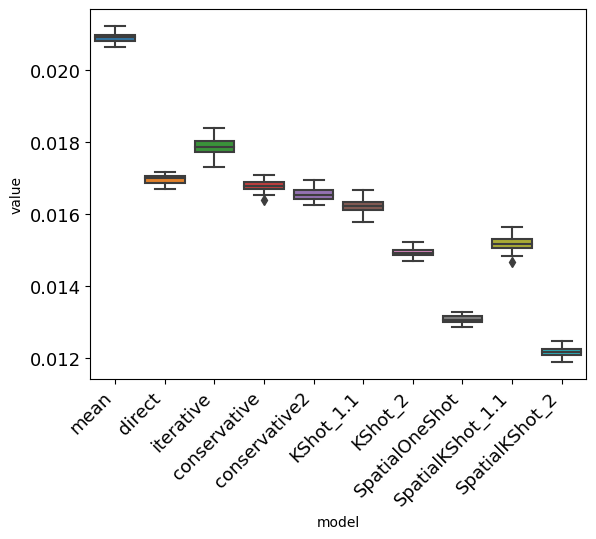

In [47]:
ax = sn.boxplot(data=df2[df2["metric"]=="mean_location_norm_error"], x="model", y="value")
plt.setp(ax.get_xticklabels(), rotation=45, ha='right')
plt.show()

In [48]:
#df2.to_json("KShot_error_df.json")

## Variance profiles' learning comparison

In [96]:
sigmas_dict = {}
for model in models:
        sigmas_dict[model] = []

for ann in range(n_annotators):

    for model in models:
        if model in ['SpatialOneShot', 'SpatialKShot_2']:
            mean_sigma_functions = 0
            for i in range(iterations):
                mean_sigma_functions += df2[df2['model']==model].sigmas.values[i][ann]
            sigma_ann = mean_sigma_functions/iterations
            sigmas_dict[model].append(sigma_ann)
        
            
        else:
            sigma_ann = df2[df2['model']==model].sigmas.values.mean()[ann]
        
            sigmas_dict[model].append(sigma_ann)

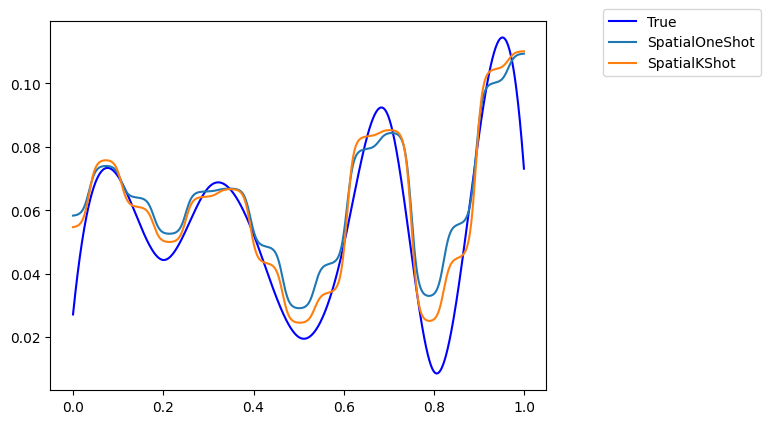

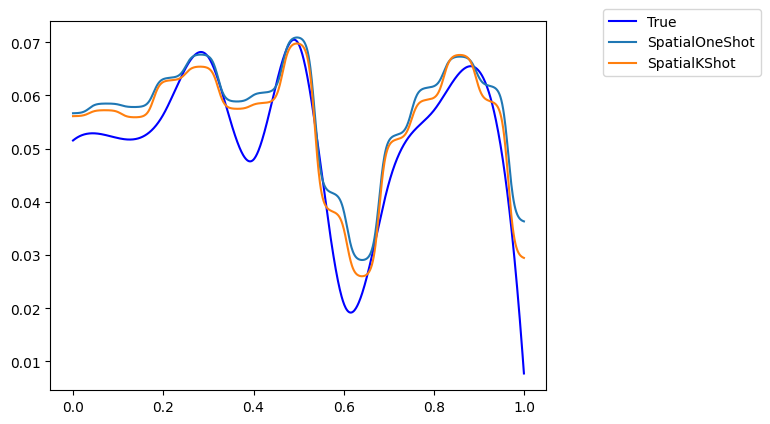

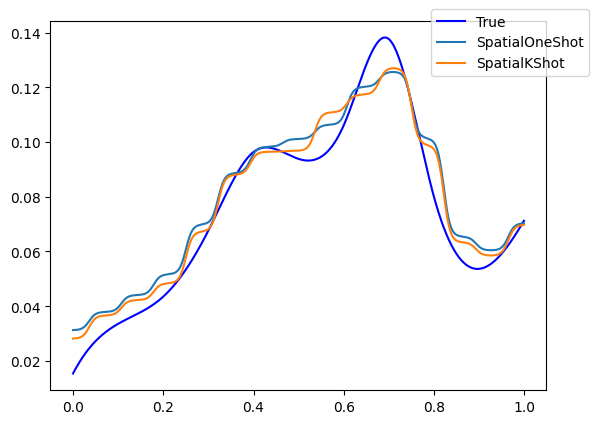

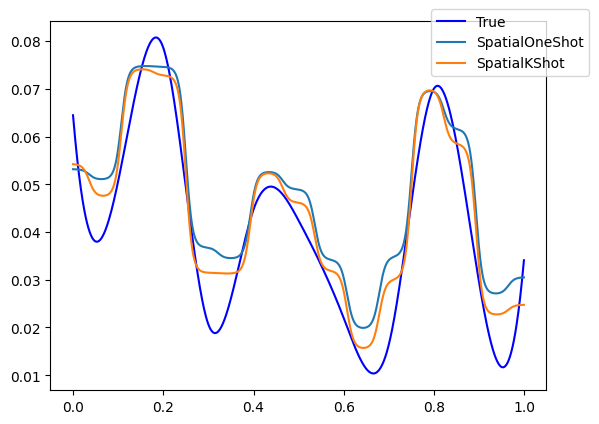

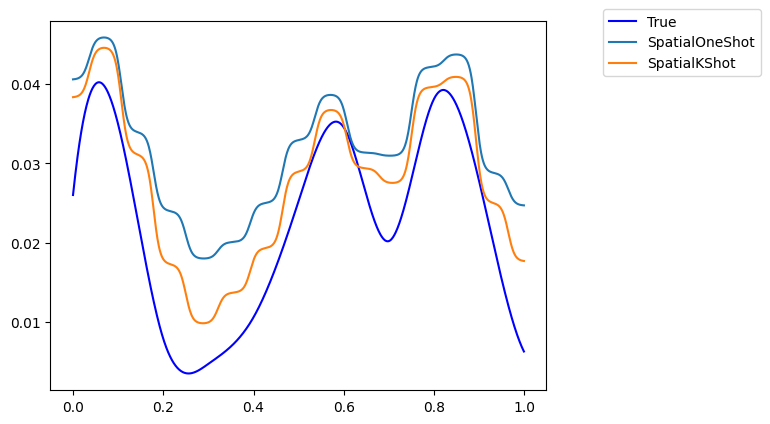

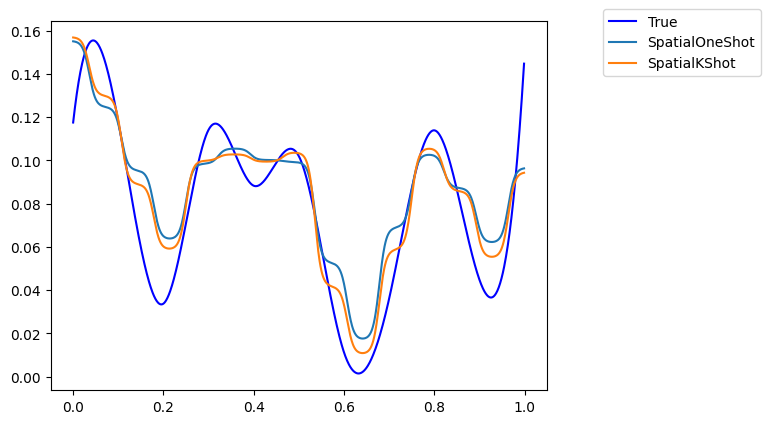

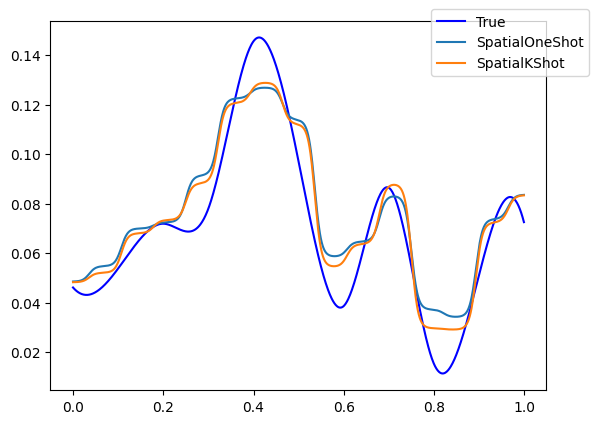

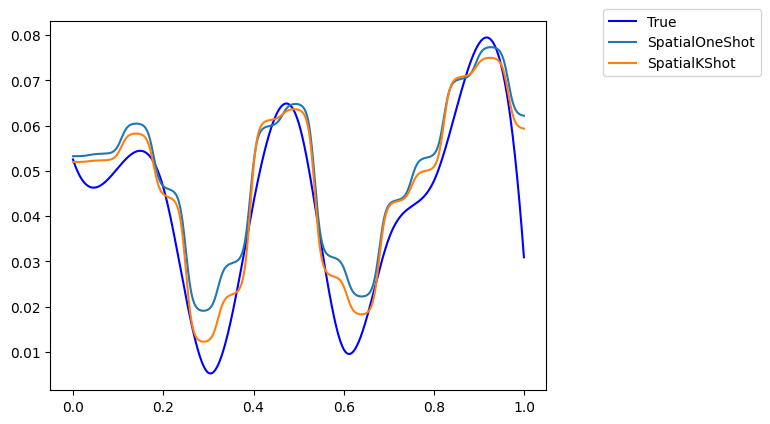

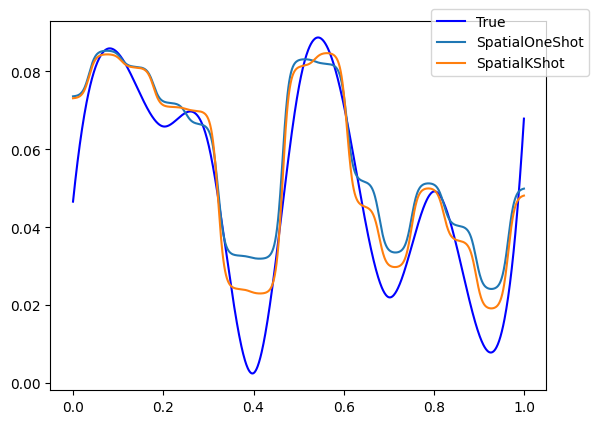

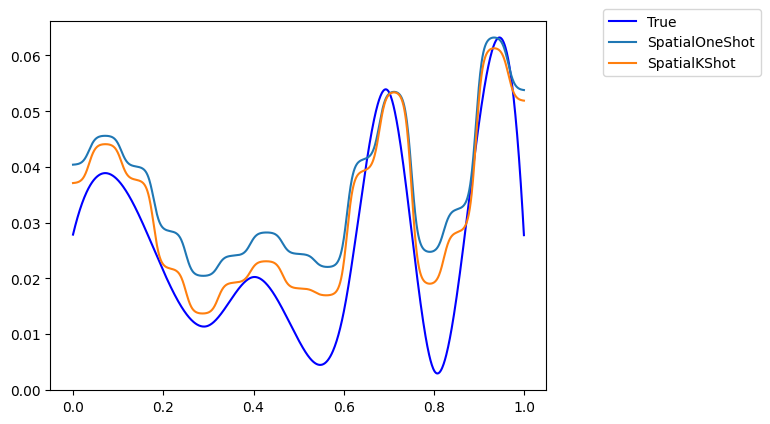

In [107]:
allx = np.arange(1000) / 1000.

for ann in range(n_annotators):
    plt.plot(allx, ann_set.annotators[ann].sigma(allx), 'b', label='True')
    plt.plot(allx, sigmas_plot_df.SpatialOneShot[ann], label = 'SpatialOneShot')
    plt.plot(allx, sigmas_plot_df.SpatialKShot_2[ann], label = 'SpatialKShot')
    plt.legend(bbox_to_anchor=(1.1,1.05))
    plt.show()

In [112]:
sigmas_plot_df = pd.DataFrame(sigmas_dict)
#sigmas_plot_df.to_json('sigmas_plot_df.json')
#sigmas_plot_df = pd.read_json('sigmas_plot_df.json')

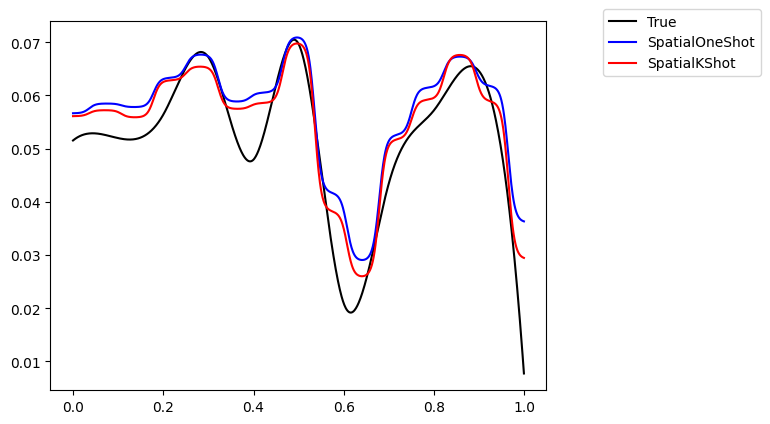

In [6]:
plt.plot(allx, ann_set.annotators[1].sigma(allx), 'black', label='True')
plt.plot(allx, sigmas_plot_df.SpatialOneShot[1], label = 'SpatialOneShot', color ='blue')
plt.plot(allx, sigmas_plot_df.SpatialKShot_2[1], label = 'SpatialKShot', color='red')
plt.legend(bbox_to_anchor=(1.1,1.05))
plt.show()

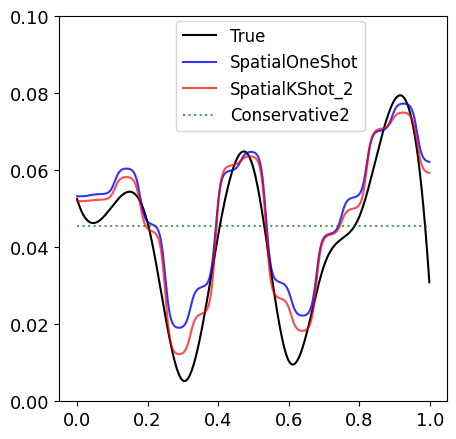

In [64]:
plt.plot(allx, ann_set.annotators[7].sigma(allx), 'black', label='True', alpha=1)
plt.plot(allx, sigmas_plot_df.SpatialOneShot[7], label = 'SpatialOneShot', color ='blue', alpha = 0.8)
plt.plot(allx, sigmas_plot_df.SpatialKShot_2[7], label = 'SpatialKShot_2', color='red', alpha=0.7)
plt.plot(allx, [sigmas_plot_df.conservative2[7]]*len(allx), label = 'Conservative2', alpha = 0.7, ls=':', color='green')
plt.legend(bbox_to_anchor=(0.28,0.68), fontsize=12)
plt.ylim(0,0.1)
# plt.legend(loc='upper center', bbox_to_anchor=(0.5,-0.15), fancybox=True, shadow=True, ncol=4)
# plt.xlabel("Position")
# plt.ylabel("Sigma value")
plt.rc('xtick', labelsize=13)  
plt.rc('ytick', labelsize=13)
plt.gcf().set_size_inches(5,5)
plt.show()

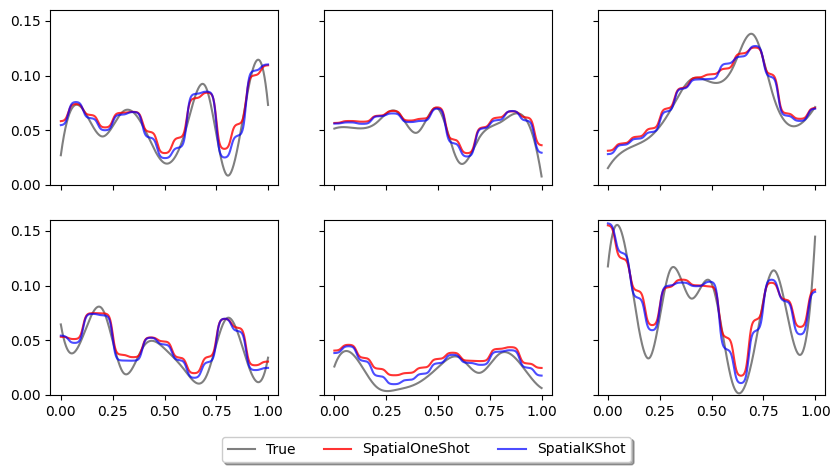

In [101]:
fig, ((ax1, ax2, ax3), (ax4, ax5, ax6)) = plt.subplots(2, 3, figsize=(10,5))
# fig.suptitle('Sharing x per column, y per row')
ax1.plot(allx, ann_set.annotators[0].sigma(allx), label='True', alpha = 0.5, color='black')
ax1.plot(allx, sigmas_plot_df.SpatialOneShot[0], label = 'SpatialOneShot', alpha = 0.8, color = 'red')
ax1.plot(allx, sigmas_plot_df.SpatialKShot_2[0], label = 'SpatialKShot', alpha = 0.7, color = 'blue')

ax2.plot(allx, ann_set.annotators[1].sigma(allx), label='True', alpha = 0.5, color='black')
ax2.plot(allx, sigmas_plot_df.SpatialOneShot[1], label = 'SpatialOneShot', alpha = 0.8, color = 'red')
ax2.plot(allx, sigmas_plot_df.SpatialKShot_2[1], label = 'SpatialKShot', alpha = 0.7, color = 'blue')

ax3.plot(allx, ann_set.annotators[2].sigma(allx), label='True', alpha = 0.5, color='black')
ax3.plot(allx, sigmas_plot_df.SpatialOneShot[2], label = 'SpatialOneShot', alpha = 0.8, color = 'red')
ax3.plot(allx, sigmas_plot_df.SpatialKShot_2[2], label = 'SpatialKShot', alpha = 0.7, color = 'blue')

ax4.plot(allx, ann_set.annotators[3].sigma(allx), label='True', alpha = 0.5, color='black')
ax4.plot(allx, sigmas_plot_df.SpatialOneShot[3], label = 'SpatialOneShot', alpha = 0.8, color = 'red')
ax4.plot(allx, sigmas_plot_df.SpatialKShot_2[3], label = 'SpatialKShot', alpha = 0.7, color = 'blue')

ax5.plot(allx, ann_set.annotators[4].sigma(allx), label='True', alpha = 0.5, color='black')
ax5.plot(allx, sigmas_plot_df.SpatialOneShot[4], label = 'SpatialOneShot', alpha = 0.8, color = 'red')
ax5.plot(allx, sigmas_plot_df.SpatialKShot_2[4], label = 'SpatialKShot', alpha = 0.7, color = 'blue')

ax6.plot(allx, ann_set.annotators[5].sigma(allx), label='True', alpha = 0.5, color='black')
ax6.plot(allx, sigmas_plot_df.SpatialOneShot[5], label = 'SpatialOneShot', alpha = 0.8, color = 'red')
ax6.plot(allx, sigmas_plot_df.SpatialKShot_2[5], label = 'SpatialKShot', alpha = 0.7, color = 'blue')

for ax in fig.get_axes():
    ax.label_outer()
    ax.set_ylim([0,0.16])
    
plt.legend(loc='upper center', bbox_to_anchor=(-0.75,-0.2), fancybox=True, shadow=True, ncol=5)

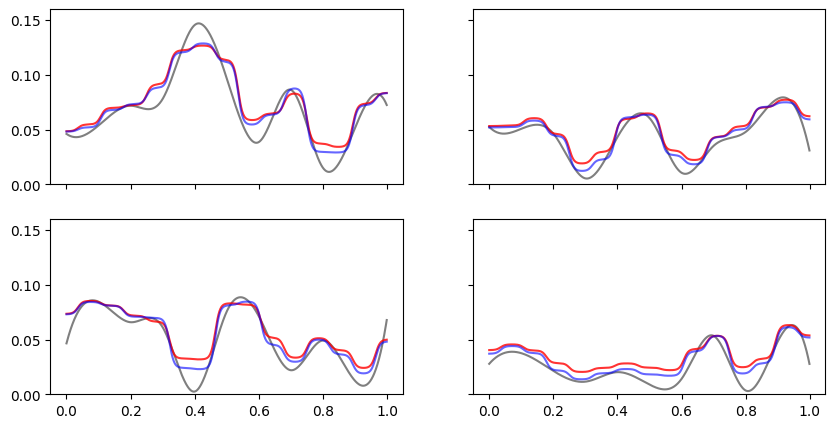

In [77]:
fig, ((ax7, ax8), (ax9, ax10)) = plt.subplots(2, 2, figsize=(10,5))
# fig.suptitle('Sharing x per column, y per row')
ax7.plot(allx, ann_set.annotators[6].sigma(allx), label='True', alpha = 0.5, color = 'black')
ax7.plot(allx, sigmas_plot_df.SpatialOneShot[6], label = 'SpatialOneShot', alpha = 0.8, color = 'red')
ax7.plot(allx, sigmas_plot_df.SpatialKShot_2[6], label = 'SpatialKShot', alpha = 0.6, color = 'blue')

ax8.plot(allx, ann_set.annotators[7].sigma(allx), 'black', label='True', alpha = 0.5)
ax8.plot(allx, sigmas_plot_df.SpatialOneShot[7], label = 'SpatialOneShot', alpha = 0.8, color = 'red')
ax8.plot(allx, sigmas_plot_df.SpatialKShot_2[7], label = 'SpatialKShot', alpha = 0.6, color = 'blue')

ax9.plot(allx, ann_set.annotators[8].sigma(allx), 'black', label='True', alpha = 0.5)
ax9.plot(allx, sigmas_plot_df.SpatialOneShot[8], label = 'SpatialOneShot', alpha = 0.8, color = 'red')
ax9.plot(allx, sigmas_plot_df.SpatialKShot_2[8], label = 'SpatialKShot', alpha = 0.6, color = 'blue')

ax10.plot(allx, ann_set.annotators[9].sigma(allx), 'black', label='True', alpha = 0.5)
ax10.plot(allx, sigmas_plot_df.SpatialOneShot[9], label = 'SpatialOneShot', alpha = 0.8, color = 'red')
ax10.plot(allx, sigmas_plot_df.SpatialKShot_2[9], label = 'SpatialKShot', alpha = 0.6, color = 'blue')


for ax in fig.get_axes():
    ax.label_outer()
    ax.set_ylim([0,0.16])
    

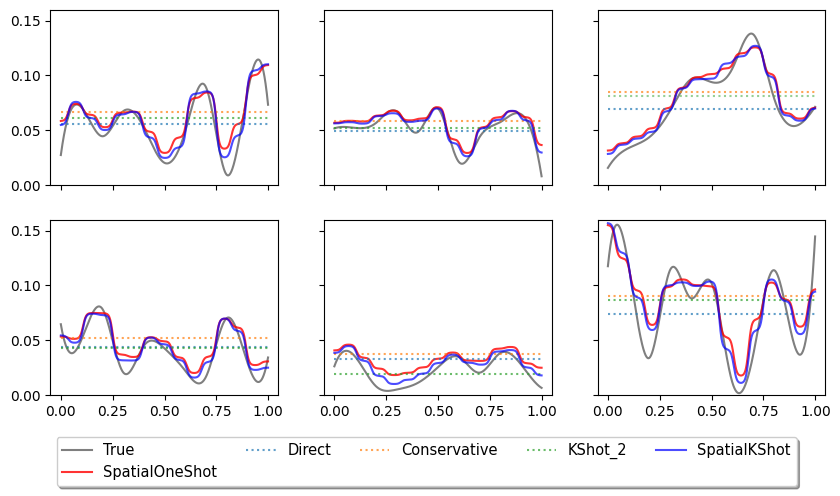

In [13]:
fig, ((ax1, ax2, ax3), (ax4, ax5, ax6)) = plt.subplots(2, 3, figsize=(10,5))
# fig.suptitle('Sharing x per column, y per row')
ax1.plot(allx, ann_set.annotators[0].sigma(allx), label='True', alpha = 0.5, color='black')
ax1.plot(allx, sigmas_plot_df.SpatialOneShot[0], label = 'SpatialOneShot', alpha = 0.8, color = 'red')
ax1.plot(allx, [sigmas_plot_df.direct[0]]*len(allx), label = 'Direct', alpha = 0.7, ls=':')
# ax1.plot(allx, [sigmas_plot_df.iterative[0]]*len(allx), label = 'Iterative', alpha = 0.7, ls=':')
ax1.plot(allx, [sigmas_plot_df.conservative[0]]*len(allx), label = 'Conservative', alpha = 0.7, ls=':')
# ax1.plot(allx, [sigmas_plot_df.conservative2[0]]*len(allx), label = 'Conservative2', alpha = 0.7, ls=':')
ax1.plot(allx, [sigmas_plot_df.KShot_2[0]]*len(allx), label = 'KShot_2', alpha = 0.7, ls=':')
ax1.plot(allx, sigmas_plot_df.SpatialKShot_2[0], label = 'SpatialKShot', alpha = 0.7, color = 'blue')

ax2.plot(allx, ann_set.annotators[1].sigma(allx), label='True', alpha = 0.5, color='black')
ax2.plot(allx, sigmas_plot_df.SpatialOneShot[1], label = 'SpatialOneShot', alpha = 0.8, color = 'red')
ax2.plot(allx, [sigmas_plot_df.direct[1]]*len(allx), label = 'Direct', alpha = 0.7, ls=':')
# ax2.plot(allx, [sigmas_plot_df.iterative[1]]*len(allx), label = 'Iterative', alpha = 0.7, ls=':')
ax2.plot(allx, [sigmas_plot_df.conservative[1]]*len(allx), label = 'Conservative', alpha = 0.7, ls=':')
# ax2.plot(allx, [sigmas_plot_df.conservative2[1]]*len(allx), label = 'Conservative2', alpha = 0.7, ls=':')
ax2.plot(allx, [sigmas_plot_df.KShot_2[1]]*len(allx), label = 'KShot_2', alpha = 0.7, ls=':')
ax2.plot(allx, sigmas_plot_df.SpatialKShot_2[1], label = 'SpatialKShot', alpha = 0.7, color = 'blue')

ax3.plot(allx, ann_set.annotators[2].sigma(allx), label='True', alpha = 0.5, color='black')
ax3.plot(allx, sigmas_plot_df.SpatialOneShot[2], label = 'SpatialOneShot', alpha = 0.8, color = 'red')
ax3.plot(allx, [sigmas_plot_df.direct[2]]*len(allx), label = 'Direct', alpha = 0.7, ls=':')
# ax3.plot(allx, [sigmas_plot_df.iterative[2]]*len(allx), label = 'Iterative', alpha = 0.7, ls=':')
ax3.plot(allx, [sigmas_plot_df.conservative[2]]*len(allx), label = 'Conservative', alpha = 0.7, ls=':')
# ax3.plot(allx, [sigmas_plot_df.conservative2[2]]*len(allx), label = 'Conservative2', alpha = 0.9, ls=':')
ax3.plot(allx, [sigmas_plot_df.KShot_2[2]]*len(allx), label = 'KShot_2', alpha = 0.5, ls=':')
ax3.plot(allx, sigmas_plot_df.SpatialKShot_2[2], label = 'SpatialKShot', alpha = 0.7, color = 'blue')

ax4.plot(allx, ann_set.annotators[3].sigma(allx), label='True', alpha = 0.5, color='black')
ax4.plot(allx, sigmas_plot_df.SpatialOneShot[3], label = 'SpatialOneShot', alpha = 0.8, color = 'red')
ax4.plot(allx, [sigmas_plot_df.direct[3]]*len(allx), label = 'Direct', alpha = 0.7, ls=':')
# ax4.plot(allx, [sigmas_plot_df.iterative[3]]*len(allx), label = 'Iterative', alpha = 0.7, ls=':')
ax4.plot(allx, [sigmas_plot_df.conservative[3]]*len(allx), label = 'Conservative', alpha = 0.7, ls=':')
# ax4.plot(allx, [sigmas_plot_df.conservative2[3]]*len(allx), label = 'Conservative2', alpha = 0.7, ls=':')
ax4.plot(allx, [sigmas_plot_df.KShot_2[3]]*len(allx), label = 'KShot_2', alpha = 0.7, ls=':')
ax4.plot(allx, sigmas_plot_df.SpatialKShot_2[3], label = 'SpatialKShot', alpha = 0.7, color = 'blue')

ax5.plot(allx, ann_set.annotators[4].sigma(allx), label='True', alpha = 0.5, color='black')
ax5.plot(allx, sigmas_plot_df.SpatialOneShot[4], label = 'SpatialOneShot', alpha = 0.8, color = 'red')
ax5.plot(allx, [sigmas_plot_df.direct[4]]*len(allx), label = 'Direct', alpha = 0.7, ls=':')
# ax5.plot(allx, [sigmas_plot_df.iterative[4]]*len(allx), label = 'Iterative', alpha = 0.7, ls=':')
ax5.plot(allx, [sigmas_plot_df.conservative[4]]*len(allx), label = 'Conservative', alpha = 0.7, ls=':')
# ax5.plot(allx, [sigmas_plot_df.conservative2[4]]*len(allx), label = 'Conservative2', alpha = 0.7, ls=':')
ax5.plot(allx, [sigmas_plot_df.KShot_2[4]]*len(allx), label = 'KShot_2', alpha = 0.7, ls=':')
ax5.plot(allx, sigmas_plot_df.SpatialKShot_2[4], label = 'SpatialKShot', alpha = 0.7, color = 'blue')

ax6.plot(allx, ann_set.annotators[5].sigma(allx), label='True', alpha = 0.5, color='black')
ax6.plot(allx, sigmas_plot_df.SpatialOneShot[5], label = 'SpatialOneShot', alpha = 0.8, color = 'red')
ax6.plot(allx, [sigmas_plot_df.direct[5]]*len(allx), label = 'Direct', alpha = 0.7, ls=':')
# ax6.plot(allx, [sigmas_plot_df.iterative[5]]*len(allx), label = 'Iterative', alpha = 0.7, ls=':')
ax6.plot(allx, [sigmas_plot_df.conservative[5]]*len(allx), label = 'Conservative', alpha = 0.7, ls=':')
# ax6.plot(allx, [sigmas_plot_df.conservative2[5]]*len(allx), label = 'Conservative2', alpha = 0.7, ls=':')
ax6.plot(allx, [sigmas_plot_df.KShot_2[5]]*len(allx), label = 'KShot_2', alpha = 0.7, ls=':')
ax6.plot(allx, sigmas_plot_df.SpatialKShot_2[5], label = 'SpatialKShot', alpha = 0.7, color = 'blue')

for ax in fig.get_axes():
    ax.label_outer()
    ax.set_ylim([0,0.16])
    
plt.legend(loc='upper center', bbox_to_anchor=(-0.75,-0.2), fancybox=True, shadow=True, ncol=5, prop={'size': 10.5})

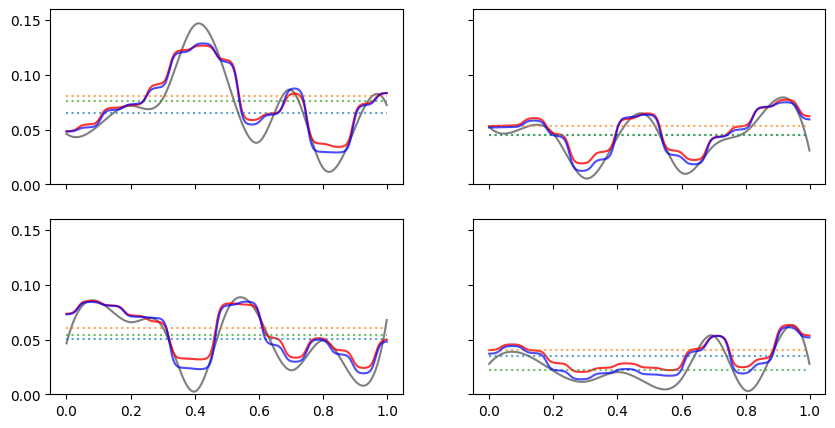

In [8]:
fig, ((ax7, ax8), (ax9, ax10)) = plt.subplots(2, 2, figsize=(10,5))
# fig.suptitle('Sharing x per column, y per row')
ax7.plot(allx, ann_set.annotators[6].sigma(allx), label='True', alpha = 0.5, color = 'black')
ax7.plot(allx, sigmas_plot_df.SpatialOneShot[6], label = 'SpatialOneShot', alpha = 0.8, color = 'red')
ax7.plot(allx, [sigmas_plot_df.direct[6]]*len(allx), label = 'Direct', alpha = 0.7, ls=':')
# ax7.plot(allx, [sigmas_plot_df.iterative[6]*len(allx), label = 'Iterative', alpha = 0.7, ls=':')
ax7.plot(allx, [sigmas_plot_df.conservative[6]]*len(allx), label = 'Conservative', alpha = 0.7, ls=':')
# ax7.plot(allx, [sigmas_plot_df.conservative2[6]]*len(allx), label = 'Conservative2', alpha = 0.7, ls=':')
ax7.plot(allx, [sigmas_plot_df.KShot_2[6]]*len(allx), label = 'KShot_2', alpha = 0.7, ls=':')
ax7.plot(allx, sigmas_plot_df.SpatialKShot_2[6], label = 'SpatialKShot', alpha = 0.7, color = 'blue')

ax8.plot(allx, ann_set.annotators[7].sigma(allx), 'black', label='True', alpha = 0.5)
ax8.plot(allx, sigmas_plot_df.SpatialOneShot[7], label = 'SpatialOneShot', alpha = 0.8, color = 'red')
ax8.plot(allx, [sigmas_plot_df.direct[7]]*len(allx), label = 'Direct', alpha = 0.7, ls=':')
# ax8.plot(allx, [sigmas_plot_df.iterative[7]]*len(allx), label = 'Iterative', alpha = 0.7, ls=':')
ax8.plot(allx, [sigmas_plot_df.conservative[7]]*len(allx), label = 'Conservative', alpha = 0.7, ls=':')
# ax8.plot(allx, [sigmas_plot_df.conservative2[7]]*len(allx), label = 'Conservative2', alpha = 0.7, ls=':')
ax8.plot(allx, [sigmas_plot_df.KShot_2[7]]*len(allx), label = 'KShot_2', alpha = 0.7, ls=':')
ax8.plot(allx, sigmas_plot_df.SpatialKShot_2[7], label = 'SpatialKShot', alpha = 0.7, color = 'blue')

ax9.plot(allx, ann_set.annotators[8].sigma(allx), 'black', label='True', alpha = 0.5)
ax9.plot(allx, sigmas_plot_df.SpatialOneShot[8], label = 'SpatialOneShot', alpha = 0.8, color = 'red')
ax9.plot(allx, [sigmas_plot_df.direct[8]]*len(allx), label = 'Direct', alpha = 0.7, ls=':')
# ax9.plot(allx, [sigmas_plot_df.iterative[8]]*len(allx), label = 'Iterative', alpha = 0.7, ls=':')
ax9.plot(allx, [sigmas_plot_df.conservative[8]]*len(allx), label = 'Conservative', alpha = 0.7, ls=':')
# ax9.plot(allx, [sigmas_plot_df.conservative2[8]]*len(allx), label = 'Conservative2', alpha = 0.7, ls=':')
ax9.plot(allx, [sigmas_plot_df.KShot_2[8]]*len(allx), label = 'KShot_2', alpha = 0.7, ls=':')
ax9.plot(allx, sigmas_plot_df.SpatialKShot_2[8], label = 'SpatialKShot', alpha = 0.7, color = 'blue')

ax10.plot(allx, ann_set.annotators[9].sigma(allx), 'black', label='True', alpha = 0.5)
ax10.plot(allx, sigmas_plot_df.SpatialOneShot[9], label = 'SpatialOneShot', alpha = 0.8, color = 'red')
ax10.plot(allx, [sigmas_plot_df.direct[9]]*len(allx), label = 'Direct', alpha = 0.7, ls=':')
# ax10.plot(allx, [sigmas_plot_df.iterative[9]]*len(allx), label = 'Iterative', alpha = 0.7, ls=':')
ax10.plot(allx, [sigmas_plot_df.conservative[9]]*len(allx), label = 'Conservative', alpha = 0.7, ls=':')
# ax10.plot(allx, [sigmas_plot_df.conservative2[9]]*len(allx), label = 'Conservative2', alpha = 0.7, ls=':')
ax10.plot(allx, [sigmas_plot_df.KShot_2[9]]*len(allx), label = 'KShot_2', alpha = 0.7, ls=':')
ax10.plot(allx, sigmas_plot_df.SpatialKShot_2[9], label = 'SpatialKShot', alpha = 0.7, color = 'blue')


for ax in fig.get_axes():
    ax.label_outer()
    ax.set_ylim([0,0.16])
    

## Greediness comparison

In [35]:
exp = ActiveAnnotationContest(points, ann_set, max_total_annotations=n_points*redundancy)

In [36]:
models = {#"mean": OneShotMean(),
#           "direct":OneShotDirect(), 
#           #"iterative":OneShotIterative(), 
#           "conservative2":OneShotConservative2(),
#           #"conservative":OneShotConservative(),
#           "10shot":KShot(),
#           "SpatialOneShot":OneShotSpatialBayesian(),
          "1": KShotSpatial(greediness=1.0),
          "1.1": KShotSpatial(greediness=1.1),
          "1.2": KShotSpatial(greediness=1.2),
          "1.3": KShotSpatial(greediness=1.3),
          "1.4": KShotSpatial(greediness=1.4),
          "1.5": KShotSpatial(greediness=1.5),
          "1.6": KShotSpatial(greediness=1.6),
          "1.7": KShotSpatial(greediness=1.7),
          "1.8": KShotSpatial(greediness=1.8),
          "1.9": KShotSpatial(greediness=1.9),
          "2": KShotSpatial(greediness=2.0)
         }
metrics = {"mean_location_norm_error":mean_location_norm_error}

In [37]:
def compare(models, exp, metrics, repeats):
    results = []
    for model_name, m in models.items():
        print(model_name)
        result = {"model": model_name}
        for i in range(repeats):
            exp.reset()
            this_run = m.run(exp)
            result["iteration"] = i
            for metric_name, metric in metrics.items():
                result["metric"] = metric_name
                result["value"] = metric(exp, this_run)
                results.append(result.copy())
            print('REPEAT NUM:', i)
    return results

In [38]:
results3 = compare(models, exp, metrics, 20)
df3=pd.DataFrame(results3)

1


14:45:32 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/a0gpn2hm.json
Chain [1] init = /tmp/tmpm5ubl4wj/qbddzesm.json
Chain [1] random
Chain [1] seed = 40786
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-makya_0pvw/gp-learn-variances-ma-20230408144532.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10357.9
Chain [1] 

14:45:33 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20       12419.6   2.69901e-05    0.00112497      0.3394           1       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:45:38 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/apsnvf1f.json
Chain [1] init = /tmp/tmpm5ubl4wj/asxkw6_7.json
Chain [1] random
Chain [1] seed = 87218
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mahhmxqirq/gp-learn-variances-ma-20230408144538.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 45329.2
Chain [1] 

14:45:39 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 11       47554.3   2.82433e-05    0.00296443      0.9219      0.9219       13
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


14:45:45 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/2fuy0mc8.json
Chain [1] init = /tmp/tmpm5ubl4wj/ehrcuu2m.json
Chain [1] random
Chain [1] seed = 30534
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mab9b5re1j/gp-learn-variances-ma-20230408144545.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 65203.5
Chain [1] 

14:45:47 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16       73181.6   1.52868e-05    0.00366833      0.3914       0.963       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


14:45:54 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/mjd81aql.json
Chain [1] init = /tmp/tmpm5ubl4wj/lrxekxkb.json
Chain [1] random
Chain [1] seed = 76024
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maacuytyl7/gp-learn-variances-ma-20230408144554.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 84389
Chain [1] It

14:45:56 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       97711.4    6.6256e-05     0.0105847           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


14:46:04 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/pprd3vur.json
Chain [1] init = /tmp/tmpm5ubl4wj/mz5_1q4q.json
Chain [1] random
Chain [1] seed = 1935
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mawv9jmqcu/gp-learn-variances-ma-20230408144604.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 103708
Chain [1] It

14:46:07 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        122117   2.11802e-05    0.00922152      0.7501      0.7501       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
REPEAT NUM: 0


14:46:10 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/tv47s_8y.json
Chain [1] init = /tmp/tmpm5ubl4wj/3n4nrai_.json
Chain [1] random
Chain [1] seed = 10710
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma6kklqux6/gp-learn-variances-ma-20230408144610.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10353.8
Chain [1] 

14:46:10 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       12334.9   4.47791e-05    0.00132417           1           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


14:46:15 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/cg7w9yvv.json
Chain [1] init = /tmp/tmpm5ubl4wj/owg2x9de.json
Chain [1] random
Chain [1] seed = 23972
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma__vxf89_/gp-learn-variances-ma-20230408144615.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 45427.3
Chain [1] 

14:46:16 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 12       47607.4   2.02903e-05    0.00205982      0.4522           1       15
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:46:23 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/swb6rdau.json
Chain [1] init = /tmp/tmpm5ubl4wj/3cvu5i8o.json
Chain [1] random
Chain [1] seed = 94580
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maj4w635pa/gp-learn-variances-ma-20230408144623.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 65261
Chain [1] It

14:46:24 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       73518.5   0.000130724    0.00628356           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:46:31 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/woburt2v.json
Chain [1] init = /tmp/tmpm5ubl4wj/bfsanggw.json
Chain [1] random
Chain [1] seed = 35262
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maa3ce0kcx/gp-learn-variances-ma-20230408144631.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 84614.5
Chain [1] 

14:46:34 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 14       98055.7    5.8357e-05    0.00942853      0.9583      0.9583       16
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:46:41 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/lq0u9kkl.json
Chain [1] init = /tmp/tmpm5ubl4wj/txof1sch.json
Chain [1] random
Chain [1] seed = 93299
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma6f6k5zxf/gp-learn-variances-ma-20230408144641.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 103912
Chain [1] I

14:46:44 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        122346   5.22121e-05    0.00740444           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:46:47 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/etl9nxpl.json
Chain [1] init = /tmp/tmpm5ubl4wj/prveljna.json
Chain [1] random
Chain [1] seed = 99561
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maws9tvhas/gp-learn-variances-ma-20230408144647.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10387.7
Chain [1] 

14:46:47 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24         12365   1.49467e-05    0.00184207      0.4422      0.4422       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:46:52 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/v__iqpct.json
Chain [1] init = /tmp/tmpm5ubl4wj/z2lny2ne.json
Chain [1] random
Chain [1] seed = 44897
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mabrit6njp/gp-learn-variances-ma-20230408144652.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 45420.3
Chain [1] 

14:46:53 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 12       47767.6   2.31856e-05    0.00153178           1           1       14
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:47:00 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/h7uoil0j.json
Chain [1] init = /tmp/tmpm5ubl4wj/szy5kxm3.json
Chain [1] random
Chain [1] seed = 15018
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mazn126lw7/gp-learn-variances-ma-20230408144700.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 65440.2
Chain [1] 

14:47:02 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16         74032   2.00061e-05    0.00340907      0.7897      0.7897       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


14:47:09 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/kzr73ggo.json
Chain [1] init = /tmp/tmpm5ubl4wj/eyz0gg3r.json
Chain [1] random
Chain [1] seed = 72346
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mak_t_ou_n/gp-learn-variances-ma-20230408144709.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 84754.9
Chain [1] 

14:47:11 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16       98572.7   1.54793e-05    0.00298215      0.7852      0.7852       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


14:47:19 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/o38a3ikk.json
Chain [1] init = /tmp/tmpm5ubl4wj/p472j99h.json
Chain [1] random
Chain [1] seed = 88803
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mapixq2i1a/gp-learn-variances-ma-20230408144719.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 104061
Chain [1] I

14:47:21 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        122861   1.80591e-05    0.00345758      0.8511      0.8511       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:47:24 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/cmye41ka.json
Chain [1] init = /tmp/tmpm5ubl4wj/wl3vs7rg.json
Chain [1] random
Chain [1] seed = 86342
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maem7j6rf5/gp-learn-variances-ma-20230408144724.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10371.5
Chain [1] 

14:47:25 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       12421.1   5.14124e-05    0.00107286           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:47:30 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/f1co0nyl.json
Chain [1] init = /tmp/tmpm5ubl4wj/ing92583.json
Chain [1] random
Chain [1] seed = 63535
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-man5b1x8mm/gp-learn-variances-ma-20230408144730.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 45274.5
Chain [1] 

14:47:30 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 11       47608.4   5.07866e-05     0.0058954      0.9165      0.9165       13
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:47:37 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/g0l2bo_u.json
Chain [1] init = /tmp/tmpm5ubl4wj/dlgur5km.json
Chain [1] random
Chain [1] seed = 92848
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma0zx659m6/gp-learn-variances-ma-20230408144737.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 65163.7
Chain [1] 

14:47:39 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16       73400.3   2.10601e-05    0.00506212       0.924       0.924       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:47:46 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/1i4mawbd.json
Chain [1] init = /tmp/tmpm5ubl4wj/37ol2jkp.json
Chain [1] random
Chain [1] seed = 81616
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mabvuqg6jw/gp-learn-variances-ma-20230408144746.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 84553.6
Chain [1] 

14:47:48 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       97990.9    2.0848e-05    0.00444359      0.9304      0.9304       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:47:56 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/ypolk_hz.json
Chain [1] init = /tmp/tmpm5ubl4wj/ir9edg03.json
Chain [1] random
Chain [1] seed = 30812
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mancwih3q2/gp-learn-variances-ma-20230408144756.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 103675
Chain [1] I

14:47:58 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 14        122135   5.71396e-05     0.0112085           1           1       16
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


14:48:01 - cmdstanpy - INFO - Chain [1] start processing


REPEAT NUM: 3
Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/362jk_od.json
Chain [1] init = /tmp/tmpm5ubl4wj/1a3kbj9b.json
Chain [1] random
Chain [1] seed = 98738
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma8doujet9/gp-learn-variances-ma-20230408144801.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 1042

14:48:02 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       12412.7   3.44578e-05    0.00092093           1           1       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:48:07 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/xo66wbyz.json
Chain [1] init = /tmp/tmpm5ubl4wj/1i5bkx2_.json
Chain [1] random
Chain [1] seed = 41213
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maupfad0on/gp-learn-variances-ma-20230408144807.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 45385
Chain [1] It

14:48:08 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 12       47664.4   2.63355e-05    0.00309208      0.7904      0.7904       14
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:48:14 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/9q1cuaby.json
Chain [1] init = /tmp/tmpm5ubl4wj/21r3gqmr.json
Chain [1] random
Chain [1] seed = 68300
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maoi1ax9k9/gp-learn-variances-ma-20230408144814.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 65351.5
Chain [1] 

14:48:16 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       73646.9   6.35421e-05    0.00947912           1           1       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


14:48:23 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/fnwiewy0.json
Chain [1] init = /tmp/tmpm5ubl4wj/v3ck05ky.json
Chain [1] random
Chain [1] seed = 48827
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma6_36_tw1/gp-learn-variances-ma-20230408144823.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 84687
Chain [1] It

14:48:25 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       98166.9   2.34165e-05    0.00752561      0.6896      0.6896       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:48:33 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/egpi3_4t.json
Chain [1] init = /tmp/tmpm5ubl4wj/yawp2mbc.json
Chain [1] random
Chain [1] seed = 38524
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-manqlhni_g/gp-learn-variances-ma-20230408144833.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 103844
Chain [1] I

14:48:35 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        122196   3.37441e-05     0.0115858           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


14:48:38 - cmdstanpy - INFO - Chain [1] start processing


REPEAT NUM: 4
Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/pi84ip9l.json
Chain [1] init = /tmp/tmpm5ubl4wj/qn8nk7pf.json
Chain [1] random
Chain [1] seed = 75626
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maplou83ov/gp-learn-variances-ma-20230408144838.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 1042

14:48:39 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       12458.6   2.34004e-05    0.00117376      0.9324      0.9324       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


14:48:44 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/4voqjc8o.json
Chain [1] init = /tmp/tmpm5ubl4wj/myde0qiq.json
Chain [1] random
Chain [1] seed = 7926
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma9wf3fi3e/gp-learn-variances-ma-20230408144844.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 45471.4
Chain [1] I

14:48:45 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 11       47835.5   3.59042e-05    0.00353554      0.9727      0.9727       13
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


14:48:51 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/g0pym9qu.json
Chain [1] init = /tmp/tmpm5ubl4wj/2qqr7d2c.json
Chain [1] random
Chain [1] seed = 76021
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma_7p6ebyq/gp-learn-variances-ma-20230408144851.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 65316.5
Chain [1] 

14:48:53 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       73716.8   0.000118379    0.00619922           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:49:00 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/7k1jr9sh.json
Chain [1] init = /tmp/tmpm5ubl4wj/dqswh0gi.json
Chain [1] random
Chain [1] seed = 47925
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mawhh3x8qz/gp-learn-variances-ma-20230408144900.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 84661.7
Chain [1] 

14:49:03 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16       98167.9   1.00015e-05    0.00201438       0.398      0.9642       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


14:49:10 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/vrmzkwxc.json
Chain [1] init = /tmp/tmpm5ubl4wj/1ifua2rv.json
Chain [1] random
Chain [1] seed = 16105
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maug2ytoiu/gp-learn-variances-ma-20230408144910.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 103947
Chain [1] I

14:49:13 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 14        122791   5.68833e-05    0.00550839           1           1       16
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

REPEAT NUM: 5


14:49:16 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/ofzl42_9.json
Chain [1] init = /tmp/tmpm5ubl4wj/r3atbsav.json
Chain [1] random
Chain [1] seed = 35420
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mazvztp23n/gp-learn-variances-ma-20230408144916.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10366.5
Chain [1] 

14:49:16 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       12393.4   5.61737e-05    0.00103125           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:49:21 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/_5gyxa_i.json
Chain [1] init = /tmp/tmpm5ubl4wj/x64zywo9.json
Chain [1] random
Chain [1] seed = 4121
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-masocuoohq/gp-learn-variances-ma-20230408144921.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 45520.8
Chain [1] I

14:49:22 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 12       47863.3   1.63976e-05    0.00279071       0.696       0.696       14
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


14:49:29 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/kxex3r8f.json
Chain [1] init = /tmp/tmpm5ubl4wj/6ze5wad_.json
Chain [1] random
Chain [1] seed = 57193
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maly1e4all/gp-learn-variances-ma-20230408144929.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 65260.7
Chain [1] 

14:49:31 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16         73344   1.67606e-05    0.00356463      0.3081      0.9863       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


14:49:38 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/bs5sjnre.json
Chain [1] init = /tmp/tmpm5ubl4wj/hg0a934b.json
Chain [1] random
Chain [1] seed = 99681
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mamlpvwzlh/gp-learn-variances-ma-20230408144938.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 84689.5
Chain [1] 

14:49:40 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15         98005   2.62183e-05    0.00446335           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


14:49:47 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/j67xphau.json
Chain [1] init = /tmp/tmpm5ubl4wj/xlllpg5s.json
Chain [1] random
Chain [1] seed = 7040
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mad2o_e6_v/gp-learn-variances-ma-20230408144947.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 103910
Chain [1] It

14:49:50 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        122231   4.44087e-05    0.00755022           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:49:53 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/vcse_8gu.json
Chain [1] init = /tmp/tmpm5ubl4wj/ei3003m9.json
Chain [1] random
Chain [1] seed = 20663
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maj5forwns/gp-learn-variances-ma-20230408144953.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10445.3
Chain [1] 

14:49:54 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       12461.4   3.29645e-05   0.000975872           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:49:59 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/v0vyk_be.json
Chain [1] init = /tmp/tmpm5ubl4wj/6u9gphcx.json
Chain [1] random
Chain [1] seed = 76334
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maz1vxwh62/gp-learn-variances-ma-20230408144959.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 45483.7
Chain [1] 

14:50:00 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 13       47765.6   2.17234e-05    0.00059904           1           1       15
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:50:06 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/kvapdank.json
Chain [1] init = /tmp/tmpm5ubl4wj/ncfwah81.json
Chain [1] random
Chain [1] seed = 41508
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma88myt_6d/gp-learn-variances-ma-20230408145006.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 65289.9
Chain [1] 

14:50:08 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       73371.4     5.527e-05     0.0062096           1           1       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:50:15 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/e9w4fusa.json
Chain [1] init = /tmp/tmpm5ubl4wj/ruux5fyw.json
Chain [1] random
Chain [1] seed = 44681
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-masdshi133/gp-learn-variances-ma-20230408145015.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 84631.3
Chain [1] 

14:50:17 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       98012.3   4.02128e-05     0.0152957      0.9594      0.9594       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


14:50:25 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/qn45uu50.json
Chain [1] init = /tmp/tmpm5ubl4wj/os6oj0pe.json
Chain [1] random
Chain [1] seed = 34102
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mall3o77r8/gp-learn-variances-ma-20230408145025.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 103892
Chain [1] I

14:50:28 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        122484   3.28135e-05    0.00591307           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
REPEAT NUM: 7


14:50:30 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/qxol6_cp.json
Chain [1] init = /tmp/tmpm5ubl4wj/ry7xxdkr.json
Chain [1] random
Chain [1] seed = 2137
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-makxmmqnwn/gp-learn-variances-ma-20230408145030.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10400.9
Chain [1] I

14:50:31 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       12505.8   3.57504e-05    0.00108992           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


14:50:36 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/1jkd71ti.json
Chain [1] init = /tmp/tmpm5ubl4wj/58vo3moe.json
Chain [1] random
Chain [1] seed = 22549
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-map37c2d1o/gp-learn-variances-ma-20230408145036.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 45462.6
Chain [1] 

14:50:37 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 12       47800.5    2.4974e-05    0.00197244      0.8838      0.8838       14
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


14:50:43 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/d7q0lfsz.json
Chain [1] init = /tmp/tmpm5ubl4wj/flyg4n3p.json
Chain [1] random
Chain [1] seed = 24956
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-madytgc0sn/gp-learn-variances-ma-20230408145043.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 65500.8
Chain [1] 

14:50:45 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 14       73845.4   4.38873e-05     0.0127169           1           1       16
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:50:52 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/39tft3mo.json
Chain [1] init = /tmp/tmpm5ubl4wj/x9qeb2wt.json
Chain [1] random
Chain [1] seed = 99556
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma2mjkuztt/gp-learn-variances-ma-20230408145052.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 84905.9
Chain [1] 

14:50:54 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       98576.3   4.08298e-05    0.00486217           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


14:51:02 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/nckpbguc.json
Chain [1] init = /tmp/tmpm5ubl4wj/py4mxkoy.json
Chain [1] random
Chain [1] seed = 30515
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maqpo_q57o/gp-learn-variances-ma-20230408145102.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 104046
Chain [1] I

14:51:05 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        122669   2.29862e-05    0.00750684           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

REPEAT NUM: 8


14:51:08 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/gcxwp8fz.json
Chain [1] init = /tmp/tmpm5ubl4wj/hu0bl8em.json
Chain [1] random
Chain [1] seed = 48035
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma86l08gcf/gp-learn-variances-ma-20230408145108.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10342.9
Chain [1] 

14:51:08 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 32       12416.2   1.92627e-05     0.0012933      0.7507      0.7507       36
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:51:13 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/_pthqlhk.json
Chain [1] init = /tmp/tmpm5ubl4wj/frxuw0j2.json
Chain [1] random
Chain [1] seed = 57300
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mav5t6o3dh/gp-learn-variances-ma-20230408145113.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 45253.8
Chain [1] 

14:51:14 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 11       47523.2   7.81421e-05    0.00556784      0.8824      0.8824       13
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:51:20 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/eboc817q.json
Chain [1] init = /tmp/tmpm5ubl4wj/nnun4xgt.json
Chain [1] random
Chain [1] seed = 52943
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maixv31l2l/gp-learn-variances-ma-20230408145120.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 65159.2
Chain [1] 

14:51:22 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       73401.1   6.90942e-05    0.00960264           1           1       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:51:29 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/xyq2w49e.json
Chain [1] init = /tmp/tmpm5ubl4wj/uwzv24_i.json
Chain [1] random
Chain [1] seed = 45325
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maho_6st2i/gp-learn-variances-ma-20230408145129.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 84619.6
Chain [1] 

14:51:31 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       98171.9   2.55734e-05    0.00364274           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:51:39 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/hwsxxn75.json
Chain [1] init = /tmp/tmpm5ubl4wj/9_knmal1.json
Chain [1] random
Chain [1] seed = 50506
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma9q7d4d6v/gp-learn-variances-ma-20230408145139.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 103811
Chain [1] I

14:51:42 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        122450   3.10911e-05    0.00644689           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 9


14:51:45 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/otnnuvez.json
Chain [1] init = /tmp/tmpm5ubl4wj/wf7u_2tr.json
Chain [1] random
Chain [1] seed = 3037
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma76d3plt5/gp-learn-variances-ma-20230408145145.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10402
Chain [1] Ite

14:51:45 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       12487.6   4.77019e-05   0.000823838           1           1       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:51:50 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/irkzb4gh.json
Chain [1] init = /tmp/tmpm5ubl4wj/mvihmb4m.json
Chain [1] random
Chain [1] seed = 95541
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mawd21eoa7/gp-learn-variances-ma-20230408145150.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 45537.4
Chain [1] 

14:51:51 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 11       47972.1   5.52538e-05    0.00472687      0.9406      0.9406       13
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:51:58 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/069ygxs1.json
Chain [1] init = /tmp/tmpm5ubl4wj/uly95hx9.json
Chain [1] random
Chain [1] seed = 74704
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maa62jebnm/gp-learn-variances-ma-20230408145158.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 65492.8
Chain [1] 

14:52:00 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16       73872.6   1.11989e-05    0.00204775      0.4229      0.9951       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:52:07 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/k9ehrgk8.json
Chain [1] init = /tmp/tmpm5ubl4wj/76y4jfti.json
Chain [1] random
Chain [1] seed = 90901
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma5kplzxi2/gp-learn-variances-ma-20230408145207.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 84834.9
Chain [1] 

14:52:09 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 14       98463.1   7.28076e-05    0.00857695           1           1       16
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


14:52:17 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/umiw9_to.json
Chain [1] init = /tmp/tmpm5ubl4wj/x02woivm.json
Chain [1] random
Chain [1] seed = 43968
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-martw3doa1/gp-learn-variances-ma-20230408145217.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 104060
Chain [1] I

14:52:19 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        122962   3.72207e-05    0.00972965      0.7114      0.7114       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

REPEAT NUM: 10


14:52:22 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/ty3lwr2k.json
Chain [1] init = /tmp/tmpm5ubl4wj/u16u305e.json
Chain [1] random
Chain [1] seed = 88070
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma1iudynw6/gp-learn-variances-ma-20230408145222.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10394.3
Chain [1] 

14:52:23 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       12440.1   2.69072e-05   0.000434722           1           1       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:52:28 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/9g8h33j8.json
Chain [1] init = /tmp/tmpm5ubl4wj/r4pf60pf.json
Chain [1] random
Chain [1] seed = 10953
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-markpqsq1k/gp-learn-variances-ma-20230408145228.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 45486.7
Chain [1] 

14:52:29 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 12       47829.9   2.66205e-05    0.00215737      0.9118      0.9118       14
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:52:35 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/0s1or62q.json
Chain [1] init = /tmp/tmpm5ubl4wj/k5h16mxh.json
Chain [1] random
Chain [1] seed = 186
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mabc_n706k/gp-learn-variances-ma-20230408145235.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 65336.6
Chain [1] It

14:52:37 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16       73569.8   1.98624e-05    0.00440056       0.826       0.826       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


14:52:44 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/n1mvsb0j.json
Chain [1] init = /tmp/tmpm5ubl4wj/wlz_uagt.json
Chain [1] random
Chain [1] seed = 14284
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma0pk2z4n8/gp-learn-variances-ma-20230408145244.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 84440.5
Chain [1] 

14:52:46 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       97975.3   3.09721e-05    0.00643699      0.7546      0.7546       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:52:54 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/e46rptk7.json
Chain [1] init = /tmp/tmpm5ubl4wj/42j_1em0.json
Chain [1] random
Chain [1] seed = 92541
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma9lqwf9ur/gp-learn-variances-ma-20230408145254.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 103812
Chain [1] I

14:52:57 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        122540   4.58433e-05     0.0100253           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:52:59 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/kdtdgzm0.json
Chain [1] init = /tmp/tmpm5ubl4wj/wqzwdbzm.json
Chain [1] random
Chain [1] seed = 20200
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maxoxmtdlx/gp-learn-variances-ma-20230408145259.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10381.8
Chain [1] 

14:53:00 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       12399.6   6.86097e-05   0.000705492           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


14:53:05 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/1enky2a9.json
Chain [1] init = /tmp/tmpm5ubl4wj/xe6yea37.json
Chain [1] random
Chain [1] seed = 75996
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma_0ba8vqm/gp-learn-variances-ma-20230408145305.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 45448.2
Chain [1] 

14:53:06 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 12         47845   2.03031e-05    0.00120446           1           1       14
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:53:12 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/98m7gvfo.json
Chain [1] init = /tmp/tmpm5ubl4wj/7ouzumdh.json
Chain [1] random
Chain [1] seed = 53627
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma7znl1flg/gp-learn-variances-ma-20230408145312.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 65358
Chain [1] It

14:53:14 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15         73631   1.52029e-05    0.00341691      0.8419      0.8419       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:53:21 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/suq283dx.json
Chain [1] init = /tmp/tmpm5ubl4wj/1ktoz56y.json
Chain [1] random
Chain [1] seed = 59693
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-marm8sjoul/gp-learn-variances-ma-20230408145321.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 84751.6
Chain [1] 

14:53:23 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       98141.8   4.50819e-05     0.0102616           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


14:53:31 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/vie_9y88.json
Chain [1] init = /tmp/tmpm5ubl4wj/glf1vpf8.json
Chain [1] random
Chain [1] seed = 14220
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-malnz35ym6/gp-learn-variances-ma-20230408145331.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 104003
Chain [1] I

14:53:34 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        122677    3.4977e-05    0.00624251           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:53:36 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/pckaf9pn.json
Chain [1] init = /tmp/tmpm5ubl4wj/arrjgh_f.json
Chain [1] random
Chain [1] seed = 88175
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mavdprj8x0/gp-learn-variances-ma-20230408145336.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10373.2
Chain [1] 

14:53:37 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21         12418   2.67962e-05   0.000773014           1           1       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:53:42 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/yoydnki5.json
Chain [1] init = /tmp/tmpm5ubl4wj/k9qye6nl.json
Chain [1] random
Chain [1] seed = 72720
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mascu6tahv/gp-learn-variances-ma-20230408145342.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 45514.2
Chain [1] 

14:53:43 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 12       47887.3   1.72664e-05    0.00392291       0.626       0.626       14
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:53:49 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/eedkjul9.json
Chain [1] init = /tmp/tmpm5ubl4wj/h61k4e9d.json
Chain [1] random
Chain [1] seed = 43404
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma9oyoqnqx/gp-learn-variances-ma-20230408145349.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 65308.5
Chain [1] 

14:53:51 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16       73575.6   1.17668e-05    0.00181509      0.3079       0.986       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


14:53:58 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/otyq_smv.json
Chain [1] init = /tmp/tmpm5ubl4wj/pi7fkdxx.json
Chain [1] random
Chain [1] seed = 5853
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma74fskppn/gp-learn-variances-ma-20230408145358.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 84678.6
Chain [1] I

14:54:00 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       98227.2   8.39822e-05    0.00824119           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:54:08 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/asetqa8_.json
Chain [1] init = /tmp/tmpm5ubl4wj/5zn00nev.json
Chain [1] random
Chain [1] seed = 11445
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mayelk27ix/gp-learn-variances-ma-20230408145408.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 103902
Chain [1] I

14:54:11 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        122555   1.23128e-05    0.00252337      0.3937      0.9848       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:54:14 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/_dwembml.json
Chain [1] init = /tmp/tmpm5ubl4wj/46jm800a.json
Chain [1] random
Chain [1] seed = 14504
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-madjxgk976/gp-learn-variances-ma-20230408145414.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10398.6
Chain [1] 

14:54:14 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       12438.3   2.92714e-05    0.00103775           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:54:19 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/qwhxl8ln.json
Chain [1] init = /tmp/tmpm5ubl4wj/m8sq1c95.json
Chain [1] random
Chain [1] seed = 63261
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mapdoyefdg/gp-learn-variances-ma-20230408145419.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 45307.7
Chain [1] 

14:54:20 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 11       47606.6   2.97715e-05    0.00355081      0.7684      0.7684       13
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


14:54:27 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/cfqke3b3.json
Chain [1] init = /tmp/tmpm5ubl4wj/tufbyfr5.json
Chain [1] random
Chain [1] seed = 51814
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mam98rp2gq/gp-learn-variances-ma-20230408145427.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 65367.9
Chain [1] 

14:54:29 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16       73867.1   1.96963e-05    0.00369875      0.4745      0.9017       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:54:36 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/s4g2gov2.json
Chain [1] init = /tmp/tmpm5ubl4wj/44_aem_c.json
Chain [1] random
Chain [1] seed = 40791
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mas0_hm73q/gp-learn-variances-ma-20230408145436.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 84656.3
Chain [1] 

14:54:38 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 14       98622.1   5.40075e-05     0.0085817           1           1       16
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


14:54:45 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/pipttsdj.json
Chain [1] init = /tmp/tmpm5ubl4wj/aclzu8m3.json
Chain [1] random
Chain [1] seed = 81839
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mafg9y6dd_/gp-learn-variances-ma-20230408145445.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 103839
Chain [1] I

14:54:48 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 14        122738   2.49086e-05     0.0141588      0.7744      0.7744       16
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
REPEAT NUM: 14


14:54:51 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/xbrbyl8h.json
Chain [1] init = /tmp/tmpm5ubl4wj/4438k8xb.json
Chain [1] random
Chain [1] seed = 65871
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mafrtgl2g8/gp-learn-variances-ma-20230408145451.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10413.6
Chain [1] 

14:54:51 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       12426.7   3.86707e-05    0.00104177           1           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


14:54:56 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/nvrdggvk.json
Chain [1] init = /tmp/tmpm5ubl4wj/5koku3gl.json
Chain [1] random
Chain [1] seed = 57916
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma8aib55b9/gp-learn-variances-ma-20230408145456.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 45502.6
Chain [1] 

14:54:57 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 11       47890.2   5.32147e-05    0.00263591      0.8671      0.8671       13
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:55:04 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/tt6z723p.json
Chain [1] init = /tmp/tmpm5ubl4wj/bo2lctfx.json
Chain [1] random
Chain [1] seed = 43280
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-manpbbqyi1/gp-learn-variances-ma-20230408145504.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 65430.6
Chain [1] 

14:55:06 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       73627.2   6.01184e-05     0.0037358           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:55:13 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/pdjkkuao.json
Chain [1] init = /tmp/tmpm5ubl4wj/xkq_q5u_.json
Chain [1] random
Chain [1] seed = 52815
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma1rulw2s6/gp-learn-variances-ma-20230408145513.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 84760.2
Chain [1] 

14:55:15 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       98195.8   4.13689e-05     0.0133673           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:55:23 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/9es9m1bh.json
Chain [1] init = /tmp/tmpm5ubl4wj/dakqyvh8.json
Chain [1] random
Chain [1] seed = 77604
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mal42k_ml_/gp-learn-variances-ma-20230408145523.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 104091
Chain [1] I

14:55:25 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        122708   3.01955e-05    0.00575488           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

REPEAT NUM: 15


14:55:28 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/ksh0ik13.json
Chain [1] init = /tmp/tmpm5ubl4wj/7_psjvr6.json
Chain [1] random
Chain [1] seed = 87931
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maxku0qx3w/gp-learn-variances-ma-20230408145528.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10347
Chain [1] It

14:55:29 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       12365.7    1.4688e-05   0.000893051       0.326           1       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:55:34 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/4dqdrb1w.json
Chain [1] init = /tmp/tmpm5ubl4wj/45b3bkz8.json
Chain [1] random
Chain [1] seed = 89938
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma12xyo4ax/gp-learn-variances-ma-20230408145534.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 45274.3
Chain [1] 

14:55:35 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 11       47494.9   6.92685e-05    0.00413438           1           1       13
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:55:41 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/tlbnowxc.json
Chain [1] init = /tmp/tmpm5ubl4wj/13lcn0sq.json
Chain [1] random
Chain [1] seed = 42398
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mayxgr4xhm/gp-learn-variances-ma-20230408145541.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 65253.1
Chain [1] 

14:55:43 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16       73481.7   2.22825e-05    0.00339062      0.7995      0.7995       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:55:50 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/0smbyr6c.json
Chain [1] init = /tmp/tmpm5ubl4wj/n57zoqry.json
Chain [1] random
Chain [1] seed = 98071
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-magbo8upva/gp-learn-variances-ma-20230408145550.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 84658.8
Chain [1] 

14:55:52 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       98334.4   2.59289e-05    0.00409553           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:56:00 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/bhyfhkgf.json
Chain [1] init = /tmp/tmpm5ubl4wj/8tn9gzf6.json
Chain [1] random
Chain [1] seed = 60871
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma3ledmuxh/gp-learn-variances-ma-20230408145600.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 103764
Chain [1] I

14:56:03 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        122247   2.33645e-05     0.0054693           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 16


14:56:05 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/hs14mx5d.json
Chain [1] init = /tmp/tmpm5ubl4wj/6t8qo3t7.json
Chain [1] random
Chain [1] seed = 91376
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mab9jl4ghu/gp-learn-variances-ma-20230408145605.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10278.5
Chain [1] 

14:56:06 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       12127.7   2.56509e-05   0.000710061           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


14:56:11 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/wyfu4zdv.json
Chain [1] init = /tmp/tmpm5ubl4wj/n24lqms0.json
Chain [1] random
Chain [1] seed = 4954
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma7nwiieb3/gp-learn-variances-ma-20230408145611.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 45114.5
Chain [1] I

14:56:12 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 11       47249.6   1.98115e-05    0.00135132      0.9486      0.9486       13
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


14:56:18 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/u85pmnpd.json
Chain [1] init = /tmp/tmpm5ubl4wj/7x90eyo4.json
Chain [1] random
Chain [1] seed = 83192
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mae6qd1qk6/gp-learn-variances-ma-20230408145618.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 65008.6
Chain [1] 

14:56:20 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15         73178    3.6529e-05    0.00409978      0.8845      0.8845       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


14:56:27 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/male2f24.json
Chain [1] init = /tmp/tmpm5ubl4wj/c3x05jli.json
Chain [1] random
Chain [1] seed = 25435
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mae_yie2ye/gp-learn-variances-ma-20230408145627.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 84336
Chain [1] It

14:56:29 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       97636.5   3.54524e-05    0.00902597           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:56:37 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/aryj41ij.json
Chain [1] init = /tmp/tmpm5ubl4wj/wx486k03.json
Chain [1] random
Chain [1] seed = 25838
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maxivn5nee/gp-learn-variances-ma-20230408145637.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 103690
Chain [1] I

14:56:40 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        122152   3.53964e-05    0.00540656           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:56:42 - cmdstanpy - INFO - Chain [1] start processing


REPEAT NUM: 17
Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/wrxtz0_h.json
Chain [1] init = /tmp/tmpm5ubl4wj/sdq7ueql.json
Chain [1] random
Chain [1] seed = 1101
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mao5iikhgv/gp-learn-variances-ma-20230408145642.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 1042

14:56:43 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       12393.8   2.20458e-05    0.00155003      0.6438      0.6438       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:56:48 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/apfnkiaf.json
Chain [1] init = /tmp/tmpm5ubl4wj/fcqipqmg.json
Chain [1] random
Chain [1] seed = 20881
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-man0up5v53/gp-learn-variances-ma-20230408145648.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 45288.4
Chain [1] 

14:56:49 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 11       47603.2   3.48236e-05    0.00269608      0.9299      0.9299       13
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


14:56:55 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/76c6y5so.json
Chain [1] init = /tmp/tmpm5ubl4wj/tqb8jit0.json
Chain [1] random
Chain [1] seed = 37956
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maav5ljlw_/gp-learn-variances-ma-20230408145655.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 65144.8
Chain [1] 

14:56:57 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16       73514.2    1.2433e-05     0.0020146        0.35      0.9677       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:57:04 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/ukmx65hb.json
Chain [1] init = /tmp/tmpm5ubl4wj/5efhdf81.json
Chain [1] random
Chain [1] seed = 75857
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-makdks4zbq/gp-learn-variances-ma-20230408145704.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 84585.7
Chain [1] 

14:57:07 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       98320.6   5.33523e-05    0.00899408           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


14:57:14 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/w83udcyv.json
Chain [1] init = /tmp/tmpm5ubl4wj/sjy3bfmm.json
Chain [1] random
Chain [1] seed = 41176
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maq54rfbg8/gp-learn-variances-ma-20230408145714.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 103934
Chain [1] I

14:57:17 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        122786   5.04912e-05    0.00583805           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

REPEAT NUM: 18


14:57:20 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/e5b5xzsl.json
Chain [1] init = /tmp/tmpm5ubl4wj/4fgko7j_.json
Chain [1] random
Chain [1] seed = 29701
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maf84tmb_7/gp-learn-variances-ma-20230408145720.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10351.4
Chain [1] 

14:57:20 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       12330.7   8.13151e-06    0.00154541      0.4196      0.4196       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:57:25 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/8imc1sls.json
Chain [1] init = /tmp/tmpm5ubl4wj/qgitfppz.json
Chain [1] random
Chain [1] seed = 58432
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-macbokg38d/gp-learn-variances-ma-20230408145725.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 45454.8
Chain [1] 

14:57:26 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 12       47696.5   1.94452e-05    0.00164701      0.7618      0.7618       14
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:57:33 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/6ovvbjy3.json
Chain [1] init = /tmp/tmpm5ubl4wj/27bmelad.json
Chain [1] random
Chain [1] seed = 31071
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mapo8m4wa2/gp-learn-variances-ma-20230408145733.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 65338.5
Chain [1] 

14:57:34 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       73684.4   3.39797e-05    0.00651963      0.9135      0.9135       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


14:57:41 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/8hqumw90.json
Chain [1] init = /tmp/tmpm5ubl4wj/a2zkmgqa.json
Chain [1] random
Chain [1] seed = 47890
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mazai3y_w8/gp-learn-variances-ma-20230408145741.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 84651.6
Chain [1] 

14:57:44 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       98071.6   0.000157219    0.00758891           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


14:57:51 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/axvnml7c.json
Chain [1] init = /tmp/tmpm5ubl4wj/dwm_sn0c.json
Chain [1] random
Chain [1] seed = 56333
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mavg9oemjf/gp-learn-variances-ma-20230408145751.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 103769
Chain [1] I

14:57:54 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        122078    4.0779e-05    0.00621255           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:57:56 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/0vfo2bfl.json
Chain [1] init = /tmp/tmpm5ubl4wj/ajsb1ser.json
Chain [1] random
Chain [1] seed = 99060
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maero7u22q/gp-learn-variances-ma-20230408145756.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10405.2
Chain [1] 

14:57:57 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       12438.5   1.89454e-05    0.00133115           1           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:58:02 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/oy82r4vm.json
Chain [1] init = /tmp/tmpm5ubl4wj/h77uxxc1.json
Chain [1] random
Chain [1] seed = 95531
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maqi1p91b7/gp-learn-variances-ma-20230408145802.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46345.8
Chain [1] 

14:58:03 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 13         49362   3.02937e-05    0.00165732           1           1       15
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


14:58:10 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/lpp72a4o.json
Chain [1] init = /tmp/tmpm5ubl4wj/orlpl68j.json
Chain [1] random
Chain [1] seed = 64061
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maaqkansnv/gp-learn-variances-ma-20230408145810.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66383.1
Chain [1] 

14:58:12 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16       76177.5   1.68055e-05     0.0021224      0.4304      0.9508       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


14:58:19 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/z7az87hn.json
Chain [1] init = /tmp/tmpm5ubl4wj/3nknudlr.json
Chain [1] random
Chain [1] seed = 6588
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mag500in5_/gp-learn-variances-ma-20230408145819.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85756.6
Chain [1] I

14:58:21 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        101476   1.59165e-05    0.00397818      0.3878      0.9771       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:58:29 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/n9i5n0yz.json
Chain [1] init = /tmp/tmpm5ubl4wj/acjoskyi.json
Chain [1] random
Chain [1] seed = 11461
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mavdcqsp7m/gp-learn-variances-ma-20230408145829.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105090
Chain [1] I

14:58:32 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126274    2.0645e-05     0.0066954      0.3064      0.9907       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:58:35 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/m2la2wxv.json
Chain [1] init = /tmp/tmpm5ubl4wj/bf2q4szp.json
Chain [1] random
Chain [1] seed = 56630
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mau_1x6l00/gp-learn-variances-ma-20230408145835.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10349.3
Chain [1] 

14:58:35 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       12328.5   2.65611e-05   0.000624899           1           1       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:58:41 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/sawfx4_g.json
Chain [1] init = /tmp/tmpm5ubl4wj/sj0mb2rx.json
Chain [1] random
Chain [1] seed = 54815
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maeoihn0m8/gp-learn-variances-ma-20230408145841.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46187.8
Chain [1] 

14:58:42 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 14       49087.1   2.11248e-05    0.00274376           1           1       16
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


14:58:48 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/f0t_hwtw.json
Chain [1] init = /tmp/tmpm5ubl4wj/b1powv9d.json
Chain [1] random
Chain [1] seed = 36462
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maugx8dhku/gp-learn-variances-ma-20230408145848.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66159.8
Chain [1] 

14:58:51 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       75890.4   7.83575e-05    0.00504365           1           1       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:58:58 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/a57zwrdk.json
Chain [1] init = /tmp/tmpm5ubl4wj/215cia9e.json
Chain [1] random
Chain [1] seed = 83084
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mawt5xdbfj/gp-learn-variances-ma-20230408145858.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85705.7
Chain [1] 

14:59:01 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        101465   3.10267e-05      0.011602      0.8919      0.8919       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:59:09 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/mi5av812.json
Chain [1] init = /tmp/tmpm5ubl4wj/5m76t8ts.json
Chain [1] random
Chain [1] seed = 22711
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mat_srep7a/gp-learn-variances-ma-20230408145909.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 104861
Chain [1] I

14:59:13 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126141   2.02262e-05     0.0083389      0.3707           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:59:16 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/wesx5u7i.json
Chain [1] init = /tmp/tmpm5ubl4wj/86y_sfdc.json
Chain [1] random
Chain [1] seed = 75254
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-manqhc073j/gp-learn-variances-ma-20230408145916.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10412.8
Chain [1] 

14:59:16 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20       12450.6   5.99061e-05   0.000779079           1           1       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:59:22 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/nsjlx6gj.json
Chain [1] init = /tmp/tmpm5ubl4wj/dmgc5z2d.json
Chain [1] random
Chain [1] seed = 67393
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mabg70237t/gp-learn-variances-ma-20230408145922.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46230.4
Chain [1] 

14:59:23 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 13       49189.5     3.714e-05    0.00286006           1           1       15
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:59:29 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/e8axk4ws.json
Chain [1] init = /tmp/tmpm5ubl4wj/kta07vay.json
Chain [1] random
Chain [1] seed = 38755
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maidzayuzi/gp-learn-variances-ma-20230408145929.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66390.9
Chain [1] 

14:59:31 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       76310.2   5.99804e-05     0.0105881       0.899       0.899       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:59:39 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/rq53p2eq.json
Chain [1] init = /tmp/tmpm5ubl4wj/_6c1s88z.json
Chain [1] random
Chain [1] seed = 39859
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maommnx3yp/gp-learn-variances-ma-20230408145939.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85956.4
Chain [1] 

14:59:41 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 17        101690   1.17715e-05      0.006584      0.5929      0.5929       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

14:59:49 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/tc44xe3p.json
Chain [1] init = /tmp/tmpm5ubl4wj/spx5ad6f.json
Chain [1] random
Chain [1] seed = 7723
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-manmnmbe5p/gp-learn-variances-ma-20230408145949.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105295
Chain [1] It

14:59:52 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126665   2.43542e-05    0.00629591       0.354      0.9802       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
REPEAT NUM: 2


14:59:55 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/gwcex9pd.json
Chain [1] init = /tmp/tmpm5ubl4wj/niyb6m8r.json
Chain [1] random
Chain [1] seed = 32075
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maraw9zs0g/gp-learn-variances-ma-20230408145955.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10416.8
Chain [1] 

14:59:56 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       12449.8   6.33016e-06    0.00172455      0.3168      0.3168       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:00:01 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/f15lc8ox.json
Chain [1] init = /tmp/tmpm5ubl4wj/ylf0kk1t.json
Chain [1] random
Chain [1] seed = 66287
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma4e3t30uu/gp-learn-variances-ma-20230408150001.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46287.7
Chain [1] 

15:00:02 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 13       49286.1   4.77555e-05    0.00396661           1           1       15
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:00:08 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/t79ybrca.json
Chain [1] init = /tmp/tmpm5ubl4wj/q166s0q7.json
Chain [1] random
Chain [1] seed = 32024
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maprpiuysd/gp-learn-variances-ma-20230408150008.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66388.5
Chain [1] 

15:00:10 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16       76481.8   2.46673e-05    0.00736291      0.9034      0.9034       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:00:17 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/5fw0ry4j.json
Chain [1] init = /tmp/tmpm5ubl4wj/jf7nj0se.json
Chain [1] random
Chain [1] seed = 690
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mashfmzvw1/gp-learn-variances-ma-20230408150017.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85950.3
Chain [1] It

15:00:20 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 17        102148   1.04457e-05    0.00187725      0.4768       0.926       21
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:00:28 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/lq0nko77.json
Chain [1] init = /tmp/tmpm5ubl4wj/86v7itzp.json
Chain [1] random
Chain [1] seed = 99911
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma494hpckp/gp-learn-variances-ma-20230408150028.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105302
Chain [1] I

15:00:31 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        127042   6.32309e-05     0.0344912      0.9112      0.9112       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 3


15:00:34 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/m7_yjjd8.json
Chain [1] init = /tmp/tmpm5ubl4wj/8s1_zfbg.json
Chain [1] random
Chain [1] seed = 53860
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maa3dvfpml/gp-learn-variances-ma-20230408150034.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10370.3
Chain [1] 

15:00:34 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20       12440.6   5.55678e-05    0.00205135           1           1       23
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:00:39 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/qas4a6hh.json
Chain [1] init = /tmp/tmpm5ubl4wj/wa6ojd1o.json
Chain [1] random
Chain [1] seed = 98694
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma6rapjtts/gp-learn-variances-ma-20230408150039.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46187.5
Chain [1] 

15:00:41 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       49117.5   2.94312e-05    0.00103197           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:00:48 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/clhofxc_.json
Chain [1] init = /tmp/tmpm5ubl4wj/16lofwt2.json
Chain [1] random
Chain [1] seed = 96415
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maplina4m3/gp-learn-variances-ma-20230408150048.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66222.7
Chain [1] 

15:00:50 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 17       76152.1   1.28875e-05    0.00664852        0.59        0.59       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:00:57 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/4n87os9j.json
Chain [1] init = /tmp/tmpm5ubl4wj/o3g_zs40.json
Chain [1] random
Chain [1] seed = 79033
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma1i870n1w/gp-learn-variances-ma-20230408150057.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85658
Chain [1] It

15:01:00 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        101474   1.24562e-05    0.00231781      0.3269      0.9905       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:01:08 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/cup54ada.json
Chain [1] init = /tmp/tmpm5ubl4wj/ey6o9l6m.json
Chain [1] random
Chain [1] seed = 20823
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maoqacepxi/gp-learn-variances-ma-20230408150108.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 104952
Chain [1] I

15:01:11 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126249    1.9284e-05    0.00432013      0.3819      0.9219       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 4


15:01:14 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/c_tzfxib.json
Chain [1] init = /tmp/tmpm5ubl4wj/9sjyp9gz.json
Chain [1] random
Chain [1] seed = 37197
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maxnp_b_w3/gp-learn-variances-ma-20230408150114.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10387.2
Chain [1] 

15:01:14 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       12376.4   2.21711e-05   0.000769557      0.3466      0.9867       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:01:19 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/gw67gvm_.json
Chain [1] init = /tmp/tmpm5ubl4wj/_7eq_shi.json
Chain [1] random
Chain [1] seed = 55512
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma8u663oxn/gp-learn-variances-ma-20230408150119.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46378.5
Chain [1] 

15:01:20 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 13       49550.6   3.91374e-05    0.00287536           1           1       15
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:01:27 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/86r3om27.json
Chain [1] init = /tmp/tmpm5ubl4wj/5_ula343.json
Chain [1] random
Chain [1] seed = 96993
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mafi9silv1/gp-learn-variances-ma-20230408150127.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66311.5
Chain [1] 

15:01:29 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16       76380.6   4.90599e-05     0.0114432           1           1       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:01:36 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/9gtj4asg.json
Chain [1] init = /tmp/tmpm5ubl4wj/ywy4tlqr.json
Chain [1] random
Chain [1] seed = 66954
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maf28be395/gp-learn-variances-ma-20230408150136.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85683.2
Chain [1] 

15:01:38 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 17        101585   1.83129e-05    0.00562721      0.7917      0.7917       21
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:01:46 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/u7zl4s0d.json
Chain [1] init = /tmp/tmpm5ubl4wj/iugn0xen.json
Chain [1] random
Chain [1] seed = 25202
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mammgh98dl/gp-learn-variances-ma-20230408150146.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105026
Chain [1] I

15:01:49 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126294   1.14208e-05     0.0118822      0.5103      0.5103       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

REPEAT NUM: 5


15:01:52 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/6ww631u2.json
Chain [1] init = /tmp/tmpm5ubl4wj/9j7lww65.json
Chain [1] random
Chain [1] seed = 21190
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mar7ykiqho/gp-learn-variances-ma-20230408150152.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10392.2
Chain [1] 

15:01:52 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21       12466.3   2.05372e-05   0.000625474      0.8879      0.8879       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:01:57 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/38ka0cxn.json
Chain [1] init = /tmp/tmpm5ubl4wj/wl7npun1.json
Chain [1] random
Chain [1] seed = 77929
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-macgk12i3d/gp-learn-variances-ma-20230408150157.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46285.2
Chain [1] 

15:01:58 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 13       49370.4   8.11632e-05      0.005061           1           1       15
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:02:05 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/qefk7xw2.json
Chain [1] init = /tmp/tmpm5ubl4wj/8eq79fey.json
Chain [1] random
Chain [1] seed = 61964
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma_0v1ge_n/gp-learn-variances-ma-20230408150205.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66376.8
Chain [1] 

15:02:07 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       76613.8   1.78142e-05    0.00265265      0.4179      0.9624       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:02:13 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/wip0uvyf.json
Chain [1] init = /tmp/tmpm5ubl4wj/ntgtprum.json
Chain [1] random
Chain [1] seed = 60686
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma_wp5hewb/gp-learn-variances-ma-20230408150213.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85823
Chain [1] It

15:02:16 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        101809   4.32908e-05    0.00675073      0.9016      0.9016       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:02:23 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/817m1nk2.json
Chain [1] init = /tmp/tmpm5ubl4wj/j86ghj7d.json
Chain [1] random
Chain [1] seed = 3827
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mabgc389on/gp-learn-variances-ma-20230408150223.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105061
Chain [1] It

15:02:26 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126331   1.95036e-05    0.00485964      0.4104      0.9611       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

REPEAT NUM: 6


15:02:29 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/gj4fgpzj.json
Chain [1] init = /tmp/tmpm5ubl4wj/9n_es4u0.json
Chain [1] random
Chain [1] seed = 42158
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma9uwxpsp2/gp-learn-variances-ma-20230408150229.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10450.9
Chain [1] 

15:02:30 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       12499.2    1.5078e-05    0.00108995      0.8359      0.8359       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:02:35 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/cm1asnlz.json
Chain [1] init = /tmp/tmpm5ubl4wj/zxvkjd7r.json
Chain [1] random
Chain [1] seed = 47349
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma85kpf2zu/gp-learn-variances-ma-20230408150235.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46284.9
Chain [1] 

15:02:36 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 13       49356.2   0.000129033    0.00354512           1           1       15
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:02:42 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/_55qtezs.json
Chain [1] init = /tmp/tmpm5ubl4wj/59ks_a5_.json
Chain [1] random
Chain [1] seed = 78260
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mam_h4ig3b/gp-learn-variances-ma-20230408150242.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66410.5
Chain [1] 

15:02:44 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       76346.4   3.26982e-05    0.00599483           1           1       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:02:51 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/cko3imb9.json
Chain [1] init = /tmp/tmpm5ubl4wj/j2fokert.json
Chain [1] random
Chain [1] seed = 37739
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maf56kbjev/gp-learn-variances-ma-20230408150251.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85852.1
Chain [1] 

15:02:53 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        101830   5.81006e-05     0.0112446      0.8586      0.8586       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:03:01 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/nlgbnzy9.json
Chain [1] init = /tmp/tmpm5ubl4wj/o8c3qzb6.json
Chain [1] random
Chain [1] seed = 48938
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma0d43hru2/gp-learn-variances-ma-20230408150301.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105123
Chain [1] I

15:03:04 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 17        126689   3.32602e-05    0.00331733           1           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:03:07 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/bcj2a5k0.json
Chain [1] init = /tmp/tmpm5ubl4wj/zldbmemz.json
Chain [1] random
Chain [1] seed = 99790
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma3leq14xw/gp-learn-variances-ma-20230408150307.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10421.3
Chain [1] 

15:03:07 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30       12394.2   2.26809e-05    0.00102811      0.2879           1       35
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:03:12 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/c9h88mzd.json
Chain [1] init = /tmp/tmpm5ubl4wj/xals9mos.json
Chain [1] random
Chain [1] seed = 73301
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maioas65rm/gp-learn-variances-ma-20230408150312.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46267.3
Chain [1] 

15:03:13 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 12       49207.2   4.82254e-05     0.0041424      0.8597      0.8597       14
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:03:20 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/r6fjsf_x.json
Chain [1] init = /tmp/tmpm5ubl4wj/lyfpl8ye.json
Chain [1] random
Chain [1] seed = 28692
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-matyef19w1/gp-learn-variances-ma-20230408150320.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66310.1
Chain [1] 

15:03:21 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16       76626.2   1.43463e-05    0.00304496      0.3267      0.9964       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:03:28 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/7f7va31s.json
Chain [1] init = /tmp/tmpm5ubl4wj/7xmwl01l.json
Chain [1] random
Chain [1] seed = 35687
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma1nl0m6gr/gp-learn-variances-ma-20230408150328.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85886.1
Chain [1] 

15:03:31 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        102132   1.88512e-05    0.00894986      0.6589      0.6589       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:03:38 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/au7v0y2b.json
Chain [1] init = /tmp/tmpm5ubl4wj/n0gepmzg.json
Chain [1] random
Chain [1] seed = 88748
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma8vcgh4zy/gp-learn-variances-ma-20230408150338.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105135
Chain [1] I

15:03:41 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126847   2.10364e-05     0.0088678      0.4317           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 8


15:03:44 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/oo8rc012.json
Chain [1] init = /tmp/tmpm5ubl4wj/xl6ilpq7.json
Chain [1] random
Chain [1] seed = 11845
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma8hjj2nec/gp-learn-variances-ma-20230408150344.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10392.1
Chain [1] 

15:03:45 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       12257.2   4.27705e-05    0.00125722      0.8766      0.8766       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:03:50 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/niqhqba8.json
Chain [1] init = /tmp/tmpm5ubl4wj/souabxwz.json
Chain [1] random
Chain [1] seed = 41295
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maw9ku9wg0/gp-learn-variances-ma-20230408150350.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46331.6
Chain [1] 

15:03:51 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 12       49288.6    3.1931e-05     0.0055211      0.6916      0.6916       14
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:03:57 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/nbj3nvp3.json
Chain [1] init = /tmp/tmpm5ubl4wj/c8oaul_b.json
Chain [1] random
Chain [1] seed = 52482
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma8e6m5_7u/gp-learn-variances-ma-20230408150357.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66365.5
Chain [1] 

15:03:59 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       76360.3    6.5043e-05    0.00772338           1           1       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:04:06 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/unqem8go.json
Chain [1] init = /tmp/tmpm5ubl4wj/991pof49.json
Chain [1] random
Chain [1] seed = 82435
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma6hdt60lt/gp-learn-variances-ma-20230408150406.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85758.9
Chain [1] 

15:04:08 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        101622    4.7082e-05     0.0115077      0.4895           1       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:04:15 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/s7dox1bv.json
Chain [1] init = /tmp/tmpm5ubl4wj/8wb05oqe.json
Chain [1] random
Chain [1] seed = 40955
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-matrlp464c/gp-learn-variances-ma-20230408150415.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105007
Chain [1] I

15:04:18 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126016   1.21856e-05    0.00463263      0.3514           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:04:21 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/tf2ev62h.json
Chain [1] init = /tmp/tmpm5ubl4wj/0mahpgsx.json
Chain [1] random
Chain [1] seed = 4501
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maek5km9j8/gp-learn-variances-ma-20230408150421.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10338.8
Chain [1] I

15:04:22 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25         12345   3.66228e-05    0.00142207           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:04:27 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/6x3kwezw.json
Chain [1] init = /tmp/tmpm5ubl4wj/ww1weeod.json
Chain [1] random
Chain [1] seed = 71341
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma1w1i5ybq/gp-learn-variances-ma-20230408150427.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46431.3
Chain [1] 

15:04:28 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 13         49714    5.0681e-05    0.00288984           1           1       15
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:04:34 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/yyfp30v4.json
Chain [1] init = /tmp/tmpm5ubl4wj/2s3angy2.json
Chain [1] random
Chain [1] seed = 26502
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maob5egw9x/gp-learn-variances-ma-20230408150434.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66466
Chain [1] It

15:04:36 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       76645.8   4.34838e-05    0.00832706      0.8258      0.8258       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:04:42 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/q9mynjih.json
Chain [1] init = /tmp/tmpm5ubl4wj/amywnbu7.json
Chain [1] random
Chain [1] seed = 78875
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mao0xvh7t0/gp-learn-variances-ma-20230408150442.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85800.6
Chain [1] 

15:04:45 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        101810   2.45283e-05    0.00600252      0.2936           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:04:52 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/7zza__3j.json
Chain [1] init = /tmp/tmpm5ubl4wj/sww3yqtd.json
Chain [1] random
Chain [1] seed = 18967
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-masq2c0dw0/gp-learn-variances-ma-20230408150452.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105113
Chain [1] I

15:04:55 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126747   2.63315e-05    0.00692366      0.3891           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
REPEAT NUM: 10


15:04:58 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/e613vt37.json
Chain [1] init = /tmp/tmpm5ubl4wj/40ga3kuy.json
Chain [1] random
Chain [1] seed = 84623
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maaril496s/gp-learn-variances-ma-20230408150458.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10331.9
Chain [1] 

15:04:59 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29       12355.6   3.39959e-05   0.000764741      0.8864      0.8864       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:05:04 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/tvb9i7d5.json
Chain [1] init = /tmp/tmpm5ubl4wj/fcalyn5v.json
Chain [1] random
Chain [1] seed = 88673
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-matxb9wqr0/gp-learn-variances-ma-20230408150504.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46326.3
Chain [1] 

15:05:05 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 13       49563.3    6.7826e-05    0.00393937           1           1       15
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:05:11 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/qehpsvz1.json
Chain [1] init = /tmp/tmpm5ubl4wj/ne53klnj.json
Chain [1] random
Chain [1] seed = 8948
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma2xhntlzw/gp-learn-variances-ma-20230408150511.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66300.8
Chain [1] I

15:05:13 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       76235.5   3.85531e-05    0.00916472      0.9131      0.9131       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:05:20 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/i91usaui.json
Chain [1] init = /tmp/tmpm5ubl4wj/mbr0dr_3.json
Chain [1] random
Chain [1] seed = 5470
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maut6688u2/gp-learn-variances-ma-20230408150520.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85690.6
Chain [1] I

15:05:22 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        101464   2.37419e-05    0.00484922           1           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:05:29 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/g84ek8kg.json
Chain [1] init = /tmp/tmpm5ubl4wj/d16q2alr.json
Chain [1] random
Chain [1] seed = 84330
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mazbkyed_g/gp-learn-variances-ma-20230408150529.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 104956
Chain [1] I

15:05:32 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        126131   9.13879e-05     0.0379007           1           1       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 11


15:05:35 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/b9w_yd82.json
Chain [1] init = /tmp/tmpm5ubl4wj/ie1laczs.json
Chain [1] random
Chain [1] seed = 55289
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-massj0j_pz/gp-learn-variances-ma-20230408150535.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10383.5
Chain [1] 

15:05:35 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23         12398   2.37017e-05   0.000697319           1           1       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:05:41 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/kp23c9jf.json
Chain [1] init = /tmp/tmpm5ubl4wj/uqg80p_q.json
Chain [1] random
Chain [1] seed = 23493
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mavh9e9dh9/gp-learn-variances-ma-20230408150541.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46353.8
Chain [1] 

15:05:42 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 13       49560.3   7.70659e-05    0.00261132           1           1       15
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:05:48 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/1xang8j6.json
Chain [1] init = /tmp/tmpm5ubl4wj/xlppx5x4.json
Chain [1] random
Chain [1] seed = 42193
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-madw_d2pkl/gp-learn-variances-ma-20230408150548.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66348.4
Chain [1] 

15:05:50 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       76585.3   0.000104199    0.00515652           1           1       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:05:57 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/c02vdmc6.json
Chain [1] init = /tmp/tmpm5ubl4wj/w7d7_442.json
Chain [1] random
Chain [1] seed = 63521
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-marla07lx2/gp-learn-variances-ma-20230408150557.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85705.6
Chain [1] 

15:05:59 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        101628   1.19639e-05    0.00255441        0.41      0.9788       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:06:07 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/g_ywqjb5.json
Chain [1] init = /tmp/tmpm5ubl4wj/lo2vh_vw.json
Chain [1] random
Chain [1] seed = 43462
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maciguoaoq/gp-learn-variances-ma-20230408150607.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 104987
Chain [1] I

15:06:09 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        126389   8.31583e-05     0.0383029           1           1       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 12


15:06:12 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/80smbqo6.json
Chain [1] init = /tmp/tmpm5ubl4wj/j917h71z.json
Chain [1] random
Chain [1] seed = 4742
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mah3tmydgb/gp-learn-variances-ma-20230408150612.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10421.5
Chain [1] I

15:06:12 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       12511.2   6.72724e-05   0.000593834           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:06:18 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/isq2ifiu.json
Chain [1] init = /tmp/tmpm5ubl4wj/1i9819dp.json
Chain [1] random
Chain [1] seed = 47803
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mam__zuj1s/gp-learn-variances-ma-20230408150618.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46349.3
Chain [1] 

15:06:19 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 13       49394.7   9.62588e-05    0.00543493           1           1       15
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:06:25 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/kvq8wnj9.json
Chain [1] init = /tmp/tmpm5ubl4wj/2g8lt8_b.json
Chain [1] random
Chain [1] seed = 14802
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-man0005gaj/gp-learn-variances-ma-20230408150625.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66288.8
Chain [1] 

15:06:27 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16       76255.9   1.41711e-05    0.00381962       0.376           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:06:34 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/649x31vr.json
Chain [1] init = /tmp/tmpm5ubl4wj/7jvw3qrx.json
Chain [1] random
Chain [1] seed = 37461
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma_vpnqzb3/gp-learn-variances-ma-20230408150634.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85827.7
Chain [1] 

15:06:37 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        101915   1.56561e-05     0.0035206      0.3607      0.9812       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:06:45 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/4xexw6qd.json
Chain [1] init = /tmp/tmpm5ubl4wj/53n5xts3.json
Chain [1] random
Chain [1] seed = 48585
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mad1pnr7p1/gp-learn-variances-ma-20230408150645.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105017
Chain [1] I

15:06:48 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126402    1.1959e-05    0.00644232       0.676       0.676       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 13


15:06:51 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/a1cwoqdr.json
Chain [1] init = /tmp/tmpm5ubl4wj/uhtbjz0z.json
Chain [1] random
Chain [1] seed = 55063
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mani8_517c/gp-learn-variances-ma-20230408150651.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10387.1
Chain [1] 

15:06:52 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       12411.2   1.28619e-05   0.000684368      0.2896           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:06:57 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/zv0qyutq.json
Chain [1] init = /tmp/tmpm5ubl4wj/lpp7bifq.json
Chain [1] random
Chain [1] seed = 86603
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma4117xj9h/gp-learn-variances-ma-20230408150657.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46269
Chain [1] It

15:06:58 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 14       49370.3   2.87707e-05    0.00538366      0.9295      0.9295       16
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:07:04 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/08cyqmzf.json
Chain [1] init = /tmp/tmpm5ubl4wj/ex9ul7tb.json
Chain [1] random
Chain [1] seed = 6701
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma81xw299o/gp-learn-variances-ma-20230408150704.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66356.9
Chain [1] I

15:07:06 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       76321.6   3.63237e-05    0.00693196           1           1       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:07:13 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/jjh62z2e.json
Chain [1] init = /tmp/tmpm5ubl4wj/r25hbkwu.json
Chain [1] random
Chain [1] seed = 79921
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mao0reyl29/gp-learn-variances-ma-20230408150713.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85751.9
Chain [1] 

15:07:16 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        101675   1.37587e-05    0.00271293      0.5084      0.9957       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:07:24 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/j9o8ey_y.json
Chain [1] init = /tmp/tmpm5ubl4wj/iyr2fwl3.json
Chain [1] random
Chain [1] seed = 61396
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maaeamp63n/gp-learn-variances-ma-20230408150724.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105007
Chain [1] I

15:07:27 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126272   1.47661e-05    0.00383438      0.4966           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 14


15:07:30 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/m4y98odz.json
Chain [1] init = /tmp/tmpm5ubl4wj/qxrd8qkv.json
Chain [1] random
Chain [1] seed = 28145
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma_rz1v0m8/gp-learn-variances-ma-20230408150730.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10374.5
Chain [1] 

15:07:30 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21       12400.8   6.83387e-06    0.00172472      0.3841      0.3841       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:07:35 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/5pwxkqcg.json
Chain [1] init = /tmp/tmpm5ubl4wj/mwt9t472.json
Chain [1] random
Chain [1] seed = 27438
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mayaylghhp/gp-learn-variances-ma-20230408150735.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46317.2
Chain [1] 

15:07:37 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 13       49404.5   3.26258e-05    0.00146263      0.9867      0.9867       15
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:07:43 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/sg5p9rmc.json
Chain [1] init = /tmp/tmpm5ubl4wj/_s72sx_m.json
Chain [1] random
Chain [1] seed = 77965
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maf5doen3_/gp-learn-variances-ma-20230408150743.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66354.2
Chain [1] 

15:07:45 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15         76352   2.68328e-05    0.00586664      0.3662           1       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:07:52 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/kx7nw95w.json
Chain [1] init = /tmp/tmpm5ubl4wj/qn1ze_nc.json
Chain [1] random
Chain [1] seed = 80575
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma9leg382n/gp-learn-variances-ma-20230408150752.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85745.2
Chain [1] 

15:07:55 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        101676   1.82358e-05    0.00548926       0.949       0.949       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:08:02 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/9_mhr2ym.json
Chain [1] init = /tmp/tmpm5ubl4wj/ip7b5snn.json
Chain [1] random
Chain [1] seed = 45265
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma2kt4rj3s/gp-learn-variances-ma-20230408150802.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105137
Chain [1] I

15:08:06 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126684   2.14665e-05    0.00580636      0.4948           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 15


15:08:09 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/l3x5vioq.json
Chain [1] init = /tmp/tmpm5ubl4wj/cihd914e.json
Chain [1] random
Chain [1] seed = 40315
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma0c4g35f1/gp-learn-variances-ma-20230408150809.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10349.5
Chain [1] 

15:08:09 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       12282.8   1.13216e-05   0.000499482      0.4338      0.9317       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:08:14 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/w5xrgklt.json
Chain [1] init = /tmp/tmpm5ubl4wj/oe2bf_do.json
Chain [1] random
Chain [1] seed = 10137
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma79vdborb/gp-learn-variances-ma-20230408150814.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46167.5
Chain [1] 

15:08:15 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 13       49116.2   3.04805e-05    0.00272995           1           1       15
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:08:22 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/vom7lxi1.json
Chain [1] init = /tmp/tmpm5ubl4wj/yoxfcwt0.json
Chain [1] random
Chain [1] seed = 55003
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma4_3gg71f/gp-learn-variances-ma-20230408150822.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66244.8
Chain [1] 

15:08:24 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16       76019.3   1.76892e-05    0.00188462      0.7458      0.7458       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:08:31 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/3u5q8ffn.json
Chain [1] init = /tmp/tmpm5ubl4wj/2q6a8oal.json
Chain [1] random
Chain [1] seed = 54983
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mapdf8ajx2/gp-learn-variances-ma-20230408150831.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85777.1
Chain [1] 

15:08:33 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15        101651   0.000164922    0.00693853           1           1       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:08:41 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/fshwv013.json
Chain [1] init = /tmp/tmpm5ubl4wj/_en0bttl.json
Chain [1] random
Chain [1] seed = 90582
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-matztd2ouk/gp-learn-variances-ma-20230408150841.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105061
Chain [1] I

15:08:44 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126337   1.27373e-05    0.00431107      0.4126           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:08:47 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/j5tjw65n.json
Chain [1] init = /tmp/tmpm5ubl4wj/ikpb483m.json
Chain [1] random
Chain [1] seed = 92941
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma9i9j693m/gp-learn-variances-ma-20230408150847.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10416.6
Chain [1] 

15:08:47 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       12399.2   5.54541e-05    0.00189365           1           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:08:53 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/tjur6edz.json
Chain [1] init = /tmp/tmpm5ubl4wj/wbypiys5.json
Chain [1] random
Chain [1] seed = 14855
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maio3ghizi/gp-learn-variances-ma-20230408150853.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 45990
Chain [1] It

15:08:54 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 13       48932.2   3.82447e-05    0.00251409           1           1       16
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:09:00 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/t1mpb1v0.json
Chain [1] init = /tmp/tmpm5ubl4wj/4yatyobq.json
Chain [1] random
Chain [1] seed = 33946
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maprpx71nj/gp-learn-variances-ma-20230408150900.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66153.8
Chain [1] 

15:09:02 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16       76073.6   1.47273e-05    0.00502597      0.6547      0.6547       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:09:09 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/phojpf2c.json
Chain [1] init = /tmp/tmpm5ubl4wj/w14h0qtm.json
Chain [1] random
Chain [1] seed = 41651
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma4jb8_iq3/gp-learn-variances-ma-20230408150909.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85601.9
Chain [1] 

15:09:12 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        101493   2.68507e-05    0.00562157      0.7542      0.7542       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:09:19 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/f4_ijond.json
Chain [1] init = /tmp/tmpm5ubl4wj/yhc_8nb6.json
Chain [1] random
Chain [1] seed = 41648
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mal0sfsos1/gp-learn-variances-ma-20230408150919.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 104903
Chain [1] I

15:09:23 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126185   1.27809e-05    0.00395571      0.4094           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 17


15:09:25 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/6uzx4p1x.json
Chain [1] init = /tmp/tmpm5ubl4wj/50bwkhhv.json
Chain [1] random
Chain [1] seed = 39262
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma45cytl04/gp-learn-variances-ma-20230408150925.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10367.5
Chain [1] 

15:09:26 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       12395.9   7.82198e-06    0.00228143      0.3124      0.3124       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:09:31 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/oka77gxf.json
Chain [1] init = /tmp/tmpm5ubl4wj/phuvf78o.json
Chain [1] random
Chain [1] seed = 61968
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma3wgx05q9/gp-learn-variances-ma-20230408150931.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46058.2
Chain [1] 

15:09:32 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 13       49068.4   6.78424e-05     0.0054772           1           1       15
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:09:38 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/t3lojads.json
Chain [1] init = /tmp/tmpm5ubl4wj/x5e2wwqa.json
Chain [1] random
Chain [1] seed = 83028
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-madtde1sx7/gp-learn-variances-ma-20230408150938.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66136.1
Chain [1] 

15:09:41 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 17       76217.3   2.23822e-05    0.00860693      0.6246      0.6246       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:09:48 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/ux55w0pp.json
Chain [1] init = /tmp/tmpm5ubl4wj/iokyzmqx.json
Chain [1] random
Chain [1] seed = 8346
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maxhsl6fqv/gp-learn-variances-ma-20230408150948.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85625.9
Chain [1] I

15:09:50 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        101511   1.17233e-05    0.00258554       0.393      0.9962       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:09:58 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/lzbkvuhk.json
Chain [1] init = /tmp/tmpm5ubl4wj/dllzmp7l.json
Chain [1] random
Chain [1] seed = 11784
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maxc1zmh81/gp-learn-variances-ma-20230408150958.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 104963
Chain [1] I

15:10:01 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        126297   2.45498e-05    0.00513485      0.7329      0.7329       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
REPEAT NUM: 18


15:10:04 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/s4u7cg1e.json
Chain [1] init = /tmp/tmpm5ubl4wj/m9juidom.json
Chain [1] random
Chain [1] seed = 72736
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maq5wi5vf7/gp-learn-variances-ma-20230408151004.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10390.8
Chain [1] 

15:10:04 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       12284.3   5.05745e-05   0.000994724           1           1       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:10:09 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/0v4lrwlw.json
Chain [1] init = /tmp/tmpm5ubl4wj/wlb8o5md.json
Chain [1] random
Chain [1] seed = 77400
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-magfo3pt57/gp-learn-variances-ma-20230408151009.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46297.8
Chain [1] 

15:10:10 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 13       49311.5   3.75602e-05    0.00167167           1           1       15
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:10:17 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/7g6ysj_z.json
Chain [1] init = /tmp/tmpm5ubl4wj/ilruo4z_.json
Chain [1] random
Chain [1] seed = 91925
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mah1jjl8r1/gp-learn-variances-ma-20230408151017.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66154
Chain [1] It

15:10:19 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       75834.5   1.81698e-05    0.00264823      0.4961      0.9955       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:10:26 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/o8cgeu67.json
Chain [1] init = /tmp/tmpm5ubl4wj/vmm5dpoh.json
Chain [1] random
Chain [1] seed = 15835
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maxljc0lli/gp-learn-variances-ma-20230408151026.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 85718.8
Chain [1] 

15:10:28 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        101354   2.05705e-05    0.00586083      0.9995      0.9995       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:10:36 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/udglec9r.json
Chain [1] init = /tmp/tmpm5ubl4wj/9jqcm_sk.json
Chain [1] random
Chain [1] seed = 57026
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-marvxccy5y/gp-learn-variances-ma-20230408151036.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105079
Chain [1] I

15:10:39 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 17        126157   2.26629e-05    0.00284664           1           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:10:42 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/39goarv2.json
Chain [1] init = /tmp/tmpm5ubl4wj/8k0abofg.json
Chain [1] random
Chain [1] seed = 37315
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mas72u6p_0/gp-learn-variances-ma-20230408151042.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10422.7
Chain [1] 

15:10:42 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21       12414.9   4.55806e-05   0.000839666           1           1       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:10:47 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/24vzkhkb.json
Chain [1] init = /tmp/tmpm5ubl4wj/o9qfvgae.json
Chain [1] random
Chain [1] seed = 30147
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-makckpycqo/gp-learn-variances-ma-20230408151047.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 47268.6
Chain [1] 

15:10:49 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       51410.3   4.93345e-05    0.00472169           1           1       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:10:55 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/vm3efbux.json
Chain [1] init = /tmp/tmpm5ubl4wj/o3lgzxbi.json
Chain [1] random
Chain [1] seed = 97762
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-martmb8bkm/gp-learn-variances-ma-20230408151055.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 67360.4
Chain [1] 

15:10:57 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 17       79062.2   3.41084e-05    0.00834968      0.8583      0.8583       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:11:04 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/7ivkj5qg.json
Chain [1] init = /tmp/tmpm5ubl4wj/qjpxl8we.json
Chain [1] random
Chain [1] seed = 77830
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mawwfm5sgk/gp-learn-variances-ma-20230408151104.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 86836.9
Chain [1] 

15:11:07 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 18        104910   5.32673e-05    0.00582231           1           1       22
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:11:14 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/fhjji575.json
Chain [1] init = /tmp/tmpm5ubl4wj/x7yz47fv.json
Chain [1] random
Chain [1] seed = 11124
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mat31guruq/gp-learn-variances-ma-20230408151114.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 106059
Chain [1] I

15:11:18 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 17        129971   1.21765e-05     0.0187843      0.4618      0.4618       21
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 0


15:11:21 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/owph4p93.json
Chain [1] init = /tmp/tmpm5ubl4wj/fs3yp5x3.json
Chain [1] random
Chain [1] seed = 53469
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-makn31i86z/gp-learn-variances-ma-20230408151121.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10384.3
Chain [1] 

15:11:21 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       12454.9   3.46739e-05   0.000912726           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:11:26 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/m88uhff3.json
Chain [1] init = /tmp/tmpm5ubl4wj/esso41eb.json
Chain [1] random
Chain [1] seed = 63920
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma4vt809hf/gp-learn-variances-ma-20230408151126.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46973.4
Chain [1] 

15:11:27 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16       50822.4   5.29091e-05    0.00781885           1           1       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:11:34 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/rxo7g1tr.json
Chain [1] init = /tmp/tmpm5ubl4wj/dukivgnf.json
Chain [1] random
Chain [1] seed = 47971
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maoe84x_me/gp-learn-variances-ma-20230408151134.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 67048.5
Chain [1] 

15:11:36 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 18       78825.2   2.49704e-05     0.0030759           1           1       21
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:11:43 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/_uwxede9.json
Chain [1] init = /tmp/tmpm5ubl4wj/3y_4ujo5.json
Chain [1] random
Chain [1] seed = 33887
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maf31jhghw/gp-learn-variances-ma-20230408151143.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 86547
Chain [1] It

15:11:46 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 18        104436   3.10273e-05    0.00917169           1           1       21
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:11:53 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/_hw4bzti.json
Chain [1] init = /tmp/tmpm5ubl4wj/celkihj2.json
Chain [1] random
Chain [1] seed = 88318
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-majg9j3c76/gp-learn-variances-ma-20230408151153.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105930
Chain [1] I

15:11:57 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 18        129872   4.65547e-05    0.00689014           1           1       21
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
REPEAT NUM: 1


15:12:00 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/pv7h7pvc.json
Chain [1] init = /tmp/tmpm5ubl4wj/2e8gsdpo.json
Chain [1] random
Chain [1] seed = 68333
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mahevtn30l/gp-learn-variances-ma-20230408151200.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10342.1
Chain [1] 

15:12:00 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       12356.2   1.60193e-05    0.00143039      0.5066      0.5066       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:12:05 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/nnkwirtt.json
Chain [1] init = /tmp/tmpm5ubl4wj/txzvjj5o.json
Chain [1] random
Chain [1] seed = 93917
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma6q5hvb4z/gp-learn-variances-ma-20230408151205.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 47007.9
Chain [1] 

15:12:07 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16       50833.5   7.12533e-05    0.00495425           1           1       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:12:13 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/59u_k3gf.json
Chain [1] init = /tmp/tmpm5ubl4wj/yqimzkzf.json
Chain [1] random
Chain [1] seed = 71773
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maa9os2b7j/gp-learn-variances-ma-20230408151213.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 67164.6
Chain [1] 

15:12:15 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 19       78774.3   1.72252e-05    0.00261436      0.9424      0.9424       21
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:12:22 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/3zb14sqk.json
Chain [1] init = /tmp/tmpm5ubl4wj/37ejfgh9.json
Chain [1] random
Chain [1] seed = 60926
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma5onhzaep/gp-learn-variances-ma-20230408151222.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 86685.2
Chain [1] 

15:12:25 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 18        104587   7.34446e-05    0.00907766           1           1       21
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:12:32 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/0ihy6e33.json
Chain [1] init = /tmp/tmpm5ubl4wj/73rknpqk.json
Chain [1] random
Chain [1] seed = 23480
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma3_bytqk8/gp-learn-variances-ma-20230408151232.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 106083
Chain [1] I

15:12:36 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 18        129815   6.46818e-05     0.0117424           1           1       21
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
REPEAT NUM: 2


15:12:38 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/65x1skm5.json
Chain [1] init = /tmp/tmpm5ubl4wj/ttps_zfp.json
Chain [1] random
Chain [1] seed = 89497
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma4any9quq/gp-learn-variances-ma-20230408151238.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10400.5
Chain [1] 

15:12:39 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       12293.1    3.2924e-05   0.000841972           1           1       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:12:44 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/go_pcf2z.json
Chain [1] init = /tmp/tmpm5ubl4wj/l8tdjrwp.json
Chain [1] random
Chain [1] seed = 14258
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-matqome5b_/gp-learn-variances-ma-20230408151244.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 47126.8
Chain [1] 

15:12:45 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16       51088.4   2.92234e-05    0.00568761      0.9379      0.9379       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:12:52 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/yx5pj5ta.json
Chain [1] init = /tmp/tmpm5ubl4wj/ttlawy7z.json
Chain [1] random
Chain [1] seed = 42227
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mabmoy3rn1/gp-learn-variances-ma-20230408151252.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 67173
Chain [1] It

15:12:54 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 19       78595.4   2.24396e-05    0.00339976           1           1       22
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:13:01 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/zi7y9b89.json
Chain [1] init = /tmp/tmpm5ubl4wj/8pjvo2fw.json
Chain [1] random
Chain [1] seed = 53435
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mavmu4sk18/gp-learn-variances-ma-20230408151301.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 86727.2
Chain [1] 

15:13:04 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 18        104439   9.21098e-05    0.00794404           1           1       22
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:13:11 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/auwlszi_.json
Chain [1] init = /tmp/tmpm5ubl4wj/li3w3c26.json
Chain [1] random
Chain [1] seed = 40420
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maclcygqt_/gp-learn-variances-ma-20230408151311.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 106006
Chain [1] I

15:13:14 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 17        129500   5.57814e-05     0.0107841           1           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:13:17 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/okol1208.json
Chain [1] init = /tmp/tmpm5ubl4wj/7rrrymbs.json
Chain [1] random
Chain [1] seed = 93234
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma37z6fymd/gp-learn-variances-ma-20230408151317.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10356
Chain [1] It

15:13:18 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21       12322.9   1.80898e-05    0.00154262      0.5902      0.5902       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:13:23 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/sx55wamm.json
Chain [1] init = /tmp/tmpm5ubl4wj/a3_6vvnu.json
Chain [1] random
Chain [1] seed = 91351
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maoepbat94/gp-learn-variances-ma-20230408151323.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46729.9
Chain [1] 

15:13:24 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       50327.1    2.4856e-05    0.00196856      0.7451      0.7451       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:13:31 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/le4lui1m.json
Chain [1] init = /tmp/tmpm5ubl4wj/11dvzfx_.json
Chain [1] random
Chain [1] seed = 95317
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maiv1_khex/gp-learn-variances-ma-20230408151331.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66860.3
Chain [1] 

15:13:33 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 18       78086.7    2.6394e-05    0.00716881      0.4916      0.9758       22
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:13:40 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/kwhkjfh4.json
Chain [1] init = /tmp/tmpm5ubl4wj/z_94swx6.json
Chain [1] random
Chain [1] seed = 3484
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maze0dmyi6/gp-learn-variances-ma-20230408151340.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 86421.4
Chain [1] I

15:13:42 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 19        104010   4.53826e-05    0.00292539           1           1       22
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:13:50 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/9jvwk6rz.json
Chain [1] init = /tmp/tmpm5ubl4wj/uga8ic7x.json
Chain [1] random
Chain [1] seed = 77840
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-matu6_iotb/gp-learn-variances-ma-20230408151350.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105769
Chain [1] I

15:13:53 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 17        129207   5.34051e-05    0.00991172           1           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:13:56 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/yhg3os7x.json
Chain [1] init = /tmp/tmpm5ubl4wj/9ss22j2j.json
Chain [1] random
Chain [1] seed = 25500
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maj3j_5318/gp-learn-variances-ma-20230408151356.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10419
Chain [1] It

15:13:56 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       12500.8   3.50813e-05    0.00164507      0.9485      0.9485       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:14:02 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/5jwob5lq.json
Chain [1] init = /tmp/tmpm5ubl4wj/w05v2d2d.json
Chain [1] random
Chain [1] seed = 73916
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma0ko8nexk/gp-learn-variances-ma-20230408151402.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 47004.5
Chain [1] 

15:14:03 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 14       50945.1   4.33751e-05    0.00806425           1           1       17
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:14:09 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/sa7uwjb1.json
Chain [1] init = /tmp/tmpm5ubl4wj/8pd1wjvk.json
Chain [1] random
Chain [1] seed = 24272
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-may6csp6zb/gp-learn-variances-ma-20230408151409.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 67049.2
Chain [1] 

15:14:12 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 18         78761   6.96138e-05     0.0039621           1           1       22
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:14:18 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/iajc5snz.json
Chain [1] init = /tmp/tmpm5ubl4wj/dv0la7em.json
Chain [1] random
Chain [1] seed = 62853
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maxxh4n2vm/gp-learn-variances-ma-20230408151418.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 86634.5
Chain [1] 

15:14:21 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 18        104684   5.98199e-05    0.00602558           1           1       21
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:14:29 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/tyjkqu9n.json
Chain [1] init = /tmp/tmpm5ubl4wj/99z_i1ay.json
Chain [1] random
Chain [1] seed = 13391
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maailtazy9/gp-learn-variances-ma-20230408151429.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105993
Chain [1] I

15:14:32 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 17        129559    1.0574e-05     0.0148062      0.4686      0.4686       21
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 5


15:14:35 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/8sju61tt.json
Chain [1] init = /tmp/tmpm5ubl4wj/ld74jk0p.json
Chain [1] random
Chain [1] seed = 3714
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma5rv5uddr/gp-learn-variances-ma-20230408151435.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10395.3
Chain [1] I

15:14:35 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       12480.2   4.74285e-05   0.000934668           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:14:40 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/2onn6p_a.json
Chain [1] init = /tmp/tmpm5ubl4wj/7oob9h_z.json
Chain [1] random
Chain [1] seed = 87028
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma7faj30ny/gp-learn-variances-ma-20230408151440.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46959.4
Chain [1] 

15:14:42 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16       50846.7   2.16698e-05    0.00228891      0.3827      0.9629       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:14:48 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/nqdhvm1v.json
Chain [1] init = /tmp/tmpm5ubl4wj/f29tjx38.json
Chain [1] random
Chain [1] seed = 9438
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma8m280seb/gp-learn-variances-ma-20230408151448.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 67005.4
Chain [1] I

15:14:50 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 17       78620.2     1.919e-05    0.00607815      0.6381      0.6381       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:14:57 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/iegr5cko.json
Chain [1] init = /tmp/tmpm5ubl4wj/ezxrb_9e.json
Chain [1] random
Chain [1] seed = 76515
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mashyr43z5/gp-learn-variances-ma-20230408151457.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 86619
Chain [1] It

15:15:00 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 19        104674   1.18514e-05    0.00280119      0.3877      0.9753       23
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:15:08 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/p4gw60tt.json
Chain [1] init = /tmp/tmpm5ubl4wj/7b57r20y.json
Chain [1] random
Chain [1] seed = 25529
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mal7kx6jet/gp-learn-variances-ma-20230408151508.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105927
Chain [1] I

15:15:11 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 17        129761   2.31046e-05     0.0102082      0.3275           1       21
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 6


15:15:14 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/flg4iuv7.json
Chain [1] init = /tmp/tmpm5ubl4wj/_n03eiu2.json
Chain [1] random
Chain [1] seed = 32667
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-majbljg5au/gp-learn-variances-ma-20230408151514.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10350.2
Chain [1] 

15:15:14 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       12350.2   6.10976e-05   0.000920426           1           1       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:15:19 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/4pbp8nfw.json
Chain [1] init = /tmp/tmpm5ubl4wj/lv2rmawv.json
Chain [1] random
Chain [1] seed = 97538
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maom1n0o5a/gp-learn-variances-ma-20230408151519.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46940.3
Chain [1] 

15:15:21 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       50803.9   1.88925e-05    0.00217455       0.383      0.9829       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:15:27 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/_q33olol.json
Chain [1] init = /tmp/tmpm5ubl4wj/3utcba2a.json
Chain [1] random
Chain [1] seed = 64982
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma02ko4lce/gp-learn-variances-ma-20230408151527.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66901.6
Chain [1] 

15:15:29 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 17       78381.5   3.84548e-05    0.00542669           1           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:15:36 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/x_rt_8r0.json
Chain [1] init = /tmp/tmpm5ubl4wj/dkr9cnk2.json
Chain [1] random
Chain [1] seed = 14797
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-magfer6_5v/gp-learn-variances-ma-20230408151536.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 86468
Chain [1] It

15:15:39 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 19        104413   3.47587e-05    0.00340602           1           1       22
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:15:47 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/46eijsjv.json
Chain [1] init = /tmp/tmpm5ubl4wj/wfp379py.json
Chain [1] random
Chain [1] seed = 13547
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mask2iv40o/gp-learn-variances-ma-20230408151547.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105833
Chain [1] I

15:15:50 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 17        129531    4.7001e-05    0.00683762           1           1       21
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:15:53 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/9tncqwnn.json
Chain [1] init = /tmp/tmpm5ubl4wj/qx1gz6jb.json
Chain [1] random
Chain [1] seed = 15023
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma4qye83xa/gp-learn-variances-ma-20230408151553.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10432.4
Chain [1] 

15:15:53 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       12501.9   0.000115573    0.00125264           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:15:58 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/xald9pgt.json
Chain [1] init = /tmp/tmpm5ubl4wj/32calfk2.json
Chain [1] random
Chain [1] seed = 18634
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maklz_xd1f/gp-learn-variances-ma-20230408151558.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 47036.5
Chain [1] 

15:16:00 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16       50885.6   4.26289e-05    0.00595564      0.4695      0.9777       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:16:06 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/lgxbikq6.json
Chain [1] init = /tmp/tmpm5ubl4wj/52krp5lh.json
Chain [1] random
Chain [1] seed = 94035
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maahreb9d9/gp-learn-variances-ma-20230408151606.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 67156.5
Chain [1] 

15:16:08 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 18       78664.3   3.08289e-05    0.00459159       0.967       0.967       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:16:15 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/39ll_j3i.json
Chain [1] init = /tmp/tmpm5ubl4wj/8y0q_zmu.json
Chain [1] random
Chain [1] seed = 72856
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma1ignt2vw/gp-learn-variances-ma-20230408151615.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 86720.7
Chain [1] 

15:16:18 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 19        104545   0.000101668    0.00721042           1           1       22
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:16:25 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/w4w_ujgf.json
Chain [1] init = /tmp/tmpm5ubl4wj/lq8vgowb.json
Chain [1] random
Chain [1] seed = 66081
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mahghgnpxk/gp-learn-variances-ma-20230408151625.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105939
Chain [1] I

15:16:29 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 19        129286   7.25984e-05     0.0085488           1           1       22
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

REPEAT NUM: 8


15:16:31 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/7mpkad5h.json
Chain [1] init = /tmp/tmpm5ubl4wj/rp0vz_27.json
Chain [1] random
Chain [1] seed = 93665
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maohm45kp7/gp-learn-variances-ma-20230408151631.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10438.6
Chain [1] 

15:16:32 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28         12546    0.00010441    0.00446834           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:16:37 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/2v2gj2xy.json
Chain [1] init = /tmp/tmpm5ubl4wj/0texechb.json
Chain [1] random
Chain [1] seed = 41495
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-massqeft9x/gp-learn-variances-ma-20230408151637.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 47184.4
Chain [1] 

15:16:38 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 17       51095.2   6.59969e-05    0.00489793           1           1       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:16:45 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/l346rl4v.json
Chain [1] init = /tmp/tmpm5ubl4wj/0045kp8s.json
Chain [1] random
Chain [1] seed = 61581
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mah12ucd1m/gp-learn-variances-ma-20230408151645.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 67329.5
Chain [1] 

15:16:46 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 17       79051.6   4.87529e-05     0.0100531      0.7602      0.7602       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:16:53 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/frj5r146.json
Chain [1] init = /tmp/tmpm5ubl4wj/eggsjz9a.json
Chain [1] random
Chain [1] seed = 41637
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mab9pqrouy/gp-learn-variances-ma-20230408151653.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 86869.7
Chain [1] 

15:16:56 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 17        104727   1.05272e-05     0.0165242      0.4441      0.4441       21
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:17:03 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/71st36_o.json
Chain [1] init = /tmp/tmpm5ubl4wj/a6ar93eh.json
Chain [1] random
Chain [1] seed = 96401
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-malctgylxs/gp-learn-variances-ma-20230408151703.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 106266
Chain [1] I

15:17:07 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 19        129878   1.04798e-05    0.00558883      0.2856           1       23
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 9


15:17:10 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/ej3ewn2y.json
Chain [1] init = /tmp/tmpm5ubl4wj/ox2tp122.json
Chain [1] random
Chain [1] seed = 16121
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma9xrn609u/gp-learn-variances-ma-20230408151710.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10414.9
Chain [1] 

15:17:10 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       12456.8   3.28033e-05    0.00125994           1           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:17:15 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/qsa27p82.json
Chain [1] init = /tmp/tmpm5ubl4wj/hg6hwdf0.json
Chain [1] random
Chain [1] seed = 65019
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-magdb4ynq9/gp-learn-variances-ma-20230408151715.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46737.4
Chain [1] 

15:17:17 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 17       50346.3   3.08458e-05    0.00127069           1           1       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:17:23 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/1zbq4nbr.json
Chain [1] init = /tmp/tmpm5ubl4wj/em5irlw0.json
Chain [1] random
Chain [1] seed = 74800
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maksyvj90_/gp-learn-variances-ma-20230408151723.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66874.1
Chain [1] 

15:17:25 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 19       78075.2   1.76914e-05    0.00529484      0.6814      0.6814       22
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:17:32 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/0ouu22ox.json
Chain [1] init = /tmp/tmpm5ubl4wj/u6gj_kd9.json
Chain [1] random
Chain [1] seed = 98638
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mavj_g9hcr/gp-learn-variances-ma-20230408151732.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 86452.4
Chain [1] 

15:17:35 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 18        103985   3.04322e-05     0.0102582           1           1       22
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:17:42 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/kw_ij6xo.json
Chain [1] init = /tmp/tmpm5ubl4wj/gvlck7gs.json
Chain [1] random
Chain [1] seed = 46150
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maclskzid4/gp-learn-variances-ma-20230408151742.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105727
Chain [1] I

15:17:45 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 18        129201   4.80021e-05     0.0121944           1           1       21
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:17:48 - cmdstanpy - INFO - Chain [1] start processing


REPEAT NUM: 10
Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/bk0u_fil.json
Chain [1] init = /tmp/tmpm5ubl4wj/ka_0e3y5.json
Chain [1] random
Chain [1] seed = 5509
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mals3uuu04/gp-learn-variances-ma-20230408151748.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 1039

15:17:49 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       12414.2   4.96757e-05    0.00129508           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:17:54 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/qch9t5im.json
Chain [1] init = /tmp/tmpm5ubl4wj/_c95dg_f.json
Chain [1] random
Chain [1] seed = 62986
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma8cua7wxb/gp-learn-variances-ma-20230408151754.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46729.6
Chain [1] 

15:17:55 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 14       50333.5   5.30008e-05    0.00473532      0.8395      0.8395       16
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:18:01 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/8_i2nosa.json
Chain [1] init = /tmp/tmpm5ubl4wj/l9g0_hwg.json
Chain [1] random
Chain [1] seed = 70082
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma4o7ngoyr/gp-learn-variances-ma-20230408151801.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66839.3
Chain [1] 

15:18:03 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 17       78158.3   4.35371e-05     0.0111775      0.8437      0.8437       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:18:10 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/rd33wl96.json
Chain [1] init = /tmp/tmpm5ubl4wj/h5cvn340.json
Chain [1] random
Chain [1] seed = 31268
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mad_vt4v6p/gp-learn-variances-ma-20230408151810.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 86449.9
Chain [1] 

15:18:13 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16        104214   9.03822e-05     0.0439209       0.904       0.904       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:18:20 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/hoawjwpa.json
Chain [1] init = /tmp/tmpm5ubl4wj/7g0b23iw.json
Chain [1] random
Chain [1] seed = 73737
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma3hnss_br/gp-learn-variances-ma-20230408151820.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105760
Chain [1] I

15:18:24 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 19        129192   1.42358e-05    0.00647328      0.2726           1       23
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:18:27 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/h7i6xjz_.json
Chain [1] init = /tmp/tmpm5ubl4wj/o99curgj.json
Chain [1] random
Chain [1] seed = 45785
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mapwzpxhyb/gp-learn-variances-ma-20230408151827.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10397.3
Chain [1] 

15:18:27 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       12315.4   2.50601e-05   0.000987704      0.4977           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:18:32 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/8mk8mxu4.json
Chain [1] init = /tmp/tmpm5ubl4wj/63x8j8a1.json
Chain [1] random
Chain [1] seed = 63977
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mafkegdhkz/gp-learn-variances-ma-20230408151832.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 47007.5
Chain [1] 

15:18:33 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       50922.6    5.3278e-05    0.00635947           1           1       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:18:40 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/vg7qtzlb.json
Chain [1] init = /tmp/tmpm5ubl4wj/ifg6xej1.json
Chain [1] random
Chain [1] seed = 88623
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mau09p3ivq/gp-learn-variances-ma-20230408151840.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 67074.2
Chain [1] 

15:18:42 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 17         78535   1.12478e-05    0.00898601      0.4933      0.4933       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:18:49 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/u0t1woj_.json
Chain [1] init = /tmp/tmpm5ubl4wj/uf6ooa7l.json
Chain [1] random
Chain [1] seed = 95222
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mavsvm7u84/gp-learn-variances-ma-20230408151849.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 86599.6
Chain [1] 

15:18:51 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 18        104470   3.09401e-05    0.00647675           1           1       22
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:18:59 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/kb7yaixk.json
Chain [1] init = /tmp/tmpm5ubl4wj/rwkz0zfl.json
Chain [1] random
Chain [1] seed = 72938
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma37zhkfxg/gp-learn-variances-ma-20230408151859.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105878
Chain [1] I

15:19:02 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 17        129746   4.28769e-05    0.00996002           1           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
REPEAT NUM: 12


15:19:05 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/tzffb3v7.json
Chain [1] init = /tmp/tmpm5ubl4wj/q2srxych.json
Chain [1] random
Chain [1] seed = 8605
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-marodhd7nv/gp-learn-variances-ma-20230408151905.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10370.5
Chain [1] I

15:19:05 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       12407.3   5.53762e-05     0.0012103           1           1       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:19:10 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/1u3wwb_a.json
Chain [1] init = /tmp/tmpm5ubl4wj/3lu84a_0.json
Chain [1] random
Chain [1] seed = 45531
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mad4l8ndqg/gp-learn-variances-ma-20230408151910.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 47014.9
Chain [1] 

15:19:12 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 17       50877.4   2.16774e-05    0.00216745           1           1       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:19:18 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/e3cyzqq4.json
Chain [1] init = /tmp/tmpm5ubl4wj/04668kya.json
Chain [1] random
Chain [1] seed = 57124
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma6c1wxn21/gp-learn-variances-ma-20230408151918.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 67090.5
Chain [1] 

15:19:20 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 18       78802.2   3.19371e-05    0.00499865           1           1       21
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:19:27 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/qrzgjvgl.json
Chain [1] init = /tmp/tmpm5ubl4wj/md1tp3lx.json
Chain [1] random
Chain [1] seed = 2018
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maacarlg0e/gp-learn-variances-ma-20230408151927.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 86595.2
Chain [1] I

15:19:30 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 17        104558   0.000107446    0.00927332           1           1       21
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:19:37 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/xkpln8iv.json
Chain [1] init = /tmp/tmpm5ubl4wj/346q5bug.json
Chain [1] random
Chain [1] seed = 59494
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma83ba8msb/gp-learn-variances-ma-20230408151937.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105921
Chain [1] I

15:19:40 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 18        129515   1.16816e-05    0.00751578      0.7339      0.7339       21
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 13


15:19:43 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/_lezy9bp.json
Chain [1] init = /tmp/tmpm5ubl4wj/2vt9dfpt.json
Chain [1] random
Chain [1] seed = 34130
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-marndxzrdz/gp-learn-variances-ma-20230408151943.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10371.4
Chain [1] 

15:19:44 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       12334.7   2.24904e-05    0.00066922           1           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:19:49 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/m27t_92r.json
Chain [1] init = /tmp/tmpm5ubl4wj/h5wa39c2.json
Chain [1] random
Chain [1] seed = 290
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma6nzwgayw/gp-learn-variances-ma-20230408151949.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 47082
Chain [1] Iter

15:19:50 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16       50847.9   2.85185e-05    0.00516192           1           1       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:19:56 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/t0uiajvc.json
Chain [1] init = /tmp/tmpm5ubl4wj/m_7hxz_5.json
Chain [1] random
Chain [1] seed = 12847
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maylvgtmcp/gp-learn-variances-ma-20230408151956.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 67085.6
Chain [1] 

15:19:58 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 18       78573.4   2.42558e-05    0.00451364      0.7714      0.7714       21
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:20:05 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/d8g6p9oc.json
Chain [1] init = /tmp/tmpm5ubl4wj/gqs7siml.json
Chain [1] random
Chain [1] seed = 69719
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-masruemkf9/gp-learn-variances-ma-20230408152005.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 86636.5
Chain [1] 

15:20:08 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 18        104517   3.54553e-05    0.00411302           1           1       22
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:20:15 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/c4u1_wx0.json
Chain [1] init = /tmp/tmpm5ubl4wj/7vl32974.json
Chain [1] random
Chain [1] seed = 22245
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mak0iu6n38/gp-learn-variances-ma-20230408152015.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105920
Chain [1] I

15:20:19 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 17        129503   3.40652e-05    0.00858894           1           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:20:21 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/sqpqe1n_.json
Chain [1] init = /tmp/tmpm5ubl4wj/2cj6azwj.json
Chain [1] random
Chain [1] seed = 80688
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mau_1f8mvb/gp-learn-variances-ma-20230408152021.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10353
Chain [1] It

15:20:22 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       12452.9   4.28313e-05    0.00122331           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:20:27 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/l0nypb9d.json
Chain [1] init = /tmp/tmpm5ubl4wj/ggm65xih.json
Chain [1] random
Chain [1] seed = 13469
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-macoenqxbq/gp-learn-variances-ma-20230408152027.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46755.4
Chain [1] 

15:20:28 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       50449.4   5.09212e-05    0.00442919           1           1       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:20:35 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/1pn_k3mg.json
Chain [1] init = /tmp/tmpm5ubl4wj/w_biixme.json
Chain [1] random
Chain [1] seed = 89697
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mahcs0bu9r/gp-learn-variances-ma-20230408152035.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66888.6
Chain [1] 

15:20:37 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 18       78318.2   3.41023e-05    0.00478211           1           1       21
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:20:43 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/r8awxvfh.json
Chain [1] init = /tmp/tmpm5ubl4wj/z5qe4j8c.json
Chain [1] random
Chain [1] seed = 71745
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mah3wlalzx/gp-learn-variances-ma-20230408152043.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 86435.6
Chain [1] 

15:20:46 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 18        104436    5.9721e-05    0.00888749           1           1       21
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:20:53 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/9e487rni.json
Chain [1] init = /tmp/tmpm5ubl4wj/ati8z1t9.json
Chain [1] random
Chain [1] seed = 2817
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maipsgoypo/gp-learn-variances-ma-20230408152053.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105815
Chain [1] It

15:20:57 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 18        129631   3.20424e-05    0.00742062           1           1       21
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
REPEAT NUM: 15


15:21:00 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/c711j8vt.json
Chain [1] init = /tmp/tmpm5ubl4wj/8e1r_9mr.json
Chain [1] random
Chain [1] seed = 67964
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma4eyjcjhj/gp-learn-variances-ma-20230408152100.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10401.6
Chain [1] 

15:21:00 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21       12456.1   1.50391e-05    0.00178138      0.4268      0.4268       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:21:05 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/shws6mzp.json
Chain [1] init = /tmp/tmpm5ubl4wj/u8hxl9ye.json
Chain [1] random
Chain [1] seed = 80934
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mayea_vq4k/gp-learn-variances-ma-20230408152105.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46947.5
Chain [1] 

15:21:06 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15       50797.8   2.30178e-05    0.00302308      0.3611           1       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:21:13 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/7f4dorza.json
Chain [1] init = /tmp/tmpm5ubl4wj/s05a845s.json
Chain [1] random
Chain [1] seed = 86412
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-masdrdukda/gp-learn-variances-ma-20230408152113.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 67077.8
Chain [1] 

15:21:14 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16       78662.9   9.67544e-06    0.00891394      0.4986      0.4986       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:21:21 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/kbslzx66.json
Chain [1] init = /tmp/tmpm5ubl4wj/mrzeh708.json
Chain [1] random
Chain [1] seed = 11549
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maflpmc_ln/gp-learn-variances-ma-20230408152121.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 86734.7
Chain [1] 

15:21:24 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 17        105056   5.64285e-05    0.00529065           1           1       21
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:21:32 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/7pf6jub4.json
Chain [1] init = /tmp/tmpm5ubl4wj/457ot9u7.json
Chain [1] random
Chain [1] seed = 89641
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma6wsptur9/gp-learn-variances-ma-20230408152132.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 106042
Chain [1] I

15:21:35 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 17        130145   5.69068e-05      0.013342           1           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
REPEAT NUM: 16


15:21:38 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/sz3o0oqx.json
Chain [1] init = /tmp/tmpm5ubl4wj/zliwgwzt.json
Chain [1] random
Chain [1] seed = 52800
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma0u_n9gpd/gp-learn-variances-ma-20230408152138.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10384.6
Chain [1] 

15:21:38 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       12385.8   6.85758e-06     0.0020261      0.3122      0.3122       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:21:43 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/islg8tls.json
Chain [1] init = /tmp/tmpm5ubl4wj/9wh7j_dz.json
Chain [1] random
Chain [1] seed = 39835
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maprlk3n2q/gp-learn-variances-ma-20230408152143.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 47085.9
Chain [1] 

15:21:44 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 17       51099.7   7.65353e-06    0.00888258      0.2493      0.2493       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:21:51 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/7xla9rjn.json
Chain [1] init = /tmp/tmpm5ubl4wj/6jm2c96_.json
Chain [1] random
Chain [1] seed = 89731
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mafcxogmra/gp-learn-variances-ma-20230408152151.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 67080.5
Chain [1] 

15:21:53 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 17       78772.1   3.26333e-05    0.00581912      0.3437      0.9455       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:22:00 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/oexcj36b.json
Chain [1] init = /tmp/tmpm5ubl4wj/_0sufonc.json
Chain [1] random
Chain [1] seed = 85668
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maz4ydb2m8/gp-learn-variances-ma-20230408152200.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 86630.5
Chain [1] 

15:22:02 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 17        104897   3.32287e-05     0.0127626      0.3448           1       21
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:22:10 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/9m5rieeu.json
Chain [1] init = /tmp/tmpm5ubl4wj/3w0g2_t2.json
Chain [1] random
Chain [1] seed = 89781
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma9xv6i02a/gp-learn-variances-ma-20230408152210.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105842
Chain [1] I

15:22:13 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 18        129740   2.18151e-05     0.0055128      0.8395      0.8395       21
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 17


15:22:16 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/u0wad3yl.json
Chain [1] init = /tmp/tmpm5ubl4wj/oyp_wf6u.json
Chain [1] random
Chain [1] seed = 8937
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maad9an593/gp-learn-variances-ma-20230408152216.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10383.9
Chain [1] I

15:22:16 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       12431.2   2.87599e-05   0.000786752           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:22:21 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/b72mjccw.json
Chain [1] init = /tmp/tmpm5ubl4wj/qhdfzsdl.json
Chain [1] random
Chain [1] seed = 70947
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma4bylyig8/gp-learn-variances-ma-20230408152221.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46672
Chain [1] It

15:22:23 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 15         50403   1.70671e-05    0.00344098      0.3968           1       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:22:29 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/b5o4d607.json
Chain [1] init = /tmp/tmpm5ubl4wj/s41fojdf.json
Chain [1] random
Chain [1] seed = 52016
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mabu4ehx6v/gp-learn-variances-ma-20230408152229.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 66860.4
Chain [1] 

15:22:31 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 17       78391.7    2.8026e-05    0.00341006      0.9645      0.9645       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:22:38 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/g6rip6rm.json
Chain [1] init = /tmp/tmpm5ubl4wj/zh5a3phj.json
Chain [1] random
Chain [1] seed = 66489
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-malzh86mf2/gp-learn-variances-ma-20230408152238.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 86477.5
Chain [1] 

15:22:40 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 17        104556   2.46847e-05    0.00845378      0.7639      0.7639       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:22:48 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/_2dymq6y.json
Chain [1] init = /tmp/tmpm5ubl4wj/ockdiqvx.json
Chain [1] random
Chain [1] seed = 74074
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mahs1ftyhs/gp-learn-variances-ma-20230408152248.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105758
Chain [1] I

15:22:51 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 17        129525   3.77312e-05    0.00964885           1           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
REPEAT NUM: 18


15:22:53 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/3kbe1quf.json
Chain [1] init = /tmp/tmpm5ubl4wj/va610e9x.json
Chain [1] random
Chain [1] seed = 39140
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma6kmne33c/gp-learn-variances-ma-20230408152253.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10441.5
Chain [1] 

15:22:54 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21       12456.9   3.98516e-05   0.000946978           1           1       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:22:59 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/9ycs39c1.json
Chain [1] init = /tmp/tmpm5ubl4wj/f3py3d5g.json
Chain [1] random
Chain [1] seed = 9186
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maqr283ssk/gp-learn-variances-ma-20230408152259.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 46926.6
Chain [1] I

15:23:00 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 16       50675.3   3.68524e-05    0.00546994           1           1       18
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:23:07 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/2kuxf1xt.json
Chain [1] init = /tmp/tmpm5ubl4wj/l3jsizes.json
Chain [1] random
Chain [1] seed = 36974
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mai6216389/gp-learn-variances-ma-20230408152307.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 67017.7
Chain [1] 

15:23:08 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 18       78110.2   3.26948e-05    0.00670539      0.9087      0.9087       21
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:23:15 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/3n0g0g6h.json
Chain [1] init = /tmp/tmpm5ubl4wj/t3qawnyl.json
Chain [1] random
Chain [1] seed = 12217
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-max35blahk/gp-learn-variances-ma-20230408152315.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 86479
Chain [1] It

15:23:18 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 17        103989   9.93537e-06       0.02121      0.3748      0.3748       21
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:23:26 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/jni55wm8.json
Chain [1] init = /tmp/tmpm5ubl4wj/yp_bfiwi.json
Chain [1] random
Chain [1] seed = 83375
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-masqlvd2gg/gp-learn-variances-ma-20230408152326.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 105853
Chain [1] I

15:23:29 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 18        129225   6.99348e-05    0.00735807           1           1       22
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
REPEAT NUM: 19
1.3


15:23:32 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/iffvg1ip.json
Chain [1] init = /tmp/tmpm5ubl4wj/j70wfusq.json
Chain [1] random
Chain [1] seed = 73803
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mai4wngw79/gp-learn-variances-ma-20230408152332.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10390
Chain [1] It

15:23:32 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20       12389.4   6.81441e-05    0.00115894      0.9821      0.9821       23
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:23:37 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/hh7pi126.json
Chain [1] init = /tmp/tmpm5ubl4wj/2105otbt.json
Chain [1] random
Chain [1] seed = 44446
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma_cfad9n6/gp-learn-variances-ma-20230408152337.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 47471.5
Chain [1] 

15:23:39 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 17         51926   4.74857e-05    0.00305511           1           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:23:45 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/qnnoxcbh.json
Chain [1] init = /tmp/tmpm5ubl4wj/599q62ao.json
Chain [1] random
Chain [1] seed = 58118
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-majlrew7h1/gp-learn-variances-ma-20230408152345.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 67621.2
Chain [1] 

15:23:47 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 19       80122.9   3.67613e-05    0.00296845           1           1       22
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:23:54 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/o3ubqoat.json
Chain [1] init = /tmp/tmpm5ubl4wj/jva4fzhq.json
Chain [1] random
Chain [1] seed = 51146
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mapsv3rnmd/gp-learn-variances-ma-20230408152354.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 87208.8
Chain [1] 

15:23:57 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 19        106358     4.856e-05     0.0165607      0.9787      0.9787       23
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:24:04 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/_qlqs21p.json
Chain [1] init = /tmp/tmpm5ubl4wj/s5jo5ktm.json
Chain [1] random
Chain [1] seed = 18722
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-majhv_2fu7/gp-learn-variances-ma-20230408152404.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 106593
Chain [1] I

15:24:08 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20        131598   1.45569e-05     0.0101106      0.6528      0.6528       23
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

REPEAT NUM: 0


15:24:10 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/hiw265xk.json
Chain [1] init = /tmp/tmpm5ubl4wj/g6mg8c9s.json
Chain [1] random
Chain [1] seed = 74534
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-masj3br4us/gp-learn-variances-ma-20230408152410.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10354.4
Chain [1] 

15:24:11 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       12363.9   2.03074e-05   0.000725305      0.8152      0.8152       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:24:16 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/tbtf0wwn.json
Chain [1] init = /tmp/tmpm5ubl4wj/38r1ve8t.json
Chain [1] random
Chain [1] seed = 45604
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma_3c2c4b1/gp-learn-variances-ma-20230408152416.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 47369.9
Chain [1] 

15:24:17 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 18       51737.4   3.53217e-05    0.00476514           1           1       21
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:24:24 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/yk6wb4bg.json
Chain [1] init = /tmp/tmpm5ubl4wj/1oiolc_0.json
Chain [1] random
Chain [1] seed = 55880
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maxec6hiuw/gp-learn-variances-ma-20230408152424.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 67501
Chain [1] It

15:24:26 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 19       80000.1    2.6981e-05    0.00498493           1           1       22
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:24:32 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/e3xnnvq0.json
Chain [1] init = /tmp/tmpm5ubl4wj/4o21zxg9.json
Chain [1] random
Chain [1] seed = 48437
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma3hbn8v0w/gp-learn-variances-ma-20230408152432.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 87142.8
Chain [1] 

15:24:35 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 19        106339   6.88471e-05     0.0232448           1           1       23
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:24:43 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/yd1wz8r5.json
Chain [1] init = /tmp/tmpm5ubl4wj/2ys4ama_.json
Chain [1] random
Chain [1] seed = 18834
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mantmzw5e2/gp-learn-variances-ma-20230408152443.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 106525
Chain [1] I

15:24:46 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 18        131701   2.50684e-05     0.0106481      0.3705           1       22
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 1


15:24:49 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/xr9fsre1.json
Chain [1] init = /tmp/tmpm5ubl4wj/h8umd8ka.json
Chain [1] random
Chain [1] seed = 73010
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mag_4je4_0/gp-learn-variances-ma-20230408152449.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10423.8
Chain [1] 

15:24:49 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25         12458   1.35673e-05   0.000940143      0.2431           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:24:54 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/fr85u97u.json
Chain [1] init = /tmp/tmpm5ubl4wj/17x3xs5t.json
Chain [1] random
Chain [1] seed = 78045
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mah24y2si5/gp-learn-variances-ma-20230408152454.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 47643.3
Chain [1] 

15:24:56 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 18       52245.3   7.07349e-05    0.00352186           1           1       21
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:25:02 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/ntlzs_s4.json
Chain [1] init = /tmp/tmpm5ubl4wj/tlxiqrtu.json
Chain [1] random
Chain [1] seed = 75249
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma6rrzbia3/gp-learn-variances-ma-20230408152502.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 67747.1
Chain [1] 

15:25:04 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 19       80405.6     1.134e-05    0.00938327      0.4377      0.4377       22
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:25:11 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/5lkzgyb9.json
Chain [1] init = /tmp/tmpm5ubl4wj/e3ubqj3m.json
Chain [1] random
Chain [1] seed = 95078
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mafciqcv4e/gp-learn-variances-ma-20230408152511.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 87298.1
Chain [1] 

15:25:13 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 18        106768   2.59977e-05    0.00836913           1           1       22
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:25:21 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/yrxupngy.json
Chain [1] init = /tmp/tmpm5ubl4wj/0sx059iw.json
Chain [1] random
Chain [1] seed = 5355
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma_fc5qiuj/gp-learn-variances-ma-20230408152521.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 106621
Chain [1] It

15:25:24 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 19        131778   3.54293e-05     0.0106502      0.8895      0.8895       22
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:25:27 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/198k0zx0.json
Chain [1] init = /tmp/tmpm5ubl4wj/5cngqufm.json
Chain [1] random
Chain [1] seed = 17211
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma7lw7g9_w/gp-learn-variances-ma-20230408152527.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10376.5
Chain [1] 

15:25:27 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       12459.5   4.48797e-05    0.00157508      0.5017      0.9547       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:25:33 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/z4fl1lcz.json
Chain [1] init = /tmp/tmpm5ubl4wj/i79pi09o.json
Chain [1] random
Chain [1] seed = 54746
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mai2w6ye3o/gp-learn-variances-ma-20230408152533.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 47454.4
Chain [1] 

15:25:34 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 18       51809.1   2.44155e-05    0.00238228      0.7937      0.7937       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:25:40 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/ikbdkhso.json
Chain [1] init = /tmp/tmpm5ubl4wj/b6t94jnf.json
Chain [1] random
Chain [1] seed = 16128
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-man4m5awav/gp-learn-variances-ma-20230408152540.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 67593.8
Chain [1] 

15:25:42 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 18       79993.3   3.46783e-05    0.00437804           1           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:25:49 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/zx_l43y5.json
Chain [1] init = /tmp/tmpm5ubl4wj/iyrcawmq.json
Chain [1] random
Chain [1] seed = 45116
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma_usho7dm/gp-learn-variances-ma-20230408152549.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 87216.3
Chain [1] 

15:25:52 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20        106405   1.59566e-05    0.00601943      0.5166           1       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:25:59 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/p76c32ax.json
Chain [1] init = /tmp/tmpm5ubl4wj/swhz8vmi.json
Chain [1] random
Chain [1] seed = 7684
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma7vjff7fl/gp-learn-variances-ma-20230408152559.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 106610
Chain [1] It

15:26:03 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20        131726   2.64981e-05    0.00442578           1           1       23
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:26:06 - cmdstanpy - INFO - Chain [1] start processing


REPEAT NUM: 3
Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/pb8eiqe_.json
Chain [1] init = /tmp/tmpm5ubl4wj/c66an8az.json
Chain [1] random
Chain [1] seed = 88633
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-makm_81ecd/gp-learn-variances-ma-20230408152606.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 1044

15:26:06 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20       12552.1   2.10015e-05   0.000603021      0.3971      0.9212       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:26:11 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/iefkprc0.json
Chain [1] init = /tmp/tmpm5ubl4wj/qosasthl.json
Chain [1] random
Chain [1] seed = 95616
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maft174mcg/gp-learn-variances-ma-20230408152611.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 47484.1
Chain [1] 

15:26:12 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 19         52110   2.85633e-05    0.00406167           1           1       22
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:26:19 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/w6698w5x.json
Chain [1] init = /tmp/tmpm5ubl4wj/7yt7qdkv.json
Chain [1] random
Chain [1] seed = 22713
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maspbc_h0d/gp-learn-variances-ma-20230408152619.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 67629.3
Chain [1] 

15:26:21 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20       80167.7   1.26679e-05    0.00409199      0.3211           1       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:26:28 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/ehb93mja.json
Chain [1] init = /tmp/tmpm5ubl4wj/ze_yd8uf.json
Chain [1] random
Chain [1] seed = 76763
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma0456rgbh/gp-learn-variances-ma-20230408152628.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 87201
Chain [1] It

15:26:31 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20        106546   2.21885e-05     0.0059994      0.8479      0.8479       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:26:38 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/l3ssxx08.json
Chain [1] init = /tmp/tmpm5ubl4wj/hh4lb9p_.json
Chain [1] random
Chain [1] seed = 46916
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma7ekulfct/gp-learn-variances-ma-20230408152638.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 106511
Chain [1] I

15:26:42 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21        132008   3.46607e-05    0.00824326           1           1       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:26:45 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/o2p9gzq1.json
Chain [1] init = /tmp/tmpm5ubl4wj/gx5rci34.json
Chain [1] random
Chain [1] seed = 34564
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mae5tpyj1q/gp-learn-variances-ma-20230408152645.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10332.5
Chain [1] 

15:26:45 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       12332.1   5.79152e-05    0.00298986           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:26:50 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/55715qb9.json
Chain [1] init = /tmp/tmpm5ubl4wj/gz2b12f6.json
Chain [1] random
Chain [1] seed = 21273
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maezta2rmt/gp-learn-variances-ma-20230408152650.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 47460.9
Chain [1] 

15:26:52 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 19       52006.8   4.40986e-05    0.00285061           1           1       21
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:26:58 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/01sziso4.json
Chain [1] init = /tmp/tmpm5ubl4wj/yjmi4sxy.json
Chain [1] random
Chain [1] seed = 6428
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mazcqgsoe3/gp-learn-variances-ma-20230408152658.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 67475.3
Chain [1] I

15:27:00 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 18       80150.1   4.11317e-05     0.0081896           1           1       21
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:27:07 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/xx_gn64a.json
Chain [1] init = /tmp/tmpm5ubl4wj/xil2gopm.json
Chain [1] random
Chain [1] seed = 88243
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-madc4t0ez4/gp-learn-variances-ma-20230408152707.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 87135.2
Chain [1] 

15:27:10 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20        106647   2.42785e-05    0.00679037           1           1       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:27:17 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/jy1mxrfz.json
Chain [1] init = /tmp/tmpm5ubl4wj/qe2bain7.json
Chain [1] random
Chain [1] seed = 37181
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mayu9hrwqo/gp-learn-variances-ma-20230408152717.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 106552
Chain [1] I

15:27:21 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 19        132148   1.37215e-05     0.0146287        0.52        0.52       23
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 5


15:27:23 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/ve8bsgza.json
Chain [1] init = /tmp/tmpm5ubl4wj/75886v4j.json
Chain [1] random
Chain [1] seed = 58967
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maablyeqs6/gp-learn-variances-ma-20230408152723.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10424.3
Chain [1] 

15:27:24 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20       12469.9   2.30544e-05   0.000839259      0.8394      0.8394       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:27:29 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/dalj55by.json
Chain [1] init = /tmp/tmpm5ubl4wj/7dpm1tly.json
Chain [1] random
Chain [1] seed = 5124
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mazgpossti/gp-learn-variances-ma-20230408152729.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 47547.2
Chain [1] I

15:27:30 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 17       52059.7   4.12776e-05    0.00488942      0.3802       0.984       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:27:37 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/120rrh7w.json
Chain [1] init = /tmp/tmpm5ubl4wj/_iupnlox.json
Chain [1] random
Chain [1] seed = 63330
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma6v7aon8w/gp-learn-variances-ma-20230408152737.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 67559.1
Chain [1] 

15:27:39 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20       80100.1    2.8793e-05    0.00487275        0.89        0.89       23
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:27:46 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/bi4ymcc8.json
Chain [1] init = /tmp/tmpm5ubl4wj/oa9vns7q.json
Chain [1] random
Chain [1] seed = 36296
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maynf7waeb/gp-learn-variances-ma-20230408152746.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 87179.9
Chain [1] 

15:27:49 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20        106676   1.82498e-05    0.00431427      0.7238      0.7238       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:27:56 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/mmxsjrux.json
Chain [1] init = /tmp/tmpm5ubl4wj/2g73fgtz.json
Chain [1] random
Chain [1] seed = 5529
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma_nvy2aqw/gp-learn-variances-ma-20230408152756.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 106603
Chain [1] It

15:28:00 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 19        132019   1.60163e-05      0.006505       0.395      0.9956       23
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 6


15:28:03 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/jx573ab_.json
Chain [1] init = /tmp/tmpm5ubl4wj/wipah7d7.json
Chain [1] random
Chain [1] seed = 27828
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma_ffrzcz7/gp-learn-variances-ma-20230408152803.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10441.2
Chain [1] 

15:28:03 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       12466.1   3.09172e-05   0.000770529      0.8813      0.8813       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:28:08 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/eyb0d3st.json
Chain [1] init = /tmp/tmpm5ubl4wj/h1c937il.json
Chain [1] random
Chain [1] seed = 78573
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mazuxoi354/gp-learn-variances-ma-20230408152808.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 47601.4
Chain [1] 

15:28:10 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 19       52156.3   2.83222e-05    0.00411281           1           1       22
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:28:16 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/lek7b23x.json
Chain [1] init = /tmp/tmpm5ubl4wj/mdm8lkie.json
Chain [1] random
Chain [1] seed = 8640
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-matqh5xqxf/gp-learn-variances-ma-20230408152816.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 67815.8
Chain [1] I

15:28:18 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20       80582.6   6.52442e-05      0.011288           1           1       23
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:28:25 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/biilqp8s.json
Chain [1] init = /tmp/tmpm5ubl4wj/9ga89vt4.json
Chain [1] random
Chain [1] seed = 2159
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mayte8j8n0/gp-learn-variances-ma-20230408152825.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 87461.7
Chain [1] I

15:28:28 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20        107153   4.15288e-05     0.0118972      0.6697      0.6697       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:28:36 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/s_j6ajst.json
Chain [1] init = /tmp/tmpm5ubl4wj/sj4cz0ix.json
Chain [1] random
Chain [1] seed = 59640
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mat77i80e2/gp-learn-variances-ma-20230408152836.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 106836
Chain [1] I

15:28:39 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20        132398   3.50604e-05    0.00799601           1           1       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

REPEAT NUM: 7


15:28:42 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/aqj32_qy.json
Chain [1] init = /tmp/tmpm5ubl4wj/wxlhtgp_.json
Chain [1] random
Chain [1] seed = 55271
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maq0ep721s/gp-learn-variances-ma-20230408152842.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10413.1
Chain [1] 

15:28:43 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       12451.4   1.10249e-05    0.00193509      0.4241      0.4241       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:28:48 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/efr7uu_b.json
Chain [1] init = /tmp/tmpm5ubl4wj/m3sbmxcb.json
Chain [1] random
Chain [1] seed = 55603
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-majjk9sllj/gp-learn-variances-ma-20230408152848.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 47561.7
Chain [1] 

15:28:49 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20       52264.3   1.48572e-05    0.00179067      0.3253      0.9189       23
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:28:56 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/30cr1s_v.json
Chain [1] init = /tmp/tmpm5ubl4wj/udm8zmac.json
Chain [1] random
Chain [1] seed = 9383
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mam4ntasag/gp-learn-variances-ma-20230408152856.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 67649.6
Chain [1] I

15:28:58 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 18         80253   4.42114e-05    0.00593963           1           1       21
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:29:05 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/ij00noz_.json
Chain [1] init = /tmp/tmpm5ubl4wj/r9nb8ifb.json
Chain [1] random
Chain [1] seed = 86531
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma73s5q7fb/gp-learn-variances-ma-20230408152905.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 87317.5
Chain [1] 

15:29:07 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 18        106886    4.9362e-05     0.0148039           1           1       22
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:29:15 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/r_rtk2uh.json
Chain [1] init = /tmp/tmpm5ubl4wj/97m13iy3.json
Chain [1] random
Chain [1] seed = 87270
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mag53t8rp1/gp-learn-variances-ma-20230408152915.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 106655
Chain [1] I

15:29:18 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 19        132025   2.42175e-05     0.0079003      0.7536      0.7536       23
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
REPEAT NUM: 8


15:29:21 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/na3jdemy.json
Chain [1] init = /tmp/tmpm5ubl4wj/k9ydbypy.json
Chain [1] random
Chain [1] seed = 36888
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma1j12nyu7/gp-learn-variances-ma-20230408152921.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10460.3
Chain [1] 

15:29:21 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       12493.9   1.76465e-05    0.00165566      0.5542      0.5542       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:29:27 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/k1ccckit.json
Chain [1] init = /tmp/tmpm5ubl4wj/iwm87_ws.json
Chain [1] random
Chain [1] seed = 17340
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mao9rs5mw9/gp-learn-variances-ma-20230408152927.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 47608.7
Chain [1] 

15:29:28 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 17       52280.9   5.72893e-05    0.00419039           1           1       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:29:34 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/0bud7f0s.json
Chain [1] init = /tmp/tmpm5ubl4wj/1hrjbdex.json
Chain [1] random
Chain [1] seed = 19621
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma96u8rwwt/gp-learn-variances-ma-20230408152934.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 67664.9
Chain [1] 

15:29:36 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20       80258.6   4.21465e-05    0.00422086           1           1       23
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:29:43 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/3iuojy7h.json
Chain [1] init = /tmp/tmpm5ubl4wj/dochp0w3.json
Chain [1] random
Chain [1] seed = 76644
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maiajeiiby/gp-learn-variances-ma-20230408152943.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 87278.7
Chain [1] 

15:29:46 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 19        106625   1.85067e-05     0.0059493      0.4296      0.9708       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:29:54 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/l6r1dpah.json
Chain [1] init = /tmp/tmpm5ubl4wj/l7qt0dtb.json
Chain [1] random
Chain [1] seed = 80277
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma_fqycbbt/gp-learn-variances-ma-20230408152954.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 106663
Chain [1] I

15:29:57 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 19        132025   4.02096e-05     0.0115379           1           1       23
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:30:00 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/7bfaaw4d.json
Chain [1] init = /tmp/tmpm5ubl4wj/u372kx90.json
Chain [1] random
Chain [1] seed = 34628
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-macrg7q_cc/gp-learn-variances-ma-20230408153000.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10376
Chain [1] It

15:30:00 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       12555.3   1.79606e-05   0.000681642      0.3607           1       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:30:05 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/f56rfmnv.json
Chain [1] init = /tmp/tmpm5ubl4wj/08sgld0d.json
Chain [1] random
Chain [1] seed = 53407
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mac_xmt77t/gp-learn-variances-ma-20230408153005.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 47324.2
Chain [1] 

15:30:07 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20       51817.5   1.99967e-05    0.00336201      0.6483      0.6483       22
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:30:13 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/lb56qqey.json
Chain [1] init = /tmp/tmpm5ubl4wj/w4a33rdw.json
Chain [1] random
Chain [1] seed = 54681
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-marr_s7ssw/gp-learn-variances-ma-20230408153013.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 67497.5
Chain [1] 

15:30:15 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20       80199.4   2.85849e-05    0.00979907           1           1       23
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:30:22 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/lwtd3au4.json
Chain [1] init = /tmp/tmpm5ubl4wj/har_23na.json
Chain [1] random
Chain [1] seed = 10216
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-map7fkh_ff/gp-learn-variances-ma-20230408153022.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 87118.6
Chain [1] 

15:30:25 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 19        106502   3.50924e-05    0.00753138      0.8438      0.8438       23
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:30:32 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/ebwpijye.json
Chain [1] init = /tmp/tmpm5ubl4wj/dxdyn090.json
Chain [1] random
Chain [1] seed = 39836
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma1jcg46qv/gp-learn-variances-ma-20230408153032.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 106409
Chain [1] I

15:30:36 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 19        131578   5.80721e-05     0.0124655           1           1       22
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
REPEAT NUM: 10


15:30:39 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/4y2yabn4.json
Chain [1] init = /tmp/tmpm5ubl4wj/fdi5saxo.json
Chain [1] random
Chain [1] seed = 5054
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maxbvg2mp5/gp-learn-variances-ma-20230408153039.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10391
Chain [1] Ite

15:30:39 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       12465.4   3.94793e-05    0.00179089      0.3815           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:30:44 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/l02qevmn.json
Chain [1] init = /tmp/tmpm5ubl4wj/_gmef_qe.json
Chain [1] random
Chain [1] seed = 32987
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma648ybtnq/gp-learn-variances-ma-20230408153044.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 47655.2
Chain [1] 

15:30:46 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 18       52459.9   7.89258e-05    0.00383294           1           1       21
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:30:52 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/rcahoh9b.json
Chain [1] init = /tmp/tmpm5ubl4wj/b_xxywe5.json
Chain [1] random
Chain [1] seed = 75260
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-matq9bhi_5/gp-learn-variances-ma-20230408153052.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 67611.2
Chain [1] 

15:30:54 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 19       80632.3   4.85951e-05    0.00290532           1           1       22
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:31:01 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/7prayl_5.json
Chain [1] init = /tmp/tmpm5ubl4wj/ewexopjd.json
Chain [1] random
Chain [1] seed = 52026
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-makyipv0zr/gp-learn-variances-ma-20230408153101.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 87291.6
Chain [1] 

15:31:04 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20        107152   2.22704e-05     0.0064908      0.8395      0.8395       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:31:12 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/fcfz52u_.json
Chain [1] init = /tmp/tmpm5ubl4wj/fp7qx2po.json
Chain [1] random
Chain [1] seed = 82983
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma101qvb79/gp-learn-variances-ma-20230408153112.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 106667
Chain [1] I

15:31:15 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20        132471   1.57284e-05    0.00642278      0.3045           1       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

REPEAT NUM: 11


15:31:18 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/wqdxrwr8.json
Chain [1] init = /tmp/tmpm5ubl4wj/aba23djr.json
Chain [1] random
Chain [1] seed = 24025
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mabl68rv8k/gp-learn-variances-ma-20230408153118.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10346.7
Chain [1] 

15:31:18 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       12466.7    2.9005e-05   0.000708294           1           1       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:31:24 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/ozbc7zsy.json
Chain [1] init = /tmp/tmpm5ubl4wj/997y3c0u.json
Chain [1] random
Chain [1] seed = 56991
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mahlvslcph/gp-learn-variances-ma-20230408153124.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 47403.8
Chain [1] 

15:31:25 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 17       51898.9   2.48406e-05    0.00261684           1           1       19
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:31:31 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/aa1w5h2z.json
Chain [1] init = /tmp/tmpm5ubl4wj/pmt7ackn.json
Chain [1] random
Chain [1] seed = 38749
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-max7s5lz82/gp-learn-variances-ma-20230408153131.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 67619.1
Chain [1] 

15:31:33 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 18       80297.9   2.42255e-05    0.00417859           1           1       21
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:31:40 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/ianjrq9y.json
Chain [1] init = /tmp/tmpm5ubl4wj/u0ksn9mh.json
Chain [1] random
Chain [1] seed = 85527
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maruic7ryt/gp-learn-variances-ma-20230408153140.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 87236.2
Chain [1] 

15:31:43 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 19        106671   6.99178e-05     0.0282602           1           1       23
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:31:50 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/48u11e69.json
Chain [1] init = /tmp/tmpm5ubl4wj/y05qgi6z.json
Chain [1] random
Chain [1] seed = 18174
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-malxt5hphi/gp-learn-variances-ma-20230408153150.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 106546
Chain [1] I

15:31:54 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20        131971    2.0602e-05    0.00502796           1           1       23
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 12


15:31:57 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/uujpl554.json
Chain [1] init = /tmp/tmpm5ubl4wj/isno4x0a.json
Chain [1] random
Chain [1] seed = 95676
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma3mp7yq6y/gp-learn-variances-ma-20230408153157.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10399.5
Chain [1] 

15:31:57 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 31       12347.8   1.35851e-05    0.00155482      0.3971      0.3971       35
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:32:02 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/ahn6juov.json
Chain [1] init = /tmp/tmpm5ubl4wj/b7g0tkzo.json
Chain [1] random
Chain [1] seed = 67053
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma8jhetby5/gp-learn-variances-ma-20230408153202.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 47525.4
Chain [1] 

15:32:04 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 19       52170.6   2.14773e-05    0.00325014      0.8895      0.8895       22
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:32:10 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/p2ntdlxa.json
Chain [1] init = /tmp/tmpm5ubl4wj/3xta1lj1.json
Chain [1] random
Chain [1] seed = 18343
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maxyphav7y/gp-learn-variances-ma-20230408153210.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 67544.9
Chain [1] 

15:32:12 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 18       80321.7    7.7826e-05    0.00601233           1           1       21
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:32:19 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/gidzt_al.json
Chain [1] init = /tmp/tmpm5ubl4wj/kifchwkf.json
Chain [1] random
Chain [1] seed = 82577
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma4jg1lk44/gp-learn-variances-ma-20230408153219.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 87168
Chain [1] It

15:32:22 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 18        106547   3.48902e-05     0.0104572           1           1       22
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:32:29 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/tpb57neg.json
Chain [1] init = /tmp/tmpm5ubl4wj/ihco2w5a.json
Chain [1] random
Chain [1] seed = 57140
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma8ege8ztr/gp-learn-variances-ma-20230408153229.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 106561
Chain [1] I

15:32:33 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 19        131930   1.56506e-05     0.0074957       0.335           1       23
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

REPEAT NUM: 13


15:32:36 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/1dkn2_25.json
Chain [1] init = /tmp/tmpm5ubl4wj/ke4ouyt7.json
Chain [1] random
Chain [1] seed = 93971
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma3e_k531x/gp-learn-variances-ma-20230408153236.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10412.2
Chain [1] 

15:32:36 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       12484.3    3.2576e-05   0.000970879      0.4754      0.9716       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:32:41 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/8y6pyea2.json
Chain [1] init = /tmp/tmpm5ubl4wj/e9w3kpvf.json
Chain [1] random
Chain [1] seed = 29194
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma9woiji6d/gp-learn-variances-ma-20230408153241.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 47518.5
Chain [1] 

15:32:42 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 17       52044.9   7.80164e-05    0.00352233           1           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:32:49 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/_p_94fr0.json
Chain [1] init = /tmp/tmpm5ubl4wj/tjcpq45i.json
Chain [1] random
Chain [1] seed = 83397
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-max_2i1nc0/gp-learn-variances-ma-20230408153249.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 67707.2
Chain [1] 

15:32:51 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 19       80653.2   3.16313e-05    0.00631301           1           1       22
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:32:58 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/8cp_luue.json
Chain [1] init = /tmp/tmpm5ubl4wj/ozs0f48n.json
Chain [1] random
Chain [1] seed = 36622
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma_n4pvxpa/gp-learn-variances-ma-20230408153258.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 87361.9
Chain [1] 

15:33:01 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20        107081   3.32157e-05    0.00943977           1           1       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:33:08 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/pde9obxo.json
Chain [1] init = /tmp/tmpm5ubl4wj/mcnzzp40.json
Chain [1] random
Chain [1] seed = 269
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mag9buig4i/gp-learn-variances-ma-20230408153308.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 106745
Chain [1] Ite

15:33:12 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 19        132282   3.42587e-05     0.0177947      0.8942      0.8942       22
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

REPEAT NUM: 14


15:33:14 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/9z6wb4em.json
Chain [1] init = /tmp/tmpm5ubl4wj/04qgq9fw.json
Chain [1] random
Chain [1] seed = 86699
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-manxyte_37/gp-learn-variances-ma-20230408153314.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10411.8
Chain [1] 

15:33:15 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29       12404.7   1.18636e-05   0.000499482      0.3414      0.9899       34
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:33:20 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/9q4a3_l9.json
Chain [1] init = /tmp/tmpm5ubl4wj/vfkavte4.json
Chain [1] random
Chain [1] seed = 78544
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-madrg5slv2/gp-learn-variances-ma-20230408153320.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 47386.8
Chain [1] 

15:33:21 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 18       51705.4   2.71486e-05    0.00303723           1           1       21
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:33:28 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/doxis5o9.json
Chain [1] init = /tmp/tmpm5ubl4wj/kfp1o04p.json
Chain [1] random
Chain [1] seed = 25184
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma6jhrs5mb/gp-learn-variances-ma-20230408153328.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 67534.5
Chain [1] 

15:33:30 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 19       79665.9   2.39979e-05    0.00937811           1           1       22
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:33:37 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/cc_zf6_t.json
Chain [1] init = /tmp/tmpm5ubl4wj/2wpyg7j_.json
Chain [1] random
Chain [1] seed = 12950
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maz5yahx8m/gp-learn-variances-ma-20230408153337.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 87110.7
Chain [1] 

15:33:40 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 19        105710   3.06819e-05    0.00393431           1           1       23
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:33:47 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/dwp4w6co.json
Chain [1] init = /tmp/tmpm5ubl4wj/fiufvypn.json
Chain [1] random
Chain [1] seed = 5762
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mauych2z7i/gp-learn-variances-ma-20230408153347.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 106501
Chain [1] It

15:33:51 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 18        131176   3.96058e-05     0.0163451      0.4587           1       22
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
REPEAT NUM: 15


15:33:53 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/7dm0_lp9.json
Chain [1] init = /tmp/tmpm5ubl4wj/3vo1ty81.json
Chain [1] random
Chain [1] seed = 97539
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mam2cf5zja/gp-learn-variances-ma-20230408153353.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10393.6
Chain [1] 

15:33:54 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       12427.3   5.92765e-05    0.00252436           1           1       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:33:59 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/uomcfr68.json
Chain [1] init = /tmp/tmpm5ubl4wj/btq8jmhj.json
Chain [1] random
Chain [1] seed = 35291
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mazsspkk5a/gp-learn-variances-ma-20230408153359.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 47396.4
Chain [1] 

15:34:00 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 18       51808.7   1.78898e-05    0.00162928       0.926       0.926       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:34:07 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/c7zv8d13.json
Chain [1] init = /tmp/tmpm5ubl4wj/3jfrbmbn.json
Chain [1] random
Chain [1] seed = 60421
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma1lok4ta4/gp-learn-variances-ma-20230408153407.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 67501.7
Chain [1] 

15:34:09 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 19       80290.4   5.31679e-05    0.00890151           1           1       22
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:34:16 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/welruf0r.json
Chain [1] init = /tmp/tmpm5ubl4wj/4drgntzi.json
Chain [1] random
Chain [1] seed = 79133
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma7ga54kmj/gp-learn-variances-ma-20230408153416.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 87122.1
Chain [1] 

15:34:19 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 18        106565   3.39986e-05    0.00755171           1           1       22
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:34:26 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/a3f9nlv7.json
Chain [1] init = /tmp/tmpm5ubl4wj/oy62xz0k.json
Chain [1] random
Chain [1] seed = 9082
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-majm440omb/gp-learn-variances-ma-20230408153426.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 106441
Chain [1] It

15:34:30 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20        131887   2.37479e-05     0.0083415      0.3532      0.9566       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 16


15:34:33 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/u5mlzhla.json
Chain [1] init = /tmp/tmpm5ubl4wj/xg6poo2d.json
Chain [1] random
Chain [1] seed = 56909
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma8m78fmgo/gp-learn-variances-ma-20230408153433.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10447.4
Chain [1] 

15:34:33 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20       12538.2   3.08157e-05   0.000805561           1           1       23
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:34:38 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/zctsh454.json
Chain [1] init = /tmp/tmpm5ubl4wj/y0zrjmq2.json
Chain [1] random
Chain [1] seed = 8928
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maxwjf3kfp/gp-learn-variances-ma-20230408153438.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 47703.8
Chain [1] I

15:34:40 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 18       52585.7   4.63359e-05    0.00336266           1           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:34:46 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/q88vbiyr.json
Chain [1] init = /tmp/tmpm5ubl4wj/h7a69oq2.json
Chain [1] random
Chain [1] seed = 79365
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maf5jvxlh4/gp-learn-variances-ma-20230408153446.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 67630.5
Chain [1] 

15:34:48 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20       80931.4   2.05379e-05    0.00711586      0.9304      0.9304       23
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:34:55 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/i9d5ugny.json
Chain [1] init = /tmp/tmpm5ubl4wj/dwyx1cs4.json
Chain [1] random
Chain [1] seed = 90300
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mazkeprwr_/gp-learn-variances-ma-20230408153455.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 87223.9
Chain [1] 

15:34:58 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20        107283   1.33592e-05    0.00375442      0.7512      0.7512       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:35:05 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/gt9ney0k.json
Chain [1] init = /tmp/tmpm5ubl4wj/b6ei80yw.json
Chain [1] random
Chain [1] seed = 73531
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maks130aeq/gp-learn-variances-ma-20230408153505.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 106646
Chain [1] I

15:35:09 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 19        132417   3.38437e-05    0.00750179           1           1       23
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 17


15:35:12 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/metej6zh.json
Chain [1] init = /tmp/tmpm5ubl4wj/jb4cg9zb.json
Chain [1] random
Chain [1] seed = 7693
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma9v_kufjb/gp-learn-variances-ma-20230408153512.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10412.2
Chain [1] I

15:35:12 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       12481.7   5.72561e-05    0.00304334      0.8356      0.8356       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:35:17 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/vegv2alg.json
Chain [1] init = /tmp/tmpm5ubl4wj/7qe2o01e.json
Chain [1] random
Chain [1] seed = 93798
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-majleozszq/gp-learn-variances-ma-20230408153517.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 47440.6
Chain [1] 

15:35:18 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 18         51886   3.26372e-05    0.00693072           1           1       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:35:25 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/_ycjved6.json
Chain [1] init = /tmp/tmpm5ubl4wj/bd_zla12.json
Chain [1] random
Chain [1] seed = 97863
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mak027fxwt/gp-learn-variances-ma-20230408153525.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 67572.7
Chain [1] 

15:35:27 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 19       80080.4   8.65055e-05    0.00627196           1           1       22
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:35:34 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/vurerjpy.json
Chain [1] init = /tmp/tmpm5ubl4wj/ft3g6kdm.json
Chain [1] random
Chain [1] seed = 6445
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma4xg7sfz7/gp-learn-variances-ma-20230408153534.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 87149.6
Chain [1] I

15:35:37 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 18        106597   3.48732e-05    0.00809044           1           1       22
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:35:44 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/nbiu1ijm.json
Chain [1] init = /tmp/tmpm5ubl4wj/179c9ktq.json
Chain [1] random
Chain [1] seed = 22096
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma6hr2htx8/gp-learn-variances-ma-20230408153544.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 106492
Chain [1] I

15:35:48 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20        131868   3.27191e-05    0.00662043           1           1       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:35:50 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/9rhhwdt8.json
Chain [1] init = /tmp/tmpm5ubl4wj/2rv505mb.json
Chain [1] random
Chain [1] seed = 48546
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-matzmsndyd/gp-learn-variances-ma-20230408153550.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10415.9
Chain [1] 

15:35:51 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20       12482.5   4.52965e-05    0.00146737           1           1       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:35:56 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/99lb44r9.json
Chain [1] init = /tmp/tmpm5ubl4wj/d47vobkk.json
Chain [1] random
Chain [1] seed = 24694
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma1bw1wmdi/gp-learn-variances-ma-20230408153556.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 47489.1
Chain [1] 

15:35:57 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 17         51923   7.27204e-06     0.0107706      0.3045      0.3045       20
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:36:04 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/l3mea27h.json
Chain [1] init = /tmp/tmpm5ubl4wj/fjt5afvf.json
Chain [1] random
Chain [1] seed = 96611
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-margx2motl/gp-learn-variances-ma-20230408153604.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 67579.8
Chain [1] 

15:36:06 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 18       80394.3    7.5119e-06     0.0180717      0.2558      0.2558       21
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:36:13 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/gxcwz1mc.json
Chain [1] init = /tmp/tmpm5ubl4wj/8j5451aw.json
Chain [1] random
Chain [1] seed = 92646
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-madnxo3oym/gp-learn-variances-ma-20230408153613.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 87168.4
Chain [1] 

15:36:16 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 19        106566   2.77434e-05    0.00964574       0.347           1       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:36:23 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/e5a3n68g.json
Chain [1] init = /tmp/tmpm5ubl4wj/jn7j75js.json
Chain [1] random
Chain [1] seed = 24468
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-malv8u5lyv/gp-learn-variances-ma-20230408153623.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 106534
Chain [1] I

15:36:27 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 19        131812   2.52387e-05      0.012356      0.3175           1       23
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
REPEAT NUM: 19
1.4


15:36:30 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/0zz2j645.json
Chain [1] init = /tmp/tmpm5ubl4wj/cq5dbf99.json
Chain [1] random
Chain [1] seed = 87559
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maz522emt9/gp-learn-variances-ma-20230408153630.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10392.7
Chain [1] 

15:36:30 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27         12533   5.56958e-05   0.000908167           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:36:35 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/vy8szt3e.json
Chain [1] init = /tmp/tmpm5ubl4wj/o5u6ud5s.json
Chain [1] random
Chain [1] seed = 39567
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma1gazalrm/gp-learn-variances-ma-20230408153635.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 47892.8
Chain [1] 

15:36:37 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 19       52912.7   3.08781e-05    0.00572861      0.8804      0.8804       22
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:36:43 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/_nmyaqc5.json
Chain [1] init = /tmp/tmpm5ubl4wj/hsq3hp5v.json
Chain [1] random
Chain [1] seed = 71302
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma1p8s_xld/gp-learn-variances-ma-20230408153643.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68050
Chain [1] It

15:36:45 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20       81915.2   4.20106e-05    0.00607782      0.9887      0.9887       23
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:36:52 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/sul3e3cs.json
Chain [1] init = /tmp/tmpm5ubl4wj/y6cwrg_8.json
Chain [1] random
Chain [1] seed = 47831
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma9ghknv_v/gp-learn-variances-ma-20230408153652.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 87707.4
Chain [1] 

15:36:55 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22        108402   2.24824e-05    0.00679256      0.8741      0.8741       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:37:03 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/zadljlos.json
Chain [1] init = /tmp/tmpm5ubl4wj/snzfrbbx.json
Chain [1] random
Chain [1] seed = 5511
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maoew_sdgt/gp-learn-variances-ma-20230408153703.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 107029
Chain [1] It

15:37:07 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23        133663   1.55478e-05    0.00593877      0.2795      0.9924       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

REPEAT NUM: 0


15:37:10 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/kza6jgxb.json
Chain [1] init = /tmp/tmpm5ubl4wj/c75ysfdr.json
Chain [1] random
Chain [1] seed = 57133
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maz4l_jm8r/gp-learn-variances-ma-20230408153710.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10380.8
Chain [1] 

15:37:10 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       12435.9   2.37043e-05    0.00117713           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:37:15 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/sr2rtqj4.json
Chain [1] init = /tmp/tmpm5ubl4wj/pd5fdf7z.json
Chain [1] random
Chain [1] seed = 78251
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-madz2p8c9e/gp-learn-variances-ma-20230408153715.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 47721.2
Chain [1] 

15:37:17 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 19       52702.3   1.79802e-05    0.00635541      0.7348      0.7348       22
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:37:23 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/prm4kw7o.json
Chain [1] init = /tmp/tmpm5ubl4wj/7p89whcu.json
Chain [1] random
Chain [1] seed = 41455
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma9fjrlk_9/gp-learn-variances-ma-20230408153723.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 67889.2
Chain [1] 

15:37:26 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20       81352.1   4.68023e-05    0.00624967           1           1       22
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:37:33 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/jeaoagz_.json
Chain [1] init = /tmp/tmpm5ubl4wj/hlqtor__.json
Chain [1] random
Chain [1] seed = 41171
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maknpkskm9/gp-learn-variances-ma-20230408153733.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 87619.6
Chain [1] 

15:37:36 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21        108339   3.39438e-05    0.00792405           1           1       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:37:43 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/t6ncqnu9.json
Chain [1] init = /tmp/tmpm5ubl4wj/15q14km_.json
Chain [1] random
Chain [1] seed = 64031
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mamoeypuuw/gp-learn-variances-ma-20230408153743.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 106954
Chain [1] I

15:37:47 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21        133881   3.26914e-05    0.00902358           1           1       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:37:50 - cmdstanpy - INFO - Chain [1] start processing


REPEAT NUM: 1
Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/ttrxb29p.json
Chain [1] init = /tmp/tmpm5ubl4wj/hq6eu8o7.json
Chain [1] random
Chain [1] seed = 70143
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma03wyt1nk/gp-learn-variances-ma-20230408153750.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 1038

15:37:50 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       12468.8   4.19063e-05   0.000876797           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:37:55 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/3d3rudf7.json
Chain [1] init = /tmp/tmpm5ubl4wj/xepy4ctz.json
Chain [1] random
Chain [1] seed = 11377
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-marljzv2jq/gp-learn-variances-ma-20230408153755.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 47941.9
Chain [1] 

15:37:57 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 18       53205.6   3.39588e-05    0.00674314      0.5173           1       22
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:38:03 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/6yipr9li.json
Chain [1] init = /tmp/tmpm5ubl4wj/qyt8cpch.json
Chain [1] random
Chain [1] seed = 22321
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-malnbmijow/gp-learn-variances-ma-20230408153803.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68029.5
Chain [1] 

15:38:05 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21       81844.2   2.83802e-05    0.00691168           1           1       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:38:12 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/043pr4mc.json
Chain [1] init = /tmp/tmpm5ubl4wj/sob5pzte.json
Chain [1] random
Chain [1] seed = 15987
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maoxze_03r/gp-learn-variances-ma-20230408153812.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 87668.4
Chain [1] 

15:38:15 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21        108584   3.69771e-05     0.0081284           1           1       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:38:23 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/euh2hkze.json
Chain [1] init = /tmp/tmpm5ubl4wj/6rgfaup_.json
Chain [1] random
Chain [1] seed = 15574
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mav7s160qs/gp-learn-variances-ma-20230408153823.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 107011
Chain [1] I

15:38:26 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20        133923   0.000106869     0.0153781      0.9898      0.9898       23
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
REPEAT NUM: 2


15:38:29 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/wbkqrwc_.json
Chain [1] init = /tmp/tmpm5ubl4wj/1nrsgapd.json
Chain [1] random
Chain [1] seed = 43421
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mae2v8ob5s/gp-learn-variances-ma-20230408153829.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10385.4
Chain [1] 

15:38:29 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       12467.4   2.20046e-05    0.00098091      0.8656      0.8656       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:38:34 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/t155918m.json
Chain [1] init = /tmp/tmpm5ubl4wj/ou94_vsk.json
Chain [1] random
Chain [1] seed = 14706
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mac3av9tso/gp-learn-variances-ma-20230408153834.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 47821
Chain [1] It

15:38:36 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 19       52877.5   2.48046e-05    0.00690403       0.624       0.624       21
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:38:42 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/nrdcyh7r.json
Chain [1] init = /tmp/tmpm5ubl4wj/iul_rp4f.json
Chain [1] random
Chain [1] seed = 10262
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-makaov0ziv/gp-learn-variances-ma-20230408153842.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68036.5
Chain [1] 

15:38:44 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       81759.7   1.68917e-05    0.00736541      0.6358      0.6358       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:38:51 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/1buodeb4.json
Chain [1] init = /tmp/tmpm5ubl4wj/xdndntrb.json
Chain [1] random
Chain [1] seed = 82790
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maex7ovlkw/gp-learn-variances-ma-20230408153851.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 87707.1
Chain [1] 

15:38:54 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22        108661   7.70359e-05     0.0110743           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:39:02 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/yoi3au81.json
Chain [1] init = /tmp/tmpm5ubl4wj/vs7vtmst.json
Chain [1] random
Chain [1] seed = 60649
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maapsailhl/gp-learn-variances-ma-20230408153902.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 107083
Chain [1] I

15:39:05 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22        134085   2.84266e-05      0.014053      0.4829           1       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 3


15:39:08 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/_uhv7vj2.json
Chain [1] init = /tmp/tmpm5ubl4wj/sfeai4zp.json
Chain [1] random
Chain [1] seed = 31360
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mabmuj4dqp/gp-learn-variances-ma-20230408153908.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10341.6
Chain [1] 

15:39:09 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21       12274.2   3.57222e-05    0.00189025      0.9923      0.9923       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:39:14 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/qpski2ys.json
Chain [1] init = /tmp/tmpm5ubl4wj/k0vopo5m.json
Chain [1] random
Chain [1] seed = 430
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma0g8q0ot7/gp-learn-variances-ma-20230408153914.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 47839.9
Chain [1] It

15:39:15 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 19       53064.6   1.88283e-05    0.00766553      0.4224      0.4224       23
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:39:22 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/i2j_2cmn.json
Chain [1] init = /tmp/tmpm5ubl4wj/o33opq_q.json
Chain [1] random
Chain [1] seed = 53480
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mas81xmr2z/gp-learn-variances-ma-20230408153922.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 67998.1
Chain [1] 

15:39:24 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21       81843.3   3.06693e-05    0.00613144           1           1       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:39:31 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/zfam6r9q.json
Chain [1] init = /tmp/tmpm5ubl4wj/89w_vqkh.json
Chain [1] random
Chain [1] seed = 76786
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-malkdps4by/gp-learn-variances-ma-20230408153931.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 87607.2
Chain [1] 

15:39:34 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22        108274   4.13923e-05    0.00420064           1           1       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:39:42 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/gpr66txt.json
Chain [1] init = /tmp/tmpm5ubl4wj/bkuk5cti.json
Chain [1] random
Chain [1] seed = 69421
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mamviydbz9/gp-learn-variances-ma-20230408153942.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 107016
Chain [1] I

15:39:45 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21        133841   2.86384e-05    0.00979014           1           1       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

REPEAT NUM: 4


15:39:48 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/nr71bqcb.json
Chain [1] init = /tmp/tmpm5ubl4wj/tlo9uani.json
Chain [1] random
Chain [1] seed = 90342
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-majppcf321/gp-learn-variances-ma-20230408153948.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10377.3
Chain [1] 

15:39:49 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       12347.1   3.55299e-05   0.000668319           1           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:39:54 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/4flpn0vr.json
Chain [1] init = /tmp/tmpm5ubl4wj/fhuh21z0.json
Chain [1] random
Chain [1] seed = 59735
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma3fjwi691/gp-learn-variances-ma-20230408153954.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 47834.5
Chain [1] 

15:39:55 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20         52878    1.0167e-05    0.00151528      0.4043      0.8965       23
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:40:01 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/m3pwfbsr.json
Chain [1] init = /tmp/tmpm5ubl4wj/34olpa8t.json
Chain [1] random
Chain [1] seed = 74825
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-matsh0dgn6/gp-learn-variances-ma-20230408154001.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68013.6
Chain [1] 

15:40:04 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20       81517.7   1.80501e-05    0.00523689      0.3155           1       23
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:40:10 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/e8uwnlqa.json
Chain [1] init = /tmp/tmpm5ubl4wj/86nd8hep.json
Chain [1] random
Chain [1] seed = 220
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-malwbdzjvj/gp-learn-variances-ma-20230408154010.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 87659.1
Chain [1] It

15:40:13 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21        108443   8.28061e-06     0.0153246      0.2994      0.2994       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:40:21 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/__fp5cb8.json
Chain [1] init = /tmp/tmpm5ubl4wj/digsenod.json
Chain [1] random
Chain [1] seed = 20590
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma8bddlcax/gp-learn-variances-ma-20230408154021.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 107098
Chain [1] I

15:40:24 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21        133854   3.94987e-05    0.00821475           1           1       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
REPEAT NUM: 5


15:40:27 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/vo91h68_.json
Chain [1] init = /tmp/tmpm5ubl4wj/mg5nq20y.json
Chain [1] random
Chain [1] seed = 95953
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-malg5kq4md/gp-learn-variances-ma-20230408154027.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10372.7
Chain [1] 

15:40:28 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27         12351   2.11211e-05   0.000816759      0.3175           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:40:33 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/np__528j.json
Chain [1] init = /tmp/tmpm5ubl4wj/i90z6xkz.json
Chain [1] random
Chain [1] seed = 31050
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma1jfzqdwr/gp-learn-variances-ma-20230408154033.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 47852
Chain [1] It

15:40:34 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20       52970.1    3.3205e-05    0.00481094       0.993       0.993       23
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:40:40 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/neurrs97.json
Chain [1] init = /tmp/tmpm5ubl4wj/s8m_uq6y.json
Chain [1] random
Chain [1] seed = 76574
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mam_6_1h52/gp-learn-variances-ma-20230408154040.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 67989
Chain [1] It

15:40:43 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       81698.6   1.46698e-05    0.00945336      0.6013      0.6013       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:40:50 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/kzh5ui2h.json
Chain [1] init = /tmp/tmpm5ubl4wj/0rulk2_g.json
Chain [1] random
Chain [1] seed = 40902
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mabqoy03t7/gp-learn-variances-ma-20230408154050.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 87586.6
Chain [1] 

15:40:53 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22        108348   0.000143233    0.00995579           1           1       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:41:01 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/fry6f_1q.json
Chain [1] init = /tmp/tmpm5ubl4wj/p1k1o_0o.json
Chain [1] random
Chain [1] seed = 95333
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma1gregusf/gp-learn-variances-ma-20230408154101.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 107005
Chain [1] I

15:41:04 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21        133532   0.000131258     0.0112342           1           1       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

REPEAT NUM: 6


15:41:07 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/mcutviol.json
Chain [1] init = /tmp/tmpm5ubl4wj/bvpvxkex.json
Chain [1] random
Chain [1] seed = 9338
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-madjasg6w4/gp-learn-variances-ma-20230408154107.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10336.1
Chain [1] I

15:41:08 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       12346.4   1.33912e-05    0.00231699      0.3396      0.3396       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:41:13 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/6apdfevl.json
Chain [1] init = /tmp/tmpm5ubl4wj/g49lv164.json
Chain [1] random
Chain [1] seed = 57112
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maum6gc077/gp-learn-variances-ma-20230408154113.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 47804.7
Chain [1] 

15:41:14 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20       52866.7   5.03225e-05    0.00502716           1           1       23
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:41:20 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/hvok2rpm.json
Chain [1] init = /tmp/tmpm5ubl4wj/w_3u93s1.json
Chain [1] random
Chain [1] seed = 32332
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mafphktqqw/gp-learn-variances-ma-20230408154120.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 67874.2
Chain [1] 

15:41:22 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21       81527.8   3.38563e-05    0.00746865           1           1       23
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:41:29 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/g56p2jx2.json
Chain [1] init = /tmp/tmpm5ubl4wj/b7ecd8zo.json
Chain [1] random
Chain [1] seed = 61833
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma6j4kr0as/gp-learn-variances-ma-20230408154129.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 87522.3
Chain [1] 

15:41:32 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22        108155   0.000117258     0.0134853           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:41:40 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/sgo131x8.json
Chain [1] init = /tmp/tmpm5ubl4wj/8q7mzvc7.json
Chain [1] random
Chain [1] seed = 97882
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maya_rlbg0/gp-learn-variances-ma-20230408154140.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 106973
Chain [1] I

15:41:44 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23        133723   1.62528e-05     0.0103024      0.2985           1       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:41:47 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/dji7qek6.json
Chain [1] init = /tmp/tmpm5ubl4wj/uc0bnjvw.json
Chain [1] random
Chain [1] seed = 87228
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-map3ydapsn/gp-learn-variances-ma-20230408154147.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10326.1
Chain [1] 

15:41:47 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24         12309   2.12987e-05    0.00110876      0.4872           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:41:52 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/8vxvxhjq.json
Chain [1] init = /tmp/tmpm5ubl4wj/17a4wfx3.json
Chain [1] random
Chain [1] seed = 42582
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma5xp6g4p8/gp-learn-variances-ma-20230408154152.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 47778.7
Chain [1] 

15:41:54 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 18       52788.7    2.3231e-05    0.00485628      0.4236           1       22
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:42:00 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/8o_f2nn4.json
Chain [1] init = /tmp/tmpm5ubl4wj/l3jh40a2.json
Chain [1] random
Chain [1] seed = 56476
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mahmqgzng3/gp-learn-variances-ma-20230408154200.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68005.3
Chain [1] 

15:42:03 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21       81891.2   1.72943e-05    0.00542139      0.9069      0.9069       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:42:10 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/t6fozzsp.json
Chain [1] init = /tmp/tmpm5ubl4wj/wnkea2ct.json
Chain [1] random
Chain [1] seed = 14892
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mam99hsle4/gp-learn-variances-ma-20230408154210.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 87580.1
Chain [1] 

15:42:13 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21        108299     3.535e-05    0.00822313           1           1       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:42:20 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/dcgwmo9q.json
Chain [1] init = /tmp/tmpm5ubl4wj/xsg0llb0.json
Chain [1] random
Chain [1] seed = 49162
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-may_ys7md4/gp-learn-variances-ma-20230408154220.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 106898
Chain [1] I

15:42:24 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 19        133434   4.44621e-05     0.0185308       0.277           1       23
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:42:26 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/une8j3sw.json
Chain [1] init = /tmp/tmpm5ubl4wj/k1q4c86t.json
Chain [1] random
Chain [1] seed = 61629
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mah075i927/gp-learn-variances-ma-20230408154226.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10363.4
Chain [1] 

15:42:27 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21       12280.6   1.78939e-05   0.000760509      0.3872           1       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:42:32 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/f99h9tbl.json
Chain [1] init = /tmp/tmpm5ubl4wj/nvfljsfb.json
Chain [1] random
Chain [1] seed = 62164
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maluk2358c/gp-learn-variances-ma-20230408154232.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 47846.5
Chain [1] 

15:42:33 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 19       53015.6    3.6186e-05    0.00374423           1           1       22
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:42:40 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/fhse7k4q.json
Chain [1] init = /tmp/tmpm5ubl4wj/5pppteuj.json
Chain [1] random
Chain [1] seed = 44940
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma1tped5jy/gp-learn-variances-ma-20230408154240.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68099
Chain [1] It

15:42:42 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20       81943.8   3.23986e-05    0.00889782      0.3043           1       23
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:42:49 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/3cxuy0s1.json
Chain [1] init = /tmp/tmpm5ubl4wj/n79no4ee.json
Chain [1] random
Chain [1] seed = 62311
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mayl2ssxs6/gp-learn-variances-ma-20230408154249.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 87724.1
Chain [1] 

15:42:52 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22        108354   3.14675e-05    0.00782288           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:42:59 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/bqgr71_p.json
Chain [1] init = /tmp/tmpm5ubl4wj/rew0cl04.json
Chain [1] random
Chain [1] seed = 31613
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-makz9ezt6a/gp-learn-variances-ma-20230408154259.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 107151
Chain [1] I

15:43:03 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 19        133715   8.53342e-05     0.0354603           1           1       22
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 9


15:43:05 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/80nh14zh.json
Chain [1] init = /tmp/tmpm5ubl4wj/xa9vk9bs.json
Chain [1] random
Chain [1] seed = 5036
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-magv202uq4/gp-learn-variances-ma-20230408154305.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10334
Chain [1] Ite

15:43:06 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       12431.2   1.35374e-05   0.000547819      0.3709           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:43:11 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/vug5cys7.json
Chain [1] init = /tmp/tmpm5ubl4wj/epd7x0ns.json
Chain [1] random
Chain [1] seed = 75960
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mayp4ci5a4/gp-learn-variances-ma-20230408154311.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 47901.3
Chain [1] 

15:43:13 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20       53261.2   2.34551e-05    0.00417306      0.8753      0.8753       23
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:43:19 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/v2ig7pyv.json
Chain [1] init = /tmp/tmpm5ubl4wj/pbu44iao.json
Chain [1] random
Chain [1] seed = 26920
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma5fk2ym4z/gp-learn-variances-ma-20230408154319.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 67928.7
Chain [1] 

15:43:21 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20       81921.9   3.43981e-05     0.0127145           1           1       23
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:43:28 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/q8puwlnm.json
Chain [1] init = /tmp/tmpm5ubl4wj/b0aw4o_q.json
Chain [1] random
Chain [1] seed = 27683
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-max5504656/gp-learn-variances-ma-20230408154328.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 87556.7
Chain [1] 

15:43:31 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20        108394   2.25158e-05    0.00719301       0.456      0.9842       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:43:38 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/k21v1uxv.json
Chain [1] init = /tmp/tmpm5ubl4wj/hui8iaxn.json
Chain [1] random
Chain [1] seed = 90203
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mam4oki815/gp-learn-variances-ma-20230408154338.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 106981
Chain [1] I

15:43:42 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21        133675   6.79324e-05     0.0073497           1           1       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

REPEAT NUM: 10


15:43:45 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/kukarwgq.json
Chain [1] init = /tmp/tmpm5ubl4wj/wlc94hrk.json
Chain [1] random
Chain [1] seed = 73171
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maqd48tdx1/gp-learn-variances-ma-20230408154345.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10351.4
Chain [1] 

15:43:45 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       12315.4   2.24199e-05   0.000878621      0.3385           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:43:50 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/hm58iulb.json
Chain [1] init = /tmp/tmpm5ubl4wj/rxyuvb0m.json
Chain [1] random
Chain [1] seed = 47476
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mauia9rn22/gp-learn-variances-ma-20230408154350.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 47880.2
Chain [1] 

15:43:52 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20       52902.7   2.03703e-05    0.00253798           1           1       23
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:43:58 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/_3ocl5tr.json
Chain [1] init = /tmp/tmpm5ubl4wj/mmw77pw0.json
Chain [1] random
Chain [1] seed = 41724
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mas_4ld47o/gp-learn-variances-ma-20230408154358.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68002.8
Chain [1] 

15:44:01 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       81668.2   3.03759e-05    0.00443292           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:44:08 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/j5skubi9.json
Chain [1] init = /tmp/tmpm5ubl4wj/71ru9p8q.json
Chain [1] random
Chain [1] seed = 13628
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maly4svllk/gp-learn-variances-ma-20230408154408.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 87691.4
Chain [1] 

15:44:11 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21        108702   8.69311e-06     0.0191677      0.3302      0.3302       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:44:19 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/payumcbr.json
Chain [1] init = /tmp/tmpm5ubl4wj/ialgrcj7.json
Chain [1] random
Chain [1] seed = 54056
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma3aw1tpfd/gp-learn-variances-ma-20230408154419.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 107140
Chain [1] I

15:44:22 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21        134078   5.11603e-05     0.0110207           1           1       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
REPEAT NUM: 11


15:44:25 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/52vrtcpc.json
Chain [1] init = /tmp/tmpm5ubl4wj/7fezx3ja.json
Chain [1] random
Chain [1] seed = 27992
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maih5dj2ku/gp-learn-variances-ma-20230408154425.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10359.2
Chain [1] 

15:44:25 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       12439.7   2.61126e-05   0.000798193           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:44:31 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/qpnwled7.json
Chain [1] init = /tmp/tmpm5ubl4wj/r_oj485w.json
Chain [1] random
Chain [1] seed = 4970
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maujfmamdl/gp-learn-variances-ma-20230408154431.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 47710.5
Chain [1] I

15:44:32 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20       52875.5   3.91276e-05    0.00511677       0.801       0.801       22
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:44:38 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/b1tl2_9a.json
Chain [1] init = /tmp/tmpm5ubl4wj/duu2kxm5.json
Chain [1] random
Chain [1] seed = 87243
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma50gvkjof/gp-learn-variances-ma-20230408154438.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 67910.6
Chain [1] 

15:44:41 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21       81737.2   6.28207e-05     0.0266409      0.8856      0.8856       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:44:48 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/5jzeydqn.json
Chain [1] init = /tmp/tmpm5ubl4wj/ro_bj3m3.json
Chain [1] random
Chain [1] seed = 36332
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma42335omm/gp-learn-variances-ma-20230408154448.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 87578.1
Chain [1] 

15:44:51 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21        108440   2.25568e-05    0.00901341      0.5968      0.5968       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:44:58 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/l8pqyody.json
Chain [1] init = /tmp/tmpm5ubl4wj/iffx8022.json
Chain [1] random
Chain [1] seed = 94317
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mafm36sb3m/gp-learn-variances-ma-20230408154458.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 106848
Chain [1] I

15:45:02 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20        133766   2.25373e-05     0.0162033      0.6697      0.6697       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
REPEAT NUM: 12


15:45:04 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/5i_jo_87.json
Chain [1] init = /tmp/tmpm5ubl4wj/q7i7xt_l.json
Chain [1] random
Chain [1] seed = 9877
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-matc4j8s3f/gp-learn-variances-ma-20230408154504.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10357.1
Chain [1] I

15:45:05 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 31       12289.9   1.01276e-05    0.00174227      0.3452      0.3452       35
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:45:10 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/u05kqbtc.json
Chain [1] init = /tmp/tmpm5ubl4wj/vft3_124.json
Chain [1] random
Chain [1] seed = 5867
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-majdy9jmos/gp-learn-variances-ma-20230408154510.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 47704.7
Chain [1] I

15:45:11 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20       52653.1   1.34746e-05    0.00855387      0.3782      0.3782       23
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:45:18 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/71f9sktx.json
Chain [1] init = /tmp/tmpm5ubl4wj/t3syvsmq.json
Chain [1] random
Chain [1] seed = 70673
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma7a1_aw2z/gp-learn-variances-ma-20230408154518.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 67931.2
Chain [1] 

15:45:20 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21         81574   2.78691e-05    0.00826701      0.4347           1       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:45:27 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/ukz4g_14.json
Chain [1] init = /tmp/tmpm5ubl4wj/yd_8nyo7.json
Chain [1] random
Chain [1] seed = 1197
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mazx29wjo5/gp-learn-variances-ma-20230408154527.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 87529.2
Chain [1] I

15:45:30 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22        107867   3.17645e-05    0.00575144           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:45:37 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/2shxbqih.json
Chain [1] init = /tmp/tmpm5ubl4wj/p5spqx84.json
Chain [1] random
Chain [1] seed = 40583
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma6ky2afta/gp-learn-variances-ma-20230408154537.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 106963
Chain [1] I

15:45:41 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20        133213   6.00174e-05     0.0118312           1           1       23
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
REPEAT NUM: 13


15:45:44 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/qf8a7g5_.json
Chain [1] init = /tmp/tmpm5ubl4wj/34x61rfk.json
Chain [1] random
Chain [1] seed = 67646
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mat_wnlb4k/gp-learn-variances-ma-20230408154544.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10393.2
Chain [1] 

15:45:44 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       12381.2   8.39855e-05   0.000923273           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:45:49 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/udi6lqtl.json
Chain [1] init = /tmp/tmpm5ubl4wj/vf85gs_c.json
Chain [1] random
Chain [1] seed = 50221
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maah31yb2b/gp-learn-variances-ma-20230408154549.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 47963.3
Chain [1] 

15:45:50 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 19       53183.9    2.4617e-05    0.00320935           1           1       22
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:45:57 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/6gw25wbw.json
Chain [1] init = /tmp/tmpm5ubl4wj/076rnd1x.json
Chain [1] random
Chain [1] seed = 30184
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma9rgviwaq/gp-learn-variances-ma-20230408154557.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68190.9
Chain [1] 

15:45:59 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20         82168   5.75966e-05     0.0104786           1           1       23
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:46:06 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/okddblo4.json
Chain [1] init = /tmp/tmpm5ubl4wj/0v7j09lf.json
Chain [1] random
Chain [1] seed = 80889
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maltabpjnt/gp-learn-variances-ma-20230408154606.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 87882.3
Chain [1] 

15:46:09 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20        108792    5.3224e-05     0.0131205           1           1       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:46:16 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/bd7jwat_.json
Chain [1] init = /tmp/tmpm5ubl4wj/q6rf8m0l.json
Chain [1] random
Chain [1] seed = 63358
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mas8inwxn5/gp-learn-variances-ma-20230408154616.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 107196
Chain [1] I

15:46:20 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20        134013   4.79748e-05     0.0197076      0.2721      0.9672       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

REPEAT NUM: 14


15:46:23 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/9jwj6a8c.json
Chain [1] init = /tmp/tmpm5ubl4wj/sqyjv78h.json
Chain [1] random
Chain [1] seed = 64807
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maleq_c3he/gp-learn-variances-ma-20230408154623.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10436.4
Chain [1] 

15:46:23 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21       12557.9   3.82735e-05   0.000815748           1           1       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:46:28 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/ey5z66uv.json
Chain [1] init = /tmp/tmpm5ubl4wj/f7zixspl.json
Chain [1] random
Chain [1] seed = 15531
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mal1hv91k7/gp-learn-variances-ma-20230408154628.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 47993.1
Chain [1] 

15:46:30 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 19       53296.8   4.76874e-05    0.00508472           1           1       22
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:46:36 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/dru4lw0y.json
Chain [1] init = /tmp/tmpm5ubl4wj/_ya0bzmb.json
Chain [1] random
Chain [1] seed = 838
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maq4ldwspp/gp-learn-variances-ma-20230408154636.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68072.1
Chain [1] It

15:46:38 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       81649.9   2.69951e-05    0.00778604      0.8797      0.8797       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:46:45 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/0dft3ec0.json
Chain [1] init = /tmp/tmpm5ubl4wj/vj69w4vn.json
Chain [1] random
Chain [1] seed = 17809
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-matspbmwsy/gp-learn-variances-ma-20230408154645.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 87729.4
Chain [1] 

15:46:48 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21        108591   2.92483e-05    0.00853735      0.9934      0.9934       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:46:56 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/ifo9f0_1.json
Chain [1] init = /tmp/tmpm5ubl4wj/wxv7xozp.json
Chain [1] random
Chain [1] seed = 98690
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maczixxbzt/gp-learn-variances-ma-20230408154656.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 107059
Chain [1] I

15:46:59 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20        133935   3.20007e-05     0.0144701      0.2684           1       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
REPEAT NUM: 15


15:47:02 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/adtomdq7.json
Chain [1] init = /tmp/tmpm5ubl4wj/hjcy0una.json
Chain [1] random
Chain [1] seed = 94447
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mabrhasve7/gp-learn-variances-ma-20230408154702.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10399
Chain [1] It

15:47:03 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21       12398.3   2.82743e-05   0.000915632           1           1       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:47:08 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/pg11wdsc.json
Chain [1] init = /tmp/tmpm5ubl4wj/11sdwmp9.json
Chain [1] random
Chain [1] seed = 41098
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maexka7vzu/gp-learn-variances-ma-20230408154708.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 47998.7
Chain [1] 

15:47:09 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20       53397.6   2.67858e-05    0.00307354           1           1       23
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:47:16 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/0hjfdw1i.json
Chain [1] init = /tmp/tmpm5ubl4wj/yckhras2.json
Chain [1] random
Chain [1] seed = 9615
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma8rsryu_u/gp-learn-variances-ma-20230408154716.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68167
Chain [1] Ite

15:47:18 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       82223.6   2.64002e-05    0.00484734           1           1       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:47:25 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/_ezxm_qz.json
Chain [1] init = /tmp/tmpm5ubl4wj/v02oxg72.json
Chain [1] random
Chain [1] seed = 97403
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-man5l8sxd0/gp-learn-variances-ma-20230408154725.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 87820.2
Chain [1] 

15:47:28 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21        109136    7.2729e-05    0.00741838           1           1       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 


15:47:35 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/gicphcgb.json
Chain [1] init = /tmp/tmpm5ubl4wj/fh40bs_c.json
Chain [1] random
Chain [1] seed = 39549
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-may9buyrpu/gp-learn-variances-ma-20230408154735.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 107138
Chain [1] I

15:47:39 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22        134133   2.30104e-05    0.00992553           1           1       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:47:42 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/19kc044z.json
Chain [1] init = /tmp/tmpm5ubl4wj/eupl224t.json
Chain [1] random
Chain [1] seed = 55026
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma2t5k3a3f/gp-learn-variances-ma-20230408154742.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10415.7
Chain [1] 

15:47:42 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25         12444     1.205e-05     0.0011417      0.5071      0.5071       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:47:48 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/2i1bp79e.json
Chain [1] init = /tmp/tmpm5ubl4wj/kpf2h467.json
Chain [1] random
Chain [1] seed = 46320
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mavqrifizm/gp-learn-variances-ma-20230408154748.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 47883
Chain [1] It

15:47:49 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20       53029.2   5.83345e-05    0.00406131           1           1       22
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:47:55 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/8vrtzjzi.json
Chain [1] init = /tmp/tmpm5ubl4wj/bcmnkbzl.json
Chain [1] random
Chain [1] seed = 48190
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma0iql1he0/gp-learn-variances-ma-20230408154755.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68076.6
Chain [1] 

15:47:58 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       82010.6   3.72028e-05    0.00562699           1           1       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:48:05 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/w6yihjn0.json
Chain [1] init = /tmp/tmpm5ubl4wj/e0s7o5cx.json
Chain [1] random
Chain [1] seed = 49991
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maltqup03k/gp-learn-variances-ma-20230408154805.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 87654
Chain [1] It

15:48:08 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23        108307   3.58779e-05    0.00484257           1           1       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:48:15 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/j65ngvy2.json
Chain [1] init = /tmp/tmpm5ubl4wj/tu52g370.json
Chain [1] random
Chain [1] seed = 2735
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma563qoc90/gp-learn-variances-ma-20230408154815.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 107050
Chain [1] It

15:48:19 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22        133591   2.97958e-05     0.0164353           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:48:22 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/lfc2uy1c.json
Chain [1] init = /tmp/tmpm5ubl4wj/4rvysd8c.json
Chain [1] random
Chain [1] seed = 18059
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma9h6ds0mb/gp-learn-variances-ma-20230408154822.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10377.6
Chain [1] 

15:48:23 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21       12440.3   6.95004e-05   0.000709529           1           1       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:48:28 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/ryttixnt.json
Chain [1] init = /tmp/tmpm5ubl4wj/m2plrciq.json
Chain [1] random
Chain [1] seed = 75749
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma_5ix90pm/gp-learn-variances-ma-20230408154828.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48042.8
Chain [1] 

15:48:29 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21       53386.7   5.25143e-05    0.00429572           1           1       23
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:48:35 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/u28est3k.json
Chain [1] init = /tmp/tmpm5ubl4wj/p3xbixwq.json
Chain [1] random
Chain [1] seed = 93044
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma6l5haokn/gp-learn-variances-ma-20230408154835.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68163.3
Chain [1] 

15:48:38 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21       81984.1    2.2869e-05     0.0100615      0.2484           1       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:48:45 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/myo5cagf.json
Chain [1] init = /tmp/tmpm5ubl4wj/6mggooj0.json
Chain [1] random
Chain [1] seed = 45763
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mah42bee4t/gp-learn-variances-ma-20230408154845.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 87754.1
Chain [1] 

15:48:48 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23        108275   2.78125e-05     0.0101073           1           1       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:48:57 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/d474n3w0.json
Chain [1] init = /tmp/tmpm5ubl4wj/sy4est6n.json
Chain [1] random
Chain [1] seed = 46633
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma1lc79235/gp-learn-variances-ma-20230408154857.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 107101
Chain [1] I

15:49:01 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23        133433   4.97237e-05     0.0118083           1           1       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

REPEAT NUM: 18


15:49:04 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/cnj5tahj.json
Chain [1] init = /tmp/tmpm5ubl4wj/p8qxpkfd.json
Chain [1] random
Chain [1] seed = 83705
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mawyatclnw/gp-learn-variances-ma-20230408154904.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10321.1
Chain [1] 

15:49:04 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       12386.2   3.82411e-05   0.000892063           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:49:09 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/qbjwas3s.json
Chain [1] init = /tmp/tmpm5ubl4wj/yl7mpumu.json
Chain [1] random
Chain [1] seed = 77805
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma8ndtiwo3/gp-learn-variances-ma-20230408154909.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 47808
Chain [1] It

15:49:11 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21       52880.8   3.66996e-05    0.00361857           1           1       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:49:17 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/o17he53f.json
Chain [1] init = /tmp/tmpm5ubl4wj/vchqzgp_.json
Chain [1] random
Chain [1] seed = 663
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma752263ln/gp-learn-variances-ma-20230408154917.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 67923.2
Chain [1] It

15:49:20 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21       81565.9   3.27263e-05    0.00756521      0.7679      0.7679       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:49:27 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/hnduik0f.json
Chain [1] init = /tmp/tmpm5ubl4wj/jku9js5x.json
Chain [1] random
Chain [1] seed = 2448
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mar4kmauwc/gp-learn-variances-ma-20230408154927.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 87571.8
Chain [1] I

15:49:30 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22        108065   2.19332e-05    0.00554389           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:49:38 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/8an70m20.json
Chain [1] init = /tmp/tmpm5ubl4wj/27ul5ap3.json
Chain [1] random
Chain [1] seed = 98543
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-masz437gy2/gp-learn-variances-ma-20230408154938.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 106929
Chain [1] I

15:49:41 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21        133532   2.38911e-05    0.00746984      0.9078      0.9078       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 19
1.5


15:49:44 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/d90dd8tx.json
Chain [1] init = /tmp/tmpm5ubl4wj/wyaj89vy.json
Chain [1] random
Chain [1] seed = 73598
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maoh1gg2co/gp-learn-variances-ma-20230408154944.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10332.9
Chain [1] 

15:49:45 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       12319.8    3.4517e-05   0.000661638           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:49:50 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/mos2qlw2.json
Chain [1] init = /tmp/tmpm5ubl4wj/egib3fg3.json
Chain [1] random
Chain [1] seed = 87231
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma91ot5fpo/gp-learn-variances-ma-20230408154950.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48287.4
Chain [1] 

15:49:51 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21       54259.1   7.13982e-05    0.00603168           1           1       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:49:58 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/l_agrpsr.json
Chain [1] init = /tmp/tmpm5ubl4wj/2_hlhwnh.json
Chain [1] random
Chain [1] seed = 56764
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-majsiqgl8j/gp-learn-variances-ma-20230408154958.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68444.2
Chain [1] 

15:50:00 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       83220.5   1.43593e-05    0.00948037       0.664       0.664       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:50:07 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/enfmw1y5.json
Chain [1] init = /tmp/tmpm5ubl4wj/xus7ln9i.json
Chain [1] random
Chain [1] seed = 21339
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mapcm9dbl_/gp-learn-variances-ma-20230408155007.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88119.3
Chain [1] 

15:50:10 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23        110067   6.45101e-05     0.0295427           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:50:17 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/g739o6qy.json
Chain [1] init = /tmp/tmpm5ubl4wj/vk72jhq7.json
Chain [1] random
Chain [1] seed = 85378
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma0bl60mif/gp-learn-variances-ma-20230408155017.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 107512
Chain [1] I

15:50:21 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22        135216   4.21842e-05    0.00967981           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 0


15:50:24 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/xsn92uq7.json
Chain [1] init = /tmp/tmpm5ubl4wj/czjtdubu.json
Chain [1] random
Chain [1] seed = 88377
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maor5b0lnu/gp-learn-variances-ma-20230408155024.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10398.9
Chain [1] 

15:50:24 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       12436.3    2.7437e-05   0.000591408           1           1       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:50:29 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/nelrd2g3.json
Chain [1] init = /tmp/tmpm5ubl4wj/9jglytm8.json
Chain [1] random
Chain [1] seed = 50911
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma6xxf8zcu/gp-learn-variances-ma-20230408155029.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48176.2
Chain [1] 

15:50:31 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 19       53788.5   3.54329e-05    0.00461268           1           1       21
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:50:37 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/diim65nj.json
Chain [1] init = /tmp/tmpm5ubl4wj/usom0il6.json
Chain [1] random
Chain [1] seed = 33407
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma6sm8724i/gp-learn-variances-ma-20230408155037.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68388.3
Chain [1] 

15:50:40 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       82906.7   2.96468e-05      0.012252      0.4498           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:50:47 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/wt_mli78.json
Chain [1] init = /tmp/tmpm5ubl4wj/1bemcuil.json
Chain [1] random
Chain [1] seed = 98781
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma_8m9pfcl/gp-learn-variances-ma-20230408155047.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88157.8
Chain [1] 

15:50:50 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21        110038   3.54987e-05    0.00690722           1           1       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:50:57 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/0hlrm3ta.json
Chain [1] init = /tmp/tmpm5ubl4wj/wq0r_v5b.json
Chain [1] random
Chain [1] seed = 97147
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma776rikxj/gp-learn-variances-ma-20230408155057.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 107481
Chain [1] I

15:51:01 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21        135140   8.54414e-05     0.0110748           1           1       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
REPEAT NUM: 1


15:51:04 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/_6v_8xs_.json
Chain [1] init = /tmp/tmpm5ubl4wj/10srjor2.json
Chain [1] random
Chain [1] seed = 30771
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma8x_nlz7v/gp-learn-variances-ma-20230408155104.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10442.5
Chain [1] 

15:51:04 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       12466.1   4.50446e-05    0.00137473           1           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:51:09 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/4a08adxa.json
Chain [1] init = /tmp/tmpm5ubl4wj/0abc21g5.json
Chain [1] random
Chain [1] seed = 45729
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mazmjmjh55/gp-learn-variances-ma-20230408155109.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48258.9
Chain [1] 

15:51:11 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       53979.3   4.13677e-05    0.00587781      0.8713      0.8713       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:51:17 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/b8_7506y.json
Chain [1] init = /tmp/tmpm5ubl4wj/7rfuu6ff.json
Chain [1] random
Chain [1] seed = 21453
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mamll2n7oe/gp-learn-variances-ma-20230408155117.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68411.1
Chain [1] 

15:51:20 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       83127.5   2.04072e-05    0.00873911           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:51:27 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/i_1i2e3y.json
Chain [1] init = /tmp/tmpm5ubl4wj/6txs25bc.json
Chain [1] random
Chain [1] seed = 15452
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma6w53lraf/gp-learn-variances-ma-20230408155127.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88116.5
Chain [1] 

15:51:30 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25        109797   1.32704e-05     0.0108913      0.6811      0.6811       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:51:38 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/zpplrfrj.json
Chain [1] init = /tmp/tmpm5ubl4wj/y8oyju1f.json
Chain [1] random
Chain [1] seed = 94351
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma0zbmx65c/gp-learn-variances-ma-20230408155138.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 107575
Chain [1] I

15:51:42 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23        135333   4.39209e-05      0.020293      0.8479      0.8479       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
REPEAT NUM: 2


15:51:45 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/dn40zaxu.json
Chain [1] init = /tmp/tmpm5ubl4wj/458ca2nk.json
Chain [1] random
Chain [1] seed = 63666
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mamc6ulgxp/gp-learn-variances-ma-20230408155145.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10405.5
Chain [1] 

15:51:45 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       12463.8   2.53927e-05    0.00116723           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:51:50 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/08za_xn8.json
Chain [1] init = /tmp/tmpm5ubl4wj/d2yo4d9g.json
Chain [1] random
Chain [1] seed = 66499
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-malxbixm0y/gp-learn-variances-ma-20230408155150.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48244.5
Chain [1] 

15:51:52 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       54071.3   1.78196e-05    0.00346638      0.3432           1       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:51:58 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/wh11ikrt.json
Chain [1] init = /tmp/tmpm5ubl4wj/kamin5c_.json
Chain [1] random
Chain [1] seed = 51484
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mardr_hb4v/gp-learn-variances-ma-20230408155158.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68399.8
Chain [1] 

15:52:01 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23         83098   2.52946e-05    0.00687469           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:52:08 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/qtl_mdfe.json
Chain [1] init = /tmp/tmpm5ubl4wj/c7w0b0y2.json
Chain [1] random
Chain [1] seed = 57411
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maindwajb8/gp-learn-variances-ma-20230408155208.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88057.3
Chain [1] 

15:52:11 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22        109818   4.52497e-05    0.00818516           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:52:19 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/am_qokxm.json
Chain [1] init = /tmp/tmpm5ubl4wj/eb8owbni.json
Chain [1] random
Chain [1] seed = 44879
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-macy21ufke/gp-learn-variances-ma-20230408155219.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 107473
Chain [1] I

15:52:23 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23        134988   1.36086e-05    0.00664019      0.4203      0.9452       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:52:25 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/kjve1c8_.json
Chain [1] init = /tmp/tmpm5ubl4wj/o7yg1k0i.json
Chain [1] random
Chain [1] seed = 75080
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maf5svnml_/gp-learn-variances-ma-20230408155225.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10388.8
Chain [1] 

15:52:26 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       12405.9   8.88141e-06     0.0019038      0.3695      0.3695       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:52:31 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/_401t9tz.json
Chain [1] init = /tmp/tmpm5ubl4wj/ga_us88a.json
Chain [1] random
Chain [1] seed = 58601
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma_ftk3rmp/gp-learn-variances-ma-20230408155231.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48160.1
Chain [1] 

15:52:32 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20       53997.7   2.37379e-05    0.00319226       0.731       0.731       22
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:52:38 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/grqv2cza.json
Chain [1] init = /tmp/tmpm5ubl4wj/urz6e_o1.json
Chain [1] random
Chain [1] seed = 35399
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma8uk5pwxv/gp-learn-variances-ma-20230408155238.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68345.6
Chain [1] 

15:52:41 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       82753.2   2.49492e-05    0.00549377           1           1       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:52:48 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/8ssgukbw.json
Chain [1] init = /tmp/tmpm5ubl4wj/lvcjgbdt.json
Chain [1] random
Chain [1] seed = 88670
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-magqtk9c0d/gp-learn-variances-ma-20230408155248.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 87943
Chain [1] It

15:52:51 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22        109611   3.51211e-05     0.0164695           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:52:58 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/xbxkgwhw.json
Chain [1] init = /tmp/tmpm5ubl4wj/ywwyfxxo.json
Chain [1] random
Chain [1] seed = 50590
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma7646k9kc/gp-learn-variances-ma-20230408155258.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 107309
Chain [1] I

15:53:02 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21        134746   5.80096e-05     0.0112475           1           1       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

REPEAT NUM: 4


15:53:05 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/j2d1vfa1.json
Chain [1] init = /tmp/tmpm5ubl4wj/9anfrbrd.json
Chain [1] random
Chain [1] seed = 79913
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-manxel8pzx/gp-learn-variances-ma-20230408155305.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10427.2
Chain [1] 

15:53:05 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       12482.5   1.25987e-05    0.00153957      0.6448      0.6448       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:53:10 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/zet8_b55.json
Chain [1] init = /tmp/tmpm5ubl4wj/wkhb_gsb.json
Chain [1] random
Chain [1] seed = 86178
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mal76r_6js/gp-learn-variances-ma-20230408155310.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48344
Chain [1] It

15:53:12 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       54113.7   2.26225e-05    0.00679973      0.2584           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:53:18 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/4r06rqjq.json
Chain [1] init = /tmp/tmpm5ubl4wj/jl006rhr.json
Chain [1] random
Chain [1] seed = 77806
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-masacq239n/gp-learn-variances-ma-20230408155318.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68556.8
Chain [1] 

15:53:21 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       83486.5   3.09603e-05     0.0102475           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:53:28 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/6h0_jc1b.json
Chain [1] init = /tmp/tmpm5ubl4wj/ggl_sv2a.json
Chain [1] random
Chain [1] seed = 14739
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mai_ma6vov/gp-learn-variances-ma-20230408155328.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88227.9
Chain [1] 

15:53:31 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25        110208    4.5494e-05     0.0117029           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:53:38 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/8fspews_.json
Chain [1] init = /tmp/tmpm5ubl4wj/7mi_ni2c.json
Chain [1] random
Chain [1] seed = 75466
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-majrjisa6o/gp-learn-variances-ma-20230408155338.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 107768
Chain [1] I

15:53:42 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23        135617   3.38581e-05     0.0144313           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

REPEAT NUM: 5


15:53:45 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/xj_xo2ro.json
Chain [1] init = /tmp/tmpm5ubl4wj/18s1gmpy.json
Chain [1] random
Chain [1] seed = 74329
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma1xh6admq/gp-learn-variances-ma-20230408155345.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10418.4
Chain [1] 

15:53:45 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       12577.9   5.01458e-05     0.0020588           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:53:50 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/2fketqpq.json
Chain [1] init = /tmp/tmpm5ubl4wj/qdirdwsw.json
Chain [1] random
Chain [1] seed = 29643
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maqs5wez7o/gp-learn-variances-ma-20230408155350.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48255.4
Chain [1] 

15:53:52 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20       54239.9   5.37906e-05    0.00420688           1           1       23
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:53:58 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/yhd8kcmr.json
Chain [1] init = /tmp/tmpm5ubl4wj/6x6qgv01.json
Chain [1] random
Chain [1] seed = 13599
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mah_mmrcws/gp-learn-variances-ma-20230408155358.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68486
Chain [1] It

15:54:00 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       83678.9   2.70486e-05      0.007054           1           1       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:54:07 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/airrzlys.json
Chain [1] init = /tmp/tmpm5ubl4wj/57hexklv.json
Chain [1] random
Chain [1] seed = 43460
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-manc2aypem/gp-learn-variances-ma-20230408155407.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88192.6
Chain [1] 

15:54:10 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22        110771   2.60887e-05    0.00981633      0.3544      0.9943       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:54:18 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/cxvcclcc.json
Chain [1] init = /tmp/tmpm5ubl4wj/guwj4nzn.json
Chain [1] random
Chain [1] seed = 85435
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mav5yo7z_e/gp-learn-variances-ma-20230408155418.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 107564
Chain [1] I

15:54:21 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21        135913   3.15906e-05    0.00964343           1           1       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 6


15:54:24 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/_ax7ux82.json
Chain [1] init = /tmp/tmpm5ubl4wj/dcl0o5qk.json
Chain [1] random
Chain [1] seed = 34761
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma1ocgux44/gp-learn-variances-ma-20230408155424.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10294.4
Chain [1] 

15:54:25 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21       12280.6   1.74159e-05   0.000824051      0.6871      0.6871       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:54:30 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/ypas9ir2.json
Chain [1] init = /tmp/tmpm5ubl4wj/5yfsxmzu.json
Chain [1] random
Chain [1] seed = 18763
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maererwk2e/gp-learn-variances-ma-20230408155430.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 47930.1
Chain [1] 

15:54:31 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       53534.6   3.27935e-05    0.00318898           1           1       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:54:38 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/81jqy3wa.json
Chain [1] init = /tmp/tmpm5ubl4wj/_iqalvvi.json
Chain [1] random
Chain [1] seed = 48735
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-matl63t6__/gp-learn-variances-ma-20230408155438.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68160.7
Chain [1] 

15:54:40 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       82832.3   8.26706e-06     0.0146259       0.401       0.401       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:54:47 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/jl0fe9ii.json
Chain [1] init = /tmp/tmpm5ubl4wj/gu8sfqgc.json
Chain [1] random
Chain [1] seed = 27855
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mabvf4na2j/gp-learn-variances-ma-20230408155447.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 87919.2
Chain [1] 

15:54:50 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23        109809   5.07329e-05     0.0120063           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:54:58 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/jbsmukqq.json
Chain [1] init = /tmp/tmpm5ubl4wj/yh0uof6k.json
Chain [1] random
Chain [1] seed = 91574
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma6ludn5q8/gp-learn-variances-ma-20230408155458.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 107391
Chain [1] I

15:55:01 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22        135377   3.12714e-05     0.0116399      0.3502      0.9736       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
REPEAT NUM: 7


15:55:04 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/8zfbld1a.json
Chain [1] init = /tmp/tmpm5ubl4wj/az96loj2.json
Chain [1] random
Chain [1] seed = 2115
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma2utgrivr/gp-learn-variances-ma-20230408155504.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10421.3
Chain [1] I

15:55:05 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20       12480.2    4.7339e-05    0.00119608      0.7841      0.7841       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:55:10 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/4kdhteck.json
Chain [1] init = /tmp/tmpm5ubl4wj/pes7hdpw.json
Chain [1] random
Chain [1] seed = 45656
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma7w5ferq8/gp-learn-variances-ma-20230408155510.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48187.6
Chain [1] 

15:55:11 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20       54000.7   9.69707e-06    0.00734753      0.3529      0.3529       23
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:55:18 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/coy6qgjn.json
Chain [1] init = /tmp/tmpm5ubl4wj/pvb6epnp.json
Chain [1] random
Chain [1] seed = 88011
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma3iasb978/gp-learn-variances-ma-20230408155518.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68317.4
Chain [1] 

15:55:20 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21       82898.9   3.35311e-05     0.0106051           1           1       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:55:27 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/l69zxu0r.json
Chain [1] init = /tmp/tmpm5ubl4wj/6nc2syaj.json
Chain [1] random
Chain [1] seed = 8099
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma0_po_88v/gp-learn-variances-ma-20230408155527.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88000.8
Chain [1] I

15:55:30 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20        109827   5.01657e-05    0.00796567           1           1       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:55:37 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/n00ugc5d.json
Chain [1] init = /tmp/tmpm5ubl4wj/7poroz21.json
Chain [1] random
Chain [1] seed = 64534
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maiwdnqpe1/gp-learn-variances-ma-20230408155537.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 107448
Chain [1] I

15:55:41 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21        135044    2.3258e-05      0.012239           1           1       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:55:44 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/pq3nykw8.json
Chain [1] init = /tmp/tmpm5ubl4wj/r510g0qz.json
Chain [1] random
Chain [1] seed = 26028
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma7ouhbghj/gp-learn-variances-ma-20230408155544.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10319.5
Chain [1] 

15:55:44 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       12235.5   1.15808e-05     0.0014549      0.4786      0.4786       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:55:49 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/_z58rp3x.json
Chain [1] init = /tmp/tmpm5ubl4wj/pw23mwzi.json
Chain [1] random
Chain [1] seed = 89559
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maajyojws4/gp-learn-variances-ma-20230408155549.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48045.4
Chain [1] 

15:55:51 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21       53622.3   3.34685e-05    0.00354415           1           1       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:55:57 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/g07vitwq.json
Chain [1] init = /tmp/tmpm5ubl4wj/m5ml7as7.json
Chain [1] random
Chain [1] seed = 87141
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maj0hr5pbi/gp-learn-variances-ma-20230408155557.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68324.5
Chain [1] 

15:56:00 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       83091.5   2.36671e-05    0.00788583      0.3828      0.9858       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:56:06 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/amhld2r7.json
Chain [1] init = /tmp/tmpm5ubl4wj/3_oun36q.json
Chain [1] random
Chain [1] seed = 56919
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma3hbs_5zi/gp-learn-variances-ma-20230408155606.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88011.3
Chain [1] 

15:56:10 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22        109749   3.29636e-05     0.0143578      0.3237           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:56:17 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/q174wk69.json
Chain [1] init = /tmp/tmpm5ubl4wj/5g90wcka.json
Chain [1] random
Chain [1] seed = 4455
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma68f9qxq8/gp-learn-variances-ma-20230408155617.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 107399
Chain [1] It

15:56:21 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23        135138   1.47669e-05    0.00816983      0.7231      0.7231       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 9


15:56:24 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/tr_s4uks.json
Chain [1] init = /tmp/tmpm5ubl4wj/lq5n0fzu.json
Chain [1] random
Chain [1] seed = 49938
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mab1l1xfmv/gp-learn-variances-ma-20230408155624.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10367.5
Chain [1] 

15:56:24 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       12309.1   3.91483e-05    0.00164325      0.3828           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:56:30 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/003mtjon.json
Chain [1] init = /tmp/tmpm5ubl4wj/u672187c.json
Chain [1] random
Chain [1] seed = 46466
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma2k18yy63/gp-learn-variances-ma-20230408155630.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48044.3
Chain [1] 

15:56:31 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20       53471.7   3.00957e-05     0.0049378      0.8765      0.8765       23
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:56:37 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/nwmj8kd9.json
Chain [1] init = /tmp/tmpm5ubl4wj/9zec1lvm.json
Chain [1] random
Chain [1] seed = 33217
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mavycqko_q/gp-learn-variances-ma-20230408155637.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68309.5
Chain [1] 

15:56:40 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       82723.3   3.27531e-05    0.00611938           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:56:47 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/em_zrhk5.json
Chain [1] init = /tmp/tmpm5ubl4wj/ou7wgryv.json
Chain [1] random
Chain [1] seed = 71640
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-matrqy6vt4/gp-learn-variances-ma-20230408155647.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 87999
Chain [1] It

15:56:50 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23        109413   1.85949e-05     0.0126736      0.6861      0.6861       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:56:57 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/kwy96ovc.json
Chain [1] init = /tmp/tmpm5ubl4wj/qhrk8nxe.json
Chain [1] random
Chain [1] seed = 46196
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma1skz39me/gp-learn-variances-ma-20230408155657.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 107420
Chain [1] I

15:57:01 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22        134720   6.83025e-05      0.012341           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
REPEAT NUM: 10


15:57:04 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/l12annmu.json
Chain [1] init = /tmp/tmpm5ubl4wj/oi7_ihkm.json
Chain [1] random
Chain [1] seed = 16013
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-may272ufmo/gp-learn-variances-ma-20230408155704.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10430.6
Chain [1] 

15:57:04 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       12539.4   5.00053e-05    0.00285362      0.9714      0.9714       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:57:09 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/2s3zfymz.json
Chain [1] init = /tmp/tmpm5ubl4wj/cdv1pmmy.json
Chain [1] random
Chain [1] seed = 12198
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maft5usmv2/gp-learn-variances-ma-20230408155709.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48245.9
Chain [1] 

15:57:11 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       54205.8   4.09667e-05    0.00905639           1           1       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:57:17 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/4wjhs7c3.json
Chain [1] init = /tmp/tmpm5ubl4wj/6rm2q5t5.json
Chain [1] random
Chain [1] seed = 84493
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma8z3_ucj0/gp-learn-variances-ma-20230408155717.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68386.5
Chain [1] 

15:57:20 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       83251.8    2.9092e-05    0.00472064           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:57:27 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/7hnsi3r0.json
Chain [1] init = /tmp/tmpm5ubl4wj/v78vjaru.json
Chain [1] random
Chain [1] seed = 94142
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mak0ouvsd1/gp-learn-variances-ma-20230408155727.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88037.5
Chain [1] 

15:57:30 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23        110102   2.21194e-05      0.015443      0.5971      0.5971       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:57:38 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/hrim71p5.json
Chain [1] init = /tmp/tmpm5ubl4wj/rl4u02uk.json
Chain [1] random
Chain [1] seed = 80083
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma9d8abfxh/gp-learn-variances-ma-20230408155738.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 107510
Chain [1] I

15:57:42 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22        135418   5.64866e-05     0.0111864           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
REPEAT NUM: 11


15:57:45 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/vvcyuta_.json
Chain [1] init = /tmp/tmpm5ubl4wj/2qvleaor.json
Chain [1] random
Chain [1] seed = 73037
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-marw3c5ymv/gp-learn-variances-ma-20230408155745.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10390.9
Chain [1] 

15:57:45 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       12376.8   1.21469e-05     0.0019795      0.4713      0.4713       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:57:50 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/6l6oic3a.json
Chain [1] init = /tmp/tmpm5ubl4wj/46g1u20c.json
Chain [1] random
Chain [1] seed = 22798
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mavv8t805f/gp-learn-variances-ma-20230408155750.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48323.2
Chain [1] 

15:57:52 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       54086.1   2.24523e-05    0.00276103           1           1       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:57:58 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/ugtz184l.json
Chain [1] init = /tmp/tmpm5ubl4wj/16vqgfty.json
Chain [1] random
Chain [1] seed = 97434
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma8stm5b42/gp-learn-variances-ma-20230408155758.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68459
Chain [1] It

15:58:01 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       83089.3   3.99087e-05     0.0102677           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:58:07 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/aoj5t8z2.json
Chain [1] init = /tmp/tmpm5ubl4wj/g141vynq.json
Chain [1] random
Chain [1] seed = 64338
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-magkpmt_v4/gp-learn-variances-ma-20230408155807.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88146.9
Chain [1] 

15:58:11 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24        109905    3.7263e-05    0.00609888           1           1       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:58:18 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/e3oa3o2g.json
Chain [1] init = /tmp/tmpm5ubl4wj/yueh4lfs.json
Chain [1] random
Chain [1] seed = 90417
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maj3kyuqeg/gp-learn-variances-ma-20230408155818.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 107574
Chain [1] I

15:58:22 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22        135307   4.08244e-05    0.00821535           1           1       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:58:25 - cmdstanpy - INFO - Chain [1] start processing


REPEAT NUM: 12
Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/uvupl9hy.json
Chain [1] init = /tmp/tmpm5ubl4wj/8r3n24ty.json
Chain [1] random
Chain [1] seed = 72033
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maplx8sel7/gp-learn-variances-ma-20230408155825.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 104

15:58:25 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       12432.5   9.65481e-06   0.000384374      0.2899      0.9857       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:58:30 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/kb8qkzpl.json
Chain [1] init = /tmp/tmpm5ubl4wj/11i3mawz.json
Chain [1] random
Chain [1] seed = 9336
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma58m_umog/gp-learn-variances-ma-20230408155830.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48250
Chain [1] Ite

15:58:32 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21       53971.4   2.22166e-05     0.0051452           1           1       23
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:58:38 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/3b_dne7i.json
Chain [1] init = /tmp/tmpm5ubl4wj/oh2g4z5t.json
Chain [1] random
Chain [1] seed = 84118
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mak853m779/gp-learn-variances-ma-20230408155838.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68398.5
Chain [1] 

15:58:40 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       83084.5   1.84762e-05     0.0111186       0.625       0.625       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:58:47 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/gbrrg_6j.json
Chain [1] init = /tmp/tmpm5ubl4wj/d5g2vh48.json
Chain [1] random
Chain [1] seed = 80083
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maihif0yvt/gp-learn-variances-ma-20230408155847.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88075.9
Chain [1] 

15:58:51 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24        109975   5.14913e-05     0.0148317           1           1       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:58:58 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/7mrwo_oo.json
Chain [1] init = /tmp/tmpm5ubl4wj/csaif69y.json
Chain [1] random
Chain [1] seed = 7135
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maozcve3u2/gp-learn-variances-ma-20230408155858.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 107532
Chain [1] It

15:59:03 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23        135391   9.14517e-06     0.0172971      0.3799      0.3799       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 13


15:59:06 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/ms9a5y5f.json
Chain [1] init = /tmp/tmpm5ubl4wj/udzu2900.json
Chain [1] random
Chain [1] seed = 79821
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mafaxhqbn4/gp-learn-variances-ma-20230408155906.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10350.6
Chain [1] 

15:59:06 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       12294.5   1.06764e-05    0.00210068      0.3144      0.3144       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


15:59:11 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/6uhvajrz.json
Chain [1] init = /tmp/tmpm5ubl4wj/ren9qaxb.json
Chain [1] random
Chain [1] seed = 57102
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma1dzkixz8/gp-learn-variances-ma-20230408155911.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48324.6
Chain [1] 

15:59:13 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       54204.1   2.43027e-05    0.00437654      0.9377      0.9377       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:59:19 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/3upcfz80.json
Chain [1] init = /tmp/tmpm5ubl4wj/xfyndewi.json
Chain [1] random
Chain [1] seed = 66029
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mal4kbc7o1/gp-learn-variances-ma-20230408155919.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68378
Chain [1] It

15:59:22 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       83157.7   5.81918e-05     0.0082554           1           1       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


15:59:29 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/znqy6l9g.json
Chain [1] init = /tmp/tmpm5ubl4wj/f3zp7ypo.json
Chain [1] random
Chain [1] seed = 74226
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mafvs75fp2/gp-learn-variances-ma-20230408155929.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88079.7
Chain [1] 

15:59:32 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24        110045   1.92457e-05     0.0052786      0.7928      0.7928       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:59:39 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/dxk3o4qk.json
Chain [1] init = /tmp/tmpm5ubl4wj/s108qom7.json
Chain [1] random
Chain [1] seed = 5718
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mac7pbpj2b/gp-learn-variances-ma-20230408155939.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 107524
Chain [1] It

15:59:43 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23        135303   2.71505e-05    0.00984231      0.9891      0.9891       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:59:46 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/tkp7cfil.json
Chain [1] init = /tmp/tmpm5ubl4wj/jfx5cq54.json
Chain [1] random
Chain [1] seed = 77890
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mawq_537ay/gp-learn-variances-ma-20230408155946.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10375.2
Chain [1] 

15:59:47 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       12374.1    3.0617e-05    0.00104905           1           1       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

15:59:52 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/xvrklj3d.json
Chain [1] init = /tmp/tmpm5ubl4wj/vtrvfhc0.json
Chain [1] random
Chain [1] seed = 76384
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma188r2w9a/gp-learn-variances-ma-20230408155952.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48288.6
Chain [1] 

15:59:53 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       54104.2   1.60651e-05    0.00286814      0.4144           1       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:00:00 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/mky8uk_n.json
Chain [1] init = /tmp/tmpm5ubl4wj/ujax_d0p.json
Chain [1] random
Chain [1] seed = 83849
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma27qf0vvx/gp-learn-variances-ma-20230408160000.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68462.9
Chain [1] 

16:00:02 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       83261.9   2.51836e-05    0.00575964           1           1       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:00:09 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/zyjq2lmz.json
Chain [1] init = /tmp/tmpm5ubl4wj/2unthxsk.json
Chain [1] random
Chain [1] seed = 48910
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma39yisp_k/gp-learn-variances-ma-20230408160009.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88232.8
Chain [1] 

16:00:12 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24        110308   4.03815e-05    0.00784202           1           1       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:00:20 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/9vp1ti9i.json
Chain [1] init = /tmp/tmpm5ubl4wj/oce4014w.json
Chain [1] random
Chain [1] seed = 50677
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maf6fmxn4y/gp-learn-variances-ma-20230408160020.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 107596
Chain [1] I

16:00:24 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23        135711   5.32661e-05     0.0197225      0.9663      0.9663       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

REPEAT NUM: 15


16:00:27 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/7hpoq_ld.json
Chain [1] init = /tmp/tmpm5ubl4wj/w2zdmpm1.json
Chain [1] random
Chain [1] seed = 9883
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma7uy367ag/gp-learn-variances-ma-20230408160027.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10401.7
Chain [1] I

16:00:27 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       12392.7   3.63486e-05    0.00115981      0.3419      0.9951       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:00:32 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/sd9a2ys2.json
Chain [1] init = /tmp/tmpm5ubl4wj/awff_vhe.json
Chain [1] random
Chain [1] seed = 88793
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-map3oq8yjv/gp-learn-variances-ma-20230408160032.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 47944.1
Chain [1] 

16:00:34 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       53318.1   9.49173e-06    0.00603384      0.3682      0.3682       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:00:41 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/k7al1faq.json
Chain [1] init = /tmp/tmpm5ubl4wj/aicfas9j.json
Chain [1] random
Chain [1] seed = 29802
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mawf6mh1pa/gp-learn-variances-ma-20230408160041.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68237.6
Chain [1] 

16:00:43 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21       82465.9   3.37266e-05    0.00860511      0.7454      0.7454       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:00:50 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/xrzov4za.json
Chain [1] init = /tmp/tmpm5ubl4wj/0wjyuzus.json
Chain [1] random
Chain [1] seed = 21540
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-majdyb_f6q/gp-learn-variances-ma-20230408160050.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88002.5
Chain [1] 

16:00:53 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22        109668   2.37322e-05    0.00568893      0.4367      0.9017       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:01:00 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/dtgeuv1h.json
Chain [1] init = /tmp/tmpm5ubl4wj/9vx1i_wq.json
Chain [1] random
Chain [1] seed = 48439
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma6_8e1ywr/gp-learn-variances-ma-20230408160100.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 107390
Chain [1] I

16:01:04 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21        135084   9.69647e-06     0.0227267      0.3394      0.3394       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:01:07 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/mkt5_i5b.json
Chain [1] init = /tmp/tmpm5ubl4wj/0_idjk16.json
Chain [1] random
Chain [1] seed = 16505
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma52gzy0ei/gp-learn-variances-ma-20230408160107.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10419.5
Chain [1] 

16:01:07 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       12426.5   3.28969e-05   0.000791117           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:01:13 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/n0b669cw.json
Chain [1] init = /tmp/tmpm5ubl4wj/yd1ogoyi.json
Chain [1] random
Chain [1] seed = 51000
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mauxqo758n/gp-learn-variances-ma-20230408160113.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48309.8
Chain [1] 

16:01:14 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21       54042.7   3.26496e-05    0.00804662           1           1       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:01:21 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/hiuitjql.json
Chain [1] init = /tmp/tmpm5ubl4wj/285sy0xl.json
Chain [1] random
Chain [1] seed = 9626
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-matg78wizr/gp-learn-variances-ma-20230408160121.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68407.8
Chain [1] I

16:01:23 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       82718.1    2.0857e-05     0.0112714      0.5707      0.5707       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:01:30 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/jet8zxrw.json
Chain [1] init = /tmp/tmpm5ubl4wj/6mnksthf.json
Chain [1] random
Chain [1] seed = 21533
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mag6cwbuui/gp-learn-variances-ma-20230408160130.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88084.1
Chain [1] 

16:01:33 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23        109746   2.95113e-05    0.00819239           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:01:41 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/pv5cu2ee.json
Chain [1] init = /tmp/tmpm5ubl4wj/eavltq14.json
Chain [1] random
Chain [1] seed = 12321
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mavv4d8ygh/gp-learn-variances-ma-20230408160141.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 107585
Chain [1] I

16:01:45 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23        135231    6.0835e-05     0.0242427      0.9917      0.9917       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 17


16:01:48 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/ez7kksp0.json
Chain [1] init = /tmp/tmpm5ubl4wj/lcn1d0_j.json
Chain [1] random
Chain [1] seed = 49610
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maxmt89sbu/gp-learn-variances-ma-20230408160148.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10365.2
Chain [1] 

16:01:48 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       12364.7   5.27885e-05    0.00186236           1           1       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:01:53 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/4voq35e9.json
Chain [1] init = /tmp/tmpm5ubl4wj/wvrpaden.json
Chain [1] random
Chain [1] seed = 63931
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mas_084u0s/gp-learn-variances-ma-20230408160153.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48221.6
Chain [1] 

16:01:55 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20       53907.1   2.52741e-05    0.00376804      0.9833      0.9833       23
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:02:01 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/4edq2u3m.json
Chain [1] init = /tmp/tmpm5ubl4wj/529gzqz4.json
Chain [1] random
Chain [1] seed = 11402
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maejcvfecl/gp-learn-variances-ma-20230408160201.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68394.3
Chain [1] 

16:02:04 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       82910.1    1.0039e-05     0.0185681      0.2961      0.2961       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:02:11 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/okpj6opl.json
Chain [1] init = /tmp/tmpm5ubl4wj/pk9kp2_t.json
Chain [1] random
Chain [1] seed = 86988
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maqprwdfq2/gp-learn-variances-ma-20230408160211.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88121.7
Chain [1] 

16:02:14 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24        109818   2.91976e-05    0.00971063      0.7428      0.7428       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:02:22 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/o8j5tloc.json
Chain [1] init = /tmp/tmpm5ubl4wj/a4fz0q1n.json
Chain [1] random
Chain [1] seed = 29980
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maogdgn4bb/gp-learn-variances-ma-20230408160222.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 107542
Chain [1] I

16:02:26 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23        135182   3.55341e-05     0.0118574           1           1       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 18


16:02:28 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/egjpq6an.json
Chain [1] init = /tmp/tmpm5ubl4wj/9g5xtz3m.json
Chain [1] random
Chain [1] seed = 85752
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mag3svj6im/gp-learn-variances-ma-20230408160228.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10352.4
Chain [1] 

16:02:29 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       12400.9   3.35526e-05   0.000611503           1           1       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:02:34 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/dsyc7na5.json
Chain [1] init = /tmp/tmpm5ubl4wj/w9fcxn0s.json
Chain [1] random
Chain [1] seed = 75524
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mafqou8c9y/gp-learn-variances-ma-20230408160234.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48175.9
Chain [1] 

16:02:36 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21       54171.7     9.989e-06     0.0108018      0.2918      0.2918       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:02:42 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/y_2iz4ll.json
Chain [1] init = /tmp/tmpm5ubl4wj/db6n1bk3.json
Chain [1] random
Chain [1] seed = 7295
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mayadj4w_8/gp-learn-variances-ma-20230408160242.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68406.9
Chain [1] I

16:02:44 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       83552.1   5.47063e-05    0.00656901           1           1       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:02:51 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/a_92kkus.json
Chain [1] init = /tmp/tmpm5ubl4wj/e_ao2knk.json
Chain [1] random
Chain [1] seed = 70602
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-manh4z8z2_/gp-learn-variances-ma-20230408160251.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88099.1
Chain [1] 

16:02:55 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23        110350   3.53158e-05    0.00826168      0.7521      0.7521       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:03:02 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/7733jlvp.json
Chain [1] init = /tmp/tmpm5ubl4wj/gs3yqypp.json
Chain [1] random
Chain [1] seed = 28746
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maoa6gy4ea/gp-learn-variances-ma-20230408160302.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 107516
Chain [1] I

16:03:06 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23        135628   9.88467e-06     0.0180719      0.3819      0.3819       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:03:09 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/i47ecwnp.json
Chain [1] init = /tmp/tmpm5ubl4wj/5ail27z3.json
Chain [1] random
Chain [1] seed = 32137
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maig4_912k/gp-learn-variances-ma-20230408160309.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10404.8
Chain [1] 

16:03:09 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       12393.1   2.24338e-05   0.000963967      0.8818      0.8818       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:03:15 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/_cx5x1cm.json
Chain [1] init = /tmp/tmpm5ubl4wj/vawlqm2n.json
Chain [1] random
Chain [1] seed = 28264
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mah51ynyve/gp-learn-variances-ma-20230408160315.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48486.8
Chain [1] 

16:03:17 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       54803.4   7.08172e-05    0.00659634           1           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:03:23 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/hpfhhk4v.json
Chain [1] init = /tmp/tmpm5ubl4wj/9w5bkrxg.json
Chain [1] random
Chain [1] seed = 12810
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-makm5yca4o/gp-learn-variances-ma-20230408160323.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68651.2
Chain [1] 

16:03:26 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       83876.3   7.98718e-05    0.00931476           1           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:03:33 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/69m48rhh.json
Chain [1] init = /tmp/tmpm5ubl4wj/oqnyczw6.json
Chain [1] random
Chain [1] seed = 28222
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma5t649hvf/gp-learn-variances-ma-20230408160333.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88341.3
Chain [1] 

16:03:36 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26        110941   5.28611e-06     0.0192689      0.2597      0.2597       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:03:44 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/08s3qe99.json
Chain [1] init = /tmp/tmpm5ubl4wj/_kvoi3uh.json
Chain [1] random
Chain [1] seed = 48862
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma7q9te80d/gp-learn-variances-ma-20230408160344.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 107791
Chain [1] I

16:03:48 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26        136244   1.90177e-05     0.0161222      0.6667      0.6667       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

REPEAT NUM: 0


16:03:51 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/424jxhnd.json
Chain [1] init = /tmp/tmpm5ubl4wj/hdzayfw0.json
Chain [1] random
Chain [1] seed = 38674
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mab1llzrq3/gp-learn-variances-ma-20230408160351.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10372.4
Chain [1] 

16:03:52 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       12404.6   4.06342e-05    0.00077553      0.7331      0.7331       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:03:57 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/2h3h6o6g.json
Chain [1] init = /tmp/tmpm5ubl4wj/0n1otl_t.json
Chain [1] random
Chain [1] seed = 20058
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mamj5e0g4x/gp-learn-variances-ma-20230408160357.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48464.6
Chain [1] 

16:03:58 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       54784.1   2.84965e-05    0.00433304           1           1       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:04:05 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/kcwizuof.json
Chain [1] init = /tmp/tmpm5ubl4wj/twfe25l6.json
Chain [1] random
Chain [1] seed = 14188
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma8mhcim3i/gp-learn-variances-ma-20230408160405.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68603.6
Chain [1] 

16:04:07 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       83976.8   1.61468e-05     0.0105964       0.663       0.663       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:04:14 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/k035_mub.json
Chain [1] init = /tmp/tmpm5ubl4wj/9r2hq5_8.json
Chain [1] random
Chain [1] seed = 35547
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma44gw4t_w/gp-learn-variances-ma-20230408160414.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88374.3
Chain [1] 

16:04:18 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26        111087   5.75951e-05     0.0126229           1           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:04:25 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/16hxzh25.json
Chain [1] init = /tmp/tmpm5ubl4wj/glk5sq5k.json
Chain [1] random
Chain [1] seed = 5686
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mahdyob9km/gp-learn-variances-ma-20230408160425.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 107827
Chain [1] It

16:04:30 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25        136384   2.83999e-05     0.0129133      0.4698           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 1


16:04:32 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/oi9xl405.json
Chain [1] init = /tmp/tmpm5ubl4wj/rf6xsyi6.json
Chain [1] random
Chain [1] seed = 60126
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-manvbde6hs/gp-learn-variances-ma-20230408160432.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10441.3
Chain [1] 

16:04:33 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23         12452   3.39264e-05    0.00103814           1           1       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:04:38 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/ov07xhsp.json
Chain [1] init = /tmp/tmpm5ubl4wj/wd0vlgps.json
Chain [1] random
Chain [1] seed = 32992
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mav_ks3xl8/gp-learn-variances-ma-20230408160438.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48565.3
Chain [1] 

16:04:39 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       55066.6   2.24531e-05    0.00334139           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:04:46 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/t32jj8uo.json
Chain [1] init = /tmp/tmpm5ubl4wj/3nj2ipf5.json
Chain [1] random
Chain [1] seed = 19984
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma80_l9mfc/gp-learn-variances-ma-20230408160446.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68785.1
Chain [1] 

16:04:48 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       84662.4   2.38189e-05    0.00389217           1           1       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:04:55 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/ex3tdh1b.json
Chain [1] init = /tmp/tmpm5ubl4wj/afgna8py.json
Chain [1] random
Chain [1] seed = 91859
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maf3gr9my7/gp-learn-variances-ma-20230408160455.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88510.7
Chain [1] 

16:04:59 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24        111595   1.03607e-05     0.0241265       0.269       0.269       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:05:06 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/m_41z_uw.json
Chain [1] init = /tmp/tmpm5ubl4wj/jntg3e_u.json
Chain [1] random
Chain [1] seed = 85143
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mazmot9l11/gp-learn-variances-ma-20230408160506.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108011
Chain [1] I

16:05:11 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25        137079   1.95706e-05    0.00794823      0.8444      0.8444       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 2


16:05:13 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/r4znt4ts.json
Chain [1] init = /tmp/tmpm5ubl4wj/w0607xt5.json
Chain [1] random
Chain [1] seed = 48602
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma_q9_cpzv/gp-learn-variances-ma-20230408160513.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10413.5
Chain [1] 

16:05:14 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       12475.6    5.7069e-05   0.000792319           1           1       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:05:19 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/uanao5wj.json
Chain [1] init = /tmp/tmpm5ubl4wj/p1bwhzpp.json
Chain [1] random
Chain [1] seed = 84096
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma603be420/gp-learn-variances-ma-20230408160519.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48642.9
Chain [1] 

16:05:21 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       55075.6   7.29311e-05    0.00544894           1           1       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:05:27 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/8a1ca8cr.json
Chain [1] init = /tmp/tmpm5ubl4wj/1677quug.json
Chain [1] random
Chain [1] seed = 96586
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma5iw8ekyb/gp-learn-variances-ma-20230408160527.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68777.4
Chain [1] 

16:05:30 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       84373.1   2.23967e-05     0.0040846      0.8143      0.8143       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:05:37 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/8qsphw5l.json
Chain [1] init = /tmp/tmpm5ubl4wj/140nbu44.json
Chain [1] random
Chain [1] seed = 15852
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mau31igfgo/gp-learn-variances-ma-20230408160537.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88451
Chain [1] It

16:05:40 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27        111243    3.0399e-05    0.00946859      0.4241      0.8675       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:05:48 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/9knmu94f.json
Chain [1] init = /tmp/tmpm5ubl4wj/ggqan2zc.json
Chain [1] random
Chain [1] seed = 86401
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-manxlk7mi9/gp-learn-variances-ma-20230408160548.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 107814
Chain [1] I

16:05:52 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26        136453    1.4588e-05    0.00788091      0.3638           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 3


16:05:55 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/jsbmq9w5.json
Chain [1] init = /tmp/tmpm5ubl4wj/04eqyk77.json
Chain [1] random
Chain [1] seed = 33334
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mavia2go6i/gp-learn-variances-ma-20230408160555.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10387.3
Chain [1] 

16:05:56 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       12391.8    4.1231e-05     0.0005085           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:06:01 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/4vht3tgb.json
Chain [1] init = /tmp/tmpm5ubl4wj/lo6dil6r.json
Chain [1] random
Chain [1] seed = 67990
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma857x2clm/gp-learn-variances-ma-20230408160601.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48410.6
Chain [1] 

16:06:02 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       54567.1   3.22457e-05    0.00386312           1           1       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:06:09 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/ei6jhy6o.json
Chain [1] init = /tmp/tmpm5ubl4wj/2zeu0705.json
Chain [1] random
Chain [1] seed = 78027
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma3hos9fdd/gp-learn-variances-ma-20230408160609.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68684.3
Chain [1] 

16:06:11 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       83946.5   6.45537e-05    0.00897755           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:06:18 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/y2g5nn09.json
Chain [1] init = /tmp/tmpm5ubl4wj/jm_pkfs4.json
Chain [1] random
Chain [1] seed = 44759
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-makddd5g7m/gp-learn-variances-ma-20230408160618.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88374.1
Chain [1] 

16:06:22 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25        110802   4.66801e-05    0.00802062           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:06:29 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/rvmkehbt.json
Chain [1] init = /tmp/tmpm5ubl4wj/drvc_crf.json
Chain [1] random
Chain [1] seed = 1394
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mad0wj1p5s/gp-learn-variances-ma-20230408160629.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 107868
Chain [1] It

16:06:33 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24        136275   3.02881e-05    0.00833591           1           1       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 4


16:06:36 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/gwc3m8jj.json
Chain [1] init = /tmp/tmpm5ubl4wj/7li7g7h7.json
Chain [1] random
Chain [1] seed = 38000
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma5fhwbj6k/gp-learn-variances-ma-20230408160636.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10342.4
Chain [1] 

16:06:37 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       12310.5   2.68408e-05   0.000796198           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:06:42 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/y8nluf1f.json
Chain [1] init = /tmp/tmpm5ubl4wj/uhmelxs5.json
Chain [1] random
Chain [1] seed = 93476
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma4psx5evh/gp-learn-variances-ma-20230408160642.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48387.4
Chain [1] 

16:06:43 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       54744.6   3.76356e-05    0.00482388           1           1       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:06:50 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/497ysnyf.json
Chain [1] init = /tmp/tmpm5ubl4wj/q_kymxdu.json
Chain [1] random
Chain [1] seed = 56418
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mat2kf9sie/gp-learn-variances-ma-20230408160650.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68501
Chain [1] It

16:06:52 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       83775.4   4.48046e-05     0.0155848           1           1       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:06:59 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/2wv6r_u8.json
Chain [1] init = /tmp/tmpm5ubl4wj/orovohuu.json
Chain [1] random
Chain [1] seed = 76648
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maoxsskrp7/gp-learn-variances-ma-20230408160659.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88302
Chain [1] It

16:07:03 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24        111271   5.96245e-05     0.0101007           1           1       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:07:10 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/_tp7qxa9.json
Chain [1] init = /tmp/tmpm5ubl4wj/fifqgmde.json
Chain [1] random
Chain [1] seed = 47079
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mad8zqnxgb/gp-learn-variances-ma-20230408160710.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 107790
Chain [1] I

16:07:15 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24        136701   4.37593e-05     0.0111657           1           1       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 5


16:07:17 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/n8_zwj0d.json
Chain [1] init = /tmp/tmpm5ubl4wj/z5rahros.json
Chain [1] random
Chain [1] seed = 42376
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mawafx4e1_/gp-learn-variances-ma-20230408160717.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10281
Chain [1] It

16:07:18 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29         12338   7.85053e-05    0.00327138           1           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:07:23 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/2kmoqsrv.json
Chain [1] init = /tmp/tmpm5ubl4wj/jyvo9w86.json
Chain [1] random
Chain [1] seed = 21545
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-magvfp13dj/gp-learn-variances-ma-20230408160723.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48349
Chain [1] It

16:07:25 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       54651.1   3.56584e-05    0.00502525           1           1       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:07:31 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/s_ec01ic.json
Chain [1] init = /tmp/tmpm5ubl4wj/le02x4aw.json
Chain [1] random
Chain [1] seed = 57897
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maw98sftxx/gp-learn-variances-ma-20230408160731.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68558.3
Chain [1] 

16:07:33 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       84138.2   7.73761e-06     0.0139948      0.2795      0.2795       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:07:40 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/0cyylvxv.json
Chain [1] init = /tmp/tmpm5ubl4wj/vleb5n__.json
Chain [1] random
Chain [1] seed = 72439
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mab4_0r0k6/gp-learn-variances-ma-20230408160740.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88268.1
Chain [1] 

16:07:44 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24        111116   1.90759e-05      0.010509      0.8746      0.8746       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:07:51 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/cmoofeyz.json
Chain [1] init = /tmp/tmpm5ubl4wj/5xhpdzu1.json
Chain [1] random
Chain [1] seed = 1258
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma0gewh1iv/gp-learn-variances-ma-20230408160751.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 107656
Chain [1] It

16:07:56 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24        136525   3.40222e-05    0.00738495           1           1       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:07:58 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/8zzld4hx.json
Chain [1] init = /tmp/tmpm5ubl4wj/47xq_sb2.json
Chain [1] random
Chain [1] seed = 88347
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma18eb8ate/gp-learn-variances-ma-20230408160758.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10417.2
Chain [1] 

16:07:59 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       12347.7   4.23752e-05    0.00148269           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:08:04 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/yo153rjv.json
Chain [1] init = /tmp/tmpm5ubl4wj/93sohoz4.json
Chain [1] random
Chain [1] seed = 86575
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-makgf1lnsz/gp-learn-variances-ma-20230408160804.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48460.6
Chain [1] 

16:08:06 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       54620.1   3.32396e-05    0.00389465           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:08:12 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/onv3rfj2.json
Chain [1] init = /tmp/tmpm5ubl4wj/jufsws4_.json
Chain [1] random
Chain [1] seed = 11989
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-map02p7snh/gp-learn-variances-ma-20230408160812.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68659.9
Chain [1] 

16:08:15 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       83938.5    1.5694e-05     0.0112904      0.6241      0.6241       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:08:22 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/o_eq2x2r.json
Chain [1] init = /tmp/tmpm5ubl4wj/p0echk0o.json
Chain [1] random
Chain [1] seed = 64823
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maz1xp4lhi/gp-learn-variances-ma-20230408160822.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88431.9
Chain [1] 

16:08:25 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23        111143   4.57899e-05     0.0129005           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:08:32 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/6uhhv536.json
Chain [1] init = /tmp/tmpm5ubl4wj/bn5qzgpr.json
Chain [1] random
Chain [1] seed = 65979
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mae1b2yax6/gp-learn-variances-ma-20230408160832.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 107895
Chain [1] I

16:08:36 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23        136627   9.91453e-05     0.0177166           1           1       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
REPEAT NUM: 7


16:08:39 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/_pr9hvm5.json
Chain [1] init = /tmp/tmpm5ubl4wj/auhvfilf.json
Chain [1] random
Chain [1] seed = 88730
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-malgwf14kg/gp-learn-variances-ma-20230408160839.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10445.4
Chain [1] 

16:08:40 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       12614.5   2.26192e-05    0.00107346      0.3275           1       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:08:45 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/ifjdq94q.json
Chain [1] init = /tmp/tmpm5ubl4wj/ty_y2cx0.json
Chain [1] random
Chain [1] seed = 92176
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mao5dk49au/gp-learn-variances-ma-20230408160845.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48607.5
Chain [1] 

16:08:46 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       55117.9   4.74694e-05    0.00569433      0.9333      0.9333       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:08:53 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/p21y0mna.json
Chain [1] init = /tmp/tmpm5ubl4wj/hzm7ul7u.json
Chain [1] random
Chain [1] seed = 22011
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maj8oug3q3/gp-learn-variances-ma-20230408160853.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68782.5
Chain [1] 

16:08:55 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       84496.6   2.51641e-05    0.00536277           1           1       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:09:02 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/hyuafl39.json
Chain [1] init = /tmp/tmpm5ubl4wj/sxg5vhto.json
Chain [1] random
Chain [1] seed = 79091
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-man4pnqmnz/gp-learn-variances-ma-20230408160902.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88538.1
Chain [1] 

16:09:06 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23        111798   3.31701e-05    0.00480619           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:09:13 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/33xuzpq6.json
Chain [1] init = /tmp/tmpm5ubl4wj/048ysm34.json
Chain [1] random
Chain [1] seed = 45377
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maftm29n15/gp-learn-variances-ma-20230408160913.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 107947
Chain [1] I

16:09:17 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24        137407   4.79715e-05        0.0104           1           1       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

REPEAT NUM: 8


16:09:20 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/2v79buoq.json
Chain [1] init = /tmp/tmpm5ubl4wj/bnb09td9.json
Chain [1] random
Chain [1] seed = 94710
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma7e53tv12/gp-learn-variances-ma-20230408160920.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10472.4
Chain [1] 

16:09:21 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24         12558   2.60307e-05   0.000844465           1           1       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:09:26 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/6go_p42g.json
Chain [1] init = /tmp/tmpm5ubl4wj/tgq7qnaw.json
Chain [1] random
Chain [1] seed = 72582
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maesbgprc1/gp-learn-variances-ma-20230408160926.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48481.8
Chain [1] 

16:09:27 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       54560.8   3.33484e-05    0.00520843           1           1       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:09:34 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/0x9ke8h3.json
Chain [1] init = /tmp/tmpm5ubl4wj/g4nmb6j4.json
Chain [1] random
Chain [1] seed = 3289
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma4ck7drnx/gp-learn-variances-ma-20230408160934.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68652.9
Chain [1] I

16:09:36 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       84001.7   2.95536e-05    0.00599921           1           1       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:09:43 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/ff7amwbm.json
Chain [1] init = /tmp/tmpm5ubl4wj/jilbixv1.json
Chain [1] random
Chain [1] seed = 10693
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma9zvj3b_0/gp-learn-variances-ma-20230408160943.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88413.4
Chain [1] 

16:09:46 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24        111106   2.37176e-05    0.00834234           1           1       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:09:54 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/g52pcdgf.json
Chain [1] init = /tmp/tmpm5ubl4wj/8c6j1nq2.json
Chain [1] random
Chain [1] seed = 42188
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maw2tk121a/gp-learn-variances-ma-20230408160954.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 107899
Chain [1] I

16:09:58 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24        136467   2.60047e-05     0.0079149           1           1       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
REPEAT NUM: 9


16:10:01 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/9fnyolob.json
Chain [1] init = /tmp/tmpm5ubl4wj/f52xnasp.json
Chain [1] random
Chain [1] seed = 95471
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma8pwg34np/gp-learn-variances-ma-20230408161001.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10418.8
Chain [1] 

16:10:01 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       12370.7   1.51307e-05   0.000513533      0.7836      0.7836       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:10:06 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/xh94t_5d.json
Chain [1] init = /tmp/tmpm5ubl4wj/q1u6nd9t.json
Chain [1] random
Chain [1] seed = 44250
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma58n1gvua/gp-learn-variances-ma-20230408161006.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48475.7
Chain [1] 

16:10:08 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21       54571.1   3.38644e-05    0.00595123           1           1       23
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:10:14 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/gix27erm.json
Chain [1] init = /tmp/tmpm5ubl4wj/gj1ysksb.json
Chain [1] random
Chain [1] seed = 1529
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maz2hxiwam/gp-learn-variances-ma-20230408161014.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68753.6
Chain [1] I

16:10:17 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       84242.6    4.8996e-05     0.0125672           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:10:23 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/893onof3.json
Chain [1] init = /tmp/tmpm5ubl4wj/i44dtkhs.json
Chain [1] random
Chain [1] seed = 46877
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma7gqb1wof/gp-learn-variances-ma-20230408161023.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88465.2
Chain [1] 

16:10:27 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25        111058   1.01015e-05     0.0063219      0.2795           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:10:35 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/rq_jbe57.json
Chain [1] init = /tmp/tmpm5ubl4wj/wsgzg0vc.json
Chain [1] random
Chain [1] seed = 88005
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mazdnwvoxx/gp-learn-variances-ma-20230408161035.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 107939
Chain [1] I

16:10:39 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23        136513   7.84957e-05     0.0497545      0.9568      0.9568       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:10:41 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/1f3csehj.json
Chain [1] init = /tmp/tmpm5ubl4wj/4srv78lt.json
Chain [1] random
Chain [1] seed = 27820
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-masnynt_ot/gp-learn-variances-ma-20230408161041.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10409.6
Chain [1] 

16:10:42 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       12322.7   3.03509e-05    0.00130846      0.4807           1       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:10:47 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/fha0iiu6.json
Chain [1] init = /tmp/tmpm5ubl4wj/jolv4ulq.json
Chain [1] random
Chain [1] seed = 31955
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mat8rijt9b/gp-learn-variances-ma-20230408161047.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48448.6
Chain [1] 

16:10:49 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23         54568   3.91488e-05    0.00504956      0.8989      0.8989       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:10:55 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/w_ujn75v.json
Chain [1] init = /tmp/tmpm5ubl4wj/qoql3zhs.json
Chain [1] random
Chain [1] seed = 41895
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mat8vc4u3u/gp-learn-variances-ma-20230408161055.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68643.8
Chain [1] 

16:10:58 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       83934.1   2.30856e-05    0.00674635      0.6919      0.6919       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:11:05 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/r244qvqf.json
Chain [1] init = /tmp/tmpm5ubl4wj/_6it97t5.json
Chain [1] random
Chain [1] seed = 7583
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma4q8uch7l/gp-learn-variances-ma-20230408161105.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88462.2
Chain [1] I

16:11:09 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25        111037   4.08542e-05    0.00846198           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:11:16 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/pylo2jzl.json
Chain [1] init = /tmp/tmpm5ubl4wj/b7er142s.json
Chain [1] random
Chain [1] seed = 62593
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-marwq95mpv/gp-learn-variances-ma-20230408161116.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 107946
Chain [1] I

16:11:20 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23        136455   0.000120804     0.0166705           1           1       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:11:23 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/o85nkv7t.json
Chain [1] init = /tmp/tmpm5ubl4wj/9ofxzz_s.json
Chain [1] random
Chain [1] seed = 31884
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma9tanqh25/gp-learn-variances-ma-20230408161123.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10312.6
Chain [1] 

16:11:24 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       12285.7    2.1827e-05    0.00116034      0.3556           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:11:29 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/_bq4h3y6.json
Chain [1] init = /tmp/tmpm5ubl4wj/qn66wlr6.json
Chain [1] random
Chain [1] seed = 60642
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mar_v33uqa/gp-learn-variances-ma-20230408161129.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48249.9
Chain [1] 

16:11:31 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       54225.6   2.20465e-05    0.00468566      0.3579           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:11:37 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/omq9dry0.json
Chain [1] init = /tmp/tmpm5ubl4wj/ejwkj093.json
Chain [1] random
Chain [1] seed = 79859
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mazrxd9bw1/gp-learn-variances-ma-20230408161137.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68471.4
Chain [1] 

16:11:40 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       83510.4   5.41851e-05     0.0137484      0.8901      0.8901       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:11:47 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/f6xoyo09.json
Chain [1] init = /tmp/tmpm5ubl4wj/7g9mdddn.json
Chain [1] random
Chain [1] seed = 22986
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-marrvn1nl0/gp-learn-variances-ma-20230408161147.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88232.4
Chain [1] 

16:11:51 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26        110667   5.83707e-05    0.00941037           1           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:11:58 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/r2eg53nd.json
Chain [1] init = /tmp/tmpm5ubl4wj/50js249v.json
Chain [1] random
Chain [1] seed = 68275
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-manjysd1n7/gp-learn-variances-ma-20230408161158.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 107688
Chain [1] I

16:12:03 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25        136160   6.06636e-05     0.0186601           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:12:06 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/39vjgqf3.json
Chain [1] init = /tmp/tmpm5ubl4wj/4nbo6hgn.json
Chain [1] random
Chain [1] seed = 44250
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maxjrj1qtj/gp-learn-variances-ma-20230408161206.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10423.1
Chain [1] 

16:12:06 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       12396.8   2.88811e-05   0.000832919           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:12:11 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/gl78jkeq.json
Chain [1] init = /tmp/tmpm5ubl4wj/lhzic8mx.json
Chain [1] random
Chain [1] seed = 30335
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mavq7ei6ma/gp-learn-variances-ma-20230408161211.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48607.2
Chain [1] 

16:12:13 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       55067.2   8.89421e-05      0.016025           1           1       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:12:19 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/y1axbu1m.json
Chain [1] init = /tmp/tmpm5ubl4wj/w10lc_rf.json
Chain [1] random
Chain [1] seed = 59722
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma77f7axwb/gp-learn-variances-ma-20230408161219.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68727.3
Chain [1] 

16:12:21 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21       84034.4   5.04183e-05     0.0110121           1           1       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:12:28 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/g0c5wcx5.json
Chain [1] init = /tmp/tmpm5ubl4wj/hl3upel0.json
Chain [1] random
Chain [1] seed = 33708
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mai4tcvqk4/gp-learn-variances-ma-20230408161228.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88476.5
Chain [1] 

16:12:32 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23        110900   2.00692e-05     0.0122047      0.7763      0.7763       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:12:39 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/k_50ea6r.json
Chain [1] init = /tmp/tmpm5ubl4wj/1m561t7_.json
Chain [1] random
Chain [1] seed = 84354
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-macvm3_4th/gp-learn-variances-ma-20230408161239.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 107939
Chain [1] I

16:12:43 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24        136252   4.85854e-05     0.0185513           1           1       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:12:46 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/207bttn4.json
Chain [1] init = /tmp/tmpm5ubl4wj/z4_fkytk.json
Chain [1] random
Chain [1] seed = 5493
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-majx1bcm01/gp-learn-variances-ma-20230408161246.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10393.3
Chain [1] I

16:12:46 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       12363.9   4.29939e-05   0.000974614           1           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:12:51 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/1p2n16g8.json
Chain [1] init = /tmp/tmpm5ubl4wj/bkp5yl6i.json
Chain [1] random
Chain [1] seed = 84247
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maf8ic0t3_/gp-learn-variances-ma-20230408161251.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48436.1
Chain [1] 

16:12:53 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       54650.2   2.98186e-05    0.00811975           1           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:13:00 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/bj_c1faa.json
Chain [1] init = /tmp/tmpm5ubl4wj/py0z2c0c.json
Chain [1] random
Chain [1] seed = 92329
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maypic4d02/gp-learn-variances-ma-20230408161300.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68667.8
Chain [1] 

16:13:02 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       83792.6   2.17443e-05    0.00713583       0.764       0.764       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:13:09 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/3aif3k51.json
Chain [1] init = /tmp/tmpm5ubl4wj/pxtlkzf2.json
Chain [1] random
Chain [1] seed = 41918
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-may8ez627q/gp-learn-variances-ma-20230408161309.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88369.9
Chain [1] 

16:13:13 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25        110832   5.31417e-05     0.0114413           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:13:20 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/8m52kpqp.json
Chain [1] init = /tmp/tmpm5ubl4wj/t6_qh7_m.json
Chain [1] random
Chain [1] seed = 85372
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma8vmpunhj/gp-learn-variances-ma-20230408161320.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 107892
Chain [1] I

16:13:25 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26        136118   3.37431e-05    0.00770101           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 14


16:13:28 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/631b3wgr.json
Chain [1] init = /tmp/tmpm5ubl4wj/_17f0mh1.json
Chain [1] random
Chain [1] seed = 10862
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maodyutsth/gp-learn-variances-ma-20230408161328.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10429.7
Chain [1] 

16:13:28 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       12509.5   4.90145e-05   0.000893478           1           1       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:13:33 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/xv75pzn1.json
Chain [1] init = /tmp/tmpm5ubl4wj/r8ysi69d.json
Chain [1] random
Chain [1] seed = 35565
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-majvn7yepa/gp-learn-variances-ma-20230408161333.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48283.3
Chain [1] 

16:13:35 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22         54178   2.33669e-05    0.00357823           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:13:41 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/l2bbte3h.json
Chain [1] init = /tmp/tmpm5ubl4wj/n1ijmdoj.json
Chain [1] random
Chain [1] seed = 42744
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma3kiay2qd/gp-learn-variances-ma-20230408161341.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68557.4
Chain [1] 

16:13:44 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21       84118.1   2.28391e-05    0.00841628           1           1       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:13:50 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/56bnit6i.json
Chain [1] init = /tmp/tmpm5ubl4wj/1k254i7c.json
Chain [1] random
Chain [1] seed = 4312
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma1ln4fgwx/gp-learn-variances-ma-20230408161350.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88369.9
Chain [1] I

16:13:54 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22        111297   4.54062e-05     0.0131969      0.3966      0.9207       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:14:01 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/7g1d6std.json
Chain [1] init = /tmp/tmpm5ubl4wj/70g8z76v.json
Chain [1] random
Chain [1] seed = 15477
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma06v35sos/gp-learn-variances-ma-20230408161401.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 107893
Chain [1] I

16:14:06 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25        136902   1.24759e-05    0.00528612        0.43      0.9765       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 15


16:14:09 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/461uwfj3.json
Chain [1] init = /tmp/tmpm5ubl4wj/5zodlrs4.json
Chain [1] random
Chain [1] seed = 70872
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maj4vl79c3/gp-learn-variances-ma-20230408161409.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10411.3
Chain [1] 

16:14:09 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       12470.2   2.68115e-05    0.00147858      0.3475           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:14:14 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/9kbqmw0q.json
Chain [1] init = /tmp/tmpm5ubl4wj/t4m0cjni.json
Chain [1] random
Chain [1] seed = 47726
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mawe0wz47z/gp-learn-variances-ma-20230408161414.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48384.3
Chain [1] 

16:14:16 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       54529.4   3.29659e-05    0.00536257       0.769       0.769       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:14:22 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/tmx3khsx.json
Chain [1] init = /tmp/tmpm5ubl4wj/x8fagn3h.json
Chain [1] random
Chain [1] seed = 20119
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma64n739qa/gp-learn-variances-ma-20230408161422.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68575
Chain [1] It

16:14:25 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       83944.3   4.63315e-05     0.0119876           1           1       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:14:32 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/x64y8vr1.json
Chain [1] init = /tmp/tmpm5ubl4wj/2yy9br7z.json
Chain [1] random
Chain [1] seed = 96156
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma9vduub84/gp-learn-variances-ma-20230408161432.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88304.8
Chain [1] 

16:14:35 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24        111080   5.72497e-05     0.0100821           1           1       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:14:42 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/oxtzehba.json
Chain [1] init = /tmp/tmpm5ubl4wj/ui2w5apr.json
Chain [1] random
Chain [1] seed = 40054
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mao42gpbx0/gp-learn-variances-ma-20230408161442.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 107754
Chain [1] I

16:14:47 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24        136603   2.60388e-05    0.00848559        0.88        0.88       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 16


16:14:49 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/us4pyg80.json
Chain [1] init = /tmp/tmpm5ubl4wj/c7dcul38.json
Chain [1] random
Chain [1] seed = 67318
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maevfu5urv/gp-learn-variances-ma-20230408161449.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10401.4
Chain [1] 

16:14:50 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       12456.2   1.83206e-05   0.000997189      0.7821      0.7821       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:14:55 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/jba1ytww.json
Chain [1] init = /tmp/tmpm5ubl4wj/qqy2cob_.json
Chain [1] random
Chain [1] seed = 80913
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mascxkbpev/gp-learn-variances-ma-20230408161455.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48446
Chain [1] It

16:14:57 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       54627.2    1.7884e-05    0.00352723      0.2958           1       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:15:03 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/p96r6w95.json
Chain [1] init = /tmp/tmpm5ubl4wj/_b5wk1qs.json
Chain [1] random
Chain [1] seed = 30788
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maq4ysee2s/gp-learn-variances-ma-20230408161503.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68679.5
Chain [1] 

16:15:06 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       83887.4   3.71821e-05    0.00652327           1           1       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:15:12 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/wvu5e_6i.json
Chain [1] init = /tmp/tmpm5ubl4wj/pc5d3ibj.json
Chain [1] random
Chain [1] seed = 40302
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mao034vk2k/gp-learn-variances-ma-20230408161512.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88356.4
Chain [1] 

16:15:16 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24        110872   1.47835e-05     0.0066648      0.4837           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:15:23 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/bqof7ud1.json
Chain [1] init = /tmp/tmpm5ubl4wj/nndc4jdm.json
Chain [1] random
Chain [1] seed = 9407
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maubnb8q77/gp-learn-variances-ma-20230408161523.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 107842
Chain [1] It

16:15:27 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24        136370   3.31221e-05    0.00904843      0.9298      0.9298       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:15:30 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/3a442gro.json
Chain [1] init = /tmp/tmpm5ubl4wj/pkfinzv8.json
Chain [1] random
Chain [1] seed = 98675
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mao2sct8rr/gp-learn-variances-ma-20230408161530.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10381.5
Chain [1] 

16:15:31 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 19       12387.2   2.23421e-05   0.000694628      0.7506      0.7506       22
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:15:36 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/r4c6wuwu.json
Chain [1] init = /tmp/tmpm5ubl4wj/79_wey82.json
Chain [1] random
Chain [1] seed = 68575
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mac4k466sc/gp-learn-variances-ma-20230408161536.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48503.5
Chain [1] 

16:15:37 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       54815.7   4.23993e-05    0.00442933           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:15:44 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/k45km67c.json
Chain [1] init = /tmp/tmpm5ubl4wj/8yuo1v68.json
Chain [1] random
Chain [1] seed = 32345
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mayc95sc6m/gp-learn-variances-ma-20230408161544.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68645.8
Chain [1] 

16:15:46 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       84104.7   4.05852e-05     0.0214468      0.8803      0.8803       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:15:53 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/t6r_uczc.json
Chain [1] init = /tmp/tmpm5ubl4wj/xfjjhlvb.json
Chain [1] random
Chain [1] seed = 90599
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maiw_37cg7/gp-learn-variances-ma-20230408161553.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88442
Chain [1] It

16:15:57 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25        111261    4.0055e-05    0.00792708      0.9984      0.9984       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:16:04 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/g4uu0496.json
Chain [1] init = /tmp/tmpm5ubl4wj/n356p0vo.json
Chain [1] random
Chain [1] seed = 77115
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma9px66v53/gp-learn-variances-ma-20230408161604.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 107909
Chain [1] I

16:16:09 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24        136538   2.84402e-05    0.00832445           1           1       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

REPEAT NUM: 18


16:16:11 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/osm9ab9a.json
Chain [1] init = /tmp/tmpm5ubl4wj/hjtik8is.json
Chain [1] random
Chain [1] seed = 93095
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mantxq343a/gp-learn-variances-ma-20230408161611.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10384
Chain [1] It

16:16:12 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       12321.2   4.07099e-05    0.00173633      0.9048      0.9048       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:16:17 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/787l9v7c.json
Chain [1] init = /tmp/tmpm5ubl4wj/am9xsza0.json
Chain [1] random
Chain [1] seed = 22548
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maigvn84o0/gp-learn-variances-ma-20230408161617.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48404.4
Chain [1] 

16:16:18 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       54617.5   3.69219e-05    0.00409454           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:16:25 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/1b6_vq43.json
Chain [1] init = /tmp/tmpm5ubl4wj/cw38zwo5.json
Chain [1] random
Chain [1] seed = 67857
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mahy7jggdz/gp-learn-variances-ma-20230408161625.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68652.8
Chain [1] 

16:16:27 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       84035.6   3.29695e-05     0.0112313           1           1       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:16:34 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/48uv_epd.json
Chain [1] init = /tmp/tmpm5ubl4wj/sarrdujm.json
Chain [1] random
Chain [1] seed = 60810
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maaay9kee8/gp-learn-variances-ma-20230408161634.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88442.7
Chain [1] 

16:16:38 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24        111100   3.39816e-05     0.0107524           1           1       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:16:45 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/7ybc1_4_.json
Chain [1] init = /tmp/tmpm5ubl4wj/zbf5v6xs.json
Chain [1] random
Chain [1] seed = 4028
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mauowscy18/gp-learn-variances-ma-20230408161645.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 107910
Chain [1] It

16:16:49 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24        136625   6.72347e-05     0.0112421           1           1       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:16:52 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/k5olvx4d.json
Chain [1] init = /tmp/tmpm5ubl4wj/14kg_sri.json
Chain [1] random
Chain [1] seed = 62772
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maczbbj41m/gp-learn-variances-ma-20230408161652.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10357.5
Chain [1] 

16:16:52 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       12294.4   1.35457e-05   0.000533694      0.3853           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:16:58 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/779biuis.json
Chain [1] init = /tmp/tmpm5ubl4wj/0hg6iba_.json
Chain [1] random
Chain [1] seed = 33823
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mareiyo_sm/gp-learn-variances-ma-20230408161658.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48634.8
Chain [1] 

16:16:59 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       55353.4    2.1138e-05    0.00452943      0.8854      0.8854       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:17:06 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/h_whuvo3.json
Chain [1] init = /tmp/tmpm5ubl4wj/cxuvjiw4.json
Chain [1] random
Chain [1] seed = 27335
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma5r1doy93/gp-learn-variances-ma-20230408161706.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68841.2
Chain [1] 

16:17:08 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       85031.7   6.40795e-05     0.0242118           1           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:17:15 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/27wi_yp5.json
Chain [1] init = /tmp/tmpm5ubl4wj/tfbu3ped.json
Chain [1] random
Chain [1] seed = 65760
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maz624mp7i/gp-learn-variances-ma-20230408161715.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88587.6
Chain [1] 

16:17:19 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26        112333   3.83784e-05    0.00832208           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:17:26 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/q44ampdx.json
Chain [1] init = /tmp/tmpm5ubl4wj/v2x272xw.json
Chain [1] random
Chain [1] seed = 68560
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maaz0_ejt5/gp-learn-variances-ma-20230408161726.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108070
Chain [1] I

16:17:30 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26        137425   2.96614e-05     0.0190838      0.2439           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 0


16:17:33 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/vgalmpu8.json
Chain [1] init = /tmp/tmpm5ubl4wj/knkzqqn0.json
Chain [1] random
Chain [1] seed = 93632
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-majezfrx8k/gp-learn-variances-ma-20230408161733.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10427.5
Chain [1] 

16:17:34 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       12294.3   2.63404e-05    0.00124827      0.6816      0.6816       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:17:39 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/70yfei4q.json
Chain [1] init = /tmp/tmpm5ubl4wj/38g8gy8q.json
Chain [1] random
Chain [1] seed = 3089
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-manxvehy1x/gp-learn-variances-ma-20230408161739.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48744.8
Chain [1] I

16:17:40 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       55586.7   2.72269e-05     0.0045082           1           1       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:17:47 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/lgftrqpt.json
Chain [1] init = /tmp/tmpm5ubl4wj/xrqx34yv.json
Chain [1] random
Chain [1] seed = 76208
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mab9xq7x08/gp-learn-variances-ma-20230408161747.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68924.3
Chain [1] 

16:17:50 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       84870.2    5.8975e-05     0.0114224           1           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:17:56 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/l4xhdibl.json
Chain [1] init = /tmp/tmpm5ubl4wj/fc647rbc.json
Chain [1] random
Chain [1] seed = 76670
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mayjcwdd_r/gp-learn-variances-ma-20230408161756.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88647.6
Chain [1] 

16:18:00 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27        111846   7.07581e-05     0.0110994           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:18:08 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/5iwyf4q5.json
Chain [1] init = /tmp/tmpm5ubl4wj/h3od03mh.json
Chain [1] random
Chain [1] seed = 4601
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma6pea02mk/gp-learn-variances-ma-20230408161808.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108145
Chain [1] It

16:18:12 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26        137292   0.000115464     0.0487626           1           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 1


16:18:15 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/f3vmwtgr.json
Chain [1] init = /tmp/tmpm5ubl4wj/zmc5f_94.json
Chain [1] random
Chain [1] seed = 62962
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma1ejszlwu/gp-learn-variances-ma-20230408161815.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10390.7
Chain [1] 

16:18:15 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       12445.3   4.41091e-05    0.00270754      0.8268      0.8268       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:18:20 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/zxruvdai.json
Chain [1] init = /tmp/tmpm5ubl4wj/oqpdnvzo.json
Chain [1] random
Chain [1] seed = 75015
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mabtbx865o/gp-learn-variances-ma-20230408161820.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48835
Chain [1] It

16:18:22 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       55850.2   4.22463e-05    0.00422286           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:18:28 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/8rpvfr1h.json
Chain [1] init = /tmp/tmpm5ubl4wj/_dm1h901.json
Chain [1] random
Chain [1] seed = 40633
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mauql2fss4/gp-learn-variances-ma-20230408161828.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68982.9
Chain [1] 

16:18:31 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       85284.2   1.51879e-05    0.00617701      0.2728           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:18:38 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/b5hc1y17.json
Chain [1] init = /tmp/tmpm5ubl4wj/e5abawu5.json
Chain [1] random
Chain [1] seed = 61425
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-macog3gn7d/gp-learn-variances-ma-20230408161838.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88772.9
Chain [1] 

16:18:42 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27        112415   4.39388e-05     0.0160898           1           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:18:49 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/pnrjzzcj.json
Chain [1] init = /tmp/tmpm5ubl4wj/abxgvddx.json
Chain [1] random
Chain [1] seed = 74449
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma6nfsfqnz/gp-learn-variances-ma-20230408161849.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108236
Chain [1] I

16:18:53 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25        137697   2.41323e-05     0.0162428           1           1       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

REPEAT NUM: 2


16:18:56 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/25wu91_6.json
Chain [1] init = /tmp/tmpm5ubl4wj/tawn0c5j.json
Chain [1] random
Chain [1] seed = 2531
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maok20139x/gp-learn-variances-ma-20230408161856.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10343.6
Chain [1] I

16:18:56 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       12295.8   2.18073e-05   0.000570222           1           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:19:01 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/dfxnwr6a.json
Chain [1] init = /tmp/tmpm5ubl4wj/3ylcjzao.json
Chain [1] random
Chain [1] seed = 3364
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mauf7_qo32/gp-learn-variances-ma-20230408161901.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48600.6
Chain [1] I

16:19:03 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       55250.8   2.05917e-05    0.00358379           1           1       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:19:09 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/shxbugf6.json
Chain [1] init = /tmp/tmpm5ubl4wj/k223cn0x.json
Chain [1] random
Chain [1] seed = 92223
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mauwhwhbd6/gp-learn-variances-ma-20230408161909.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68845.6
Chain [1] 

16:19:12 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       85244.4   3.13431e-05    0.00936255           1           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:19:19 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/61c4ohgk.json
Chain [1] init = /tmp/tmpm5ubl4wj/4zv_mavy.json
Chain [1] random
Chain [1] seed = 44331
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maawn__v8z/gp-learn-variances-ma-20230408161919.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88681.6
Chain [1] 

16:19:23 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25        112589   1.67493e-05    0.00584686      0.7629      0.7629       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:19:30 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/alu23vu9.json
Chain [1] init = /tmp/tmpm5ubl4wj/tqjweuhx.json
Chain [1] random
Chain [1] seed = 32240
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maqp2eq4ud/gp-learn-variances-ma-20230408161930.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108167
Chain [1] I

16:19:34 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25        137976   1.92466e-05     0.0146997      0.6985      0.6985       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:19:37 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/czrz3j5o.json
Chain [1] init = /tmp/tmpm5ubl4wj/scvsfwmi.json
Chain [1] random
Chain [1] seed = 90774
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-majme3h1x2/gp-learn-variances-ma-20230408161937.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10327.7
Chain [1] 

16:19:37 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       12197.3   2.02779e-05   0.000568663           1           1       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:19:42 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/m4ty268d.json
Chain [1] init = /tmp/tmpm5ubl4wj/cggynj9k.json
Chain [1] random
Chain [1] seed = 93935
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mavbbdmp2r/gp-learn-variances-ma-20230408161942.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48755.3
Chain [1] 

16:19:44 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       55790.2   1.38506e-05    0.00585107      0.7807      0.7807       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:19:51 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/cnia4z_0.json
Chain [1] init = /tmp/tmpm5ubl4wj/r6plh74x.json
Chain [1] random
Chain [1] seed = 62633
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maq3cia605/gp-learn-variances-ma-20230408161951.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68906.8
Chain [1] 

16:19:54 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       85106.3   1.72964e-05    0.00331997           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:20:00 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/e2njjjwv.json
Chain [1] init = /tmp/tmpm5ubl4wj/x7g7xm6p.json
Chain [1] random
Chain [1] seed = 36912
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma18kzskzm/gp-learn-variances-ma-20230408162000.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88601.4
Chain [1] 

16:20:04 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27        112069   5.04337e-05    0.00719509           1           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:20:12 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/78nz6adz.json
Chain [1] init = /tmp/tmpm5ubl4wj/l0dkzytc.json
Chain [1] random
Chain [1] seed = 65406
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma2pyfs712/gp-learn-variances-ma-20230408162012.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108024
Chain [1] I

16:20:16 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23        137019   8.36891e-05     0.0192709      0.9947      0.9947       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
REPEAT NUM: 4


16:20:18 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/0pynjdxg.json
Chain [1] init = /tmp/tmpm5ubl4wj/rhjmj3o4.json
Chain [1] random
Chain [1] seed = 28978
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-may3kws66q/gp-learn-variances-ma-20230408162018.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10388
Chain [1] It

16:20:19 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20         12474   4.15793e-05    0.00149685      0.2991       0.968       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:20:24 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/i0__ub3c.json
Chain [1] init = /tmp/tmpm5ubl4wj/u_wo3ua3.json
Chain [1] random
Chain [1] seed = 36819
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mayuotzjyy/gp-learn-variances-ma-20230408162024.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48806.5
Chain [1] 

16:20:26 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       55883.7   2.27162e-05    0.00348304           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:20:32 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/f06b616t.json
Chain [1] init = /tmp/tmpm5ubl4wj/vgfoh0oj.json
Chain [1] random
Chain [1] seed = 68341
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma0r860t08/gp-learn-variances-ma-20230408162032.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68934.8
Chain [1] 

16:20:35 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       85522.3   3.34841e-05    0.00582364           1           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:20:42 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/vjrf410s.json
Chain [1] init = /tmp/tmpm5ubl4wj/vkd1ngby.json
Chain [1] random
Chain [1] seed = 76607
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mamvefvjwv/gp-learn-variances-ma-20230408162042.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88687
Chain [1] It

16:20:45 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27        112784   2.90416e-05    0.00999022       0.465           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:20:53 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/4_brj1_0.json
Chain [1] init = /tmp/tmpm5ubl4wj/u_kirdpz.json
Chain [1] random
Chain [1] seed = 28737
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maskmfsa4w/gp-learn-variances-ma-20230408162053.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108120
Chain [1] I

16:20:57 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26        137785   2.64969e-05      0.012732      0.9891      0.9891       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

REPEAT NUM: 5


16:21:00 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/53fjtw0r.json
Chain [1] init = /tmp/tmpm5ubl4wj/g82qgh2j.json
Chain [1] random
Chain [1] seed = 86336
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-max5q1bo1g/gp-learn-variances-ma-20230408162100.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10419.1
Chain [1] 

16:21:01 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       12463.9   1.50482e-05    0.00115078      0.7148      0.7148       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:21:06 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/y17a_5z1.json
Chain [1] init = /tmp/tmpm5ubl4wj/9_nvz2lx.json
Chain [1] random
Chain [1] seed = 1313
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mafo7jpwx_/gp-learn-variances-ma-20230408162106.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48741.2
Chain [1] I

16:21:07 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       55579.9   3.15451e-05    0.00480477      0.8823      0.8823       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:21:14 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/a6u4e_w2.json
Chain [1] init = /tmp/tmpm5ubl4wj/nich0pzs.json
Chain [1] random
Chain [1] seed = 82513
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mal4387nkh/gp-learn-variances-ma-20230408162114.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68972.6
Chain [1] 

16:21:17 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       84925.5   1.09435e-05    0.00326273      0.2886           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:21:24 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/lfz0outv.json
Chain [1] init = /tmp/tmpm5ubl4wj/3vl3r1gw.json
Chain [1] random
Chain [1] seed = 84073
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mahts4k0yv/gp-learn-variances-ma-20230408162124.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88769.5
Chain [1] 

16:21:27 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26        112148   0.000100806     0.0362101           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:21:35 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/dbb0svgj.json
Chain [1] init = /tmp/tmpm5ubl4wj/lelqyj9j.json
Chain [1] random
Chain [1] seed = 35158
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mafoz6s1e2/gp-learn-variances-ma-20230408162135.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108268
Chain [1] I

16:21:40 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27        137611   1.42344e-05    0.00627657      0.3509           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 6


16:21:42 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/z8pp3jdy.json
Chain [1] init = /tmp/tmpm5ubl4wj/gt3hlw7h.json
Chain [1] random
Chain [1] seed = 20111
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma8evjxyvi/gp-learn-variances-ma-20230408162142.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10352.9
Chain [1] 

16:21:43 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28         12313   1.77883e-05   0.000939197      0.3376           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:21:48 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/2z58m3ma.json
Chain [1] init = /tmp/tmpm5ubl4wj/lwd_scsn.json
Chain [1] random
Chain [1] seed = 22502
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mabybfgep0/gp-learn-variances-ma-20230408162148.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48612
Chain [1] It

16:21:50 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       55243.1   3.35925e-05     0.0038718           1           1       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:21:57 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/z9p19ms3.json
Chain [1] init = /tmp/tmpm5ubl4wj/mzndade3.json
Chain [1] random
Chain [1] seed = 60073
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-macxczktvi/gp-learn-variances-ma-20230408162157.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68879.9
Chain [1] 

16:21:59 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       84917.4   6.48833e-05    0.00954934           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:22:06 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/wueptr9t.json
Chain [1] init = /tmp/tmpm5ubl4wj/jxw5qein.json
Chain [1] random
Chain [1] seed = 74710
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mayx0c1ygp/gp-learn-variances-ma-20230408162206.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88636
Chain [1] It

16:22:10 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29        112240   2.77423e-05     0.0116726           1           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:22:18 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/o0eizhqt.json
Chain [1] init = /tmp/tmpm5ubl4wj/1vsebpan.json
Chain [1] random
Chain [1] seed = 50491
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma5dwds1gn/gp-learn-variances-ma-20230408162218.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108152
Chain [1] I

16:22:22 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26        137428   8.81722e-06     0.0212621        0.33        0.33       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:22:25 - cmdstanpy - INFO - Chain [1] start processing


REPEAT NUM: 7
Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/8xoyhaw0.json
Chain [1] init = /tmp/tmpm5ubl4wj/tdlqt56l.json
Chain [1] random
Chain [1] seed = 91623
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma5y0aiwqd/gp-learn-variances-ma-20230408162225.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 1039

16:22:25 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       12518.5   3.23104e-05     0.0010435           1           1       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:22:31 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/c74k1rhv.json
Chain [1] init = /tmp/tmpm5ubl4wj/c5zshcwk.json
Chain [1] random
Chain [1] seed = 36412
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mavpve4dua/gp-learn-variances-ma-20230408162231.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48797.4
Chain [1] 

16:22:32 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       55918.2   1.95518e-05    0.00418512      0.9337      0.9337       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:22:39 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/3qjbst2_.json
Chain [1] init = /tmp/tmpm5ubl4wj/xg9_8r1_.json
Chain [1] random
Chain [1] seed = 70033
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maymvtd7wp/gp-learn-variances-ma-20230408162239.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69029.7
Chain [1] 

16:22:41 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       85739.8    0.00010171      0.037785           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:22:48 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/pbqfkcl1.json
Chain [1] init = /tmp/tmpm5ubl4wj/dn14f487.json
Chain [1] random
Chain [1] seed = 19884
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maxp6p7req/gp-learn-variances-ma-20230408162248.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88827
Chain [1] It

16:22:52 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26        112759   3.87581e-05    0.00798898           1           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:22:59 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/wbilhvbe.json
Chain [1] init = /tmp/tmpm5ubl4wj/7ugmmseq.json
Chain [1] random
Chain [1] seed = 90707
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mat0vvnvh2/gp-learn-variances-ma-20230408162259.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108257
Chain [1] I

16:23:04 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27        137961   2.04091e-05     0.0102845      0.7391      0.7391       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

REPEAT NUM: 8


16:23:06 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/7wmmpol4.json
Chain [1] init = /tmp/tmpm5ubl4wj/731kw_cs.json
Chain [1] random
Chain [1] seed = 19002
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-macaz2tsbx/gp-learn-variances-ma-20230408162306.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10397.8
Chain [1] 

16:23:07 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       12402.1   4.19028e-05   0.000606572           1           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:23:12 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/mhpison5.json
Chain [1] init = /tmp/tmpm5ubl4wj/3eaxz4fy.json
Chain [1] random
Chain [1] seed = 43247
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma18n4xffm/gp-learn-variances-ma-20230408162312.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48687.3
Chain [1] 

16:23:14 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       55474.8   3.75515e-05     0.0068962      0.8588      0.8588       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:23:20 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/w_idulki.json
Chain [1] init = /tmp/tmpm5ubl4wj/lv8_63m2.json
Chain [1] random
Chain [1] seed = 32042
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma9qg5pu96/gp-learn-variances-ma-20230408162320.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68877.6
Chain [1] 

16:23:23 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       84755.8   1.46889e-05    0.00362511      0.3328       0.928       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:23:30 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/x_6vesoj.json
Chain [1] init = /tmp/tmpm5ubl4wj/omtpfj9o.json
Chain [1] random
Chain [1] seed = 29703
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-masdezazvk/gp-learn-variances-ma-20230408162330.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88609.8
Chain [1] 

16:23:34 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27        112030   4.69418e-05     0.0121378       0.992       0.992       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:23:41 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/y1tqvw3e.json
Chain [1] init = /tmp/tmpm5ubl4wj/h4j_qeph.json
Chain [1] random
Chain [1] seed = 44818
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maf77onbk8/gp-learn-variances-ma-20230408162341.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108134
Chain [1] I

16:23:45 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25        137481   2.09268e-05      0.010024      0.6818      0.6818       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
REPEAT NUM: 9


16:23:48 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/iuedhizt.json
Chain [1] init = /tmp/tmpm5ubl4wj/mc13lm6n.json
Chain [1] random
Chain [1] seed = 60435
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-masgidh78x/gp-learn-variances-ma-20230408162348.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10352.3
Chain [1] 

16:23:48 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20         12337   1.03396e-05    0.00147107      0.4841      0.4841       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:23:54 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/flsa6gwa.json
Chain [1] init = /tmp/tmpm5ubl4wj/4zzxtbl4.json
Chain [1] random
Chain [1] seed = 97157
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-makoqbd7mv/gp-learn-variances-ma-20230408162354.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48677.5
Chain [1] 

16:23:55 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       55545.7   3.08294e-05    0.00443877           1           1       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:24:02 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/_tm9ta_z.json
Chain [1] init = /tmp/tmpm5ubl4wj/b11tycsg.json
Chain [1] random
Chain [1] seed = 86364
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma88it6u4w/gp-learn-variances-ma-20230408162402.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68920.6
Chain [1] 

16:24:04 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       84879.2   2.98343e-05    0.00482405           1           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:24:11 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/f9_eq4oh.json
Chain [1] init = /tmp/tmpm5ubl4wj/1v8c0i9j.json
Chain [1] random
Chain [1] seed = 74661
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-malgyw5qxg/gp-learn-variances-ma-20230408162411.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88669.3
Chain [1] 

16:24:15 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26        112304    3.6318e-05     0.0136171      0.5236           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:24:22 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/lgtj7rub.json
Chain [1] init = /tmp/tmpm5ubl4wj/uh3nqpy8.json
Chain [1] random
Chain [1] seed = 9547
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mazcygwljx/gp-learn-variances-ma-20230408162422.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108110
Chain [1] It

16:24:27 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25        137422   4.18552e-05     0.0188298           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

REPEAT NUM: 10


16:24:30 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/2f3mufkf.json
Chain [1] init = /tmp/tmpm5ubl4wj/02ayry_3.json
Chain [1] random
Chain [1] seed = 21278
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mai_uyrplu/gp-learn-variances-ma-20230408162430.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10434
Chain [1] It

16:24:30 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21       12464.6     1.549e-05     0.0010963      0.7669      0.7669       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:24:35 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/q52udt46.json
Chain [1] init = /tmp/tmpm5ubl4wj/n8xy6efg.json
Chain [1] random
Chain [1] seed = 28327
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maw86158py/gp-learn-variances-ma-20230408162435.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48663.1
Chain [1] 

16:24:37 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       55285.7   4.30882e-05    0.00369138           1           1       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:24:43 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/dpm7btxx.json
Chain [1] init = /tmp/tmpm5ubl4wj/o6nod7iv.json
Chain [1] random
Chain [1] seed = 50139
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mani2_f5eb/gp-learn-variances-ma-20230408162443.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68981.3
Chain [1] 

16:24:46 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       85116.7   1.43592e-05     0.0163624      0.4714      0.4714       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:24:53 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/312rgc_0.json
Chain [1] init = /tmp/tmpm5ubl4wj/idgxd648.json
Chain [1] random
Chain [1] seed = 56635
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mak3ohji2c/gp-learn-variances-ma-20230408162453.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88776
Chain [1] It

16:24:56 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24        112418   4.35379e-05    0.00948022           1           1       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:25:04 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/x9kyftut.json
Chain [1] init = /tmp/tmpm5ubl4wj/kufdnlzw.json
Chain [1] random
Chain [1] seed = 73800
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mawxf6gxc0/gp-learn-variances-ma-20230408162504.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108242
Chain [1] I

16:25:08 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25        137940   3.79938e-05     0.0105384           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

REPEAT NUM: 11


16:25:11 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/z3ct4lxw.json
Chain [1] init = /tmp/tmpm5ubl4wj/kcvo83n6.json
Chain [1] random
Chain [1] seed = 92521
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-madbijtojg/gp-learn-variances-ma-20230408162511.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10434.3
Chain [1] 

16:25:11 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       12545.1   2.28981e-05   0.000891153      0.4952           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:25:16 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/mk__c1jz.json
Chain [1] init = /tmp/tmpm5ubl4wj/1po1_380.json
Chain [1] random
Chain [1] seed = 22341
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-manch83csq/gp-learn-variances-ma-20230408162516.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48704.7
Chain [1] 

16:25:18 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       55307.7    3.3254e-05    0.00706866      0.7527      0.7527       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:25:24 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/crgda_q8.json
Chain [1] init = /tmp/tmpm5ubl4wj/v0ktwqs3.json
Chain [1] random
Chain [1] seed = 47528
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mabrlw_qga/gp-learn-variances-ma-20230408162524.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68910.5
Chain [1] 

16:25:27 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       84627.3   2.40465e-05    0.00799436      0.7131      0.7131       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:25:34 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/3uwhkqa7.json
Chain [1] init = /tmp/tmpm5ubl4wj/m6t8n16o.json
Chain [1] random
Chain [1] seed = 96984
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-malusabddt/gp-learn-variances-ma-20230408162534.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88720.1
Chain [1] 

16:25:38 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29        112013   5.03735e-05    0.00922914           1           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:25:46 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/xqkuso7e.json
Chain [1] init = /tmp/tmpm5ubl4wj/zozxao51.json
Chain [1] random
Chain [1] seed = 47192
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma_0qfezpk/gp-learn-variances-ma-20230408162546.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108193
Chain [1] I

16:25:51 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28        137509   2.13786e-05     0.0132189      0.7819      0.7819       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
REPEAT NUM: 12


16:25:53 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/ufl4efly.json
Chain [1] init = /tmp/tmpm5ubl4wj/ak2fed_x.json
Chain [1] random
Chain [1] seed = 20801
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mac9mdwpiz/gp-learn-variances-ma-20230408162553.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10448.2
Chain [1] 

16:25:54 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       12503.2    3.4752e-05   0.000764828      0.6889      0.6889       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:25:59 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/9jgacn_o.json
Chain [1] init = /tmp/tmpm5ubl4wj/jo0nnzr_.json
Chain [1] random
Chain [1] seed = 98735
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maj5m903ld/gp-learn-variances-ma-20230408162559.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48902.2
Chain [1] 

16:26:01 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27         55895   3.25084e-05    0.00796076           1           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:26:07 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/o14j3bvf.json
Chain [1] init = /tmp/tmpm5ubl4wj/_ygr3jp_.json
Chain [1] random
Chain [1] seed = 82273
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mag181q282/gp-learn-variances-ma-20230408162607.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69143
Chain [1] It

16:26:10 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       85538.8   3.86237e-05    0.00734267      0.7585      0.7585       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:26:17 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/tmx9wk4o.json
Chain [1] init = /tmp/tmpm5ubl4wj/u3fi1wi4.json
Chain [1] random
Chain [1] seed = 2852
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma45ykimvg/gp-learn-variances-ma-20230408162617.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88905.8
Chain [1] I

16:26:21 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26        112925   3.85991e-05     0.0141941      0.2943           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:26:28 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/w7x_7v25.json
Chain [1] init = /tmp/tmpm5ubl4wj/4ooa5zgx.json
Chain [1] random
Chain [1] seed = 75743
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mafetl443m/gp-learn-variances-ma-20230408162628.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108322
Chain [1] I

16:26:33 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26        137980   6.17053e-05     0.0243554           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:26:36 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/trkkzfn9.json
Chain [1] init = /tmp/tmpm5ubl4wj/zlu3q26w.json
Chain [1] random
Chain [1] seed = 74877
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-magpf8gmg2/gp-learn-variances-ma-20230408162636.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10335
Chain [1] It

16:26:36 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21       12344.7   2.44873e-05    0.00145182      0.3862           1       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:26:41 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/q7y2q353.json
Chain [1] init = /tmp/tmpm5ubl4wj/3dnl1i0e.json
Chain [1] random
Chain [1] seed = 17619
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maodykapn1/gp-learn-variances-ma-20230408162641.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48492.6
Chain [1] 

16:26:43 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       55079.6   3.04435e-05    0.00622615           1           1       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:26:49 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/9eruids3.json
Chain [1] init = /tmp/tmpm5ubl4wj/zv9r7h1p.json
Chain [1] random
Chain [1] seed = 6549
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma6ldkvplb/gp-learn-variances-ma-20230408162649.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68778.9
Chain [1] I

16:26:52 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       84774.9   3.94182e-05    0.00886646      0.4598       0.921       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:26:59 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/j64p0_en.json
Chain [1] init = /tmp/tmpm5ubl4wj/5sxcpj8i.json
Chain [1] random
Chain [1] seed = 95315
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mat5yh145e/gp-learn-variances-ma-20230408162659.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88466.8
Chain [1] 

16:27:03 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25        111794   5.43493e-05     0.0151744           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:27:10 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/kmsxdwbm.json
Chain [1] init = /tmp/tmpm5ubl4wj/acxmbo73.json
Chain [1] random
Chain [1] seed = 10819
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-masszxelm1/gp-learn-variances-ma-20230408162710.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108012
Chain [1] I

16:27:15 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25        137532   1.48206e-05    0.00775576      0.2902           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 14


16:27:17 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/59lu_mvl.json
Chain [1] init = /tmp/tmpm5ubl4wj/jd3cyf1r.json
Chain [1] random
Chain [1] seed = 324
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-magssbyyh6/gp-learn-variances-ma-20230408162717.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10379.7
Chain [1] It

16:27:18 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25         12376   1.54632e-05   0.000612556      0.3482           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:27:23 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/rrutp4ut.json
Chain [1] init = /tmp/tmpm5ubl4wj/kkdx28cp.json
Chain [1] random
Chain [1] seed = 10777
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-map4quni7_/gp-learn-variances-ma-20230408162723.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48812.6
Chain [1] 

16:27:25 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       55750.4   2.64513e-05      0.004805           1           1       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:27:31 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/4e4a16h2.json
Chain [1] init = /tmp/tmpm5ubl4wj/s66ioi8f.json
Chain [1] random
Chain [1] seed = 2449
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mafd6yz1f8/gp-learn-variances-ma-20230408162731.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68973.5
Chain [1] I

16:27:34 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       85517.2   3.73805e-05    0.00836126           1           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:27:41 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/y3hnoz7u.json
Chain [1] init = /tmp/tmpm5ubl4wj/njgrvvss.json
Chain [1] random
Chain [1] seed = 27227
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma6hw8sz0u/gp-learn-variances-ma-20230408162741.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88770.3
Chain [1] 

16:27:45 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26        112244   5.49377e-05     0.0249213           1           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:27:52 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/lbo_131x.json
Chain [1] init = /tmp/tmpm5ubl4wj/xa_neuft.json
Chain [1] random
Chain [1] seed = 99685
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma_huehwvg/gp-learn-variances-ma-20230408162752.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108232
Chain [1] I

16:27:57 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25        137608   4.15178e-05     0.0174142           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 15


16:28:00 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/a2fvnzb2.json
Chain [1] init = /tmp/tmpm5ubl4wj/jm3yzyqj.json
Chain [1] random
Chain [1] seed = 81299
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maplfgwux5/gp-learn-variances-ma-20230408162800.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10352.4
Chain [1] 

16:28:00 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       12333.6   2.78933e-05   0.000994044           1           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:28:05 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/zf4cyfra.json
Chain [1] init = /tmp/tmpm5ubl4wj/2nuccm07.json
Chain [1] random
Chain [1] seed = 79828
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maq0dgix47/gp-learn-variances-ma-20230408162805.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48834.6
Chain [1] 

16:28:07 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       55994.7   9.85347e-06    0.00767611      0.4406      0.4406       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:28:13 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/6n_2qmna.json
Chain [1] init = /tmp/tmpm5ubl4wj/wzcs0g05.json
Chain [1] random
Chain [1] seed = 33383
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maplp7kn9z/gp-learn-variances-ma-20230408162813.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68983.5
Chain [1] 

16:28:16 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       85370.5   3.54661e-05     0.0108168           1           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:28:23 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/wg_1bmhw.json
Chain [1] init = /tmp/tmpm5ubl4wj/pdpqxa4c.json
Chain [1] random
Chain [1] seed = 95309
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-makxn4_6jl/gp-learn-variances-ma-20230408162823.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88761.3
Chain [1] 

16:28:27 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26        112571   1.96238e-05    0.00704211      0.8367      0.8367       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:28:34 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/pc4uci_9.json
Chain [1] init = /tmp/tmpm5ubl4wj/4ytur_jr.json
Chain [1] random
Chain [1] seed = 86300
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma3wvofu39/gp-learn-variances-ma-20230408162834.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108152
Chain [1] I

16:28:39 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26        137560    4.3672e-05     0.0105185           1           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:28:42 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/xo71stos.json
Chain [1] init = /tmp/tmpm5ubl4wj/bi599qdq.json
Chain [1] random
Chain [1] seed = 13756
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-matsfprknf/gp-learn-variances-ma-20230408162842.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10359.7
Chain [1] 

16:28:42 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23         12299   1.19501e-05     0.0013355      0.6631      0.6631       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:28:47 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/002vtx59.json
Chain [1] init = /tmp/tmpm5ubl4wj/1hpks7li.json
Chain [1] random
Chain [1] seed = 44233
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-majp261bqs/gp-learn-variances-ma-20230408162847.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48700.5
Chain [1] 

16:28:49 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       55372.7   3.61182e-05    0.00371273           1           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:28:56 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/ty4glx0i.json
Chain [1] init = /tmp/tmpm5ubl4wj/kvcrp37d.json
Chain [1] random
Chain [1] seed = 60968
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maezx88q_n/gp-learn-variances-ma-20230408162856.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68822.5
Chain [1] 

16:28:59 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       84665.8   4.44874e-05     0.0111113           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:29:06 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/o80vci1i.json
Chain [1] init = /tmp/tmpm5ubl4wj/waob7a5o.json
Chain [1] random
Chain [1] seed = 95356
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-madntr0ccm/gp-learn-variances-ma-20230408162906.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88636.1
Chain [1] 

16:29:10 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28        111880   3.00734e-05     0.0097755           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:29:17 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/9vb1bjnd.json
Chain [1] init = /tmp/tmpm5ubl4wj/d458y6co.json
Chain [1] random
Chain [1] seed = 50394
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maxd94rdud/gp-learn-variances-ma-20230408162917.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108087
Chain [1] I

16:29:22 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25        137112   0.000134815     0.0691026           1           1       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:29:24 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/5anboy4n.json
Chain [1] init = /tmp/tmpm5ubl4wj/l84_4hgz.json
Chain [1] random
Chain [1] seed = 11962
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-map7tegutj/gp-learn-variances-ma-20230408162924.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10362.8
Chain [1] 

16:29:25 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       12299.1   8.78614e-05    0.00315966           1           1       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:29:30 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/sw6f79th.json
Chain [1] init = /tmp/tmpm5ubl4wj/bmgxnw2n.json
Chain [1] random
Chain [1] seed = 44186
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mas1lsn7ip/gp-learn-variances-ma-20230408162930.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48660.1
Chain [1] 

16:29:32 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       55254.2   2.74207e-05     0.0031565      0.7649      0.7649       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:29:38 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/gibmeijy.json
Chain [1] init = /tmp/tmpm5ubl4wj/sfoqmgrg.json
Chain [1] random
Chain [1] seed = 81102
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma0ex4j36j/gp-learn-variances-ma-20230408162938.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68851.3
Chain [1] 

16:29:41 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       84750.2   3.31014e-05     0.0116633      0.4183           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:29:48 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/09v6fp4u.json
Chain [1] init = /tmp/tmpm5ubl4wj/t_qlj32n.json
Chain [1] random
Chain [1] seed = 12199
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma5rnqu9ye/gp-learn-variances-ma-20230408162948.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88641.2
Chain [1] 

16:29:51 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25        112114   5.65782e-05     0.0220773           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:29:59 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/kidrok6c.json
Chain [1] init = /tmp/tmpm5ubl4wj/fncss3_x.json
Chain [1] random
Chain [1] seed = 43887
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mal0yegp1n/gp-learn-variances-ma-20230408162959.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108101
Chain [1] I

16:30:03 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26        137301   3.18858e-05     0.0109867           1           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:30:06 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/onuhn6fv.json
Chain [1] init = /tmp/tmpm5ubl4wj/kolrww1g.json
Chain [1] random
Chain [1] seed = 45532
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mabtfj4k8a/gp-learn-variances-ma-20230408163006.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10396.8
Chain [1] 

16:30:06 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       12434.2   2.73013e-05    0.00126619      0.6193      0.6193       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:30:11 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/0gf_cxn9.json
Chain [1] init = /tmp/tmpm5ubl4wj/oqk0v2t0.json
Chain [1] random
Chain [1] seed = 8045
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maxd46t7j3/gp-learn-variances-ma-20230408163011.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48638.7
Chain [1] I

16:30:13 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       55357.3   3.76301e-05    0.00472716           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:30:19 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/xay8h7cq.json
Chain [1] init = /tmp/tmpm5ubl4wj/ef8t3qag.json
Chain [1] random
Chain [1] seed = 60635
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma56bu835s/gp-learn-variances-ma-20230408163019.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68887.9
Chain [1] 

16:30:22 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       85278.6   2.55264e-05     0.0093524      0.2938           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:30:29 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/pffeqilg.json
Chain [1] init = /tmp/tmpm5ubl4wj/fd1ut8xn.json
Chain [1] random
Chain [1] seed = 82765
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maome5_019/gp-learn-variances-ma-20230408163029.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88678.6
Chain [1] 

16:30:33 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27        112474   1.15743e-05     0.0204823      0.3974      0.3974       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:30:41 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/5m2efenx.json
Chain [1] init = /tmp/tmpm5ubl4wj/5oxob3_1.json
Chain [1] random
Chain [1] seed = 7990
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma9nic7hw2/gp-learn-variances-ma-20230408163041.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108109
Chain [1] It

16:30:45 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26        137916   8.22665e-06     0.0206975      0.2305      0.2305       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

REPEAT NUM: 19
1.8


16:30:48 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/ug3ulj8q.json
Chain [1] init = /tmp/tmpm5ubl4wj/60h0npq2.json
Chain [1] random
Chain [1] seed = 81352
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-may1ivdl0r/gp-learn-variances-ma-20230408163048.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10395.3
Chain [1] 

16:30:48 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       12425.4   5.70187e-05    0.00117404      0.8213      0.8213       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:30:53 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/tls6e1ck.json
Chain [1] init = /tmp/tmpm5ubl4wj/z59lw_a0.json
Chain [1] random
Chain [1] seed = 6971
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mazx2oi5m0/gp-learn-variances-ma-20230408163053.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48794.2
Chain [1] I

16:30:55 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30       56002.6   2.84395e-05    0.00827744           1           1       34
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:31:02 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/wfnsh43y.json
Chain [1] init = /tmp/tmpm5ubl4wj/i8ggx6k_.json
Chain [1] random
Chain [1] seed = 85837
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maacuvgb5r/gp-learn-variances-ma-20230408163102.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 68973.4
Chain [1] 

16:31:04 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       85945.6    7.5883e-05      0.028541      0.9905      0.9905       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:31:11 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/omee1oon.json
Chain [1] init = /tmp/tmpm5ubl4wj/4zds8sbs.json
Chain [1] random
Chain [1] seed = 66408
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-man_3j862_/gp-learn-variances-ma-20230408163111.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88808.2
Chain [1] 

16:31:15 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26        113591   2.61247e-05     0.0125057      0.4311           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:31:23 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/w58lpa1g.json
Chain [1] init = /tmp/tmpm5ubl4wj/2vkp42z8.json
Chain [1] random
Chain [1] seed = 45739
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma8pvqd447/gp-learn-variances-ma-20230408163123.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108336
Chain [1] I

16:31:27 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28        139051   3.55832e-05    0.00874894           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:31:30 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/yoej5lvd.json
Chain [1] init = /tmp/tmpm5ubl4wj/5fuloj5y.json
Chain [1] random
Chain [1] seed = 32880
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma0xkh5c76/gp-learn-variances-ma-20230408163130.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10444.8
Chain [1] 

16:31:30 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21         12553   5.80567e-06    0.00162749      0.2929      0.2929       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:31:35 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/r6w3qg_v.json
Chain [1] init = /tmp/tmpm5ubl4wj/y_tck1y9.json
Chain [1] random
Chain [1] seed = 78252
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maaqlge9ek/gp-learn-variances-ma-20230408163135.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48927.7
Chain [1] 

16:31:37 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       56400.4   1.60394e-05    0.00436533      0.3377      0.9896       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:31:44 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/1k6quau5.json
Chain [1] init = /tmp/tmpm5ubl4wj/ytimw1ai.json
Chain [1] random
Chain [1] seed = 13376
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mayfyb8j6s/gp-learn-variances-ma-20230408163144.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69145.1
Chain [1] 

16:31:47 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28         85884   3.34393e-05    0.00413551           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:31:54 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/vp6liq5k.json
Chain [1] init = /tmp/tmpm5ubl4wj/acqfitxo.json
Chain [1] random
Chain [1] seed = 9874
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-makuy4em7_/gp-learn-variances-ma-20230408163154.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88898.8
Chain [1] I

16:31:58 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30        113211    1.8482e-05     0.0114997      0.6012      0.6012       34
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:32:05 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/00p6qqqb.json
Chain [1] init = /tmp/tmpm5ubl4wj/df4otfid.json
Chain [1] random
Chain [1] seed = 15783
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mao900cgyi/gp-learn-variances-ma-20230408163205.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108406
Chain [1] I

16:32:10 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28        138779   2.41727e-05    0.00735098           1           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:32:13 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/4yutrk2r.json
Chain [1] init = /tmp/tmpm5ubl4wj/2emi85fw.json
Chain [1] random
Chain [1] seed = 93726
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mavc_5gr9m/gp-learn-variances-ma-20230408163213.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10392.7
Chain [1] 

16:32:13 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       12309.1   2.93027e-05   0.000558132           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:32:18 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/ylfbwt0r.json
Chain [1] init = /tmp/tmpm5ubl4wj/hftyvrt8.json
Chain [1] random
Chain [1] seed = 47089
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mas55mo_sj/gp-learn-variances-ma-20230408163218.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48938.2
Chain [1] 

16:32:20 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       56367.8   3.70716e-05    0.00686208       0.889       0.889       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:32:26 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/0tr_s9_4.json
Chain [1] init = /tmp/tmpm5ubl4wj/l_9vyxef.json
Chain [1] random
Chain [1] seed = 6748
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma3pnpywmt/gp-learn-variances-ma-20230408163226.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69174.4
Chain [1] I

16:32:29 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       86246.6   2.55099e-05    0.00713511           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:32:36 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/eilj84bw.json
Chain [1] init = /tmp/tmpm5ubl4wj/x5_v1gma.json
Chain [1] random
Chain [1] seed = 91728
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma4pqu8sgj/gp-learn-variances-ma-20230408163236.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88951.2
Chain [1] 

16:32:39 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27        113403   2.38959e-05      0.007195           1           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:32:47 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/fe09heh7.json
Chain [1] init = /tmp/tmpm5ubl4wj/bm2sefmq.json
Chain [1] random
Chain [1] seed = 70176
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mafm047m6c/gp-learn-variances-ma-20230408163247.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108475
Chain [1] I

16:32:51 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26        138701   4.03069e-05     0.0159529      0.3311      0.9895       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
REPEAT NUM: 2


16:32:54 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/as61yon3.json
Chain [1] init = /tmp/tmpm5ubl4wj/_2xrrfuu.json
Chain [1] random
Chain [1] seed = 5944
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-magji6agrb/gp-learn-variances-ma-20230408163254.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10382.9
Chain [1] I

16:32:54 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       12347.1   1.87498e-05    0.00105735      0.8278      0.8278       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:32:59 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/97fxt2tw.json
Chain [1] init = /tmp/tmpm5ubl4wj/kohxspon.json
Chain [1] random
Chain [1] seed = 9842
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maxx2eo7tx/gp-learn-variances-ma-20230408163259.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48880.3
Chain [1] I

16:33:01 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       56139.8   3.18987e-05    0.00390267           1           1       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:33:08 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/ojp46gki.json
Chain [1] init = /tmp/tmpm5ubl4wj/jvgq5ov5.json
Chain [1] random
Chain [1] seed = 33375
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mayc6tgpke/gp-learn-variances-ma-20230408163308.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69053
Chain [1] It

16:33:10 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       85789.8   1.69796e-05    0.00586165      0.3491           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:33:17 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/5jiwlzxw.json
Chain [1] init = /tmp/tmpm5ubl4wj/ocq5uegu.json
Chain [1] random
Chain [1] seed = 83774
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mau8rcmkdr/gp-learn-variances-ma-20230408163317.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88845.4
Chain [1] 

16:33:21 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28        113168   3.59207e-05    0.00983226      0.8882      0.8882       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:33:29 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/aqt821_r.json
Chain [1] init = /tmp/tmpm5ubl4wj/j46my71z.json
Chain [1] random
Chain [1] seed = 38513
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maxp65vt8u/gp-learn-variances-ma-20230408163329.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108350
Chain [1] I

16:33:33 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26        138542   4.26175e-05     0.0138524           1           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:33:36 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/b8hd1uy1.json
Chain [1] init = /tmp/tmpm5ubl4wj/w8xk1nuk.json
Chain [1] random
Chain [1] seed = 45684
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-malbduaoob/gp-learn-variances-ma-20230408163336.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10411
Chain [1] It

16:33:36 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22         12461   3.09134e-05    0.00123564      0.9718      0.9718       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:33:41 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/zh3rc5pm.json
Chain [1] init = /tmp/tmpm5ubl4wj/3a_kq9i_.json
Chain [1] random
Chain [1] seed = 70282
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maanvm7dj1/gp-learn-variances-ma-20230408163341.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48802.6
Chain [1] 

16:33:43 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       55881.5   9.42276e-05     0.0205265           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:33:49 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/r96r7o95.json
Chain [1] init = /tmp/tmpm5ubl4wj/fn2mvuvp.json
Chain [1] random
Chain [1] seed = 36609
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mapabwqthk/gp-learn-variances-ma-20230408163349.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69062.5
Chain [1] 

16:33:52 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       85843.7   5.79555e-05     0.0186011           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:33:59 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/f8p6t535.json
Chain [1] init = /tmp/tmpm5ubl4wj/fl7odk5o.json
Chain [1] random
Chain [1] seed = 89171
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mae8_jo204/gp-learn-variances-ma-20230408163359.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88839.2
Chain [1] 

16:34:02 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26        113220   2.53301e-05    0.00656031       0.997       0.997       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:34:10 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/48mr258t.json
Chain [1] init = /tmp/tmpm5ubl4wj/ra0wcft0.json
Chain [1] random
Chain [1] seed = 55898
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma0b3vmrbb/gp-learn-variances-ma-20230408163410.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108337
Chain [1] I

16:34:14 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26        138694     2.561e-05    0.00958584           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
REPEAT NUM: 4


16:34:17 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/lnllu2y6.json
Chain [1] init = /tmp/tmpm5ubl4wj/31pjd9i9.json
Chain [1] random
Chain [1] seed = 44904
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maaiygobne/gp-learn-variances-ma-20230408163417.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10386.2
Chain [1] 

16:34:17 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20       12421.6   2.96334e-05   0.000938964       0.437      0.9014       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:34:22 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/nz8gu78x.json
Chain [1] init = /tmp/tmpm5ubl4wj/hh9yc2vh.json
Chain [1] random
Chain [1] seed = 22701
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma7_x7yjkp/gp-learn-variances-ma-20230408163422.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48998.6
Chain [1] 

16:34:24 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       56641.2   2.65933e-05    0.00495893           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:34:30 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/om2prb85.json
Chain [1] init = /tmp/tmpm5ubl4wj/agwsvt81.json
Chain [1] random
Chain [1] seed = 10422
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-majlzpskt9/gp-learn-variances-ma-20230408163430.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69176.1
Chain [1] 

16:34:33 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27         85960   4.84141e-05    0.00838133           1           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:34:40 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/k_j9itxz.json
Chain [1] init = /tmp/tmpm5ubl4wj/2vf9ok72.json
Chain [1] random
Chain [1] seed = 94296
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-malksoecen/gp-learn-variances-ma-20230408163440.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88937.1
Chain [1] 

16:34:44 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25        113188    3.7427e-05     0.0155206      0.3062           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:34:51 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/x7z7l83w.json
Chain [1] init = /tmp/tmpm5ubl4wj/phqoccxq.json
Chain [1] random
Chain [1] seed = 30619
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maxyk4abo0/gp-learn-variances-ma-20230408163451.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108411
Chain [1] I

16:34:56 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27        138769   1.79517e-05    0.00686625      0.8303      0.8303       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:34:59 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/w0am0fx7.json
Chain [1] init = /tmp/tmpm5ubl4wj/c9nvf673.json
Chain [1] random
Chain [1] seed = 35718
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma43bskink/gp-learn-variances-ma-20230408163459.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10408
Chain [1] It

16:34:59 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       12461.7   5.60413e-05    0.00108731           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:35:04 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/68v7myeo.json
Chain [1] init = /tmp/tmpm5ubl4wj/y8ecvog6.json
Chain [1] random
Chain [1] seed = 33773
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma91q7scx0/gp-learn-variances-ma-20230408163504.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48895
Chain [1] It

16:35:06 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       55917.5   2.21239e-05    0.00380385       0.948       0.948       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:35:12 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/u1gx6ltp.json
Chain [1] init = /tmp/tmpm5ubl4wj/srgqjs6h.json
Chain [1] random
Chain [1] seed = 99238
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-magxaq1hts/gp-learn-variances-ma-20230408163512.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69074.4
Chain [1] 

16:35:15 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       85740.4   2.03572e-05    0.00945913      0.7166      0.7166       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:35:22 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/6d_t4ity.json
Chain [1] init = /tmp/tmpm5ubl4wj/5xiafq37.json
Chain [1] random
Chain [1] seed = 42135
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma4q25r9ra/gp-learn-variances-ma-20230408163522.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88913.8
Chain [1] 

16:35:26 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26        113059   6.07235e-05     0.0104277           1           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:35:33 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/25l4y29i.json
Chain [1] init = /tmp/tmpm5ubl4wj/7g0_rfet.json
Chain [1] random
Chain [1] seed = 72524
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maogbwcz1r/gp-learn-variances-ma-20230408163533.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108522
Chain [1] I

16:35:37 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25        138830   1.90737e-05     0.0146182      0.7423      0.7423       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

REPEAT NUM: 6


16:35:40 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/j1r7cauu.json
Chain [1] init = /tmp/tmpm5ubl4wj/68bvivah.json
Chain [1] random
Chain [1] seed = 99461
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maal8m_hcj/gp-learn-variances-ma-20230408163540.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10387.1
Chain [1] 

16:35:41 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21       12431.9   1.18812e-05   0.000408548      0.3527      0.9657       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:35:46 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/a2wkfi3k.json
Chain [1] init = /tmp/tmpm5ubl4wj/anc_zt0e.json
Chain [1] random
Chain [1] seed = 72827
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mavykdmzd2/gp-learn-variances-ma-20230408163546.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48732.5
Chain [1] 

16:35:48 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       55588.4   4.59708e-05    0.00448797           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:35:54 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/qxm0jork.json
Chain [1] init = /tmp/tmpm5ubl4wj/e933lh9p.json
Chain [1] random
Chain [1] seed = 15421
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mamaua9zvh/gp-learn-variances-ma-20230408163554.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69059.6
Chain [1] 

16:35:57 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27         85967   1.84954e-05    0.00762133      0.2919           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:36:04 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/6dqm2imm.json
Chain [1] init = /tmp/tmpm5ubl4wj/s4rtmv_p.json
Chain [1] random
Chain [1] seed = 22921
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma93r77nqy/gp-learn-variances-ma-20230408163604.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88824.5
Chain [1] 

16:36:07 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25        113319   5.43185e-05     0.0119408           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:36:15 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/ycte6bka.json
Chain [1] init = /tmp/tmpm5ubl4wj/uu7xsoh7.json
Chain [1] random
Chain [1] seed = 21945
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mak6jth_qy/gp-learn-variances-ma-20230408163615.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108279
Chain [1] I

16:36:19 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25        138580   4.41918e-05     0.0147759           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

REPEAT NUM: 7


16:36:22 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/jsljdego.json
Chain [1] init = /tmp/tmpm5ubl4wj/vqau6am7.json
Chain [1] random
Chain [1] seed = 89219
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maudrzue5q/gp-learn-variances-ma-20230408163622.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10354.7
Chain [1] 

16:36:22 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       12552.7   5.68528e-05    0.00143032           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:36:27 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/b6x0lg64.json
Chain [1] init = /tmp/tmpm5ubl4wj/xmn3y7ym.json
Chain [1] random
Chain [1] seed = 89237
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-majc4xlu66/gp-learn-variances-ma-20230408163627.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49008.3
Chain [1] 

16:36:29 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29       56683.2   4.09608e-05    0.00413861           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:36:35 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/5zj8laig.json
Chain [1] init = /tmp/tmpm5ubl4wj/_r2_g414.json
Chain [1] random
Chain [1] seed = 33620
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mavnqrkpth/gp-learn-variances-ma-20230408163635.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69166.3
Chain [1] 

16:36:38 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26         86686   3.81232e-05    0.00627903           1           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:36:45 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/1c1bzfmw.json
Chain [1] init = /tmp/tmpm5ubl4wj/8v3vepku.json
Chain [1] random
Chain [1] seed = 71251
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maj3fhjz46/gp-learn-variances-ma-20230408163645.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88956.8
Chain [1] 

16:36:49 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30        114147   3.73876e-05     0.0120424      0.8833      0.8833       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:36:56 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/9ql7k_hk.json
Chain [1] init = /tmp/tmpm5ubl4wj/4_h4b_rw.json
Chain [1] random
Chain [1] seed = 6974
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mawlhzvon9/gp-learn-variances-ma-20230408163656.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108441
Chain [1] It

16:37:01 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27        139490    1.8916e-05     0.0214924      0.4166      0.4166       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:37:04 - cmdstanpy - INFO - Chain [1] start processing


REPEAT NUM: 8
Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/6g7677eu.json
Chain [1] init = /tmp/tmpm5ubl4wj/ymwyqtef.json
Chain [1] random
Chain [1] seed = 1182
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maejkk0fbu/gp-learn-variances-ma-20230408163704.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10367

16:37:04 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       12350.7   4.08868e-05    0.00136525      0.3961      0.9678       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:37:09 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/0lcij1qt.json
Chain [1] init = /tmp/tmpm5ubl4wj/b3vwa4bh.json
Chain [1] random
Chain [1] seed = 59694
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maf3woyg6y/gp-learn-variances-ma-20230408163709.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48871.8
Chain [1] 

16:37:11 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       56080.9   3.09146e-05    0.00570372           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:37:17 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/8r3ms00e.json
Chain [1] init = /tmp/tmpm5ubl4wj/qjhiry1d.json
Chain [1] random
Chain [1] seed = 4045
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mau86tp8a3/gp-learn-variances-ma-20230408163717.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69126.2
Chain [1] I

16:37:20 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29       85718.9   3.37763e-05    0.00684154           1           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:37:27 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/89lglpfb.json
Chain [1] init = /tmp/tmpm5ubl4wj/edeq9gxb.json
Chain [1] random
Chain [1] seed = 99765
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-makhll2q1u/gp-learn-variances-ma-20230408163727.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88910.6
Chain [1] 

16:37:31 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28        112989   1.72348e-05    0.00765692      0.2669       0.999       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:37:38 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/2cqatwqs.json
Chain [1] init = /tmp/tmpm5ubl4wj/szoxp_62.json
Chain [1] random
Chain [1] seed = 83324
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma5daiey9c/gp-learn-variances-ma-20230408163738.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108423
Chain [1] I

16:37:43 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27        138274   2.57499e-05    0.00816018      0.4226      0.9029       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

REPEAT NUM: 9


16:37:46 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/d62q24sl.json
Chain [1] init = /tmp/tmpm5ubl4wj/p_p3exp8.json
Chain [1] random
Chain [1] seed = 58804
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mairmsk7p1/gp-learn-variances-ma-20230408163746.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10368.8
Chain [1] 

16:37:46 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20         12476   4.23686e-05    0.00136435      0.7963      0.7963       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:37:51 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/fn2vr357.json
Chain [1] init = /tmp/tmpm5ubl4wj/u2g74gpw.json
Chain [1] random
Chain [1] seed = 96623
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma2gv1g922/gp-learn-variances-ma-20230408163751.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48826.8
Chain [1] 

16:37:53 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25         55999    4.8397e-05    0.00608471           1           1       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:38:00 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/1u709lne.json
Chain [1] init = /tmp/tmpm5ubl4wj/4ehepykm.json
Chain [1] random
Chain [1] seed = 89400
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-man171u9x2/gp-learn-variances-ma-20230408163800.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69043.6
Chain [1] 

16:38:02 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       86027.2   3.10924e-05    0.00752137           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:38:09 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/7zqn0aon.json
Chain [1] init = /tmp/tmpm5ubl4wj/oqefvrcf.json
Chain [1] random
Chain [1] seed = 47834
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma6dny5fax/gp-learn-variances-ma-20230408163809.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88775.9
Chain [1] 

16:38:13 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27        113106   2.74111e-05    0.00731777      0.7575      0.7575       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:38:20 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/akyyrzgy.json
Chain [1] init = /tmp/tmpm5ubl4wj/avayncne.json
Chain [1] random
Chain [1] seed = 12455
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mawjkhzgeg/gp-learn-variances-ma-20230408163820.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108279
Chain [1] I

16:38:24 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25        138465   4.49686e-05     0.0150869       0.437      0.9427       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
REPEAT NUM: 10


16:38:27 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/9zo4hxuh.json
Chain [1] init = /tmp/tmpm5ubl4wj/foi46dg4.json
Chain [1] random
Chain [1] seed = 68248
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-majyxy6u4f/gp-learn-variances-ma-20230408163827.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10362.7
Chain [1] 

16:38:28 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       12314.2   2.70517e-05   0.000898813           1           1       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:38:33 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/zyil3yri.json
Chain [1] init = /tmp/tmpm5ubl4wj/1u2tvsk_.json
Chain [1] random
Chain [1] seed = 98147
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mac3xb_821/gp-learn-variances-ma-20230408163833.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48952.1
Chain [1] 

16:38:35 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       56386.1    2.5445e-05    0.00613152      0.6989      0.6989       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:38:41 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/b0mcubha.json
Chain [1] init = /tmp/tmpm5ubl4wj/zrbkw8zw.json
Chain [1] random
Chain [1] seed = 1729
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma17sr4vuq/gp-learn-variances-ma-20230408163841.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69120
Chain [1] Ite

16:38:44 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       86288.3   3.01554e-05    0.00616173      0.7654      0.7654       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:38:51 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/skrnu5z_.json
Chain [1] init = /tmp/tmpm5ubl4wj/az6u9t42.json
Chain [1] random
Chain [1] seed = 48891
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mau_qk3q8k/gp-learn-variances-ma-20230408163851.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88919.7
Chain [1] 

16:38:55 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30        113405   4.60116e-05     0.0145306           1           1       34
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:39:02 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/s3l_d15u.json
Chain [1] init = /tmp/tmpm5ubl4wj/ibzdhd53.json
Chain [1] random
Chain [1] seed = 53092
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-manou5a931/gp-learn-variances-ma-20230408163902.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108362
Chain [1] I

16:39:07 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28        138601   3.48315e-05     0.0112123           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
REPEAT NUM: 11


16:39:10 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/iu8cbocu.json
Chain [1] init = /tmp/tmpm5ubl4wj/t2hopkev.json
Chain [1] random
Chain [1] seed = 17021
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maz_cyykpv/gp-learn-variances-ma-20230408163910.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10438.4
Chain [1] 

16:39:10 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       12469.4    1.7389e-05    0.00197504      0.5221      0.5221       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:39:15 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/2d2qsyh9.json
Chain [1] init = /tmp/tmpm5ubl4wj/463avtye.json
Chain [1] random
Chain [1] seed = 70010
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-makacl7pln/gp-learn-variances-ma-20230408163915.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48959.3
Chain [1] 

16:39:17 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       56485.5   5.20976e-05    0.00370552           1           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:39:24 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/_ylfg2qn.json
Chain [1] init = /tmp/tmpm5ubl4wj/d10vd609.json
Chain [1] random
Chain [1] seed = 88507
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mau2zh26pe/gp-learn-variances-ma-20230408163924.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69217.4
Chain [1] 

16:39:26 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       86412.6     3.959e-05     0.0136325      0.8892      0.8892       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:39:33 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/5_6ak501.json
Chain [1] init = /tmp/tmpm5ubl4wj/x9h9w3y_.json
Chain [1] random
Chain [1] seed = 10937
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma51ww43lc/gp-learn-variances-ma-20230408163933.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88972.2
Chain [1] 

16:39:37 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28        113589   3.22072e-05    0.00925809           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:39:44 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/eeokvsc8.json
Chain [1] init = /tmp/tmpm5ubl4wj/ir8_qs0x.json
Chain [1] random
Chain [1] seed = 20506
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma2l5hog15/gp-learn-variances-ma-20230408163944.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108456
Chain [1] I

16:39:49 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28        138825   3.01863e-05    0.00744919           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 12


16:39:52 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/4aepiigh.json
Chain [1] init = /tmp/tmpm5ubl4wj/rcj67e8b.json
Chain [1] random
Chain [1] seed = 89706
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma5pn8wsuh/gp-learn-variances-ma-20230408163952.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10417.4
Chain [1] 

16:39:52 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       12403.5   3.41786e-05    0.00132748       0.691       0.691       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:39:57 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/o57l8xue.json
Chain [1] init = /tmp/tmpm5ubl4wj/2pnxjun3.json
Chain [1] random
Chain [1] seed = 68616
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maun_488bn/gp-learn-variances-ma-20230408163957.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48864.3
Chain [1] 

16:39:59 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       56032.7   2.20291e-05    0.00622283       0.331           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:40:06 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/87z1whgu.json
Chain [1] init = /tmp/tmpm5ubl4wj/s6_e8q6k.json
Chain [1] random
Chain [1] seed = 89549
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-map814scgy/gp-learn-variances-ma-20230408164006.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69136.3
Chain [1] 

16:40:09 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30       85868.8   1.21959e-05      0.019547       0.252       0.252       35
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:40:15 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/1kv84x1a.json
Chain [1] init = /tmp/tmpm5ubl4wj/bvl3kapn.json
Chain [1] random
Chain [1] seed = 55467
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma7beyw_z0/gp-learn-variances-ma-20230408164015.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88866.2
Chain [1] 

16:40:19 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27        113130   2.69824e-05    0.00811034           1           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:40:27 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/lqbyru_m.json
Chain [1] init = /tmp/tmpm5ubl4wj/lh1kvgh6.json
Chain [1] random
Chain [1] seed = 30150
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma4woaz2mc/gp-learn-variances-ma-20230408164027.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108343
Chain [1] I

16:40:31 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28        138216   2.53406e-05     0.0149219      0.4074           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:40:34 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/iy80s3lv.json
Chain [1] init = /tmp/tmpm5ubl4wj/slbh40ht.json
Chain [1] random
Chain [1] seed = 49610
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-madb9ky1rm/gp-learn-variances-ma-20230408164034.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10358.2
Chain [1] 

16:40:35 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       12377.9   5.13303e-05    0.00232121      0.8793      0.8793       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:40:40 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/gkli5omt.json
Chain [1] init = /tmp/tmpm5ubl4wj/hbbuqy0e.json
Chain [1] random
Chain [1] seed = 67434
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma0kodt2q0/gp-learn-variances-ma-20230408164040.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48988.6
Chain [1] 

16:40:42 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29         56658   3.73421e-05    0.00465446           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:40:48 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/a7twixv6.json
Chain [1] init = /tmp/tmpm5ubl4wj/nzskwrwm.json
Chain [1] random
Chain [1] seed = 32470
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maurieyyyg/gp-learn-variances-ma-20230408164048.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69214.5
Chain [1] 

16:40:51 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 31         86531   2.46741e-05    0.00738584      0.6672      0.6672       35
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:40:58 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/t2_xm27r.json
Chain [1] init = /tmp/tmpm5ubl4wj/w2uzc3j0.json
Chain [1] random
Chain [1] seed = 43644
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mapvz4ypnv/gp-learn-variances-ma-20230408164058.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89041.6
Chain [1] 

16:41:02 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 31        113628   3.13155e-05    0.00716238      0.9408      0.9408       35
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:41:10 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/9arw3ihd.json
Chain [1] init = /tmp/tmpm5ubl4wj/3btdeu52.json
Chain [1] random
Chain [1] seed = 73062
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maq8056adl/gp-learn-variances-ma-20230408164110.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108547
Chain [1] I

16:41:15 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30        138880   3.84535e-05     0.0174878           1           1       34
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

REPEAT NUM: 14


16:41:17 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/3tzb68va.json
Chain [1] init = /tmp/tmpm5ubl4wj/o_5cm53s.json
Chain [1] random
Chain [1] seed = 45338
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maxziu4ird/gp-learn-variances-ma-20230408164117.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10434.8
Chain [1] 

16:41:18 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       12415.6   2.72899e-05   0.000975301           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:41:23 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/ufww5nuz.json
Chain [1] init = /tmp/tmpm5ubl4wj/ulqdlxfw.json
Chain [1] random
Chain [1] seed = 63623
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mah1i4xtwb/gp-learn-variances-ma-20230408164123.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48905.1
Chain [1] 

16:41:25 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       56154.3   4.83743e-05    0.00597027           1           1       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:41:31 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/etnefv7l.json
Chain [1] init = /tmp/tmpm5ubl4wj/okkhby0s.json
Chain [1] random
Chain [1] seed = 66556
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma2row8g6k/gp-learn-variances-ma-20230408164131.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69168.1
Chain [1] 

16:41:34 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       86207.9   2.32083e-05    0.00586381      0.3615      0.9856       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:41:40 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/2xfcwhwn.json
Chain [1] init = /tmp/tmpm5ubl4wj/4ljh50_z.json
Chain [1] random
Chain [1] seed = 59794
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mak9m_g0up/gp-learn-variances-ma-20230408164140.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88921.1
Chain [1] 

16:41:44 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27        113330   5.69032e-05      0.020105           1           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:41:52 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/n1vo87ag.json
Chain [1] init = /tmp/tmpm5ubl4wj/s78fjivx.json
Chain [1] random
Chain [1] seed = 26506
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma890nu_kk/gp-learn-variances-ma-20230408164152.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108447
Chain [1] I

16:41:56 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25        138664     4.828e-05     0.0119444           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
REPEAT NUM: 15


16:41:59 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/vv83ivqz.json
Chain [1] init = /tmp/tmpm5ubl4wj/8buplx4s.json
Chain [1] random
Chain [1] seed = 17335
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mar3rnu4vi/gp-learn-variances-ma-20230408164159.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10370
Chain [1] It

16:41:59 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       12349.1   5.83918e-05   0.000881713           1           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:42:04 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/1bgdezm4.json
Chain [1] init = /tmp/tmpm5ubl4wj/nbpngid0.json
Chain [1] random
Chain [1] seed = 83624
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-man6e6932n/gp-learn-variances-ma-20230408164204.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48912.5
Chain [1] 

16:42:06 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29       56211.5   3.59702e-05    0.00470183           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:42:13 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/3iraxwn7.json
Chain [1] init = /tmp/tmpm5ubl4wj/170gx5g7.json
Chain [1] random
Chain [1] seed = 29768
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma17oebm83/gp-learn-variances-ma-20230408164213.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69113.3
Chain [1] 

16:42:16 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29       85974.2   3.22443e-05    0.00875011           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:42:23 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/7220i6vz.json
Chain [1] init = /tmp/tmpm5ubl4wj/bry3d5zm.json
Chain [1] random
Chain [1] seed = 46778
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maslw9ylds/gp-learn-variances-ma-20230408164223.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88926.5
Chain [1] 

16:42:26 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28        113313   4.30865e-05     0.0114934           1           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:42:34 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/uvi_3jxy.json
Chain [1] init = /tmp/tmpm5ubl4wj/o6tnddmd.json
Chain [1] random
Chain [1] seed = 20183
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mac_gfd9q1/gp-learn-variances-ma-20230408164234.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108464
Chain [1] I

16:42:38 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27        138590   7.26784e-06     0.0228997      0.3225      0.3225       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 16


16:42:41 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/j0kjdkoz.json
Chain [1] init = /tmp/tmpm5ubl4wj/nv34werk.json
Chain [1] random
Chain [1] seed = 46401
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maxp83zeuy/gp-learn-variances-ma-20230408164241.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10315.6
Chain [1] 

16:42:42 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26         12291    2.0095e-05   0.000632521      0.8592      0.8592       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:42:47 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/k2tjka2x.json
Chain [1] init = /tmp/tmpm5ubl4wj/07mcjxr1.json
Chain [1] random
Chain [1] seed = 77234
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maf3vt2qjj/gp-learn-variances-ma-20230408164247.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48854.2
Chain [1] 

16:42:49 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       56065.8    1.7677e-05    0.00529178      0.6705      0.6705       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:42:55 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/1uzixlo8.json
Chain [1] init = /tmp/tmpm5ubl4wj/26vpvl52.json
Chain [1] random
Chain [1] seed = 13772
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma3d7u3rh8/gp-learn-variances-ma-20230408164255.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69095.2
Chain [1] 

16:42:58 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29       85945.9   2.23699e-05     0.0111917      0.6978      0.6978       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:43:05 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/i8j18v12.json
Chain [1] init = /tmp/tmpm5ubl4wj/njkj7rs0.json
Chain [1] random
Chain [1] seed = 65665
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mag31nft6k/gp-learn-variances-ma-20230408164305.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88859.9
Chain [1] 

16:43:09 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28        112971   1.04685e-05        0.0166      0.4151      0.4151       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:43:16 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/orn0dblo.json
Chain [1] init = /tmp/tmpm5ubl4wj/oeui40c7.json
Chain [1] random
Chain [1] seed = 13932
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maxhjeb4_y/gp-learn-variances-ma-20230408164316.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108351
Chain [1] I

16:43:21 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28        138427    3.2578e-05     0.0106314           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
REPEAT NUM: 17


16:43:23 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/pdnljm2e.json
Chain [1] init = /tmp/tmpm5ubl4wj/jf8g8227.json
Chain [1] random
Chain [1] seed = 99122
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma1ezu76wr/gp-learn-variances-ma-20230408164323.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10351.3
Chain [1] 

16:43:24 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21       12261.7   6.51153e-06    0.00177434      0.3352      0.3352       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:43:29 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/89sf6xpi.json
Chain [1] init = /tmp/tmpm5ubl4wj/q9cygxd_.json
Chain [1] random
Chain [1] seed = 12469
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma7b_a4rhs/gp-learn-variances-ma-20230408164329.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48967.8
Chain [1] 

16:43:31 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       56337.4   3.76612e-05    0.00490972           1           1       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:43:37 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/pu8wkrng.json
Chain [1] init = /tmp/tmpm5ubl4wj/ws_weuhv.json
Chain [1] random
Chain [1] seed = 84507
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mahclz425y/gp-learn-variances-ma-20230408164337.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69139.6
Chain [1] 

16:43:40 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25         85912   3.47025e-05     0.0130079      0.2743           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:43:46 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/lmfxlef5.json
Chain [1] init = /tmp/tmpm5ubl4wj/vjunkl_m.json
Chain [1] random
Chain [1] seed = 37462
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mavzlqmm3u/gp-learn-variances-ma-20230408164346.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88871.1
Chain [1] 

16:43:50 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26        113065   2.42981e-05     0.0120114      0.7518      0.7518       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:43:57 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/mdks4w85.json
Chain [1] init = /tmp/tmpm5ubl4wj/wiie41v1.json
Chain [1] random
Chain [1] seed = 67523
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-malnud48fm/gp-learn-variances-ma-20230408164357.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108290
Chain [1] I

16:44:02 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25        138415    1.9334e-05    0.00926173      0.3823      0.9758       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 18


16:44:05 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/yptfxeyk.json
Chain [1] init = /tmp/tmpm5ubl4wj/ijw1933q.json
Chain [1] random
Chain [1] seed = 89863
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maqqwucg74/gp-learn-variances-ma-20230408164405.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10411.3
Chain [1] 

16:44:05 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       12454.6   7.51812e-05    0.00327711           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:44:10 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/z9dttr6w.json
Chain [1] init = /tmp/tmpm5ubl4wj/7jvkc8jx.json
Chain [1] random
Chain [1] seed = 88109
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maox4b08hd/gp-learn-variances-ma-20230408164410.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48797.9
Chain [1] 

16:44:12 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       55941.2   3.55568e-05    0.00530036           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:44:18 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/352xknzm.json
Chain [1] init = /tmp/tmpm5ubl4wj/42lsk0ct.json
Chain [1] random
Chain [1] seed = 65195
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maqf6isj5r/gp-learn-variances-ma-20230408164418.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69028.9
Chain [1] 

16:44:21 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       86339.6   2.03947e-05    0.00950166      0.7446      0.7446       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:44:28 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/h5conu8x.json
Chain [1] init = /tmp/tmpm5ubl4wj/qq2nejg2.json
Chain [1] random
Chain [1] seed = 9006
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma7vz6uqpq/gp-learn-variances-ma-20230408164428.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88821.2
Chain [1] I

16:44:31 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25        113536   2.66615e-05     0.0107867      0.9802      0.9802       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:44:39 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/lcy17q88.json
Chain [1] init = /tmp/tmpm5ubl4wj/l1fhrfzl.json
Chain [1] random
Chain [1] seed = 75289
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma5eubjg1i/gp-learn-variances-ma-20230408164439.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108348
Chain [1] I

16:44:44 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28        138953   1.22793e-05    0.00991996       0.235           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 19
1.9


16:44:47 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/4ef_jvmw.json
Chain [1] init = /tmp/tmpm5ubl4wj/27ge1rk0.json
Chain [1] random
Chain [1] seed = 2817
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mazc1m0d48/gp-learn-variances-ma-20230408164447.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10355.5
Chain [1] I

16:44:47 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       12402.4   4.87066e-05   0.000991474           1           1       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:44:52 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/7etrqq9y.json
Chain [1] init = /tmp/tmpm5ubl4wj/i10yj0b6.json
Chain [1] random
Chain [1] seed = 49027
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma5c_0qdjd/gp-learn-variances-ma-20230408164452.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48867.9
Chain [1] 

16:44:54 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29       56163.4   4.19654e-05    0.00351333           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:45:01 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/y2il0kyt.json
Chain [1] init = /tmp/tmpm5ubl4wj/9dqj6g8t.json
Chain [1] random
Chain [1] seed = 35517
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maul0jbczk/gp-learn-variances-ma-20230408164501.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69212.7
Chain [1] 

16:45:04 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29       86916.3   3.39543e-05     0.0068222           1           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:45:10 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/7szamjza.json
Chain [1] init = /tmp/tmpm5ubl4wj/wr6xs_pq.json
Chain [1] random
Chain [1] seed = 6593
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma2xt8daox/gp-learn-variances-ma-20230408164510.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89027.5
Chain [1] I

16:45:14 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28        113825   5.07957e-05      0.013562           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:45:22 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/v3wijux5.json
Chain [1] init = /tmp/tmpm5ubl4wj/u3e5ir32.json
Chain [1] random
Chain [1] seed = 33251
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-majr58a5wh/gp-learn-variances-ma-20230408164522.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108577
Chain [1] I

16:45:27 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29        139350   2.29666e-05     0.0127478      0.8155      0.8155       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
REPEAT NUM: 0


16:45:29 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/llq75xyr.json
Chain [1] init = /tmp/tmpm5ubl4wj/tos3v7tp.json
Chain [1] random
Chain [1] seed = 39783
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maytzgredy/gp-learn-variances-ma-20230408164529.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10383.9
Chain [1] 

16:45:30 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       12488.9   4.15056e-05   0.000987006           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:45:35 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/_di2cpfc.json
Chain [1] init = /tmp/tmpm5ubl4wj/lr5diont.json
Chain [1] random
Chain [1] seed = 18948
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mafzjbsy6d/gp-learn-variances-ma-20230408164535.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49030.8
Chain [1] 

16:45:37 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       56670.4   2.39849e-05    0.00326313      0.9359      0.9359       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:45:43 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/acm8qn36.json
Chain [1] init = /tmp/tmpm5ubl4wj/wujtmgbz.json
Chain [1] random
Chain [1] seed = 98645
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-may04l59fy/gp-learn-variances-ma-20230408164543.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69222
Chain [1] It

16:45:46 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29       86720.9   3.07233e-05     0.0111285           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:45:53 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/ezqyrxil.json
Chain [1] init = /tmp/tmpm5ubl4wj/pjvri83l.json
Chain [1] random
Chain [1] seed = 16116
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maix5pc5f4/gp-learn-variances-ma-20230408164553.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89014.7
Chain [1] 

16:45:57 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28        114008   3.12428e-05    0.00710039           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:46:05 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/ouso5iqi.json
Chain [1] init = /tmp/tmpm5ubl4wj/1pd2r_y4.json
Chain [1] random
Chain [1] seed = 52120
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma969l1m2t/gp-learn-variances-ma-20230408164605.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108502
Chain [1] I

16:46:09 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27        139132   4.83444e-05     0.0187368      0.8473      0.8473       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:46:12 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/d_i1_ig6.json
Chain [1] init = /tmp/tmpm5ubl4wj/ksylosvo.json
Chain [1] random
Chain [1] seed = 79804
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma6ar9zpk7/gp-learn-variances-ma-20230408164612.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10314.9
Chain [1] 

16:46:13 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       12396.4   2.46655e-05    0.00137522      0.4561           1       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:46:18 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/uaecf8kb.json
Chain [1] init = /tmp/tmpm5ubl4wj/8nm7bv6z.json
Chain [1] random
Chain [1] seed = 90283
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-manb8c3fxu/gp-learn-variances-ma-20230408164618.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48800.4
Chain [1] 

16:46:20 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       56233.7   2.59488e-05    0.00487684           1           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:46:26 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/sl82bqbs.json
Chain [1] init = /tmp/tmpm5ubl4wj/z2ymddbj.json
Chain [1] random
Chain [1] seed = 53321
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mayt54guue/gp-learn-variances-ma-20230408164626.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69016.6
Chain [1] 

16:46:29 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       86166.3   3.46324e-05    0.00966517      0.6632      0.6632       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:46:36 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/rugq8u7d.json
Chain [1] init = /tmp/tmpm5ubl4wj/3qae2qq9.json
Chain [1] random
Chain [1] seed = 74931
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mapg_fssht/gp-learn-variances-ma-20230408164636.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88922.6
Chain [1] 

16:46:40 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29        113798   8.59588e-05      0.031437           1           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:46:47 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/h8rzwoxr.json
Chain [1] init = /tmp/tmpm5ubl4wj/f9t92fi1.json
Chain [1] random
Chain [1] seed = 39192
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maas5_ohmf/gp-learn-variances-ma-20230408164647.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108431
Chain [1] I

16:46:52 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27        139268   4.39495e-05     0.0113166           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
REPEAT NUM: 2


16:46:54 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/binan6ba.json
Chain [1] init = /tmp/tmpm5ubl4wj/m3bgvwtr.json
Chain [1] random
Chain [1] seed = 76630
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-malq2t4hfo/gp-learn-variances-ma-20230408164654.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10357.6
Chain [1] 

16:46:55 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25         12332   2.63878e-05   0.000767747           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:47:00 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/ckexwwf4.json
Chain [1] init = /tmp/tmpm5ubl4wj/3so9fjdj.json
Chain [1] random
Chain [1] seed = 52638
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma3tgbwf0r/gp-learn-variances-ma-20230408164700.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49152.2
Chain [1] 

16:47:02 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28         57103   4.51614e-05    0.00632268      0.4245           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:47:08 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/y20o2syu.json
Chain [1] init = /tmp/tmpm5ubl4wj/xiyk1xoi.json
Chain [1] random
Chain [1] seed = 86669
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma5yhxbpjq/gp-learn-variances-ma-20230408164708.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69375.9
Chain [1] 

16:47:12 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 35         87234   5.75868e-05    0.00863591      0.4886           1       39
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:47:18 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/mwfww4pe.json
Chain [1] init = /tmp/tmpm5ubl4wj/hhpiirbc.json
Chain [1] random
Chain [1] seed = 86637
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mag_ftshyt/gp-learn-variances-ma-20230408164718.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89218.9
Chain [1] 

16:47:23 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 32        114549   3.67161e-05     0.0133675      0.8381      0.8381       37
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:47:30 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/iunwkjs2.json
Chain [1] init = /tmp/tmpm5ubl4wj/wubumhxb.json
Chain [1] random
Chain [1] seed = 19051
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma4nsvs6io/gp-learn-variances-ma-20230408164730.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108687
Chain [1] I

16:47:35 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30        139471   2.08215e-05       0.00825      0.8941      0.8941       35
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 3


16:47:38 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/janygm62.json
Chain [1] init = /tmp/tmpm5ubl4wj/sjqy0n_i.json
Chain [1] random
Chain [1] seed = 38113
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maywcxw064/gp-learn-variances-ma-20230408164738.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10389.5
Chain [1] 

16:47:38 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       12334.9   9.17082e-06    0.00288257      0.3356      0.3356       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:47:44 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/qfw76wj2.json
Chain [1] init = /tmp/tmpm5ubl4wj/k5wty1bu.json
Chain [1] random
Chain [1] seed = 98060
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mab_prq4fy/gp-learn-variances-ma-20230408164744.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49036.1
Chain [1] 

16:47:45 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       56495.9   1.79375e-05    0.00306721       0.927       0.927       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:47:52 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/lmx48mkh.json
Chain [1] init = /tmp/tmpm5ubl4wj/vj8i477g.json
Chain [1] random
Chain [1] seed = 64973
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maign9hpld/gp-learn-variances-ma-20230408164752.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69216.2
Chain [1] 

16:47:55 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29         86204   2.29415e-05      0.006814      0.8484      0.8484       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:48:02 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/_25_7_5k.json
Chain [1] init = /tmp/tmpm5ubl4wj/93mwizy2.json
Chain [1] random
Chain [1] seed = 96060
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mapnyp09un/gp-learn-variances-ma-20230408164802.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89036.3
Chain [1] 

16:48:05 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27        113439   3.69566e-05    0.00938293           1           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:48:12 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/a5hv1qvc.json
Chain [1] init = /tmp/tmpm5ubl4wj/go1c4_gq.json
Chain [1] random
Chain [1] seed = 72287
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mafgmvmmnz/gp-learn-variances-ma-20230408164812.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108530
Chain [1] I

16:48:17 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26        139005   3.76821e-05     0.0154355      0.3175      0.9932       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
REPEAT NUM: 4


16:48:20 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/21xcmu5e.json
Chain [1] init = /tmp/tmpm5ubl4wj/nooxh9du.json
Chain [1] random
Chain [1] seed = 55096
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maiws_de5x/gp-learn-variances-ma-20230408164820.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10355.1
Chain [1] 

16:48:20 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       12223.9   7.78618e-06    0.00192742      0.2404      0.2404       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:48:25 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/97x6chf7.json
Chain [1] init = /tmp/tmpm5ubl4wj/tr04q94t.json
Chain [1] random
Chain [1] seed = 90984
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma7gqu71kg/gp-learn-variances-ma-20230408164825.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49181.6
Chain [1] 

16:48:27 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29       57162.1   3.87034e-05    0.00712605           1           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:48:34 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/0nz6hp_2.json
Chain [1] init = /tmp/tmpm5ubl4wj/1f1025wc.json
Chain [1] random
Chain [1] seed = 7
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma9gsy755x/gp-learn-variances-ma-20230408164834.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69411.3
Chain [1] Iter

16:48:37 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30       86798.9   1.22405e-05     0.0210111      0.3281      0.3281       34
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:48:43 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/u04q0xp9.json
Chain [1] init = /tmp/tmpm5ubl4wj/ltyft38l.json
Chain [1] random
Chain [1] seed = 20534
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maua9ejox6/gp-learn-variances-ma-20230408164843.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89249.1
Chain [1] 

16:48:47 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 31        114080   4.41184e-05     0.0204323      0.8223      0.8223       35
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:48:55 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/jbv612_z.json
Chain [1] init = /tmp/tmpm5ubl4wj/h_up2wc8.json
Chain [1] random
Chain [1] seed = 33350
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maomuwcu9k/gp-learn-variances-ma-20230408164855.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108801
Chain [1] I

16:49:00 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30        139370    1.6575e-05    0.00772995      0.3437           1       35
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:49:03 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/6gfwus1r.json
Chain [1] init = /tmp/tmpm5ubl4wj/zy6pu0ex.json
Chain [1] random
Chain [1] seed = 57864
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-madds2hqmk/gp-learn-variances-ma-20230408164903.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10361.8
Chain [1] 

16:49:03 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       12512.9   4.04193e-05   0.000898707           1           1       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:49:08 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/gf6ecge7.json
Chain [1] init = /tmp/tmpm5ubl4wj/z7xbi87e.json
Chain [1] random
Chain [1] seed = 53000
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-may4c8z10x/gp-learn-variances-ma-20230408164908.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49001.4
Chain [1] 

16:49:10 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       56655.3   5.33677e-05    0.00881203           1           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:49:16 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/j2d2k4ii.json
Chain [1] init = /tmp/tmpm5ubl4wj/bip54sh2.json
Chain [1] random
Chain [1] seed = 35848
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma2_sfpxgp/gp-learn-variances-ma-20230408164916.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69188.1
Chain [1] 

16:49:19 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       86637.9   2.20815e-05     0.0119064      0.6692      0.6692       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:49:26 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/bvv0okx7.json
Chain [1] init = /tmp/tmpm5ubl4wj/zgkbpo2j.json
Chain [1] random
Chain [1] seed = 83649
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maev3kduyu/gp-learn-variances-ma-20230408164926.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88988.2
Chain [1] 

16:49:30 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28        113930   3.35421e-05      0.010256           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:49:37 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/j72i92ww.json
Chain [1] init = /tmp/tmpm5ubl4wj/2y14qyz7.json
Chain [1] random
Chain [1] seed = 80589
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maclt949e6/gp-learn-variances-ma-20230408164937.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108530
Chain [1] I

16:49:41 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26        139341   2.60484e-05    0.00957568           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
REPEAT NUM: 6


16:49:44 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/ps655wtk.json
Chain [1] init = /tmp/tmpm5ubl4wj/1hey3wuu.json
Chain [1] random
Chain [1] seed = 67008
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-manbj2wold/gp-learn-variances-ma-20230408164944.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10400.5
Chain [1] 

16:49:45 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25         12608   7.36802e-05   0.000755363           1           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:49:50 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/mr6uf332.json
Chain [1] init = /tmp/tmpm5ubl4wj/tz1ytqkt.json
Chain [1] random
Chain [1] seed = 53753
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maorm7ng41/gp-learn-variances-ma-20230408164950.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49035
Chain [1] It

16:49:52 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       56735.4   3.09369e-05    0.00385016           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:49:58 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/5gxs7nek.json
Chain [1] init = /tmp/tmpm5ubl4wj/1bewfn_d.json
Chain [1] random
Chain [1] seed = 22036
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma33qg_fa7/gp-learn-variances-ma-20230408164958.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69279.7
Chain [1] 

16:50:01 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       86860.1   0.000103518     0.0311441           1           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:50:08 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/mz0t5j85.json
Chain [1] init = /tmp/tmpm5ubl4wj/oiyesb1f.json
Chain [1] random
Chain [1] seed = 35418
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maakkb203w/gp-learn-variances-ma-20230408165008.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89122.5
Chain [1] 

16:50:12 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29        114673    6.8214e-05     0.0237697           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:50:19 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/74shz7_c.json
Chain [1] init = /tmp/tmpm5ubl4wj/puqs8stv.json
Chain [1] random
Chain [1] seed = 34863
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mamu6zrmf3/gp-learn-variances-ma-20230408165019.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108643
Chain [1] I

16:50:24 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28        140055   3.60064e-05     0.0177737      0.4436           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:50:27 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/1ow6sw6c.json
Chain [1] init = /tmp/tmpm5ubl4wj/fd6o9_kp.json
Chain [1] random
Chain [1] seed = 14666
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mathdn1hzi/gp-learn-variances-ma-20230408165027.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10347
Chain [1] It

16:50:27 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       12315.1   2.59573e-05    0.00102991           1           1       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:50:32 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/yamzvb76.json
Chain [1] init = /tmp/tmpm5ubl4wj/fnthlcb8.json
Chain [1] random
Chain [1] seed = 41210
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maghr596f9/gp-learn-variances-ma-20230408165032.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48992.3
Chain [1] 

16:50:34 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       56742.3   2.89649e-05    0.00268782           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:50:41 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/d473rcvg.json
Chain [1] init = /tmp/tmpm5ubl4wj/9hbfy5kf.json
Chain [1] random
Chain [1] seed = 61298
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mahv_b17oc/gp-learn-variances-ma-20230408165041.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69198.9
Chain [1] 

16:50:44 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28         86335   3.36846e-05    0.00880665      0.9949      0.9949       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:50:51 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/nbivr1xv.json
Chain [1] init = /tmp/tmpm5ubl4wj/c6q4qtjb.json
Chain [1] random
Chain [1] seed = 25325
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma8fu1jgxc/gp-learn-variances-ma-20230408165051.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89118.6
Chain [1] 

16:50:55 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30        113925   4.43568e-05    0.00841765           1           1       34
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:51:02 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/cc_f7x8f.json
Chain [1] init = /tmp/tmpm5ubl4wj/3ebhg6cd.json
Chain [1] random
Chain [1] seed = 16573
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maef6zaf_z/gp-learn-variances-ma-20230408165102.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108636
Chain [1] I

16:51:07 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28        139268   2.72597e-05    0.00723067           1           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:51:10 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/q9fdhlpz.json
Chain [1] init = /tmp/tmpm5ubl4wj/x21c5hvo.json
Chain [1] random
Chain [1] seed = 35162
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma4axa52vt/gp-learn-variances-ma-20230408165110.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10365.5
Chain [1] 

16:51:10 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       12422.3   2.31883e-05   0.000516757           1           1       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:51:15 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/tznwp9uv.json
Chain [1] init = /tmp/tmpm5ubl4wj/9hksx0a1.json
Chain [1] random
Chain [1] seed = 68836
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-marw29omzf/gp-learn-variances-ma-20230408165115.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48959.7
Chain [1] 

16:51:17 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       56493.6   4.30778e-05    0.00400902           1           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:51:24 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/0ixkgihk.json
Chain [1] init = /tmp/tmpm5ubl4wj/7rbklsh3.json
Chain [1] random
Chain [1] seed = 33947
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maq1mq5gsm/gp-learn-variances-ma-20230408165124.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69198.5
Chain [1] 

16:51:26 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       86660.8    8.4727e-05    0.00734701           1           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:51:33 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/xrji2qxm.json
Chain [1] init = /tmp/tmpm5ubl4wj/vdtopdjk.json
Chain [1] random
Chain [1] seed = 53550
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-map7k734u9/gp-learn-variances-ma-20230408165133.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89028.3
Chain [1] 

16:51:37 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26        114255    1.3953e-05     0.0208858      0.4505      0.4505       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:51:45 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/e6cmp30y.json
Chain [1] init = /tmp/tmpm5ubl4wj/560xf0cw.json
Chain [1] random
Chain [1] seed = 15059
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mah_2gq3gu/gp-learn-variances-ma-20230408165145.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108518
Chain [1] I

16:51:49 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26        139217    0.00011461     0.0463877           1           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

REPEAT NUM: 9


16:51:52 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/z3pa21pj.json
Chain [1] init = /tmp/tmpm5ubl4wj/5hjma472.json
Chain [1] random
Chain [1] seed = 11170
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma1bt0354q/gp-learn-variances-ma-20230408165152.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10381.1
Chain [1] 

16:51:52 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       12491.5   4.17797e-05   0.000936193           1           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:51:57 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/64nocyw_.json
Chain [1] init = /tmp/tmpm5ubl4wj/gdy9aa0w.json
Chain [1] random
Chain [1] seed = 1269
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-malrr1llv2/gp-learn-variances-ma-20230408165157.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48952.8
Chain [1] I

16:51:59 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       56461.8   1.59029e-05    0.00293184      0.2743           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:52:06 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/qipx9z35.json
Chain [1] init = /tmp/tmpm5ubl4wj/55napwz1.json
Chain [1] random
Chain [1] seed = 97672
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma9ibbuos6/gp-learn-variances-ma-20230408165206.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69243.9
Chain [1] 

16:52:08 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30       86710.3   1.72361e-05    0.00697771      0.8561      0.8561       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:52:15 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/pc6mdqd6.json
Chain [1] init = /tmp/tmpm5ubl4wj/1_qimwca.json
Chain [1] random
Chain [1] seed = 90867
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-magqi1c6ay/gp-learn-variances-ma-20230408165215.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 88979
Chain [1] It

16:52:19 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29        113873   3.54816e-05    0.00973911           1           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:52:27 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/_xoblwem.json
Chain [1] init = /tmp/tmpm5ubl4wj/2_illh13.json
Chain [1] random
Chain [1] seed = 86957
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maz11tzj1h/gp-learn-variances-ma-20230408165227.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108551
Chain [1] I

16:52:31 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29        139361   3.09226e-05    0.00903777           1           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 10


16:52:34 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/t0j2t6fy.json
Chain [1] init = /tmp/tmpm5ubl4wj/77ply43g.json
Chain [1] random
Chain [1] seed = 76198
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mahfmjbest/gp-learn-variances-ma-20230408165234.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10394.8
Chain [1] 

16:52:35 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       12349.1   2.54754e-05   0.000584312           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:52:40 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/nvs80wej.json
Chain [1] init = /tmp/tmpm5ubl4wj/_me_pxfg.json
Chain [1] random
Chain [1] seed = 39021
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-magxqhzvq9/gp-learn-variances-ma-20230408165240.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48956.4
Chain [1] 

16:52:42 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       56406.3   1.28779e-05    0.00289664      0.3142           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:52:48 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/n923uk8s.json
Chain [1] init = /tmp/tmpm5ubl4wj/v4ggccpt.json
Chain [1] random
Chain [1] seed = 69992
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma9hrbppzw/gp-learn-variances-ma-20230408165248.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69245.9
Chain [1] 

16:52:51 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       86815.1   0.000108941     0.0372285           1           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:52:58 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/5xajsu4_.json
Chain [1] init = /tmp/tmpm5ubl4wj/cfnxe4za.json
Chain [1] random
Chain [1] seed = 36843
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maskollas5/gp-learn-variances-ma-20230408165258.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89108.2
Chain [1] 

16:53:02 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28        114277   5.13861e-05    0.00983207           1           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:53:09 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/yel_18s8.json
Chain [1] init = /tmp/tmpm5ubl4wj/3p3h5af6.json
Chain [1] random
Chain [1] seed = 14331
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma3uxrrgly/gp-learn-variances-ma-20230408165309.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108685
Chain [1] I

16:53:13 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27        139533   1.06066e-05     0.0276909      0.2224      0.2224       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

REPEAT NUM: 11


16:53:16 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/k8jslawj.json
Chain [1] init = /tmp/tmpm5ubl4wj/6m636rmo.json
Chain [1] random
Chain [1] seed = 27344
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maghht2jgd/gp-learn-variances-ma-20230408165316.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10435.6
Chain [1] 

16:53:16 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       12441.2   4.18823e-05   0.000899893           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:53:21 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/iid0l1s5.json
Chain [1] init = /tmp/tmpm5ubl4wj/yrk5hatl.json
Chain [1] random
Chain [1] seed = 108
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma_904tl0d/gp-learn-variances-ma-20230408165321.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48995.4
Chain [1] It

16:53:23 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       56384.4   6.68327e-05      0.017827           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:53:30 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/wpsimu_l.json
Chain [1] init = /tmp/tmpm5ubl4wj/wv6lwvab.json
Chain [1] random
Chain [1] seed = 86057
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma6hmln5o0/gp-learn-variances-ma-20230408165330.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69212.6
Chain [1] 

16:53:33 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       86262.2   1.28899e-05     0.0202419      0.2997      0.2997       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:53:40 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/yy4zjdtl.json
Chain [1] init = /tmp/tmpm5ubl4wj/6af2wuuz.json
Chain [1] random
Chain [1] seed = 55725
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mak0vk8siq/gp-learn-variances-ma-20230408165340.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89101
Chain [1] It

16:53:44 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29        113731   3.42851e-05     0.0118776      0.4083           1       34
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:53:51 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/yy1zz3y5.json
Chain [1] init = /tmp/tmpm5ubl4wj/pq8s_zh7.json
Chain [1] random
Chain [1] seed = 6087
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma6qq4wzny/gp-learn-variances-ma-20230408165351.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108633
Chain [1] It

16:53:56 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27        139241    3.2511e-05     0.0102049           1           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:53:59 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/5puwws5b.json
Chain [1] init = /tmp/tmpm5ubl4wj/_n1zw03p.json
Chain [1] random
Chain [1] seed = 40479
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-magz415ji3/gp-learn-variances-ma-20230408165359.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10407.3
Chain [1] 

16:53:59 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       12448.3   1.32793e-05    0.00089151      0.6912      0.6912       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:54:04 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/htugu9ge.json
Chain [1] init = /tmp/tmpm5ubl4wj/wfi1kebh.json
Chain [1] random
Chain [1] seed = 32264
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maxxo0tne_/gp-learn-variances-ma-20230408165404.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49050.6
Chain [1] 

16:54:06 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       56835.7   5.14904e-05    0.00978943           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:54:12 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/3em7pont.json
Chain [1] init = /tmp/tmpm5ubl4wj/zqh2_kls.json
Chain [1] random
Chain [1] seed = 5705
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mat7hwqkq3/gp-learn-variances-ma-20230408165412.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69271.9
Chain [1] I

16:54:15 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       86545.2   2.22205e-05    0.00632408      0.7823      0.7823       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:54:22 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/c66f4e7j.json
Chain [1] init = /tmp/tmpm5ubl4wj/5jtqnz9g.json
Chain [1] random
Chain [1] seed = 67245
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maoob_1obg/gp-learn-variances-ma-20230408165422.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89069.2
Chain [1] 

16:54:25 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28        113778   2.47867e-05    0.00786501      0.9311      0.9311       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:54:33 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/692o6dbn.json
Chain [1] init = /tmp/tmpm5ubl4wj/0z6o1q93.json
Chain [1] random
Chain [1] seed = 86447
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mabi11_0hh/gp-learn-variances-ma-20230408165433.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108565
Chain [1] I

16:54:38 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28        139160    5.1123e-05    0.00763604           1           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
REPEAT NUM: 13


16:54:40 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/38j7x3j5.json
Chain [1] init = /tmp/tmpm5ubl4wj/9x3tau3o.json
Chain [1] random
Chain [1] seed = 55096
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma4x8399kz/gp-learn-variances-ma-20230408165440.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10389.1
Chain [1] 

16:54:41 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22         12326   8.30325e-06    0.00182821      0.3724      0.3724       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:54:46 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/_oe6z_ms.json
Chain [1] init = /tmp/tmpm5ubl4wj/pwc8n37j.json
Chain [1] random
Chain [1] seed = 72918
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maperl_bxs/gp-learn-variances-ma-20230408165446.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48989.5
Chain [1] 

16:54:48 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       56331.7   4.20773e-05    0.00825068      0.9202      0.9202       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:54:54 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/r5k3p0b7.json
Chain [1] init = /tmp/tmpm5ubl4wj/o7h25go3.json
Chain [1] random
Chain [1] seed = 4899
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-macahxz6hj/gp-learn-variances-ma-20230408165454.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69223.9
Chain [1] I

16:54:57 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       86463.6   2.12646e-05    0.00874921      0.7801      0.7801       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:55:04 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/o3rcait5.json
Chain [1] init = /tmp/tmpm5ubl4wj/i11fkx7k.json
Chain [1] random
Chain [1] seed = 84440
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma1c52j9_d/gp-learn-variances-ma-20230408165504.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89038.3
Chain [1] 

16:55:08 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29        113909   4.92763e-05     0.0111029           1           1       34
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:55:15 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/wtjxh8b3.json
Chain [1] init = /tmp/tmpm5ubl4wj/_7buufly.json
Chain [1] random
Chain [1] seed = 27475
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-magujy33cw/gp-learn-variances-ma-20230408165515.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108550
Chain [1] I

16:55:20 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27        139056   4.01152e-05    0.00955398           1           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:55:23 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/9et6eo2w.json
Chain [1] init = /tmp/tmpm5ubl4wj/rrqir3xw.json
Chain [1] random
Chain [1] seed = 86199
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-matdogls0e/gp-learn-variances-ma-20230408165523.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10403.5
Chain [1] 

16:55:23 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       12335.7   7.90543e-05    0.00115658           1           1       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:55:28 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/3ud47kx1.json
Chain [1] init = /tmp/tmpm5ubl4wj/t20juz_i.json
Chain [1] random
Chain [1] seed = 41850
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mayz35u51r/gp-learn-variances-ma-20230408165528.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49099.5
Chain [1] 

16:55:30 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       56753.3   7.23831e-05     0.0154169           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:55:37 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/f1068d88.json
Chain [1] init = /tmp/tmpm5ubl4wj/qzwkips2.json
Chain [1] random
Chain [1] seed = 10538
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma5awq12hr/gp-learn-variances-ma-20230408165537.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69435
Chain [1] It

16:55:39 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       86916.8   4.45625e-05    0.00972879      0.7608      0.7608       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:55:46 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/o2y2oeor.json
Chain [1] init = /tmp/tmpm5ubl4wj/lt9qjmo6.json
Chain [1] random
Chain [1] seed = 26297
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma1wto5l_s/gp-learn-variances-ma-20230408165546.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89228.8
Chain [1] 

16:55:50 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28        114168   4.52047e-05     0.0100975           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:55:58 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/9_o14az1.json
Chain [1] init = /tmp/tmpm5ubl4wj/ctji6cwk.json
Chain [1] random
Chain [1] seed = 6416
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mamlmnfwq3/gp-learn-variances-ma-20230408165558.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108663
Chain [1] It

16:56:02 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27        139110   3.61493e-05     0.0129098           1           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 15


16:56:05 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/n7kptb7r.json
Chain [1] init = /tmp/tmpm5ubl4wj/94ojwqrp.json
Chain [1] random
Chain [1] seed = 68232
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mac38b672b/gp-learn-variances-ma-20230408165605.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10422.6
Chain [1] 

16:56:05 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       12422.1   3.17625e-05    0.00153409        0.43      0.9718       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:56:11 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/ln4c4rm4.json
Chain [1] init = /tmp/tmpm5ubl4wj/ntfwnpjf.json
Chain [1] random
Chain [1] seed = 374
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mae85ed4l7/gp-learn-variances-ma-20230408165611.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49314.4
Chain [1] It

16:56:13 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       57310.7    2.7094e-05    0.00628601           1           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:56:19 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/6z0oitga.json
Chain [1] init = /tmp/tmpm5ubl4wj/10m97ifc.json
Chain [1] random
Chain [1] seed = 47027
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-masvha_nj_/gp-learn-variances-ma-20230408165619.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69391.1
Chain [1] 

16:56:22 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30       86810.5   2.83239e-05    0.00920332      0.8378      0.8378       35
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:56:29 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/ixwhgzjt.json
Chain [1] init = /tmp/tmpm5ubl4wj/u_sk8yq1.json
Chain [1] random
Chain [1] seed = 74388
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mav5x5vjnl/gp-learn-variances-ma-20230408165629.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89147.6
Chain [1] 

16:56:33 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28        114069   4.20629e-05     0.0137433      0.9424      0.9424       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:56:40 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/079opkjd.json
Chain [1] init = /tmp/tmpm5ubl4wj/yh24bmqd.json
Chain [1] random
Chain [1] seed = 4254
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maowz3z4er/gp-learn-variances-ma-20230408165640.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108560
Chain [1] It

16:56:45 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30        139348   2.45092e-05     0.0102227      0.8445      0.8445       34
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:56:48 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/866hask3.json
Chain [1] init = /tmp/tmpm5ubl4wj/6lnalvog.json
Chain [1] random
Chain [1] seed = 56534
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma1zen2bb6/gp-learn-variances-ma-20230408165648.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10393.4
Chain [1] 

16:56:48 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       12326.3   1.54633e-05   0.000497107      0.4021      0.9543       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:56:53 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/lvmjq8or.json
Chain [1] init = /tmp/tmpm5ubl4wj/v95625by.json
Chain [1] random
Chain [1] seed = 15667
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mapnv7be7d/gp-learn-variances-ma-20230408165653.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49142.2
Chain [1] 

16:56:55 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       57032.2   4.46777e-05    0.00399845           1           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:57:02 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/lwkdem4g.json
Chain [1] init = /tmp/tmpm5ubl4wj/m6xfua0g.json
Chain [1] random
Chain [1] seed = 4012
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mayktvb3qu/gp-learn-variances-ma-20230408165702.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69380.1
Chain [1] I

16:57:05 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29       86993.5   3.31324e-05    0.00896508           1           1       34
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:57:12 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/4fq_y8ay.json
Chain [1] init = /tmp/tmpm5ubl4wj/lo_029r4.json
Chain [1] random
Chain [1] seed = 73502
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma8txf3mhn/gp-learn-variances-ma-20230408165712.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89190.2
Chain [1] 

16:57:16 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30        114091    8.1869e-05     0.0111066           1           1       35
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:57:23 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/07j2d94l.json
Chain [1] init = /tmp/tmpm5ubl4wj/vuach7i_.json
Chain [1] random
Chain [1] seed = 93041
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma8rp9dy4k/gp-learn-variances-ma-20230408165723.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108678
Chain [1] I

16:57:28 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29        139310   4.88195e-05    0.00869305           1           1       34
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:57:31 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/n0s8e5hi.json
Chain [1] init = /tmp/tmpm5ubl4wj/uwh25rj9.json
Chain [1] random
Chain [1] seed = 37471
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maveft2907/gp-learn-variances-ma-20230408165731.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10359.1
Chain [1] 

16:57:31 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       12476.4   4.19853e-05    0.00128941           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:57:37 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/1djyy2sx.json
Chain [1] init = /tmp/tmpm5ubl4wj/mcga8cio.json
Chain [1] random
Chain [1] seed = 35370
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma7i34i2_i/gp-learn-variances-ma-20230408165737.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48924.1
Chain [1] 

16:57:39 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 31       56451.4   2.62818e-05    0.00685631           1           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:57:45 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/edupkz7w.json
Chain [1] init = /tmp/tmpm5ubl4wj/it_qaiz3.json
Chain [1] random
Chain [1] seed = 67273
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma2s2c20jh/gp-learn-variances-ma-20230408165745.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69183.7
Chain [1] 

16:57:48 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       86564.6   7.09414e-05     0.0117832           1           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:57:55 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/au6eh1mu.json
Chain [1] init = /tmp/tmpm5ubl4wj/u7uabq7l.json
Chain [1] random
Chain [1] seed = 51735
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mamt8kn_55/gp-learn-variances-ma-20230408165755.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89030.3
Chain [1] 

16:57:59 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29        113946     3.306e-05    0.00819986           1           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:58:06 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/5cs4o0f1.json
Chain [1] init = /tmp/tmpm5ubl4wj/z0tza1uh.json
Chain [1] random
Chain [1] seed = 88317
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma22xp65uz/gp-learn-variances-ma-20230408165806.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108617
Chain [1] I

16:58:11 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28        139575   3.19606e-05     0.0126285      0.8264      0.8264       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
REPEAT NUM: 18


16:58:14 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/4t63fmy_.json
Chain [1] init = /tmp/tmpm5ubl4wj/ddzf8tnh.json
Chain [1] random
Chain [1] seed = 21113
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mavu4az30l/gp-learn-variances-ma-20230408165814.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10391
Chain [1] It

16:58:14 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 22       12462.1   2.85049e-05    0.00103188      0.9898      0.9898       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:58:19 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/qk55p66_.json
Chain [1] init = /tmp/tmpm5ubl4wj/y2shhzu7.json
Chain [1] random
Chain [1] seed = 3188
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma6fciputt/gp-learn-variances-ma-20230408165819.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49115.1
Chain [1] I

16:58:21 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       57101.1   3.02718e-05    0.00442415           1           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:58:27 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/30ap29e_.json
Chain [1] init = /tmp/tmpm5ubl4wj/7_pg45r4.json
Chain [1] random
Chain [1] seed = 24513
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maku302f4e/gp-learn-variances-ma-20230408165827.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69310.2
Chain [1] 

16:58:30 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29         86988   3.05875e-05    0.00850635           1           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:58:37 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/m56git4c.json
Chain [1] init = /tmp/tmpm5ubl4wj/q8fsummt.json
Chain [1] random
Chain [1] seed = 72025
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma3vypk7g5/gp-learn-variances-ma-20230408165837.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89164
Chain [1] It

16:58:41 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27        114281   2.08475e-05    0.00911388      0.9377      0.9377       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:58:48 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/rszx3x03.json
Chain [1] init = /tmp/tmpm5ubl4wj/e6isico3.json
Chain [1] random
Chain [1] seed = 89793
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mav5zt8uve/gp-learn-variances-ma-20230408165848.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108736
Chain [1] I

16:58:53 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29        139751   5.05175e-05     0.0172793           1           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 19
2


16:58:56 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/yotggibi.json
Chain [1] init = /tmp/tmpm5ubl4wj/d9pguvsh.json
Chain [1] random
Chain [1] seed = 83128
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mandd5867w/gp-learn-variances-ma-20230408165856.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10337.8
Chain [1] 

16:58:56 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       12297.5   0.000145571     0.0054138           1           1       26
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:59:01 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/lnls3sy0.json
Chain [1] init = /tmp/tmpm5ubl4wj/vl20y5yk.json
Chain [1] random
Chain [1] seed = 50306
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-makwu4z125/gp-learn-variances-ma-20230408165901.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49082.9
Chain [1] 

16:59:03 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 31       56994.8   2.20885e-05    0.00548973      0.8802      0.8802       34
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


16:59:10 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/xcxfo263.json
Chain [1] init = /tmp/tmpm5ubl4wj/xaqpwmgp.json
Chain [1] random
Chain [1] seed = 5664
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mahhtezapn/gp-learn-variances-ma-20230408165910.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69319.5
Chain [1] I

16:59:13 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 33       86920.3   3.94558e-05    0.00839513           1           1       37
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:59:20 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/dl5b1tp5.json
Chain [1] init = /tmp/tmpm5ubl4wj/6_n9zpcy.json
Chain [1] random
Chain [1] seed = 27264
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mabdbnjfug/gp-learn-variances-ma-20230408165920.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89134.1
Chain [1] 

16:59:25 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 35        114319   2.22808e-05    0.00936909      0.7044      0.7044       40
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


16:59:32 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/i3lmjuu6.json
Chain [1] init = /tmp/tmpm5ubl4wj/hrg0dcmt.json
Chain [1] random
Chain [1] seed = 64500
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maer3hglv5/gp-learn-variances-ma-20230408165932.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108712
Chain [1] I

16:59:37 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 33        139828   3.31399e-05    0.00626869           1           1       37
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

REPEAT NUM: 0


16:59:40 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/n45yvi_1.json
Chain [1] init = /tmp/tmpm5ubl4wj/a8mojik8.json
Chain [1] random
Chain [1] seed = 43280
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mapncx2h0j/gp-learn-variances-ma-20230408165940.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10319.5
Chain [1] 

16:59:41 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       12202.6   3.62727e-05    0.00172501      0.3191      0.9863       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:59:46 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/yl0iieh7.json
Chain [1] init = /tmp/tmpm5ubl4wj/j12bk94l.json
Chain [1] random
Chain [1] seed = 65445
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma41pwwx7q/gp-learn-variances-ma-20230408165946.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 48899.6
Chain [1] 

16:59:48 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       56372.4   4.24662e-05    0.00499459           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

16:59:54 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/1uw3irsh.json
Chain [1] init = /tmp/tmpm5ubl4wj/op9_vbih.json
Chain [1] random
Chain [1] seed = 91225
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maa6_p82pm/gp-learn-variances-ma-20230408165954.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69240.9
Chain [1] 

16:59:57 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29       86706.5   3.26896e-05    0.00796756      0.3735      0.9377       34
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

17:00:04 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/1l6gk2tg.json
Chain [1] init = /tmp/tmpm5ubl4wj/l_rbjqw9.json
Chain [1] random
Chain [1] seed = 52636
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mal1gk6sh9/gp-learn-variances-ma-20230408170004.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89133.1
Chain [1] 

17:00:07 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28        114297   3.86209e-05     0.0105371           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

17:00:15 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/e8s_hzq0.json
Chain [1] init = /tmp/tmpm5ubl4wj/jc490zwz.json
Chain [1] random
Chain [1] seed = 80070
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-malwke903c/gp-learn-variances-ma-20230408170015.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108629
Chain [1] I

17:00:20 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28        139613   2.21574e-05     0.0118838      0.6375      0.6375       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
REPEAT NUM: 1


17:00:22 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/9qimtxz9.json
Chain [1] init = /tmp/tmpm5ubl4wj/dri8upjy.json
Chain [1] random
Chain [1] seed = 68424
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma7bz6gt78/gp-learn-variances-ma-20230408170022.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10379.8
Chain [1] 

17:00:23 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21       12261.3   5.11479e-05     0.0033537           1           1       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


17:00:28 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/9w_uguok.json
Chain [1] init = /tmp/tmpm5ubl4wj/cr1ek6m3.json
Chain [1] random
Chain [1] seed = 46549
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-madvt9rpc4/gp-learn-variances-ma-20230408170028.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49081
Chain [1] It

17:00:30 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       56867.3   7.79185e-05     0.0167045           1           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


17:00:36 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/0irftg9p.json
Chain [1] init = /tmp/tmpm5ubl4wj/5atc8_9c.json
Chain [1] random
Chain [1] seed = 90622
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maod_kjw_t/gp-learn-variances-ma-20230408170036.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69294.7
Chain [1] 

17:00:39 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29       87004.3   5.55749e-05     0.0143811           1           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

17:00:46 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/s_at9rqi.json
Chain [1] init = /tmp/tmpm5ubl4wj/3e5778qt.json
Chain [1] random
Chain [1] seed = 401
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma46ej0jvp/gp-learn-variances-ma-20230408170046.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89106.2
Chain [1] It

17:00:50 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27        114437   6.88664e-06     0.0193273      0.2631      0.2631       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

17:00:57 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/k6ppgb77.json
Chain [1] init = /tmp/tmpm5ubl4wj/kd0t61xp.json
Chain [1] random
Chain [1] seed = 67626
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maszof8kkv/gp-learn-variances-ma-20230408170057.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108589
Chain [1] I

17:01:02 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27        139523   9.84184e-05     0.0427644           1           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 2


17:01:05 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/pb46lbdi.json
Chain [1] init = /tmp/tmpm5ubl4wj/2ecbvp85.json
Chain [1] random
Chain [1] seed = 47240
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maehviv_es/gp-learn-variances-ma-20230408170105.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10382.8
Chain [1] 

17:01:05 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21       12398.3   2.22707e-05   0.000936333      0.6569      0.6569       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

17:01:10 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/da4hn9l0.json
Chain [1] init = /tmp/tmpm5ubl4wj/52ppx7r_.json
Chain [1] random
Chain [1] seed = 40171
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maa3rhe8_2/gp-learn-variances-ma-20230408170110.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49139.7
Chain [1] 

17:01:12 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29       57083.4    1.4398e-05    0.00663921      0.6306      0.6306       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


17:01:18 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/itubdw9e.json
Chain [1] init = /tmp/tmpm5ubl4wj/yybljhn6.json
Chain [1] random
Chain [1] seed = 90560
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mav56e6itb/gp-learn-variances-ma-20230408170118.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69398
Chain [1] It

17:01:21 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30       87555.7   3.67443e-05    0.00724167           1           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


17:01:28 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/rs5pvpre.json
Chain [1] init = /tmp/tmpm5ubl4wj/athajojt.json
Chain [1] random
Chain [1] seed = 17975
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma59a1fv0a/gp-learn-variances-ma-20230408170128.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89184.9
Chain [1] 

17:01:33 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30        114728   1.98122e-05    0.00711838           1           1       35
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

17:01:40 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/xpqlfstp.json
Chain [1] init = /tmp/tmpm5ubl4wj/rlhpoj1l.json
Chain [1] random
Chain [1] seed = 39826
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maygtj0h6a/gp-learn-variances-ma-20230408170140.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108745
Chain [1] I

17:01:45 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 31        139786   1.81273e-05     0.0183395      0.6405      0.6405       35
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 3


17:01:48 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/zhxjhnqk.json
Chain [1] init = /tmp/tmpm5ubl4wj/p6x2j1il.json
Chain [1] random
Chain [1] seed = 52744
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma53u9as3v/gp-learn-variances-ma-20230408170148.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10363.5
Chain [1] 

17:01:49 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       12291.7   1.50547e-05   0.000738176      0.3713       0.952       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

17:01:54 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/kc2siiw7.json
Chain [1] init = /tmp/tmpm5ubl4wj/z5tafh6a.json
Chain [1] random
Chain [1] seed = 13480
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mayz8cfrxh/gp-learn-variances-ma-20230408170154.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49221.1
Chain [1] 

17:01:56 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 32       57260.6   3.92056e-05    0.00417366           1           1       36
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


17:02:03 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/t8vavbhr.json
Chain [1] init = /tmp/tmpm5ubl4wj/br4e5li8.json
Chain [1] random
Chain [1] seed = 79248
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma_odowveu/gp-learn-variances-ma-20230408170203.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69431.6
Chain [1] 

17:02:06 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 33       87302.7   1.57617e-05    0.00510351      0.4483           1       38
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


17:02:13 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/f27k0bcb.json
Chain [1] init = /tmp/tmpm5ubl4wj/hqs5igqa.json
Chain [1] random
Chain [1] seed = 89188
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maooiiv8n_/gp-learn-variances-ma-20230408170213.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89256.3
Chain [1] 

17:02:17 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 31        114762   2.64292e-05     0.0123641      0.9609      0.9609       34
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

17:02:24 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/jozffdrg.json
Chain [1] init = /tmp/tmpm5ubl4wj/895q4u_5.json
Chain [1] random
Chain [1] seed = 35923
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mab366v6sr/gp-learn-variances-ma-20230408170224.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108773
Chain [1] I

17:02:30 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 33        140131   2.91818e-05     0.0134468      0.8772      0.8772       37
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

REPEAT NUM: 4


17:02:33 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/gfmcvlvm.json
Chain [1] init = /tmp/tmpm5ubl4wj/ayt1bo5f.json
Chain [1] random
Chain [1] seed = 74654
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maf_g3j9lu/gp-learn-variances-ma-20230408170233.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10340
Chain [1] It

17:02:33 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 23       12263.7   1.54025e-05    0.00160602      0.5916      0.5916       27
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

17:02:38 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/ok7xxxrp.json
Chain [1] init = /tmp/tmpm5ubl4wj/pwlpormf.json
Chain [1] random
Chain [1] seed = 71526
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma2r232859/gp-learn-variances-ma-20230408170238.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49286.2
Chain [1] 

17:02:40 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       57560.1   9.76587e-06     0.0112121      0.2381      0.2381       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

17:02:47 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/mbjhicey.json
Chain [1] init = /tmp/tmpm5ubl4wj/3k4sfrdv.json
Chain [1] random
Chain [1] seed = 32375
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maague4545/gp-learn-variances-ma-20230408170247.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69400.7
Chain [1] 

17:02:50 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 32       87573.8   3.37494e-05    0.00847089           1           1       36
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

17:02:57 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/b9i9omu9.json
Chain [1] init = /tmp/tmpm5ubl4wj/lrpg9m77.json
Chain [1] random
Chain [1] seed = 93039
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maxq6pd1pf/gp-learn-variances-ma-20230408170257.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89286.3
Chain [1] 

17:03:02 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 33        114902   5.37476e-05    0.00828246           1           1       38
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

17:03:09 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/y27vaztj.json
Chain [1] init = /tmp/tmpm5ubl4wj/2blz6ct_.json
Chain [1] random
Chain [1] seed = 77935
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-max0ra2l6j/gp-learn-variances-ma-20230408170309.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108806
Chain [1] I

17:03:14 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29        139847   2.02907e-05     0.0138437      0.8642      0.8642       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 5


17:03:17 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/f76aba80.json
Chain [1] init = /tmp/tmpm5ubl4wj/ssopfxb5.json
Chain [1] random
Chain [1] seed = 96470
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-marfexmu_c/gp-learn-variances-ma-20230408170317.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10396.5
Chain [1] 

17:03:17 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       12492.7   9.59474e-06    0.00236211      0.2539      0.2539       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


17:03:22 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/qmc1mmx2.json
Chain [1] init = /tmp/tmpm5ubl4wj/6_3e53f0.json
Chain [1] random
Chain [1] seed = 83515
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mae4dnup65/gp-learn-variances-ma-20230408170322.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49162.6
Chain [1] 

17:03:24 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29       57195.9   2.81871e-05    0.00635511      0.4766           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


17:03:31 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/z2lmkl4a.json
Chain [1] init = /tmp/tmpm5ubl4wj/kk2kr9gg.json
Chain [1] random
Chain [1] seed = 38792
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma8e2jgof_/gp-learn-variances-ma-20230408170331.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69411
Chain [1] It

17:03:34 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       87087.3   4.76049e-05    0.00950698      0.5077           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


17:03:41 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/ui2crq25.json
Chain [1] init = /tmp/tmpm5ubl4wj/qzti9tdp.json
Chain [1] random
Chain [1] seed = 60919
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-marflgx9m5/gp-learn-variances-ma-20230408170341.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89265.3
Chain [1] 

17:03:45 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 32        114810   2.40568e-05    0.00556659           1           1       36
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


17:03:52 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/khukxowf.json
Chain [1] init = /tmp/tmpm5ubl4wj/oz9z1rwe.json
Chain [1] random
Chain [1] seed = 59952
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma4rj6giqm/gp-learn-variances-ma-20230408170352.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108817
Chain [1] I

17:03:58 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30        140285   3.33413e-05    0.00953266           1           1       35
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

17:04:01 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/ihaf1v_5.json
Chain [1] init = /tmp/tmpm5ubl4wj/78k0wkbz.json
Chain [1] random
Chain [1] seed = 5384
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mavwskrlu5/gp-learn-variances-ma-20230408170401.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10436.5
Chain [1] I

17:04:01 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       12460.5   3.86839e-05    0.00114802           1           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

17:04:06 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/gcxeso4d.json
Chain [1] init = /tmp/tmpm5ubl4wj/dhgsldj1.json
Chain [1] random
Chain [1] seed = 82011
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mah1kd2434/gp-learn-variances-ma-20230408170406.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49233.9
Chain [1] 

17:04:08 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29       57194.1   2.79752e-05    0.00453355           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

17:04:15 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/9fhc80cd.json
Chain [1] init = /tmp/tmpm5ubl4wj/wtcll5s4.json
Chain [1] random
Chain [1] seed = 5927
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maek6hzh8d/gp-learn-variances-ma-20230408170415.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69501.5
Chain [1] I

17:04:18 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       87556.5   3.75233e-05    0.00655908           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


17:04:25 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/xixi4tnb.json
Chain [1] init = /tmp/tmpm5ubl4wj/qq8o8qmy.json
Chain [1] random
Chain [1] seed = 35259
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-marfq9iz70/gp-learn-variances-ma-20230408170425.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89370
Chain [1] It

17:04:29 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29        114741    2.7933e-05    0.00898944           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

17:04:36 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/_nbbr9u_.json
Chain [1] init = /tmp/tmpm5ubl4wj/awug8iuy.json
Chain [1] random
Chain [1] seed = 91551
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma3frdc39t/gp-learn-variances-ma-20230408170436.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108905
Chain [1] I

17:04:41 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 31        139998   4.12493e-05    0.00943513           1           1       35
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

REPEAT NUM: 7


17:04:44 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/bj3rgd1o.json
Chain [1] init = /tmp/tmpm5ubl4wj/6ys_s8uk.json
Chain [1] random
Chain [1] seed = 5369
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma1n9xq8qb/gp-learn-variances-ma-20230408170444.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10395.7
Chain [1] I

17:04:45 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20       12379.1    2.4273e-05    0.00082862       0.778       0.778       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


17:04:50 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/9da4ww63.json
Chain [1] init = /tmp/tmpm5ubl4wj/y6sbnxhu.json
Chain [1] random
Chain [1] seed = 78170
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maj0_nqm2j/gp-learn-variances-ma-20230408170450.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49063
Chain [1] It

17:04:52 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26         56913   2.20018e-05    0.00468543           1           1       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

17:04:58 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/4mfx4n88.json
Chain [1] init = /tmp/tmpm5ubl4wj/koi86yzx.json
Chain [1] random
Chain [1] seed = 63265
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mamq8g4ila/gp-learn-variances-ma-20230408170458.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69315.4
Chain [1] 

17:05:01 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       86960.8    1.9967e-05    0.00844655      0.6665      0.6665       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

17:05:08 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/i5vpcbue.json
Chain [1] init = /tmp/tmpm5ubl4wj/yaexia_b.json
Chain [1] random
Chain [1] seed = 30941
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maov0k4jf7/gp-learn-variances-ma-20230408170508.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89180.7
Chain [1] 

17:05:12 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29        114465   3.49943e-05    0.00979727           1           1       34
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

17:05:20 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/1txjfnbb.json
Chain [1] init = /tmp/tmpm5ubl4wj/wpr2f84p.json
Chain [1] random
Chain [1] seed = 69543
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma562xu8qh/gp-learn-variances-ma-20230408170520.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108688
Chain [1] I

17:05:25 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27        139666   2.17264e-05    0.00886275      0.8983      0.8983       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

17:05:27 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/gi2d3xx4.json
Chain [1] init = /tmp/tmpm5ubl4wj/41yrjx7v.json
Chain [1] random
Chain [1] seed = 48996
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma5suwvxrj/gp-learn-variances-ma-20230408170527.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10414.3
Chain [1] 

17:05:28 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 32       12408.3   4.69766e-05    0.00111804           1           1       36
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


17:05:33 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/ygkvqh_v.json
Chain [1] init = /tmp/tmpm5ubl4wj/fwk0ha97.json
Chain [1] random
Chain [1] seed = 46247
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma65zsywkj/gp-learn-variances-ma-20230408170533.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49049.1
Chain [1] 

17:05:35 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       56919.6   4.36722e-05    0.00937488           1           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

17:05:41 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/_bou_imq.json
Chain [1] init = /tmp/tmpm5ubl4wj/c1nvu6ys.json
Chain [1] random
Chain [1] seed = 45433
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maek0allp7/gp-learn-variances-ma-20230408170541.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69343.6
Chain [1] 

17:05:45 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29       87292.2   2.52765e-05    0.00644474           1           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

17:05:52 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/txy55k24.json
Chain [1] init = /tmp/tmpm5ubl4wj/qcx2j5u1.json
Chain [1] random
Chain [1] seed = 21661
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-matbdci_ms/gp-learn-variances-ma-20230408170552.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89158
Chain [1] It

17:05:55 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27        114373   4.35704e-05      0.012515           1           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

17:06:03 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/lxgz207f.json
Chain [1] init = /tmp/tmpm5ubl4wj/lqrecchj.json
Chain [1] random
Chain [1] seed = 47904
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maa51p29mo/gp-learn-variances-ma-20230408170603.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108650
Chain [1] I

17:06:08 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27        139915   2.39143e-05     0.0127361      0.9467      0.9467       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 9


17:06:10 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/mp843lau.json
Chain [1] init = /tmp/tmpm5ubl4wj/td9hvvzk.json
Chain [1] random
Chain [1] seed = 79989
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma1haohngb/gp-learn-variances-ma-20230408170610.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10396.7
Chain [1] 

17:06:11 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       12361.1    1.5748e-05   0.000743263      0.3537      0.9572       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

17:06:16 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/f_f2_7oy.json
Chain [1] init = /tmp/tmpm5ubl4wj/_9uf5auf.json
Chain [1] random
Chain [1] seed = 6824
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma8s3vpxto/gp-learn-variances-ma-20230408170616.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49252.1
Chain [1] I

17:06:18 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       57499.9   1.49045e-05    0.00478002      0.7663      0.7663       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


17:06:24 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/wg4pxe68.json
Chain [1] init = /tmp/tmpm5ubl4wj/izt2ktth.json
Chain [1] random
Chain [1] seed = 69351
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-manfn32j8c/gp-learn-variances-ma-20230408170624.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69470.9
Chain [1] 

17:06:27 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       87408.6   2.36398e-05    0.00906912           1           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

17:06:34 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/nvfv8833.json
Chain [1] init = /tmp/tmpm5ubl4wj/260lyytv.json
Chain [1] random
Chain [1] seed = 2674
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-majlbh2qhg/gp-learn-variances-ma-20230408170634.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89237.3
Chain [1] I

17:06:38 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30        114751   2.95347e-05     0.0101931           1           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

17:06:45 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/9ftl14c5.json
Chain [1] init = /tmp/tmpm5ubl4wj/aecd3vz4.json
Chain [1] random
Chain [1] seed = 14945
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-majhw7lrj_/gp-learn-variances-ma-20230408170645.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108784
Chain [1] I

17:06:50 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28        139964   3.02106e-05    0.00894387           1           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

REPEAT NUM: 10


17:06:53 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/t5xdysr0.json
Chain [1] init = /tmp/tmpm5ubl4wj/9vga267h.json
Chain [1] random
Chain [1] seed = 6010
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mat2isjga_/gp-learn-variances-ma-20230408170653.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10420.6
Chain [1] I

17:06:53 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       12468.5   5.05373e-05    0.00126387           1           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

17:06:58 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/gj81v2an.json
Chain [1] init = /tmp/tmpm5ubl4wj/gesbxts1.json
Chain [1] random
Chain [1] seed = 47629
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-makpqcge12/gp-learn-variances-ma-20230408170658.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49116.2
Chain [1] 

17:07:01 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 31       56994.8    2.5559e-05    0.00628693      0.4612           1       35
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


17:07:07 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/vl3skz5v.json
Chain [1] init = /tmp/tmpm5ubl4wj/ban4fjm2.json
Chain [1] random
Chain [1] seed = 42224
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma9brh0nuw/gp-learn-variances-ma-20230408170707.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69391.2
Chain [1] 

17:07:10 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       87107.6   3.60072e-05     0.0123914      0.7914      0.7914       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


17:07:17 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/nzeus10v.json
Chain [1] init = /tmp/tmpm5ubl4wj/k2wuwpl5.json
Chain [1] random
Chain [1] seed = 11376
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma1qo5enva/gp-learn-variances-ma-20230408170717.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89165.8
Chain [1] 

17:07:21 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30        114399   6.25161e-05     0.0169999           1           1       34
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

17:07:29 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/lwk0927p.json
Chain [1] init = /tmp/tmpm5ubl4wj/w3x5r7a_.json
Chain [1] random
Chain [1] seed = 51800
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maq88t4wny/gp-learn-variances-ma-20230408170729.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108706
Chain [1] I

17:07:33 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29        139761   7.31683e-05     0.0293571           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 11


17:07:36 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/l91t42x6.json
Chain [1] init = /tmp/tmpm5ubl4wj/i2fghcpy.json
Chain [1] random
Chain [1] seed = 65453
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mazrom6wxw/gp-learn-variances-ma-20230408170736.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10448.6
Chain [1] 

17:07:37 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       12481.3   3.56428e-05    0.00167409      0.8822      0.8822       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

17:07:42 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/tnp93zc6.json
Chain [1] init = /tmp/tmpm5ubl4wj/4int5nyg.json
Chain [1] random
Chain [1] seed = 76204
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mabnmkzexd/gp-learn-variances-ma-20230408170742.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49349
Chain [1] It

17:07:44 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       57577.8   2.12834e-05    0.00381904           1           1       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

17:07:50 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/9t_e7v3d.json
Chain [1] init = /tmp/tmpm5ubl4wj/7l74flua.json
Chain [1] random
Chain [1] seed = 69459
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-man5gbo59g/gp-learn-variances-ma-20230408170750.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69533.8
Chain [1] 

17:07:53 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 31       87523.2   1.45632e-05    0.00661831      0.3933           1       36
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


17:08:00 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/1jl80qca.json
Chain [1] init = /tmp/tmpm5ubl4wj/hcuzp0vj.json
Chain [1] random
Chain [1] seed = 34805
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mayq_2necs/gp-learn-variances-ma-20230408170800.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89390
Chain [1] It

17:08:04 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 32        114972   1.61384e-05     0.0135897      0.5853      0.5853       36
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

17:08:12 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/6u7zjz88.json
Chain [1] init = /tmp/tmpm5ubl4wj/zl9jyr8z.json
Chain [1] random
Chain [1] seed = 10221
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-marlpf7fwx/gp-learn-variances-ma-20230408170812.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108885
Chain [1] I

17:08:18 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 34        140280   3.15566e-05     0.0164216           1           1       39
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

17:08:20 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/nioh22oq.json
Chain [1] init = /tmp/tmpm5ubl4wj/1g445fse.json
Chain [1] random
Chain [1] seed = 10341
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mathj4j2xk/gp-learn-variances-ma-20230408170820.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10316.2
Chain [1] 

17:08:21 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 26       12323.2   4.90804e-05    0.00152615           1           1       30
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


17:08:26 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/ki1k1ww2.json
Chain [1] init = /tmp/tmpm5ubl4wj/p_e27fej.json
Chain [1] random
Chain [1] seed = 79709
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mahi7uant_/gp-learn-variances-ma-20230408170826.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49159.7
Chain [1] 

17:08:28 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29       57196.8   2.85053e-05    0.00646705      0.9255      0.9255       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


17:08:34 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/u67n1x0e.json
Chain [1] init = /tmp/tmpm5ubl4wj/0_p3xziz.json
Chain [1] random
Chain [1] seed = 15554
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma2p8w2vpo/gp-learn-variances-ma-20230408170834.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69350
Chain [1] It

17:08:37 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30       87247.3   3.80386e-05     0.0110185      0.7592      0.7592       34
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

17:08:44 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/hfsjl8vh.json
Chain [1] init = /tmp/tmpm5ubl4wj/gpz3daz_.json
Chain [1] random
Chain [1] seed = 89241
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mab3p6jhnm/gp-learn-variances-ma-20230408170844.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89220
Chain [1] It

17:08:48 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 31        114360   1.19383e-05     0.0193007      0.3746      0.3746       35
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


17:08:56 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/mxa7l12l.json
Chain [1] init = /tmp/tmpm5ubl4wj/nbx6w3p0.json
Chain [1] random
Chain [1] seed = 53025
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maa8zgmesu/gp-learn-variances-ma-20230408170856.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108834
Chain [1] I

17:09:01 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29        139827   3.75685e-05    0.00862181           1           1       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

REPEAT NUM: 13


17:09:04 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/eudqey8y.json
Chain [1] init = /tmp/tmpm5ubl4wj/kdhbw7k_.json
Chain [1] random
Chain [1] seed = 11896
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma5kk223bj/gp-learn-variances-ma-20230408170904.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10401.3
Chain [1] 

17:09:04 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20       12371.6   5.14736e-05    0.00157477      0.3483      0.9678       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

17:09:09 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/e5d28xqe.json
Chain [1] init = /tmp/tmpm5ubl4wj/i8jnpasa.json
Chain [1] random
Chain [1] seed = 70261
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maey3mto0n/gp-learn-variances-ma-20230408170909.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49036.2
Chain [1] 

17:09:11 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       56643.4   4.12073e-05     0.0064642           1           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

17:09:17 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/clspmkku.json
Chain [1] init = /tmp/tmpm5ubl4wj/6nprk0ud.json
Chain [1] random
Chain [1] seed = 12187
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mabiuctvxh/gp-learn-variances-ma-20230408170917.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69317.4
Chain [1] 

17:09:21 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30       87120.5   1.05869e-05     0.0125983      0.2838      0.2838       35
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

17:09:27 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/lu7x26qb.json
Chain [1] init = /tmp/tmpm5ubl4wj/yptmj9lg.json
Chain [1] random
Chain [1] seed = 82393
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maw0s0tbm4/gp-learn-variances-ma-20230408170927.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89132.8
Chain [1] 

17:09:31 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30        114457   3.75105e-05     0.0134689      0.9972      0.9972       35
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


17:09:39 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/gf14c6ib.json
Chain [1] init = /tmp/tmpm5ubl4wj/8pflp_vv.json
Chain [1] random
Chain [1] seed = 4415
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-makap9yqmu/gp-learn-variances-ma-20230408170939.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108694
Chain [1] It

17:09:44 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29        139884   3.18928e-05     0.0137954      0.7634      0.7634       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
REPEAT NUM: 14


17:09:47 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/kqdawxcf.json
Chain [1] init = /tmp/tmpm5ubl4wj/y27o_uzi.json
Chain [1] random
Chain [1] seed = 53999
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma24kh__18/gp-learn-variances-ma-20230408170947.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10363.4
Chain [1] 

17:09:47 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 24       12460.7   2.43744e-05    0.00080838           1           1       28
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


17:09:52 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/6kpdths2.json
Chain [1] init = /tmp/tmpm5ubl4wj/kmzfjlbm.json
Chain [1] random
Chain [1] seed = 74829
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mapldy3d9l/gp-learn-variances-ma-20230408170952.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49109.3
Chain [1] 

17:09:55 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 35       57040.8      2.37e-05    0.00458163           1           1       38
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

17:10:01 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/6pldb48i.json
Chain [1] init = /tmp/tmpm5ubl4wj/pp7c95k9.json
Chain [1] random
Chain [1] seed = 78955
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mappl6ljns/gp-learn-variances-ma-20230408171001.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69401.4
Chain [1] 

17:10:04 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27       87398.3    6.2223e-05     0.0088062           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

17:10:11 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/65vcl9iq.json
Chain [1] init = /tmp/tmpm5ubl4wj/aygt0ejv.json
Chain [1] random
Chain [1] seed = 85034
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maytrw4u4z/gp-learn-variances-ma-20230408171011.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89260.7
Chain [1] 

17:10:15 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28        114812   3.59226e-05     0.0085497           1           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


17:10:22 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/72s3zmwv.json
Chain [1] init = /tmp/tmpm5ubl4wj/dfk4zxbt.json
Chain [1] random
Chain [1] seed = 79231
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-may75g7hnh/gp-learn-variances-ma-20230408171022.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108789
Chain [1] I

17:10:27 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27        140098   4.76584e-05     0.0162594           1           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

17:10:30 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/mnvjreft.json
Chain [1] init = /tmp/tmpm5ubl4wj/tpfcgu3a.json
Chain [1] random
Chain [1] seed = 74965
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mabruh59lv/gp-learn-variances-ma-20230408171030.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10320.6
Chain [1] 

17:10:30 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 20       12283.8   3.49904e-05   0.000851226           1           1       24
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

17:10:35 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/lcpqd1mn.json
Chain [1] init = /tmp/tmpm5ubl4wj/pw0avzpk.json
Chain [1] random
Chain [1] seed = 93307
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maaict2jmj/gp-learn-variances-ma-20230408171035.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49140.8
Chain [1] 

17:10:37 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30       57165.7   2.27508e-05    0.00363843      0.4419      0.9606       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


17:10:44 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/7zwukv9d.json
Chain [1] init = /tmp/tmpm5ubl4wj/96xjkyb6.json
Chain [1] random
Chain [1] seed = 96263
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mav_43k2xu/gp-learn-variances-ma-20230408171044.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69359.6
Chain [1] 

17:10:47 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       87231.9   4.31098e-05     0.0117177           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

17:10:54 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/6551r2lh.json
Chain [1] init = /tmp/tmpm5ubl4wj/9oxf8tah.json
Chain [1] random
Chain [1] seed = 61832
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-marbxvi9du/gp-learn-variances-ma-20230408171054.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89245.5
Chain [1] 

17:10:58 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30        114629   3.64979e-05     0.0118595      0.5244           1       36
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


17:11:05 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/w9z4f5qk.json
Chain [1] init = /tmp/tmpm5ubl4wj/mp2o4gdg.json
Chain [1] random
Chain [1] seed = 326
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mauurdq7rr/gp-learn-variances-ma-20230408171105.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108741
Chain [1] Ite

17:11:10 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27        139874   2.59941e-05     0.0080008      0.7059      0.7059       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
REPEAT NUM: 16


17:11:13 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/axli20p2.json
Chain [1] init = /tmp/tmpm5ubl4wj/08d56b7o.json
Chain [1] random
Chain [1] seed = 6718
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maye3jmsp4/gp-learn-variances-ma-20230408171113.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10419.1
Chain [1] I

17:11:13 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 21       12490.6   1.58247e-05    0.00098142       0.255           1       25
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


17:11:18 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/pbryuyng.json
Chain [1] init = /tmp/tmpm5ubl4wj/rh890txt.json
Chain [1] random
Chain [1] seed = 16222
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma7m36utzv/gp-learn-variances-ma-20230408171118.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49287.1
Chain [1] 

17:11:20 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 31       57470.7   1.98706e-05    0.00419084      0.3766           1       34
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

17:11:27 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/svq9v1lu.json
Chain [1] init = /tmp/tmpm5ubl4wj/pcbbd9t1.json
Chain [1] random
Chain [1] seed = 13750
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-ma34tav_g_/gp-learn-variances-ma-20230408171127.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69446.3
Chain [1] 

17:11:30 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29         87241   1.59161e-05     0.0194503      0.3664      0.3664       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

17:11:37 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/r330wkpy.json
Chain [1] init = /tmp/tmpm5ubl4wj/gann3dm1.json
Chain [1] random
Chain [1] seed = 33458
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-malvdho5u2/gp-learn-variances-ma-20230408171137.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89252.9
Chain [1] 

17:11:41 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 31        114594   2.87235e-05     0.0118118           1           1       36
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

17:11:49 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/s1msjmto.json
Chain [1] init = /tmp/tmpm5ubl4wj/ls4u_c04.json
Chain [1] random
Chain [1] seed = 64664
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-matg6z_b09/gp-learn-variances-ma-20230408171149.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108776
Chain [1] I

17:11:54 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29        139989   1.88721e-05     0.0145089      0.7522      0.7522       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

17:11:56 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/go4gk2oi.json
Chain [1] init = /tmp/tmpm5ubl4wj/nv54t5ch.json
Chain [1] random
Chain [1] seed = 96878
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mauijekoo4/gp-learn-variances-ma-20230408171156.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10355
Chain [1] It

17:11:57 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 25       12430.5   2.52126e-05    0.00119709           1           1       29
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 


17:12:02 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/q7bc6lne.json
Chain [1] init = /tmp/tmpm5ubl4wj/tehq_wej.json
Chain [1] random
Chain [1] seed = 52114
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mauyx3bydf/gp-learn-variances-ma-20230408171202.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49131.6
Chain [1] 

17:12:04 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 27         57198   4.29709e-05    0.00763411      0.4756           1       31
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

17:12:10 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/ohok0w83.json
Chain [1] init = /tmp/tmpm5ubl4wj/mj4ng5ji.json
Chain [1] random
Chain [1] seed = 50774
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mapdmr0x36/gp-learn-variances-ma-20230408171210.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69332.8
Chain [1] 

17:12:13 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       87299.7   3.40522e-05     0.0114628      0.3705           1       32
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


17:12:20 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/i7i__v34.json
Chain [1] init = /tmp/tmpm5ubl4wj/f2xbaldm.json
Chain [1] random
Chain [1] seed = 94508
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maprdbd7pk/gp-learn-variances-ma-20230408171220.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89199.8
Chain [1] 

17:12:24 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30        114782   3.11682e-05     0.0113294      0.9641      0.9641       35
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 


17:12:32 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/3cgoijf3.json
Chain [1] init = /tmp/tmpm5ubl4wj/etlz56bi.json
Chain [1] random
Chain [1] seed = 81368
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mabyjoi3ft/gp-learn-variances-ma-20230408171232.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108746
Chain [1] I

17:12:37 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 32        140108   2.79451e-05       0.01395       0.439           1       37
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
REPEAT NUM: 18


17:12:40 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/rmfjya9v.json
Chain [1] init = /tmp/tmpm5ubl4wj/lnt4q09m.json
Chain [1] random
Chain [1] seed = 39533
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maa3pw4qop/gp-learn-variances-ma-20230408171240.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 10375.3
Chain [1] 

17:12:41 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 28       12396.1   4.64423e-05    0.00229505      0.9862      0.9862       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

17:12:46 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/6lrzokzo.json
Chain [1] init = /tmp/tmpm5ubl4wj/491lwcdk.json
Chain [1] random
Chain [1] seed = 92780
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maqbux9idj/gp-learn-variances-ma-20230408171246.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 49187.5
Chain [1] 

17:12:48 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 30       57294.9   9.60307e-06    0.00749766      0.3633      0.3633       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative change in objective function was below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

17:12:54 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/o50mkhpl.json
Chain [1] init = /tmp/tmpm5ubl4wj/n3uwx2ok.json
Chain [1] random
Chain [1] seed = 71298
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maciob1am9/gp-learn-variances-ma-20230408171254.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 69503.1
Chain [1] 

17:12:58 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 31       87597.3    7.5364e-05    0.00889018           1           1       36
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

17:13:04 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/cmrq8yre.json
Chain [1] init = /tmp/tmpm5ubl4wj/o2rs3mxq.json
Chain [1] random
Chain [1] seed = 31751
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-maxneowgiy/gp-learn-variances-ma-20230408171304.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 89420.1
Chain [1] 

17:13:09 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 33        114893   5.61616e-05     0.0146471           1           1       37
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

17:13:16 - cmdstanpy - INFO - Chain [1] start processing


Chain [1] method = optimize
Chain [1] optimize
Chain [1] algorithm = lbfgs (Default)
Chain [1] lbfgs
Chain [1] init_alpha = 0.001 (Default)
Chain [1] tol_obj = 9.9999999999999998e-13 (Default)
Chain [1] tol_rel_obj = 10000 (Default)
Chain [1] tol_grad = 1e-08 (Default)
Chain [1] tol_rel_grad = 10000
Chain [1] tol_param = 1e-08 (Default)
Chain [1] history_size = 5 (Default)
Chain [1] iter = 10000
Chain [1] save_iterations = 0 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /tmp/tmpm5ubl4wj/btd53i4z.json
Chain [1] init = /tmp/tmpm5ubl4wj/4j80cvgk.json
Chain [1] random
Chain [1] seed = 55781
Chain [1] output
Chain [1] file = /tmp/tmpm5ubl4wj/gp-learn-variances-mant48gq9v/gp-learn-variances-ma-20230408171316.csv
Chain [1] diagnostic_file =  (Default)
Chain [1] refresh = 100 (Default)
Chain [1] sig_figs = -1 (Default)
Chain [1] profile_file = profile.csv (Default)
Chain [1] num_threads = 1 (Default)
Chain [1] 
Chain [1] Initial log joint probability = 108971
Chain [1] I

17:13:21 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 29        140417   2.45369e-05     0.0109236       0.894       0.894       33
Chain [1] Optimization terminated normally:
Chain [1] Convergence detected: relative gradient magnitude is below tolerance
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1

REPEAT NUM: 19


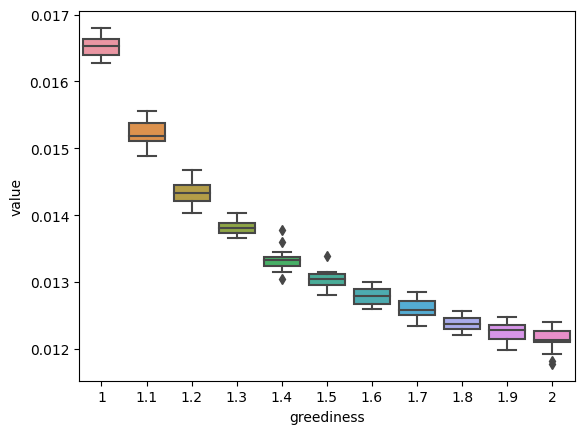

In [48]:
ax = sn.boxplot(data=df3[df3["metric"]=="mean_location_norm_error"], x="model", y="value")
plt.xlabel("greediness")
plt.setp(ax.get_xticklabels(), rotation=0, ha='center')
plt.show()